In [1]:
import os
LOAD = False         # True = load previously saved model from disk?  False = (re)train the model
SAVE = "\_TFT_model_02.pth.tar"   # file name to save the model under

EPOCHS = 200
INLEN = 16          # input size
HIDDEN = 32         # hidden layers    
LSTMLAYERS = 2      # recurrent layers

ATTH = 2            # attention heads
BATCH = 64          # batch size
LEARN = 1e-3        # learning rate
DROPOUT = 0.1       # dropout rate
VALWAIT = 1         # epochs to wait before evaluating the loss on the test/validation set
N_FC = 2            # output size

RAND = 42           # random seed
N_SAMPLES = 100     # number of times a prediction is sampled from a probabilistic model
N_JOBS = -1          # parallel processors to use;  -1 = all processors

# default quantiles for QuantileRegression
QUANTILES = [0.01, 0.1, 0.2, 0.5, 0.8, 0.9, 0.99]

SPLIT = 0.9         # train/test %

FIGSIZE = (9, 6)


qL1, qL2 = 0.01, 0.10        # percentiles of predictions: lower bounds
qU1, qU2 = 1-qL1, 1-qL2,     # upper bounds derived from lower bounds
label_q1 = f'{int(qU1 * 100)} / {int(qL1 * 100)} percentile band'
label_q2 = f'{int(qU2 * 100)} / {int(qL2 * 100)} percentile band'

mpath = os.path.abspath(os.getcwd()) + SAVE     # path and file name to save the model

In [2]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import missingno as mno

import warnings
warnings.filterwarnings("ignore")
import logging
logging.disable(logging.CRITICAL)


from darts import TimeSeries, concatenate
from darts.dataprocessing.transformers import Scaler
from darts.models import TransformerModel, NBEATSModel, TFTModel
from darts.metrics import mape, rmse, smape
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts.utils.likelihood_models import QuantileRegression
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

pd.set_option("display.precision",2)
np.set_printoptions(precision=2, suppress=True)
pd.options.display.float_format = '{:,.2f}'.format

In [3]:
import pandas as pd
xls = pd.ExcelFile('../../data_complete.xlsx')
df_radon={}
for key in ['48','9']:
    df_radon[key] = pd.read_excel(xls, key)
    df_radon[key] = df_radon[key].loc[(df_radon[key]['SyncDate']>='2022-08-10')]

In [4]:
df_radon.keys()

dict_keys(['48', '9'])

In [5]:
#using 21 as the example since it has the most data
df = df_radon['48']

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4163 entries, 0 to 4162
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     4163 non-null   object        
 1   DeviceName   4163 non-null   object        
 2   SyncDate     4163 non-null   datetime64[ns]
 3   Radon        4163 non-null   float64       
 4   eC02         4163 non-null   int64         
 5   VOC          4163 non-null   int64         
 6   Temperature  4163 non-null   int64         
 7   AirPressure  4163 non-null   float64       
 8   Humidity     4163 non-null   int64         
 9   LogIndex     4163 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 357.8+ KB


In [7]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [8]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:05:58,49,61,30.02,28.90
1,2023-02-11 16:05:58,56,53,30.08,25.40
2,2023-02-11 15:05:58,58,51,30.08,25.30
3,2023-02-11 14:05:58,57,51,30.13,25.30
4,2023-02-11 12:05:58,61,49,30.15,28.40
...,...,...,...,...,...
4158,2022-08-10 05:16:07,79,71,30.17,81.10
4159,2022-08-10 04:16:07,78,71,30.15,87.20
4160,2022-08-10 03:16:07,78,72,30.15,86.90
4161,2022-08-10 02:16:07,79,72,30.15,93.00


In [9]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [10]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-08-10,84.36,67.68,30.17,72.56
2022-08-11,84.54,67.96,30.11,77.36
2022-08-12,87.40,66.70,30.03,99.93
2022-08-13,85.67,65.33,30.08,53.24
2022-08-14,86.61,62.39,30.05,35.03
...,...,...,...,...
2023-02-07,61.57,45.22,30.27,0.68
2023-02-08,64.96,49.57,30.24,0.65
2023-02-09,63.95,59.23,30.13,0.78


In [11]:
df = df[df.index<= '2022-11-10']

In [12]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-08-10,84.36,67.68,30.17,72.56
2022-08-11,84.54,67.96,30.11,77.36
2022-08-12,87.40,66.70,30.03,99.93
2022-08-13,85.67,65.33,30.08,53.24
2022-08-14,86.61,62.39,30.05,35.03
...,...,...,...,...
2022-11-06,77.39,61.17,30.12,18.57
2022-11-07,77.91,61.26,30.26,18.97
2022-11-08,76.00,57.38,30.32,27.45


In [13]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [14]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [15]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [16]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [17]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [18]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-08-10,84.36,67.68,30.17,72.56,76.12,0.19,0.75,6.67,301.81,0.00,...,0.02,2.18,37.50,29.11,85.56,0.81,108.12,29.11,308.21,0.09
2022-08-11,84.54,67.96,30.11,77.36,75.58,0.16,0.43,3.53,304.70,0.00,...,0.05,2.21,37.53,29.05,85.81,0.77,101.78,29.05,307.19,0.06
2022-08-12,87.40,66.70,30.03,99.93,76.74,0.11,0.45,3.40,307.36,0.00,...,0.11,2.27,37.59,28.98,84.00,1.32,160.11,28.98,309.54,0.05
2022-08-13,85.67,65.33,30.08,53.24,75.14,0.26,1.09,4.25,291.06,0.00,...,0.13,2.29,37.61,29.03,79.21,1.18,145.65,29.03,306.76,0.20
2022-08-14,86.61,62.39,30.05,35.03,75.74,0.21,0.65,3.83,307.88,0.00,...,0.00,2.29,37.61,28.99,78.41,1.49,177.48,28.99,309.20,0.11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-06,77.39,61.17,30.12,18.57,70.78,0.21,0.75,10.24,294.75,0.00,...,0.00,0.05,44.85,29.07,86.35,0.58,77.47,29.07,305.12,0.12
2022-11-07,77.91,61.26,30.26,18.97,71.06,0.07,0.34,4.24,305.54,0.00,...,0.00,0.05,44.85,29.20,86.83,0.58,76.87,29.20,310.20,0.01
2022-11-08,76.00,57.38,30.32,27.45,68.04,0.26,0.96,4.63,296.07,0.00,...,0.00,0.05,44.85,29.26,69.77,0.82,102.09,29.26,308.71,0.15


In [19]:
df.dropna(inplace=True)

In [20]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-08-10,84.36,67.68,30.17,72.56,76.12,0.19,0.75,6.67,301.81,0.00,...,0.02,2.18,37.50,29.11,85.56,0.81,108.12,29.11,308.21,0.09
2022-08-11,84.54,67.96,30.11,77.36,75.58,0.16,0.43,3.53,304.70,0.00,...,0.05,2.21,37.53,29.05,85.81,0.77,101.78,29.05,307.19,0.06
2022-08-12,87.40,66.70,30.03,99.93,76.74,0.11,0.45,3.40,307.36,0.00,...,0.11,2.27,37.59,28.98,84.00,1.32,160.11,28.98,309.54,0.05
2022-08-13,85.67,65.33,30.08,53.24,75.14,0.26,1.09,4.25,291.06,0.00,...,0.13,2.29,37.61,29.03,79.21,1.18,145.65,29.03,306.76,0.20
2022-08-14,86.61,62.39,30.05,35.03,75.74,0.21,0.65,3.83,307.88,0.00,...,0.00,2.29,37.61,28.99,78.41,1.49,177.48,28.99,309.20,0.11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-06,77.39,61.17,30.12,18.57,70.78,0.21,0.75,10.24,294.75,0.00,...,0.00,0.05,44.85,29.07,86.35,0.58,77.47,29.07,305.12,0.12
2022-11-07,77.91,61.26,30.26,18.97,71.06,0.07,0.34,4.24,305.54,0.00,...,0.00,0.05,44.85,29.20,86.83,0.58,76.87,29.20,310.20,0.01
2022-11-08,76.00,57.38,30.32,27.45,68.04,0.26,0.96,4.63,296.07,0.00,...,0.00,0.05,44.85,29.26,69.77,0.82,102.09,29.26,308.71,0.15


In [21]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [22]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [23]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,77.63,65.69,30.07,31.87,67.45,0.13,0.54,3.36,296.43,0.00,0.10,0.03,0.30,1.65,42.03,29.02,77.72,29.02,304.88,0.07
std,7.86,12.38,0.10,17.08,8.11,0.12,0.49,2.50,12.64,0.01,0.28,0.10,0.52,1.24,2.25,0.10,9.98,0.10,9.92,0.08
min,63.20,38.48,29.86,0.46,45.54,0.00,0.00,0.00,258.31,0.00,0.00,0.00,0.00,0.00,37.50,28.80,54.15,28.80,267.15,0.00
25%,71.17,58.95,30.01,22.04,61.25,0.02,0.19,1.87,288.74,0.00,0.00,0.00,0.00,0.14,40.48,28.95,70.64,28.95,298.27,0.01
50%,77.39,68.75,30.07,30.11,68.04,0.11,0.46,3.40,299.35,0.00,0.00,0.00,0.00,1.99,42.52,29.01,78.96,29.01,306.57,0.05
75%,84.57,75.79,30.13,35.80,75.01,0.20,0.75,4.45,305.92,0.00,0.04,0.00,0.34,2.09,43.96,29.08,85.25,29.08,312.89,0.10
max,89.57,84.20,30.34,99.93,78.23,0.53,2.44,10.24,317.34,0.06,1.79,0.74,1.91,5.11,44.87,29.29,95.93,29.29,319.39,0.37


In [24]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [25]:
df.fillna(0, inplace=True)

In [26]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Temperature,0.45
Outdoor h Temperature (°F),0.35
Humidity (%),0.29
Monthly Rain (in)_lag_1,0.29
...,...
Temperature_lag_23,-0.62
Humidity_lag_23,-0.63
Outdoor h Temperature (°F)_lag_23,-0.63
Yearly Rain (in)_lag_3,-0.63


In [27]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Temperature 0.44675920868759905
Outdoor h Temperature (°F) 0.34972987587752263
Humidity (%) 0.2930539271625921
Monthly Rain (in)_lag_1 0.2857739946574713
Monthly Rain (in) 0.26948965643507833
Avg Wind Direction (10 mins) (°) 0.25828568766295806
Hourly Rain (in/hr)_lag_2 0.2567713279400043
Event Rain (in)_lag_1 0.22856915717422302
Event Rain (in)_lag_2 0.22660025196419986
Wind Direction (°) 0.22124187914579804
Daily Rain (in)_lag_2 0.20217714410468574
Weekly Rain (in) 0.15411326296271688
Hourly Rain (in/hr)_lag_3 0.15114634130075696
Hourly Rain (in/hr)_lag_1 0.14195252405408845
Event Rain (in) 0.1404649655056779
Monthly Rain (in)_lag_2 0.14015862798479334
Daily Rain (in)_lag_1 0.1093128893813916
Event Rain (in)_lag_7 0.10191618951276368
Humidity (%)_lag_1 0.09989043183426365
Hourly Rain (in/hr)_lag_8 0.08623335973987847
Daily Rain (in)_lag_3 0.07680685630858945
Daily Rain (in)_lag_7 0.07491718673651498
Hourly Rain (in/hr)_lag_9 0.07240711564146511
Weekly Rain (in)_lag_1 0.0723

In [28]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[(df_corrP["Radon"]) >= 0.44]
df_corrH

,Radon
Radon,1.00
Temperature,0.45


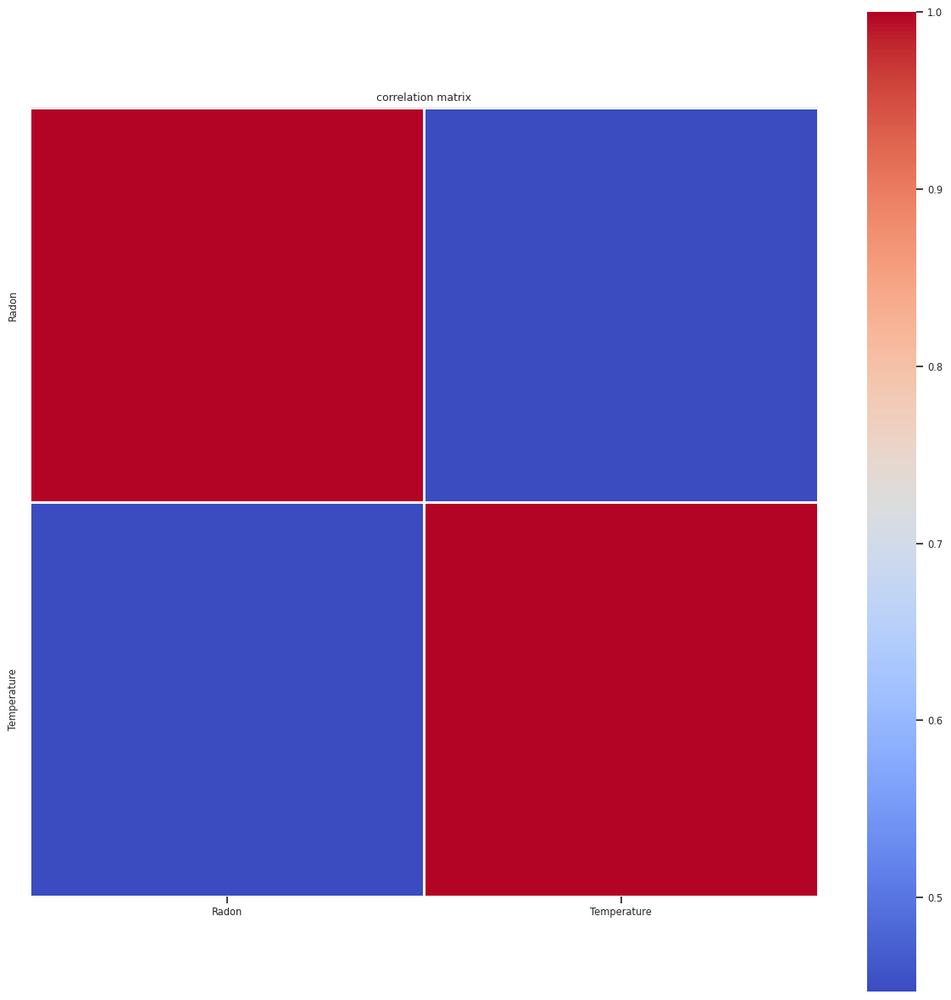

In [29]:
# correlation matrix, limited to highly correlated features
df3 = df[df_corrH.index]

idx = df3.corr().sort_values("Radon", ascending=False).index
df3_sorted = df3.loc[:, idx]  # sort dataframe columns by their correlation with Appliances

plt.figure(figsize = (15,15))
sns.set(font_scale=0.75)
ax = sns.heatmap(df3_sorted.corr().round(3), 
            annot=False, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
ax.xaxis.tick_bottom()
plt.title("correlation matrix")
plt.show()

In [30]:
df3 = df[df_corrH.index]
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-08-10 to 2022-11-10
Freq: D
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Radon        93 non-null     float32
 1   Temperature  93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [31]:
df3.fillna(0, inplace=True)

In [32]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-08-10 to 2022-11-10
Freq: D
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Radon        93 non-null     float32
 1   Temperature  93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [33]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df3["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [34]:
# create time series object for the feature columns
df_covF = df3.loc[:, df3.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['Temperature'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [35]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 1, 1)

In [36]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [37]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-08-10 00:00:00
training end: 2022-10-22 00:00:00
training duration: 73 days 00:00:00
test start: 2022-10-23 00:00:00
test end: 2022-11-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-08-10,0.72
2022-11-10,0.42


In [38]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,Temperature
SyncDate,
2022-08-10,0.80
2022-11-10,0.14


In [39]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-08-10,0.72
2022-10-22,0.35


In [40]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [41]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [42]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [43]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-22 23:12:31 (running for 00:00:00.22)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |         lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+----------

(build_fit_tft_model pid=1032869) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1032869)   rank_zero_deprecation(
(build_fit_tft_model pid=1032869) Auto select gpus: [0]
(build_fit_tft_model pid=1032869) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1032869) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1032869) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1032869) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1032869) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1032869) 
(build_fit_tft_model pid=1032869)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1032869) ---------------

== Status ==
Current time: 2023-02-22 23:12:47 (running for 00:00:17.09)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |         lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------

Trial name,date,done,episodes_total,experiment_id,experiment_tag,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_000b3fbc,2023-02-22_23-43-20,True,,c3eff65443d04f24a14b466e5cf80fa9,,ip-172-31-10-87,10,0.546696,172.31.10.87,1073136,1.06168,8.12851,0.29044,8.12851,1677109400,0,,10,000b3fbc,0.0149903
build_fit_tft_model_016d9167,2023-02-23_01-03-43,True,,f3ed5e58bd4c4279a8f7ce9bc2e04934,"282_dropout=0.3769,in_len=8,include_hour=True,lr=0.0180,lstm_layers=2,num_attention_heads=3,out_len=3",ip-172-31-10-87,31,0.134802,172.31.10.87,1176152,0.531072,13.5573,0.261531,13.5573,1677114223,0,,31,016d9167,0.0193238
build_fit_tft_model_01a03aad,2023-02-23_01-26-52,True,,341cefb54c0142ca88f6307c7a6d4c69,,ip-172-31-10-87,40,0.120235,172.31.10.87,1205221,0.536685,14.4302,0.220516,14.4302,1677115612,0,,40,01a03aad,0.0145705
build_fit_tft_model_020aae5b,2023-02-22_23-19-39,True,,9aee0ed7e3b14e65ac3149a3af2b5d66,,ip-172-31-10-87,40,0.133354,172.31.10.87,1041602,0.572573,16.2107,0.260559,16.2107,1677107979,0,,40,020aae5b,0.00783896
build_fit_tft_model_0249992a,2023-02-23_02-12-10,True,,8a38afd1ca484c78bffe7f96312d0595,,ip-172-31-10-87,10,0.32638,172.31.10.87,1266958,1.09529,10.2275,0.334539,10.2275,1677118330,0,,10,0249992a,0.00971794
build_fit_tft_model_0328e59f,2023-02-23_02-17-35,True,,d266c68e30634256a1582a4d6bda3239,,ip-172-31-10-87,40,0.113367,172.31.10.87,1274205,0.521034,22.8079,0.30541,22.8079,1677118655,0,,40,0328e59f,0.010901
build_fit_tft_model_0364f428,2023-02-23_01-47-22,True,,c7db3d3d7ee945b4b0c901f033a58a8f,,ip-172-31-10-87,10,0.31182,172.31.10.87,1231950,0.808352,9.60162,0.420437,9.60162,1677116842,0,,10,0364f428,0.00686312
build_fit_tft_model_0373fc52,2023-02-23_01-54-27,True,,31e198f1db2740a9930bc84f52b24b1c,,ip-172-31-10-87,20,0.123174,172.31.10.87,1241917,0.601004,15.1051,0.29899,15.1051,1677117267,0,,20,0373fc52,0.0113976
build_fit_tft_model_0484406a,2023-02-23_02-16-58,True,,845f98d7736b4fa1abf49fa14319b3b8,,ip-172-31-10-87,20,0.134957,172.31.10.87,1273606,0.719921,14.8339,0.383803,14.8339,1677118618,0,,20,0484406a,0.0215552
build_fit_tft_model_0497d85e,2023-02-23_01-18-31,True,,55b2205d1d8b4d3dafe772ec618c566e,"317_dropout=0.4023,in_len=8,include_hour=True,lr=0.0334,lstm_layers=2,num_attention_heads=10,out_len=3",ip-172-31-10-87,58,0.11146,172.31.10.87,1194724,0.582575,22.7039,0.264832,22.7039,1677115111,0,,58,0497d85e,0.00587726


== Status ==
Current time: 2023-02-22 23:12:53 (running for 00:00:22.13)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: -1.1444048881530762
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8ad0baa2 with sMAPE=1.0942479372024536 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.36067693174165694, 'lr': 1.9267035769516327e-05, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---------+---------+----------------------+
| Trial name            

== Status ==
Current time: 2023-02-22 23:13:13 (running for 00:00:43.06)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.4040411710739136 | Iter 20.000: -1.321178913116455 | Iter 10.000: -1.1444048881530762
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8ad0baa2 with sMAPE=0.9706913232803345 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.36067693174165694, 'lr': 1.9267035769516327e-05, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---------+----------+------------------

== Status ==
Current time: 2023-02-22 23:13:37 (running for 00:01:06.53)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -1.4040411710739136 | Iter 20.000: -1.321178913116455 | Iter 10.000: -1.1444048881530762
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8ad0baa2 with sMAPE=0.9273810386657715 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.36067693174165694, 'lr': 1.9267035769516327e-05, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1034106) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1034106)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1034106) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034106)   rank_zero_deprecation(
(build_fit_tft_model pid=1034106) Auto select gpus: [0]
(build_fit_tft_model pid=1034106) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034106) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034106) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034106) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:13:47 (running for 00:01:17.11)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -1.4040411710739136 | Iter 20.000: -1.321178913116455 | Iter 10.000: -1.1444048881530762
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8ad0baa2 with sMAPE=0.9273810386657715 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.36067693174165694, 'lr': 1.9267035769516327e-05, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1034750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034750)   rank_zero_deprecation(
(build_fit_tft_model pid=1034750) Auto select gpus: [0]
(build_fit_tft_model pid=1034750) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034750) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034750) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034750) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1034750) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1034750) 
(build_fit_tft_model pid=1034750)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1034750) ---------------

== Status ==
Current time: 2023-02-22 23:14:16 (running for 00:01:45.34)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -1.4040411710739136 | Iter 20.000: -0.9955101907253265 | Iter 10.000: -0.9279583394527435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 46c85e7c with sMAPE=0.6898820400238037 and parameters={'in_len': 8, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 10, 'dropout': 0.11725264867311154, 'lr': 0.021144292221290554, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1035162) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035162)   rank_zero_deprecation(
(build_fit_tft_model pid=1035162) Auto select gpus: [0]
(build_fit_tft_model pid=1035162) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035162) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035162) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035162) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035162) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035162) 
(build_fit_tft_model pid=1035162)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035162) ---------------

== Status ==
Current time: 2023-02-22 23:14:34 (running for 00:02:03.31)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -1.4040411710739136 | Iter 20.000: -0.9955101907253265 | Iter 10.000: -1.1444048881530762
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 46c85e7c with sMAPE=0.6898820400238037 and parameters={'in_len': 8, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 10, 'dropout': 0.11725264867311154, 'lr': 0.021144292221290554, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1035698) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035698)   rank_zero_deprecation(
(build_fit_tft_model pid=1035698) Auto select gpus: [0]
(build_fit_tft_model pid=1035698) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035698) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035698) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035698) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035698) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035698) 
(build_fit_tft_model pid=1035698)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035698) ---------------

== Status ==
Current time: 2023-02-22 23:14:58 (running for 00:02:27.22)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -1.4040411710739136 | Iter 20.000: -0.669841468334198 | Iter 10.000: -0.9279583394527435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a0fc2300 with sMAPE=0.6154879331588745 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.33125951273190357, 'lr': 0.0017480802985968056, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1036204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1036204)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1036204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036204)   rank_zero_deprecation(
(build_fit_tft_model pid=1036204) Auto select gpus: [0]
(build_fit_tft_model pid=1036204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036204) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:15:18 (running for 00:02:47.89)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -1.4040411710739136 | Iter 20.000: -0.669841468334198 | Iter 10.000: -0.99870365858078
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a0fc2300 with sMAPE=0.6154879331588745 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.33125951273190357, 'lr': 0.0017480802985968056, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1036713) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036713)   rank_zero_deprecation(
(build_fit_tft_model pid=1036713) Auto select gpus: [0]
(build_fit_tft_model pid=1036713) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036713) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036713) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036713) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1036713) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1036713) 
(build_fit_tft_model pid=1036713)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1036713) ---------------

== Status ==
Current time: 2023-02-22 23:15:39 (running for 00:03:08.32)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -1.4040411710739136 | Iter 20.000: -0.669841468334198 | Iter 10.000: -1.071554273366928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a0fc2300 with sMAPE=0.6154879331588745 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.33125951273190357, 'lr': 0.0017480802985968056, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1037153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037153)   rank_zero_deprecation(
(build_fit_tft_model pid=1037153) Auto select gpus: [0]
(build_fit_tft_model pid=1037153) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037153) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037153) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037153) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037153) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037153) 
(build_fit_tft_model pid=1037153)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037153) ---------------

== Status ==
Current time: 2023-02-22 23:15:59 (running for 00:03:28.49)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -1.4040411710739136 | Iter 20.000: -0.669841468334198 | Iter 10.000: -1.1444048881530762
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a0fc2300 with sMAPE=0.6154879331588745 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.33125951273190357, 'lr': 0.0017480802985968056, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1037704) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037704)   rank_zero_deprecation(
(build_fit_tft_model pid=1037704) Auto select gpus: [0]
(build_fit_tft_model pid=1037704) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037704) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037704) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037704) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037704) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037704) 
(build_fit_tft_model pid=1037704)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037704) ---------------

== Status ==
Current time: 2023-02-22 23:16:20 (running for 00:03:49.54)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -1.4040411710739136 | Iter 20.000: -0.6760491728782654 | Iter 10.000: -1.071554273366928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a0fc2300 with sMAPE=0.6154879331588745 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.33125951273190357, 'lr': 0.0017480802985968056, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:16:35 (running for 00:04:04.93)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.8720864951610565 | Iter 20.000: -0.669841468334198 | Iter 10.000: -0.99870365858078
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.5038769245147705 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1038377) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038377)   rank_zero_deprecation(
(build_fit_tft_model pid=1038377) Auto select gpus: [0]
(build_fit_tft_model pid=1038377) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038377) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038377) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038377) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038377) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038377) 
(build_fit_tft_model pid=1038377)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038377) ---------------

== Status ==
Current time: 2023-02-22 23:16:54 (running for 00:04:24.01)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.8720864951610565 | Iter 20.000: -0.669841468334198 | Iter 10.000: -0.99870365858078
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1038870) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038870)   rank_zero_deprecation(
(build_fit_tft_model pid=1038870) Auto select gpus: [0]
(build_fit_tft_model pid=1038870) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038870) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038870) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038870) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038870) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038870) 
(build_fit_tft_model pid=1038870)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038870) ---------------

== Status ==
Current time: 2023-02-22 23:17:12 (running for 00:04:42.11)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.8720864951610565 | Iter 20.000: -0.669841468334198 | Iter 10.000: -1.071554273366928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1039211) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039211)   rank_zero_deprecation(
(build_fit_tft_model pid=1039211) Auto select gpus: [0]
(build_fit_tft_model pid=1039211) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039211) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039211) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039211) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039211) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039211) 
(build_fit_tft_model pid=1039211)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039211) ---------------

== Status ==
Current time: 2023-02-22 23:17:30 (running for 00:05:00.07)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.8720864951610565 | Iter 20.000: -0.669841468334198 | Iter 10.000: -1.1444048881530762
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1039605) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039605)   rank_zero_deprecation(
(build_fit_tft_model pid=1039605) Auto select gpus: [0]
(build_fit_tft_model pid=1039605) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039605) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039605) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039605) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039605) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039605) 
(build_fit_tft_model pid=1039605)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039605) ---------------

== Status ==
Current time: 2023-02-22 23:17:52 (running for 00:05:21.68)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.8720864951610565 | Iter 20.000: -0.6760491728782654 | Iter 10.000: -1.071554273366928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:18:07 (running for 00:05:36.64)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.8720864951610565 | Iter 20.000: -0.669841468334198 | Iter 10.000: -0.99870365858078
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1040119) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040119)   rank_zero_deprecation(
(build_fit_tft_model pid=1040119) Auto select gpus: [0]
(build_fit_tft_model pid=1040119) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040119) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040119) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040119) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040119) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040119) 
(build_fit_tft_model pid=1040119)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040119) ---------------

== Status ==
Current time: 2023-02-22 23:18:18 (running for 00:05:47.32)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.8720864951610565 | Iter 20.000: -0.669841468334198 | Iter 10.000: -0.99870365858078
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-22 23:18:28 (running for 00:05:57.68)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.8720864951610565 | Iter 20.000: -0.6760491728782654 | Iter 10.000: -0.9656944274902344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1040650) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040650)   rank_zero_deprecation(
(build_fit_tft_model pid=1040650) Auto select gpus: [0]
(build_fit_tft_model pid=1040650) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040650) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040650) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040650) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040650) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040650) 
(build_fit_tft_model pid=1040650)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040650) ---------------

== Status ==
Current time: 2023-02-22 23:18:38 (running for 00:06:07.43)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.8720864951610565 | Iter 20.000: -0.6760491728782654 | Iter 10.000: -0.9656944274902344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:18:48 (running for 00:06:17.68)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.669841468334198 | Iter 10.000: -0.9326851963996887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1041215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1041215)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1041215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041215)   rank_zero_deprecation(
(build_fit_tft_model pid=1041215) Auto select gpus: [0]
(build_fit_tft_model pid=1041215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041215) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:19:06 (running for 00:06:35.99)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.669841468334198 | Iter 10.000: -0.9326851963996887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:19:17 (running for 00:06:46.70)
Memory usage on this node: 9.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.669841468334198 | Iter 10.000: -0.9656944274902344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1041602) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041602)   rank_zero_deprecation(
(build_fit_tft_model pid=1041602) Auto select gpus: [0]
(build_fit_tft_model pid=1041602) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041602) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041602) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041602) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041602) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041602) 
(build_fit_tft_model pid=1041602)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041602) ---------------

== Status ==
Current time: 2023-02-22 23:19:27 (running for 00:06:57.12)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.669841468334198 | Iter 10.000: -0.9656944274902344
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:19:38 (running for 00:07:07.40)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.6655167639255524 | Iter 10.000: -0.9326851963996887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1042227) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042227)   rank_zero_deprecation(
(build_fit_tft_model pid=1042227) Auto select gpus: [0]
(build_fit_tft_model pid=1042227) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042227) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042227) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042227) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042227) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042227) 
(build_fit_tft_model pid=1042227)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042227) ---------------

== Status ==
Current time: 2023-02-22 23:19:55 (running for 00:07:24.71)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5449540019035339 | Iter 20.000: -0.6655167639255524 | Iter 10.000: -0.9326851963996887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:20:05 (running for 00:07:34.94)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5449540019035339 | Iter 20.000: -0.6611920595169067 | Iter 10.000: -0.9313577711582184
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1042823) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042823)   rank_zero_deprecation(
(build_fit_tft_model pid=1042823) Auto select gpus: [0]
(build_fit_tft_model pid=1042823) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042823) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042823) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042823) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042823) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042823) 
(build_fit_tft_model pid=1042823)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042823) ---------------

== Status ==
Current time: 2023-02-22 23:20:24 (running for 00:07:53.71)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5725730061531067 | Iter 20.000: -0.6611920595169067 | Iter 10.000: -0.9313577711582184
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:20:34 (running for 00:08:03.90)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5725730061531067 | Iter 20.000: -0.6549221575260162 | Iter 10.000: -0.930030345916748
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1043325) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043325)   rank_zero_deprecation(
(build_fit_tft_model pid=1043325) Auto select gpus: [0]
(build_fit_tft_model pid=1043325) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043325) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043325) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043325) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1043325) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1043325) 
(build_fit_tft_model pid=1043325)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1043325) ---------------

== Status ==
Current time: 2023-02-22 23:20:52 (running for 00:08:21.60)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.6549221575260162 | Iter 10.000: -0.930030345916748
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:21:03 (running for 00:08:32.69)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.6611920595169067 | Iter 10.000: -0.9001664519309998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1043836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043836)   rank_zero_deprecation(
(build_fit_tft_model pid=1043836) Auto select gpus: [0]
(build_fit_tft_model pid=1043836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1043836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1043836) 
(build_fit_tft_model pid=1043836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1043836) ---------------

== Status ==
Current time: 2023-02-22 23:21:14 (running for 00:08:43.44)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.6611920595169067 | Iter 10.000: -0.9001664519309998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1044212) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1044212)   rank_zero_deprecation(
(build_fit_tft_model pid=1044212) Auto select gpus: [0]
(build_fit_tft_model pid=1044212) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1044212) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1044212) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1044212) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1044212) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1044212) 
(build_fit_tft_model pid=1044212)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1044212) ---------------

== Status ==
Current time: 2023-02-22 23:21:32 (running for 00:09:01.59)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.6611920595169067 | Iter 10.000: -0.930030345916748
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:21:42 (running for 00:09:11.87)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.6549221575260162 | Iter 10.000: -0.9001664519309998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1044893) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1044893)   rank_zero_deprecation(
(build_fit_tft_model pid=1044893) Auto select gpus: [0]
(build_fit_tft_model pid=1044893) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1044893) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1044893) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1044893) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1044893) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1044893) 
(build_fit_tft_model pid=1044893)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1044893) ---------------

== Status ==
Current time: 2023-02-22 23:22:01 (running for 00:09:30.96)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.6549221575260162 | Iter 10.000: -0.9001664519309998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:22:12 (running for 00:09:41.16)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5852859914302826 | Iter 20.000: -0.6486522555351257 | Iter 10.000: -0.8703025579452515
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1045459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045459)   rank_zero_deprecation(
(build_fit_tft_model pid=1045459) Auto select gpus: [0]
(build_fit_tft_model pid=1045459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045459) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045459) 
(build_fit_tft_model pid=1045459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045459) ---------------

== Status ==
Current time: 2023-02-22 23:22:28 (running for 00:09:57.60)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5852859914302826 | Iter 20.000: -0.6486522555351257 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:22:38 (running for 00:10:07.86)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5852859914302826 | Iter 20.000: -0.6235320568084717 | Iter 10.000: -0.8538050949573517
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:22:50 (running for 00:10:19.73)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.6235320568084717 | Iter 10.000: -0.8538050949573517
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1046164) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046164)   rank_zero_deprecation(
(build_fit_tft_model pid=1046164) Auto select gpus: [0]
(build_fit_tft_model pid=1046164) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046164) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046164) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046164) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046164) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046164) 
(build_fit_tft_model pid=1046164)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046164) ---------------

== Status ==
Current time: 2023-02-22 23:23:01 (running for 00:10:30.48)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.6235320568084717 | Iter 10.000: -0.8538050949573517
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1046573) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046573)   rank_zero_deprecation(
(build_fit_tft_model pid=1046573) Auto select gpus: [0]
(build_fit_tft_model pid=1046573) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046573) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046573) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046573) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046573) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046573) 
(build_fit_tft_model pid=1046573)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046573) ---------------

== Status ==
Current time: 2023-02-22 23:23:20 (running for 00:10:49.84)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.6235320568084717 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1047065) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047065)   rank_zero_deprecation(
(build_fit_tft_model pid=1047065) Auto select gpus: [0]
(build_fit_tft_model pid=1047065) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047065) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047065) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047065) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1047065) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1047065) 
(build_fit_tft_model pid=1047065)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1047065) ---------------

== Status ==
Current time: 2023-02-22 23:23:40 (running for 00:11:09.56)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.6235320568084717 | Iter 10.000: -0.9001664519309998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1047387) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047387)   rank_zero_deprecation(
(build_fit_tft_model pid=1047387) Auto select gpus: [0]
(build_fit_tft_model pid=1047387) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047387) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047387) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047387) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1047387) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1047387) 
(build_fit_tft_model pid=1047387)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1047387) ---------------

== Status ==
Current time: 2023-02-22 23:23:59 (running for 00:11:28.30)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.6235320568084717 | Iter 10.000: -0.930030345916748
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1047787) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1047787)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1047787) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047787)   rank_zero_deprecation(
(build_fit_tft_model pid=1047787) Auto select gpus: [0]
(build_fit_tft_model pid=1047787) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047787) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047787) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047787) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:24:17 (running for 00:11:46.58)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.6235320568084717 | Iter 10.000: -0.9313577711582184
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:24:32 (running for 00:12:01.75)
Memory usage on this node: 9.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.930030345916748
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1048328) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048328)   rank_zero_deprecation(
(build_fit_tft_model pid=1048328) Auto select gpus: [0]
(build_fit_tft_model pid=1048328) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048328) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048328) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048328) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048328) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048328) 
(build_fit_tft_model pid=1048328)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048328) ---------------

== Status ==
Current time: 2023-02-22 23:24:43 (running for 00:12:12.81)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.930030345916748
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:24:58 (running for 00:12:27.76)
Memory usage on this node: 9.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5852859914302826 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.9001664519309998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1048900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048900)   rank_zero_deprecation(
(build_fit_tft_model pid=1048900) Auto select gpus: [0]
(build_fit_tft_model pid=1048900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048900) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048900) 
(build_fit_tft_model pid=1048900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048900) ---------------

== Status ==
Current time: 2023-02-22 23:25:09 (running for 00:12:38.27)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5852859914302826 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.9001664519309998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:25:21 (running for 00:12:50.74)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5852859914302826 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1049369) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049369)   rank_zero_deprecation(
(build_fit_tft_model pid=1049369) Auto select gpus: [0]
(build_fit_tft_model pid=1049369) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049369) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049369) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049369) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1049369) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1049369) 
(build_fit_tft_model pid=1049369)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1049369) ---------------

== Status ==
Current time: 2023-02-22 23:25:32 (running for 00:13:01.71)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5852859914302826 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1049856) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049856)   rank_zero_deprecation(
(build_fit_tft_model pid=1049856) Auto select gpus: [0]
(build_fit_tft_model pid=1049856) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049856) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049856) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049856) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1049856) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1049856) 
(build_fit_tft_model pid=1049856)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1049856) ---------------

== Status ==
Current time: 2023-02-22 23:25:53 (running for 00:13:22.34)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5852859914302826 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.9001664519309998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:26:03 (running for 00:13:32.41)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5852859914302826 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:26:17 (running for 00:13:46.79)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1050494) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050494)   rank_zero_deprecation(
(build_fit_tft_model pid=1050494) Auto select gpus: [0]
(build_fit_tft_model pid=1050494) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050494) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050494) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050494) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1050494) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1050494) 
(build_fit_tft_model pid=1050494)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1050494) ---------------

== Status ==
Current time: 2023-02-22 23:26:28 (running for 00:13:57.52)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:26:38 (running for 00:14:07.73)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5805306434631348 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8618033230304718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:26:53 (running for 00:14:22.78)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8618033230304718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1051225) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051225)   rank_zero_deprecation(
(build_fit_tft_model pid=1051225) Auto select gpus: [0]
(build_fit_tft_model pid=1051225) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051225) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051225) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051225) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:27:03 (running for 00:14:33.01)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8618033230304718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1051225) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051225) 
(build_fit_tft_model pid=1051225)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051225) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1051225) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1051225) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1051225) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1051225) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1051225) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1051225) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:27:09 (running for 00:14:38.25)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1051856) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051856)   rank_zero_deprecation(
(build_fit_tft_model pid=1051856) Auto select gpus: [0]
(build_fit_tft_model pid=1051856) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051856) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051856) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051856) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051856) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051856) 
(build_fit_tft_model pid=1051856)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051856) ---------------

== Status ==
Current time: 2023-02-22 23:27:27 (running for 00:14:57.03)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:27:38 (running for 00:15:07.80)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1052365) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052365)   rank_zero_deprecation(
(build_fit_tft_model pid=1052365) Auto select gpus: [0]
(build_fit_tft_model pid=1052365) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052365) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052365) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052365) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1052365) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052365) 
(build_fit_tft_model pid=1052365)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052365) ---------------

== Status ==
Current time: 2023-02-22 23:27:49 (running for 00:15:18.45)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1052728) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052728)   rank_zero_deprecation(
(build_fit_tft_model pid=1052728) Auto select gpus: [0]
(build_fit_tft_model pid=1052728) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052728) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052728) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052728) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1052728) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052728) 
(build_fit_tft_model pid=1052728)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052728) ---------------

== Status ==
Current time: 2023-02-22 23:28:07 (running for 00:15:36.27)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1053199) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053199)   rank_zero_deprecation(
(build_fit_tft_model pid=1053199) Auto select gpus: [0]
(build_fit_tft_model pid=1053199) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053199) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053199) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053199) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1053199) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053199) 
(build_fit_tft_model pid=1053199)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053199) ---------------

== Status ==
Current time: 2023-02-22 23:28:26 (running for 00:15:55.94)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8618033230304718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1053684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053684)   rank_zero_deprecation(
(build_fit_tft_model pid=1053684) Auto select gpus: [0]
(build_fit_tft_model pid=1053684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1053684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053684) 
(build_fit_tft_model pid=1053684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053684) ---------------

== Status ==
Current time: 2023-02-22 23:28:46 (running for 00:16:15.49)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:28:56 (running for 00:16:25.59)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5765518248081207 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8618033230304718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:29:06 (running for 00:16:35.81)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5725730061531067 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8618033230304718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1054300) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054300)   rank_zero_deprecation(
(build_fit_tft_model pid=1054300) Auto select gpus: [0]
(build_fit_tft_model pid=1054300) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054300) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054300) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054300) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1054300) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054300) 
(build_fit_tft_model pid=1054300)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054300) ---------------

== Status ==
Current time: 2023-02-22 23:29:16 (running for 00:16:45.58)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5725730061531067 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8618033230304718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1054787) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054787)   rank_zero_deprecation(
(build_fit_tft_model pid=1054787) Auto select gpus: [0]
(build_fit_tft_model pid=1054787) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054787) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054787) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054787) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1054787) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054787) 
(build_fit_tft_model pid=1054787)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054787) ---------------

== Status ==
Current time: 2023-02-22 23:29:36 (running for 00:17:05.35)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5725730061531067 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1055208) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055208)   rank_zero_deprecation(
(build_fit_tft_model pid=1055208) Auto select gpus: [0]
(build_fit_tft_model pid=1055208) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055208) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055208) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055208) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1055208) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055208) 
(build_fit_tft_model pid=1055208)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055208) ---------------

== Status ==
Current time: 2023-02-22 23:29:56 (running for 00:17:26.05)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5725730061531067 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.9001664519309998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:30:07 (running for 00:17:36.48)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5725730061531067 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e9c4d028 with sMAPE=0.33832719922065735 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3807811165591499, 'lr': 0.06653964010347378, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:30:18 (running for 00:17:47.82)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1055952) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055952)   rank_zero_deprecation(
(build_fit_tft_model pid=1055952) Auto select gpus: [0]
(build_fit_tft_model pid=1055952) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055952) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055952) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055952) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1055952) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055952) 
(build_fit_tft_model pid=1055952)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055952) ---------------

== Status ==
Current time: 2023-02-22 23:30:30 (running for 00:17:59.50)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:30:41 (running for 00:18:10.82)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8618033230304718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1056508) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056508)   rank_zero_deprecation(
(build_fit_tft_model pid=1056508) Auto select gpus: [0]
(build_fit_tft_model pid=1056508) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056508) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056508) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056508) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056508) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056508) 
(build_fit_tft_model pid=1056508)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056508) ---------------

== Status ==
Current time: 2023-02-22 23:30:53 (running for 00:18:22.17)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8618033230304718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:31:04 (running for 00:18:33.82)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1057037) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057037)   rank_zero_deprecation(
(build_fit_tft_model pid=1057037) Auto select gpus: [0]
(build_fit_tft_model pid=1057037) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057037) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057037) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057037) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057037) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057037) 
(build_fit_tft_model pid=1057037)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057037) ---------------

== Status ==
Current time: 2023-02-22 23:31:15 (running for 00:18:44.76)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1057525) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057525)   rank_zero_deprecation(
(build_fit_tft_model pid=1057525) Auto select gpus: [0]
(build_fit_tft_model pid=1057525) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057525) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057525) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057525) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057525) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057525) 
(build_fit_tft_model pid=1057525)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057525) ---------------

== Status ==
Current time: 2023-02-22 23:31:34 (running for 00:19:03.68)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1057985) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057985)   rank_zero_deprecation(
(build_fit_tft_model pid=1057985) Auto select gpus: [0]
(build_fit_tft_model pid=1057985) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057985) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057985) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057985) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057985) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057985) 
(build_fit_tft_model pid=1057985)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057985) ---------------

== Status ==
Current time: 2023-02-22 23:31:55 (running for 00:19:25.07)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1058423) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058423)   rank_zero_deprecation(
(build_fit_tft_model pid=1058423) Auto select gpus: [0]
(build_fit_tft_model pid=1058423) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058423) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058423) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058423) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058423) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058423) 
(build_fit_tft_model pid=1058423)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058423) ---------------

== Status ==
Current time: 2023-02-22 23:32:14 (running for 00:19:43.92)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1058902) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058902)   rank_zero_deprecation(
(build_fit_tft_model pid=1058902) Auto select gpus: [0]
(build_fit_tft_model pid=1058902) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058902) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058902) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058902) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058902) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058902) 
(build_fit_tft_model pid=1058902)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058902) ---------------

== Status ==
Current time: 2023-02-22 23:32:33 (running for 00:20:02.92)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1059316) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059316)   rank_zero_deprecation(
(build_fit_tft_model pid=1059316) Auto select gpus: [0]
(build_fit_tft_model pid=1059316) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059316) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059316) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059316) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059316) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059316) 
(build_fit_tft_model pid=1059316)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059316) ---------------

== Status ==
Current time: 2023-02-22 23:32:52 (running for 00:20:21.60)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8622506260871887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:33:03 (running for 00:20:32.88)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1059801) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059801)   rank_zero_deprecation(
(build_fit_tft_model pid=1059801) Auto select gpus: [0]
(build_fit_tft_model pid=1059801) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059801) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059801) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059801) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059801) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059801) 
(build_fit_tft_model pid=1059801)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059801) ---------------

== Status ==
Current time: 2023-02-22 23:33:14 (running for 00:20:43.67)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:33:25 (running for 00:20:54.88)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6255828142166138 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1060288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060288)   rank_zero_deprecation(
(build_fit_tft_model pid=1060288) Auto select gpus: [0]
(build_fit_tft_model pid=1060288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060288) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060288) 
(build_fit_tft_model pid=1060288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060288) ---------------

== Status ==
Current time: 2023-02-22 23:33:36 (running for 00:21:05.42)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6255828142166138 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:33:47 (running for 00:21:16.91)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6273905634880066 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1060871) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060871)   rank_zero_deprecation(
(build_fit_tft_model pid=1060871) Auto select gpus: [0]
(build_fit_tft_model pid=1060871) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060871) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060871) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060871) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060871) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060871) 
(build_fit_tft_model pid=1060871)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060871) ---------------

== Status ==
Current time: 2023-02-22 23:33:58 (running for 00:21:27.50)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6273905634880066 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1061226) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061226)   rank_zero_deprecation(
(build_fit_tft_model pid=1061226) Auto select gpus: [0]
(build_fit_tft_model pid=1061226) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061226) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061226) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061226) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1061226) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061226) 
(build_fit_tft_model pid=1061226)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061226) ---------------

== Status ==
Current time: 2023-02-22 23:34:17 (running for 00:21:46.36)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6273905634880066 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1061652) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061652)   rank_zero_deprecation(
(build_fit_tft_model pid=1061652) Auto select gpus: [0]
(build_fit_tft_model pid=1061652) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061652) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061652) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061652) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1061652) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061652) 
(build_fit_tft_model pid=1061652)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061652) ---------------

== Status ==
Current time: 2023-02-22 23:34:36 (running for 00:22:05.70)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6273905634880066 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1062034) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062034)   rank_zero_deprecation(
(build_fit_tft_model pid=1062034) Auto select gpus: [0]
(build_fit_tft_model pid=1062034) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062034) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062034) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062034) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1062034) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062034) 
(build_fit_tft_model pid=1062034)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062034) ---------------

== Status ==
Current time: 2023-02-22 23:34:55 (running for 00:22:24.24)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5700307488441467 | Iter 20.000: -0.6273905634880066 | Iter 10.000: -0.8622506260871887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:35:05 (running for 00:22:34.66)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.6255828142166138 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1062632) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062632)   rank_zero_deprecation(
(build_fit_tft_model pid=1062632) Auto select gpus: [0]
(build_fit_tft_model pid=1062632) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062632) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062632) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062632) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1062632) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062632) 
(build_fit_tft_model pid=1062632)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062632) ---------------

== Status ==
Current time: 2023-02-22 23:35:22 (running for 00:22:51.74)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.6255828142166138 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1063226) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063226)   rank_zero_deprecation(
(build_fit_tft_model pid=1063226) Auto select gpus: [0]
(build_fit_tft_model pid=1063226) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063226) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063226) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063226) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:35:43 (running for 00:23:12.58)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.6255828142166138 | Iter 10.000: -0.8622506260871887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1063226) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1063226) 
(build_fit_tft_model pid=1063226)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1063226) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1063226) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1063226) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1063226) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1063226) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1063226) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1063226) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:35:52 (running for 00:23:21.91)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.6255828142166138 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1063643) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1063643)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1063643) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063643)   rank_zero_deprecation(
(build_fit_tft_model pid=1063643) Auto select gpus: [0]
(build_fit_tft_model pid=1063643) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063643) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063643) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063643) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:36:03 (running for 00:23:32.60)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.6255828142166138 | Iter 10.000: -0.8703025579452515
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:36:13 (running for 00:23:42.88)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.8622506260871887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:36:26 (running for 00:23:55.94)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.8622506260871887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1064302) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1064302)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1064302) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064302)   rank_zero_deprecation(
(build_fit_tft_model pid=1064302) Auto select gpus: [0]
(build_fit_tft_model pid=1064302) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064302) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064302) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064302) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:36:37 (running for 00:24:06.60)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.8622506260871887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:36:47 (running for 00:24:16.81)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1064969) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064969)   rank_zero_deprecation(
(build_fit_tft_model pid=1064969) Auto select gpus: [0]
(build_fit_tft_model pid=1064969) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064969) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064969) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064969) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064969) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064969) 
(build_fit_tft_model pid=1064969)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064969) ---------------

== Status ==
Current time: 2023-02-22 23:37:07 (running for 00:24:36.41)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:37:17 (running for 00:24:46.61)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:37:27 (running for 00:24:56.87)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1065714) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065714)   rank_zero_deprecation(
(build_fit_tft_model pid=1065714) Auto select gpus: [0]
(build_fit_tft_model pid=1065714) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065714) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065714) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065714) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065714) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065714) 
(build_fit_tft_model pid=1065714)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065714) ---------------

== Status ==
Current time: 2023-02-22 23:37:44 (running for 00:25:13.63)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:37:54 (running for 00:25:23.95)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1066310) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1066310)   rank_zero_deprecation(
(build_fit_tft_model pid=1066310) Auto select gpus: [0]
(build_fit_tft_model pid=1066310) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1066310) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1066310) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1066310) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1066310) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1066310) 
(build_fit_tft_model pid=1066310)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1066310) ---------------

== Status ==
Current time: 2023-02-22 23:38:11 (running for 00:25:40.75)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1066755) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1066755)   rank_zero_deprecation(
(build_fit_tft_model pid=1066755) Auto select gpus: [0]
(build_fit_tft_model pid=1066755) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1066755) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1066755) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1066755) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1066755) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1066755) 
(build_fit_tft_model pid=1066755)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1066755) ---------------

== Status ==
Current time: 2023-02-22 23:38:30 (running for 00:25:59.55)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:38:41 (running for 00:26:10.98)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1067260) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067260)   rank_zero_deprecation(
(build_fit_tft_model pid=1067260) Auto select gpus: [0]
(build_fit_tft_model pid=1067260) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067260) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067260) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067260) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067260) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067260) 
(build_fit_tft_model pid=1067260)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067260) ---------------

== Status ==
Current time: 2023-02-22 23:38:52 (running for 00:26:21.95)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5674884915351868 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:39:03 (running for 00:26:32.25)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:39:13 (running for 00:26:43.00)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1067976) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067976)   rank_zero_deprecation(
(build_fit_tft_model pid=1067976) Auto select gpus: [0]
(build_fit_tft_model pid=1067976) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067976) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067976) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067976) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067976) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067976) 
(build_fit_tft_model pid=1067976)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067976) ---------------

== Status ==
Current time: 2023-02-22 23:39:25 (running for 00:26:54.14)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1068487) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068487)   rank_zero_deprecation(
(build_fit_tft_model pid=1068487) Auto select gpus: [0]
(build_fit_tft_model pid=1068487) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068487) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068487) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068487) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1068487) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1068487) 
(build_fit_tft_model pid=1068487)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1068487) ---------------

== Status ==
Current time: 2023-02-22 23:39:44 (running for 00:27:13.97)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1068891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068891)   rank_zero_deprecation(
(build_fit_tft_model pid=1068891) Auto select gpus: [0]
(build_fit_tft_model pid=1068891) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068891) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068891) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068891) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1068891) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1068891) 
(build_fit_tft_model pid=1068891)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1068891) ---------------

== Status ==
Current time: 2023-02-22 23:40:04 (running for 00:27:33.53)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1069354) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069354)   rank_zero_deprecation(
(build_fit_tft_model pid=1069354) Auto select gpus: [0]
(build_fit_tft_model pid=1069354) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069354) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069354) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069354) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1069354) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1069354) 
(build_fit_tft_model pid=1069354)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1069354) ---------------

== Status ==
Current time: 2023-02-22 23:40:24 (running for 00:27:53.81)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1069821) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069821)   rank_zero_deprecation(
(build_fit_tft_model pid=1069821) Auto select gpus: [0]
(build_fit_tft_model pid=1069821) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069821) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069821) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069821) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1069821) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1069821) 
(build_fit_tft_model pid=1069821)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1069821) ---------------

== Status ==
Current time: 2023-02-22 23:40:44 (running for 00:28:13.46)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8622506260871887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:40:55 (running for 00:28:25.11)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1070324) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070324)   rank_zero_deprecation(
(build_fit_tft_model pid=1070324) Auto select gpus: [0]
(build_fit_tft_model pid=1070324) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070324) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070324) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070324) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1070324) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070324) 
(build_fit_tft_model pid=1070324)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070324) ---------------

== Status ==
Current time: 2023-02-22 23:41:08 (running for 00:28:37.25)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:41:18 (running for 00:28:48.04)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1070820) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070820)   rank_zero_deprecation(
(build_fit_tft_model pid=1070820) Auto select gpus: [0]
(build_fit_tft_model pid=1070820) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070820) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070820) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070820) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1070820) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070820) 
(build_fit_tft_model pid=1070820)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070820) ---------------

== Status ==
Current time: 2023-02-22 23:41:29 (running for 00:28:58.84)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1071240) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071240)   rank_zero_deprecation(
(build_fit_tft_model pid=1071240) Auto select gpus: [0]
(build_fit_tft_model pid=1071240) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071240) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071240) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071240) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1071240) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071240) 
(build_fit_tft_model pid=1071240)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071240) ---------------

== Status ==
Current time: 2023-02-22 23:41:49 (running for 00:29:18.17)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1071669) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071669)   rank_zero_deprecation(
(build_fit_tft_model pid=1071669) Auto select gpus: [0]
(build_fit_tft_model pid=1071669) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071669) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071669) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071669) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1071669) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071669) 
(build_fit_tft_model pid=1071669)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071669) ---------------

== Status ==
Current time: 2023-02-22 23:42:11 (running for 00:29:40.50)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.623775064945221 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:42:21 (running for 00:29:50.98)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5628387331962585 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:42:36 (running for 00:30:06.06)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5581889748573303 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1072525) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072525)   rank_zero_deprecation(
(build_fit_tft_model pid=1072525) Auto select gpus: [0]
(build_fit_tft_model pid=1072525) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072525) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072525) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072525) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:42:47 (running for 00:30:16.86)
Memory usage on this node: 10.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5581889748573303 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1072525) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072525) 
(build_fit_tft_model pid=1072525)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072525) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1072525) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1072525) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1072525) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1072525) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1072525) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1072525) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:42:52 (running for 00:30:22.03)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5581889748573303 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:43:04 (running for 00:30:34.04)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5580321848392487 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1073136) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073136)   rank_zero_deprecation(
(build_fit_tft_model pid=1073136) Auto select gpus: [0]
(build_fit_tft_model pid=1073136) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073136) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073136) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073136) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1073136) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1073136) 
(build_fit_tft_model pid=1073136)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1073136) ---------------

== Status ==
Current time: 2023-02-22 23:43:17 (running for 00:30:46.58)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5580321848392487 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1073518) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073518)   rank_zero_deprecation(
(build_fit_tft_model pid=1073518) Auto select gpus: [0]
(build_fit_tft_model pid=1073518) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073518) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073518) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073518) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1073518) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1073518) 
(build_fit_tft_model pid=1073518)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1073518) ---------------

== Status ==
Current time: 2023-02-22 23:43:36 (running for 00:31:05.88)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5580321848392487 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:43:47 (running for 00:31:17.11)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5580321848392487 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1074066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074066)   rank_zero_deprecation(
(build_fit_tft_model pid=1074066) Auto select gpus: [0]
(build_fit_tft_model pid=1074066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074066) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074066) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074066) 
(build_fit_tft_model pid=1074066)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074066) ---------------

== Status ==
Current time: 2023-02-22 23:43:59 (running for 00:31:28.33)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5580321848392487 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1074487) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074487)   rank_zero_deprecation(
(build_fit_tft_model pid=1074487) Auto select gpus: [0]
(build_fit_tft_model pid=1074487) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074487) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074487) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074487) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074487) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074487) 
(build_fit_tft_model pid=1074487)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074487) ---------------

== Status ==
Current time: 2023-02-22 23:44:19 (running for 00:31:48.70)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5580321848392487 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1074865) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074865)   rank_zero_deprecation(
(build_fit_tft_model pid=1074865) Auto select gpus: [0]
(build_fit_tft_model pid=1074865) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074865) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074865) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074865) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074865) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074865) 
(build_fit_tft_model pid=1074865)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074865) ---------------

== Status ==
Current time: 2023-02-22 23:44:38 (running for 00:32:08.12)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5580321848392487 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1075317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075317)   rank_zero_deprecation(
(build_fit_tft_model pid=1075317) Auto select gpus: [0]
(build_fit_tft_model pid=1075317) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075317) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075317) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075317) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075317) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075317) 
(build_fit_tft_model pid=1075317)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075317) ---------------

== Status ==
Current time: 2023-02-22 23:44:58 (running for 00:32:27.88)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5580321848392487 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1075740) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075740)   rank_zero_deprecation(
(build_fit_tft_model pid=1075740) Auto select gpus: [0]
(build_fit_tft_model pid=1075740) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075740) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075740) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075740) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075740) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075740) 
(build_fit_tft_model pid=1075740)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075740) ---------------

== Status ==
Current time: 2023-02-22 23:45:18 (running for 00:32:47.32)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5580321848392487 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8622506260871887
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:45:28 (running for 00:32:57.45)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5580321848392487 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:45:39 (running for 00:33:09.11)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.557875394821167 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1076382) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076382)   rank_zero_deprecation(
(build_fit_tft_model pid=1076382) Auto select gpus: [0]
(build_fit_tft_model pid=1076382) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076382) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076382) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076382) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1076382) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1076382) 
(build_fit_tft_model pid=1076382)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1076382) ---------------

== Status ==
Current time: 2023-02-22 23:45:50 (running for 00:33:20.06)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.557875394821167 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:46:02 (running for 00:33:31.14)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.557875394821167 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1076862) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076862)   rank_zero_deprecation(
(build_fit_tft_model pid=1076862) Auto select gpus: [0]
(build_fit_tft_model pid=1076862) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076862) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076862) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076862) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1076862) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1076862) 
(build_fit_tft_model pid=1076862)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1076862) ---------------

== Status ==
Current time: 2023-02-22 23:46:13 (running for 00:33:42.23)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.557875394821167 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1077317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077317)   rank_zero_deprecation(
(build_fit_tft_model pid=1077317) Auto select gpus: [0]
(build_fit_tft_model pid=1077317) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077317) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077317) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077317) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077317) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077317) 
(build_fit_tft_model pid=1077317)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077317) ---------------

== Status ==
Current time: 2023-02-22 23:46:32 (running for 00:34:01.35)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.557875394821167 | Iter 20.000: -0.6110934615135193 | Iter 10.000: -0.854198694229126
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:46:42 (running for 00:34:11.54)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.557875394821167 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:46:57 (running for 00:34:26.13)
Memory usage on this node: 9.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5573716163635254 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1078007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078007)   rank_zero_deprecation(
(build_fit_tft_model pid=1078007) Auto select gpus: [0]
(build_fit_tft_model pid=1078007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078007) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1078007) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1078007) 
(build_fit_tft_model pid=1078007)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1078007) ---------------

== Status ==
Current time: 2023-02-22 23:47:08 (running for 00:34:37.44)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5573716163635254 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8537513911724091
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:47:18 (running for 00:34:47.64)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5573716163635254 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1078589) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078589)   rank_zero_deprecation(
(build_fit_tft_model pid=1078589) Auto select gpus: [0]
(build_fit_tft_model pid=1078589) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078589) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078589) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078589) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1078589) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1078589) 
(build_fit_tft_model pid=1078589)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1078589) ---------------

== Status ==
Current time: 2023-02-22 23:47:35 (running for 00:35:04.88)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5568678379058838 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8533040881156921
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:47:47 (running for 00:35:16.15)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5568678379058838 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1079026) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079026)   rank_zero_deprecation(
(build_fit_tft_model pid=1079026) Auto select gpus: [0]
(build_fit_tft_model pid=1079026) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079026) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079026) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079026) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079026) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079026) 
(build_fit_tft_model pid=1079026)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079026) ---------------

== Status ==
Current time: 2023-02-22 23:47:57 (running for 00:35:26.81)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5568678379058838 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.845305860042572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:48:08 (running for 00:35:37.19)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5568678379058838 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8373076319694519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:48:18 (running for 00:35:47.38)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4577428102493286 | Iter 40.000: -0.5524083971977234 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8373076319694519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e60c5b03 with sMAPE=0.3433166444301605 and parameters={'in_len': 8, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.32027064206026423, 'lr': 0.007802491450419328, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:48:30 (running for 00:35:59.23)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5524083971977234 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8373076319694519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1079992) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079992)   rank_zero_deprecation(
(build_fit_tft_model pid=1079992) Auto select gpus: [0]
(build_fit_tft_model pid=1079992) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079992) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079992) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079992) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079992) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079992) 
(build_fit_tft_model pid=1079992)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079992) ---------------

== Status ==
Current time: 2023-02-22 23:48:40 (running for 00:36:09.82)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5524083971977234 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8373076319694519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:48:50 (running for 00:36:19.95)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5524083971977234 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8369295597076416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1080458) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080458)   rank_zero_deprecation(
(build_fit_tft_model pid=1080458) Auto select gpus: [0]
(build_fit_tft_model pid=1080458) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080458) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080458) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080458) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1080458) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080458) 
(build_fit_tft_model pid=1080458)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080458) ---------------

== Status ==
Current time: 2023-02-22 23:49:07 (running for 00:36:36.88)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5568678379058838 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8369295597076416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1080938) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080938)   rank_zero_deprecation(
(build_fit_tft_model pid=1080938) Auto select gpus: [0]
(build_fit_tft_model pid=1080938) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080938) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080938) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080938) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1080938) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080938) 
(build_fit_tft_model pid=1080938)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080938) ---------------

== Status ==
Current time: 2023-02-22 23:49:26 (running for 00:36:55.95)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5568678379058838 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8373076319694519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:49:38 (running for 00:37:07.17)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5568678379058838 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8369295597076416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1081439) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081439)   rank_zero_deprecation(
(build_fit_tft_model pid=1081439) Auto select gpus: [0]
(build_fit_tft_model pid=1081439) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081439) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081439) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081439) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081439) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081439) 
(build_fit_tft_model pid=1081439)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081439) ---------------

== Status ==
Current time: 2023-02-22 23:49:48 (running for 00:37:17.45)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5568678379058838 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8369295597076416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:49:58 (running for 00:37:27.51)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5568678379058838 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8365514874458313
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1081962) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081962)   rank_zero_deprecation(
(build_fit_tft_model pid=1081962) Auto select gpus: [0]
(build_fit_tft_model pid=1081962) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081962) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081962) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081962) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081962) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081962) 
(build_fit_tft_model pid=1081962)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081962) ---------------

== Status ==
Current time: 2023-02-22 23:50:16 (running for 00:37:46.07)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5548429787158966 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8365514874458313
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:50:28 (running for 00:37:57.19)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5548429787158966 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8346054255962372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1082447) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082447)   rank_zero_deprecation(
(build_fit_tft_model pid=1082447) Auto select gpus: [0]
(build_fit_tft_model pid=1082447) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082447) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082447) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082447) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082447) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082447) 
(build_fit_tft_model pid=1082447)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082447) ---------------

== Status ==
Current time: 2023-02-22 23:50:38 (running for 00:38:07.96)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5548429787158966 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8346054255962372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:50:50 (running for 00:38:19.19)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5548429787158966 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8326593637466431
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1082959) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082959)   rank_zero_deprecation(
(build_fit_tft_model pid=1082959) Auto select gpus: [0]
(build_fit_tft_model pid=1082959) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082959) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082959) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082959) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082959) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082959) 
(build_fit_tft_model pid=1082959)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082959) ---------------

== Status ==
Current time: 2023-02-22 23:51:00 (running for 00:38:29.73)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5548429787158966 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8326593637466431
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1083379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083379)   rank_zero_deprecation(
(build_fit_tft_model pid=1083379) Auto select gpus: [0]
(build_fit_tft_model pid=1083379) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083379) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083379) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083379) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083379) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083379) 
(build_fit_tft_model pid=1083379)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083379) ---------------

== Status ==
Current time: 2023-02-22 23:51:19 (running for 00:38:48.47)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5548429787158966 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8346054255962372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1083792) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083792)   rank_zero_deprecation(
(build_fit_tft_model pid=1083792) Auto select gpus: [0]
(build_fit_tft_model pid=1083792) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083792) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083792) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083792) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083792) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083792) 
(build_fit_tft_model pid=1083792)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083792) ---------------

== Status ==
Current time: 2023-02-22 23:51:38 (running for 00:39:07.93)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5548429787158966 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8365514874458313
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:51:49 (running for 00:39:18.33)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5548429787158966 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8346054255962372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1084428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1084428)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1084428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084428)   rank_zero_deprecation(
(build_fit_tft_model pid=1084428) Auto select gpus: [0]
(build_fit_tft_model pid=1084428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084428) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:52:06 (running for 00:39:35.57)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5528181195259094 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8346054255962372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-22 23:52:16 (running for 00:39:46.00)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5528181195259094 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8326593637466431
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-22 23:52:26 (running for 00:39:56.08)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8326593637466431
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1085242) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085242)   rank_zero_deprecation(
(build_fit_tft_model pid=1085242) Auto select gpus: [0]
(build_fit_tft_model pid=1085242) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085242) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085242) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085242) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1085242) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085242) 
(build_fit_tft_model pid=1085242)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085242) ---------------

== Status ==
Current time: 2023-02-22 23:52:44 (running for 00:40:14.07)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8326593637466431
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1085672) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1085672)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1085672) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085672)   rank_zero_deprecation(
(build_fit_tft_model pid=1085672) Auto select gpus: [0]
(build_fit_tft_model pid=1085672) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085672) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085672) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085672) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:53:06 (running for 00:40:35.96)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8346054255962372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1085672) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085672) 
(build_fit_tft_model pid=1085672)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085672) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1085672) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1085672) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1085672) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1085672) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1085672) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1085672) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:53:12 (running for 00:40:41.25)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8326593637466431
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1086306) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086306)   rank_zero_deprecation(
(build_fit_tft_model pid=1086306) Auto select gpus: [0]
(build_fit_tft_model pid=1086306) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086306) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086306) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086306) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086306) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086306) 
(build_fit_tft_model pid=1086306)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086306) ---------------

== Status ==
Current time: 2023-02-22 23:53:32 (running for 00:41:01.83)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8326593637466431
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-22 23:53:44 (running for 00:41:13.23)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8311103284358978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1086743) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086743)   rank_zero_deprecation(
(build_fit_tft_model pid=1086743) Auto select gpus: [0]
(build_fit_tft_model pid=1086743) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086743) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086743) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086743) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086743) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086743) 
(build_fit_tft_model pid=1086743)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086743) ---------------

== Status ==
Current time: 2023-02-22 23:53:55 (running for 00:41:24.16)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8311103284358978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-22 23:54:09 (running for 00:41:38.26)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8295612931251526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1087296) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087296)   rank_zero_deprecation(
(build_fit_tft_model pid=1087296) Auto select gpus: [0]
(build_fit_tft_model pid=1087296) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087296) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087296) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087296) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087296) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087296) 
(build_fit_tft_model pid=1087296)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087296) ---------------

== Status ==
Current time: 2023-02-22 23:54:20 (running for 00:41:49.33)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8295612931251526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1087703) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087703)   rank_zero_deprecation(
(build_fit_tft_model pid=1087703) Auto select gpus: [0]
(build_fit_tft_model pid=1087703) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087703) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087703) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087703) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087703) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087703) 
(build_fit_tft_model pid=1087703)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087703) ---------------

== Status ==
Current time: 2023-02-22 23:54:40 (running for 00:42:09.61)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8311103284358978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-22 23:54:52 (running for 00:42:21.24)
Memory usage on this node: 9.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8295612931251526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1088213) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088213)   rank_zero_deprecation(
(build_fit_tft_model pid=1088213) Auto select gpus: [0]
(build_fit_tft_model pid=1088213) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088213) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088213) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088213) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1088213) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1088213) 
(build_fit_tft_model pid=1088213)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1088213) ---------------

== Status ==
Current time: 2023-02-22 23:55:02 (running for 00:42:31.94)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8295612931251526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-22 23:55:13 (running for 00:42:42.28)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8276206254959106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-22 23:55:28 (running for 00:42:57.24)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8276206254959106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1089011) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089011)   rank_zero_deprecation(
(build_fit_tft_model pid=1089011) Auto select gpus: [0]
(build_fit_tft_model pid=1089011) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089011) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089011) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089011) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1089011) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089011) 
(build_fit_tft_model pid=1089011)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089011) ---------------

== Status ==
Current time: 2023-02-22 23:55:38 (running for 00:43:08.02)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8276206254959106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-22 23:55:48 (running for 00:43:18.08)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-22 23:56:01 (running for 00:43:30.31)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5418783724308014 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1089624) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089624)   rank_zero_deprecation(
(build_fit_tft_model pid=1089624) Auto select gpus: [0]
(build_fit_tft_model pid=1089624) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089624) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089624) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089624) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1089624) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089624) 
(build_fit_tft_model pid=1089624)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089624) ---------------

== Status ==
Current time: 2023-02-22 23:56:11 (running for 00:43:41.07)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5418783724308014 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-22 23:56:22 (running for 00:43:51.29)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5418783724308014 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1090142) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090142)   rank_zero_deprecation(
(build_fit_tft_model pid=1090142) Auto select gpus: [0]
(build_fit_tft_model pid=1090142) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090142) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090142) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090142) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1090142) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090142) 
(build_fit_tft_model pid=1090142)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090142) ---------------

== Status ==
Current time: 2023-02-22 23:56:33 (running for 00:44:02.38)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5418783724308014 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1090619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090619)   rank_zero_deprecation(
(build_fit_tft_model pid=1090619) Auto select gpus: [0]
(build_fit_tft_model pid=1090619) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090619) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090619) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090619) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:56:51 (running for 00:44:20.41)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5418783724308014 | Iter 20.000: -0.5903369784355164 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1090619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090619) 
(build_fit_tft_model pid=1090619)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090619) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1090619) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1090619) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1090619) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1090619) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1090619) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1090619) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:56:56 (running for 00:44:25.61)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5418783724308014 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1091176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091176)   rank_zero_deprecation(
(build_fit_tft_model pid=1091176) Auto select gpus: [0]
(build_fit_tft_model pid=1091176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1091176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091176) 
(build_fit_tft_model pid=1091176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091176) ---------------

== Status ==
Current time: 2023-02-22 23:57:16 (running for 00:44:46.03)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1091583) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091583)   rank_zero_deprecation(
(build_fit_tft_model pid=1091583) Auto select gpus: [0]
(build_fit_tft_model pid=1091583) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091583) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091583) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091583) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1091583) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091583) 
(build_fit_tft_model pid=1091583)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091583) ---------------

== Status ==
Current time: 2023-02-22 23:57:35 (running for 00:45:04.67)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-22 23:57:50 (running for 00:45:19.31)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5775895416736603 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1092065) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092065)   rank_zero_deprecation(
(build_fit_tft_model pid=1092065) Auto select gpus: [0]
(build_fit_tft_model pid=1092065) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092065) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092065) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092065) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1092065) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092065) 
(build_fit_tft_model pid=1092065)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092065) ---------------

== Status ==
Current time: 2023-02-22 23:58:00 (running for 00:45:30.10)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5775895416736603 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1092520) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092520)   rank_zero_deprecation(
(build_fit_tft_model pid=1092520) Auto select gpus: [0]
(build_fit_tft_model pid=1092520) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092520) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092520) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092520) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1092520) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092520) 
(build_fit_tft_model pid=1092520)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092520) ---------------

== Status ==
Current time: 2023-02-22 23:58:21 (running for 00:45:50.24)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5775895416736603 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-22 23:58:31 (running for 00:46:00.48)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5729169845581055 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1093165) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093165)   rank_zero_deprecation(
(build_fit_tft_model pid=1093165) Auto select gpus: [0]
(build_fit_tft_model pid=1093165) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093165) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093165) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093165) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:58:49 (running for 00:46:18.87)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5729169845581055 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1093165) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093165) 
(build_fit_tft_model pid=1093165)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093165) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1093165) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1093165) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1093165) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1093165) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1093165) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1093165) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:58:54 (running for 00:46:23.96)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5503835380077362 | Iter 20.000: -0.5729169845581055 | Iter 10.000: -0.8198438286781311
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-22 23:59:07 (running for 00:46:36.31)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8198438286781311
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1093795) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093795)   rank_zero_deprecation(
(build_fit_tft_model pid=1093795) Auto select gpus: [0]
(build_fit_tft_model pid=1093795) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093795) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093795) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093795) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1093795) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093795) 
(build_fit_tft_model pid=1093795)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093795) ---------------

== Status ==
Current time: 2023-02-22 23:59:18 (running for 00:46:47.18)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8198438286781311
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1094264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094264)   rank_zero_deprecation(
(build_fit_tft_model pid=1094264) Auto select gpus: [0]
(build_fit_tft_model pid=1094264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094264) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094264) 
(build_fit_tft_model pid=1094264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094264) ---------------

== Status ==
Current time: 2023-02-22 23:59:37 (running for 00:47:06.75)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1094756) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094756)   rank_zero_deprecation(
(build_fit_tft_model pid=1094756) Auto select gpus: [0]
(build_fit_tft_model pid=1094756) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094756) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094756) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094756) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094756) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094756) 
(build_fit_tft_model pid=1094756)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094756) ---------------

== Status ==
Current time: 2023-02-22 23:59:56 (running for 00:47:25.87)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:00:06 (running for 00:47:36.08)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5692495703697205 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1095408) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095408)   rank_zero_deprecation(
(build_fit_tft_model pid=1095408) Auto select gpus: [0]
(build_fit_tft_model pid=1095408) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095408) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095408) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095408) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1095408) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095408) 
(build_fit_tft_model pid=1095408)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095408) ---------------

== Status ==
Current time: 2023-02-23 00:00:23 (running for 00:47:52.76)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5692495703697205 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1095807) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095807)   rank_zero_deprecation(
(build_fit_tft_model pid=1095807) Auto select gpus: [0]
(build_fit_tft_model pid=1095807) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095807) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095807) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095807) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1095807) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095807) 
(build_fit_tft_model pid=1095807)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095807) ---------------

== Status ==
Current time: 2023-02-23 00:00:44 (running for 00:48:13.32)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5692495703697205 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 00:00:58 (running for 00:48:27.34)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1096433) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096433)   rank_zero_deprecation(
(build_fit_tft_model pid=1096433) Auto select gpus: [0]
(build_fit_tft_model pid=1096433) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096433) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096433) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096433) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096433) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096433) 
(build_fit_tft_model pid=1096433)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096433) ---------------

== Status ==
Current time: 2023-02-23 00:01:09 (running for 00:48:38.42)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1096865) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096865)   rank_zero_deprecation(
(build_fit_tft_model pid=1096865) Auto select gpus: [0]
(build_fit_tft_model pid=1096865) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096865) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096865) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096865) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096865) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096865) 
(build_fit_tft_model pid=1096865)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096865) ---------------

== Status ==
Current time: 2023-02-23 00:01:29 (running for 00:48:58.26)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1097346) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097346)   rank_zero_deprecation(
(build_fit_tft_model pid=1097346) Auto select gpus: [0]
(build_fit_tft_model pid=1097346) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097346) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097346) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097346) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097346) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097346) 
(build_fit_tft_model pid=1097346)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097346) ---------------

== Status ==
Current time: 2023-02-23 00:01:48 (running for 00:49:17.18)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8276206254959106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 00:02:00 (running for 00:49:29.39)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5729169845581055 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1097800) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097800)   rank_zero_deprecation(
(build_fit_tft_model pid=1097800) Auto select gpus: [0]
(build_fit_tft_model pid=1097800) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097800) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097800) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097800) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097800) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097800) 
(build_fit_tft_model pid=1097800)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097800) ---------------

== Status ==
Current time: 2023-02-23 00:02:11 (running for 00:49:40.57)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.5729169845581055 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 00:02:21 (running for 00:49:50.78)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.547948956489563 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1098434) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098434)   rank_zero_deprecation(
(build_fit_tft_model pid=1098434) Auto select gpus: [0]
(build_fit_tft_model pid=1098434) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098434) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098434) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098434) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1098434) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1098434) 
(build_fit_tft_model pid=1098434)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1098434) ---------------

== Status ==
Current time: 2023-02-23 00:02:41 (running for 00:50:10.42)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5443565547466278 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1098893) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098893)   rank_zero_deprecation(
(build_fit_tft_model pid=1098893) Auto select gpus: [0]
(build_fit_tft_model pid=1098893) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098893) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098893) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098893) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1098893) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1098893) 
(build_fit_tft_model pid=1098893)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1098893) ---------------

== Status ==
Current time: 2023-02-23 00:03:01 (running for 00:50:30.29)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5443565547466278 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1099328) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099328)   rank_zero_deprecation(
(build_fit_tft_model pid=1099328) Auto select gpus: [0]
(build_fit_tft_model pid=1099328) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099328) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099328) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099328) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099328) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099328) 
(build_fit_tft_model pid=1099328)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099328) ---------------

== Status ==
Current time: 2023-02-23 00:03:21 (running for 00:50:50.26)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5443565547466278 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8276206254959106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1099813) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099813)   rank_zero_deprecation(
(build_fit_tft_model pid=1099813) Auto select gpus: [0]
(build_fit_tft_model pid=1099813) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099813) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099813) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099813) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099813) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099813) 
(build_fit_tft_model pid=1099813)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099813) ---------------

== Status ==
Current time: 2023-02-23 00:03:41 (running for 00:51:10.32)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5443565547466278 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8295612931251526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1100208) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1100208)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1100208) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100208)   rank_zero_deprecation(
(build_fit_tft_model pid=1100208) Auto select gpus: [0]
(build_fit_tft_model pid=1100208) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100208) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100208) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100208) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:04:02 (running for 00:51:31.48)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5443565547466278 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8311103284358978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 00:04:17 (running for 00:51:46.40)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5443565547466278 | Iter 20.000: -0.5692495703697205 | Iter 10.000: -0.8295612931251526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1100806) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100806)   rank_zero_deprecation(
(build_fit_tft_model pid=1100806) Auto select gpus: [0]
(build_fit_tft_model pid=1100806) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100806) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100806) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100806) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100806) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100806) 
(build_fit_tft_model pid=1100806)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100806) ---------------

== Status ==
Current time: 2023-02-23 00:04:27 (running for 00:51:57.11)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5443565547466278 | Iter 20.000: -0.5692495703697205 | Iter 10.000: -0.8295612931251526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 00:04:43 (running for 00:52:12.34)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5407641530036926 | Iter 20.000: -0.5685964226722717 | Iter 10.000: -0.8276206254959106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1101309) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101309)   rank_zero_deprecation(
(build_fit_tft_model pid=1101309) Auto select gpus: [0]
(build_fit_tft_model pid=1101309) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101309) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101309) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101309) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101309) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101309) 
(build_fit_tft_model pid=1101309)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101309) ---------------

== Status ==
Current time: 2023-02-23 00:04:54 (running for 00:52:23.38)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5407641530036926 | Iter 20.000: -0.5685964226722717 | Iter 10.000: -0.8276206254959106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1101713) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101713)   rank_zero_deprecation(
(build_fit_tft_model pid=1101713) Auto select gpus: [0]
(build_fit_tft_model pid=1101713) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101713) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101713) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101713) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101713) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101713) 
(build_fit_tft_model pid=1101713)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101713) ---------------

== Status ==
Current time: 2023-02-23 00:05:13 (running for 00:52:42.41)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5407641530036926 | Iter 20.000: -0.5685964226722717 | Iter 10.000: -0.8295612931251526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1102198) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102198)   rank_zero_deprecation(
(build_fit_tft_model pid=1102198) Auto select gpus: [0]
(build_fit_tft_model pid=1102198) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102198) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102198) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102198) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102198) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102198) 
(build_fit_tft_model pid=1102198)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102198) ---------------

== Status ==
Current time: 2023-02-23 00:05:34 (running for 00:53:03.59)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5407641530036926 | Iter 20.000: -0.5692495703697205 | Iter 10.000: -0.8276206254959106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1102562) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102562)   rank_zero_deprecation(
(build_fit_tft_model pid=1102562) Auto select gpus: [0]
(build_fit_tft_model pid=1102562) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102562) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102562) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102562) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102562) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102562) 
(build_fit_tft_model pid=1102562)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102562) ---------------

== Status ==
Current time: 2023-02-23 00:05:55 (running for 00:53:24.56)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5407641530036926 | Iter 20.000: -0.571083277463913 | Iter 10.000: -0.8256799578666687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1103062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103062)   rank_zero_deprecation(
(build_fit_tft_model pid=1103062) Auto select gpus: [0]
(build_fit_tft_model pid=1103062) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103062) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103062) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103062) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103062) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103062) 
(build_fit_tft_model pid=1103062)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103062) ---------------

== Status ==
Current time: 2023-02-23 00:06:16 (running for 00:53:45.43)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5407641530036926 | Iter 20.000: -0.5729169845581055 | Iter 10.000: -0.8227618932723999
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1103530) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103530)   rank_zero_deprecation(
(build_fit_tft_model pid=1103530) Auto select gpus: [0]
(build_fit_tft_model pid=1103530) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103530) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103530) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103530) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103530) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103530) 
(build_fit_tft_model pid=1103530)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103530) ---------------

== Status ==
Current time: 2023-02-23 00:06:36 (running for 00:54:05.90)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5407641530036926 | Iter 20.000: -0.5775895416736603 | Iter 10.000: -0.8198438286781311
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1103959) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103959)   rank_zero_deprecation(
(build_fit_tft_model pid=1103959) Auto select gpus: [0]
(build_fit_tft_model pid=1103959) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103959) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103959) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103959) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103959) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103959) 
(build_fit_tft_model pid=1103959)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103959) ---------------

== Status ==
Current time: 2023-02-23 00:06:58 (running for 00:54:27.65)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5407641530036926 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8142392039299011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1104491) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104491)   rank_zero_deprecation(
(build_fit_tft_model pid=1104491) Auto select gpus: [0]
(build_fit_tft_model pid=1104491) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104491) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104491) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104491) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104491) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104491) 
(build_fit_tft_model pid=1104491)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104491) ---------------

== Status ==
Current time: 2023-02-23 00:07:20 (running for 00:54:49.51)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5407641530036926 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8086345791816711
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:07:30 (running for 00:54:59.88)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:07:41 (running for 00:55:10.31)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1105204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105204)   rank_zero_deprecation(
(build_fit_tft_model pid=1105204) Auto select gpus: [0]
(build_fit_tft_model pid=1105204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105204) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1105204) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105204) 
(build_fit_tft_model pid=1105204)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105204) ---------------

== Status ==
Current time: 2023-02-23 00:07:57 (running for 00:55:26.60)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1105622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105622)   rank_zero_deprecation(
(build_fit_tft_model pid=1105622) Auto select gpus: [0]
(build_fit_tft_model pid=1105622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105622) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1105622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105622) 
(build_fit_tft_model pid=1105622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105622) ---------------

== Status ==
Current time: 2023-02-23 00:08:17 (running for 00:55:46.49)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086345791816711
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1106089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106089)   rank_zero_deprecation(
(build_fit_tft_model pid=1106089) Auto select gpus: [0]
(build_fit_tft_model pid=1106089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106089) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:08:37 (running for 00:56:06.71)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8142392039299011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1106089) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106089) 
(build_fit_tft_model pid=1106089)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106089) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1106089) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1106089) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1106089) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1106089) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1106089) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1106089) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:08:42 (running for 00:56:11.82)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8092382550239563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1106570) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106570)   rank_zero_deprecation(
(build_fit_tft_model pid=1106570) Auto select gpus: [0]
(build_fit_tft_model pid=1106570) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106570) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106570) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106570) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1106570) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106570) 
(build_fit_tft_model pid=1106570)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106570) ---------------

== Status ==
Current time: 2023-02-23 00:08:58 (running for 00:56:28.06)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8092382550239563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1107088) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107088)   rank_zero_deprecation(
(build_fit_tft_model pid=1107088) Auto select gpus: [0]
(build_fit_tft_model pid=1107088) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107088) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107088) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107088) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1107088) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1107088) 
(build_fit_tft_model pid=1107088)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1107088) ---------------

== Status ==
Current time: 2023-02-23 00:09:21 (running for 00:56:50.15)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8089364171028137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1107468) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107468)   rank_zero_deprecation(
(build_fit_tft_model pid=1107468) Auto select gpus: [0]
(build_fit_tft_model pid=1107468) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107468) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107468) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107468) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1107468) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1107468) 
(build_fit_tft_model pid=1107468)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1107468) ---------------

== Status ==
Current time: 2023-02-23 00:09:39 (running for 00:57:09.01)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8092382550239563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:09:50 (running for 00:57:19.34)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8089364171028137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1108055) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108055)   rank_zero_deprecation(
(build_fit_tft_model pid=1108055) Auto select gpus: [0]
(build_fit_tft_model pid=1108055) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108055) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108055) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108055) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1108055) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1108055) 
(build_fit_tft_model pid=1108055)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1108055) ---------------

== Status ==
Current time: 2023-02-23 00:10:08 (running for 00:57:37.26)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5358077883720398 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8089364171028137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:10:18 (running for 00:57:47.87)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5358077883720398 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086345791816711
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1108721) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108721)   rank_zero_deprecation(
(build_fit_tft_model pid=1108721) Auto select gpus: [0]
(build_fit_tft_model pid=1108721) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108721) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108721) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108721) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1108721) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1108721) 
(build_fit_tft_model pid=1108721)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1108721) ---------------

== Status ==
Current time: 2023-02-23 00:10:36 (running for 00:58:05.69)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086345791816711
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:10:48 (running for 00:58:17.50)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1109193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1109193)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1109193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109193)   rank_zero_deprecation(
(build_fit_tft_model pid=1109193) Auto select gpus: [0]
(build_fit_tft_model pid=1109193) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109193) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109193) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109193) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:10:59 (running for 00:58:28.26)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1109602) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109602)   rank_zero_deprecation(
(build_fit_tft_model pid=1109602) Auto select gpus: [0]
(build_fit_tft_model pid=1109602) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109602) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109602) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109602) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1109602) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109602) 
(build_fit_tft_model pid=1109602)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109602) ---------------

== Status ==
Current time: 2023-02-23 00:11:18 (running for 00:58:47.25)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8086345791816711
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:11:28 (running for 00:58:57.59)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5382859706878662 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1110195) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110195)   rank_zero_deprecation(
(build_fit_tft_model pid=1110195) Auto select gpus: [0]
(build_fit_tft_model pid=1110195) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110195) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110195) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110195) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1110195) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110195) 
(build_fit_tft_model pid=1110195)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110195) ---------------

== Status ==
Current time: 2023-02-23 00:11:47 (running for 00:59:17.05)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5358077883720398 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1110677) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110677)   rank_zero_deprecation(
(build_fit_tft_model pid=1110677) Auto select gpus: [0]
(build_fit_tft_model pid=1110677) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110677) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110677) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110677) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1110677) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110677) 
(build_fit_tft_model pid=1110677)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110677) ---------------

== Status ==
Current time: 2023-02-23 00:12:07 (running for 00:59:36.98)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5358077883720398 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086345791816711
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f56016f2 with sMAPE=0.3696170151233673 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2103412065399044, 'lr': 0.014121579995796987, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:12:18 (running for 00:59:47.43)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.0220442712306976 | Iter 40.000: -0.5265713930130005 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.35525810718536377 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:12:28 (running for 00:59:58.05)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5265713930130005 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.22635748982429504 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1111302) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111302)   rank_zero_deprecation(
(build_fit_tft_model pid=1111302) Auto select gpus: [0]
(build_fit_tft_model pid=1111302) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111302) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111302) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111302) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111302) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111302) 
(build_fit_tft_model pid=1111302)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111302) ---------------

== Status ==
Current time: 2023-02-23 00:12:46 (running for 01:00:15.51)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5265713930130005 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1111761) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111761)   rank_zero_deprecation(
(build_fit_tft_model pid=1111761) Auto select gpus: [0]
(build_fit_tft_model pid=1111761) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111761) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111761) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111761) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111761) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111761) 
(build_fit_tft_model pid=1111761)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111761) ---------------

== Status ==
Current time: 2023-02-23 00:13:09 (running for 01:00:38.16)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5265713930130005 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086000680923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1112230) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112230)   rank_zero_deprecation(
(build_fit_tft_model pid=1112230) Auto select gpus: [0]
(build_fit_tft_model pid=1112230) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112230) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112230) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112230) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112230) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112230) 
(build_fit_tft_model pid=1112230)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112230) ---------------

== Status ==
Current time: 2023-02-23 00:13:27 (running for 01:00:57.04)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5265713930130005 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1112645) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112645)   rank_zero_deprecation(
(build_fit_tft_model pid=1112645) Auto select gpus: [0]
(build_fit_tft_model pid=1112645) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112645) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112645) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112645) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112645) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112645) 
(build_fit_tft_model pid=1112645)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112645) ---------------

== Status ==
Current time: 2023-02-23 00:13:47 (running for 01:01:16.48)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5265713930130005 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086345791816711
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1113149) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113149)   rank_zero_deprecation(
(build_fit_tft_model pid=1113149) Auto select gpus: [0]
(build_fit_tft_model pid=1113149) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1113149) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113149) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113149) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1113149) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113149) 
(build_fit_tft_model pid=1113149)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113149) ---------------

== Status ==
Current time: 2023-02-23 00:14:06 (running for 01:01:35.65)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5265713930130005 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8089364171028137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1113544) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113544)   rank_zero_deprecation(
(build_fit_tft_model pid=1113544) Auto select gpus: [0]
(build_fit_tft_model pid=1113544) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1113544) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113544) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113544) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1113544) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113544) 
(build_fit_tft_model pid=1113544)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113544) ---------------

== Status ==
Current time: 2023-02-23 00:14:26 (running for 01:01:55.35)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5265713930130005 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8092382550239563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:14:36 (running for 01:02:05.71)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.8089364171028137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1114151) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114151)   rank_zero_deprecation(
(build_fit_tft_model pid=1114151) Auto select gpus: [0]
(build_fit_tft_model pid=1114151) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114151) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114151) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114151) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114151) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114151) 
(build_fit_tft_model pid=1114151)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114151) ---------------

== Status ==
Current time: 2023-02-23 00:14:55 (running for 01:02:24.12)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.8089364171028137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1114543) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114543)   rank_zero_deprecation(
(build_fit_tft_model pid=1114543) Auto select gpus: [0]
(build_fit_tft_model pid=1114543) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114543) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114543) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114543) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114543) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114543) 
(build_fit_tft_model pid=1114543)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114543) ---------------

== Status ==
Current time: 2023-02-23 00:15:14 (running for 01:02:43.48)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.8092382550239563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:15:25 (running for 01:02:54.63)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8089364171028137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1114997) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114997)   rank_zero_deprecation(
(build_fit_tft_model pid=1114997) Auto select gpus: [0]
(build_fit_tft_model pid=1114997) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114997) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114997) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114997) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114997) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114997) 
(build_fit_tft_model pid=1114997)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114997) ---------------

== Status ==
Current time: 2023-02-23 00:15:36 (running for 01:03:06.02)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8089364171028137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1115430) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1115430)   rank_zero_deprecation(
(build_fit_tft_model pid=1115430) Auto select gpus: [0]
(build_fit_tft_model pid=1115430) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1115430) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1115430) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1115430) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1115430) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1115430) 
(build_fit_tft_model pid=1115430)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1115430) ---------------

== Status ==
Current time: 2023-02-23 00:15:56 (running for 01:03:25.71)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8092382550239563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1115866) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1115866)   rank_zero_deprecation(
(build_fit_tft_model pid=1115866) Auto select gpus: [0]
(build_fit_tft_model pid=1115866) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1115866) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1115866) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1115866) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1115866) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1115866) 
(build_fit_tft_model pid=1115866)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1115866) ---------------

== Status ==
Current time: 2023-02-23 00:16:16 (running for 01:03:45.21)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8145410418510437
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:16:28 (running for 01:03:57.59)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8092382550239563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1116386) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116386)   rank_zero_deprecation(
(build_fit_tft_model pid=1116386) Auto select gpus: [0]
(build_fit_tft_model pid=1116386) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116386) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116386) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116386) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116386) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116386) 
(build_fit_tft_model pid=1116386)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116386) ---------------

== Status ==
Current time: 2023-02-23 00:16:39 (running for 01:04:08.35)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5173349976539612 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8092382550239563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:16:49 (running for 01:04:18.67)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8089364171028137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1116986) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116986)   rank_zero_deprecation(
(build_fit_tft_model pid=1116986) Auto select gpus: [0]
(build_fit_tft_model pid=1116986) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116986) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116986) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116986) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116986) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116986) 
(build_fit_tft_model pid=1116986)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116986) ---------------

== Status ==
Current time: 2023-02-23 00:17:08 (running for 01:04:37.48)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8089364171028137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:17:18 (running for 01:04:47.92)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.8086345791816711
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1117651) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117651)   rank_zero_deprecation(
(build_fit_tft_model pid=1117651) Auto select gpus: [0]
(build_fit_tft_model pid=1117651) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117651) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117651) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117651) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117651) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117651) 
(build_fit_tft_model pid=1117651)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117651) ---------------

== Status ==
Current time: 2023-02-23 00:17:37 (running for 01:05:06.91)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.8086345791816711
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:17:49 (running for 01:05:18.59)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1118169) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1118169)   rank_zero_deprecation(
(build_fit_tft_model pid=1118169) Auto select gpus: [0]
(build_fit_tft_model pid=1118169) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1118169) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1118169) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1118169) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1118169) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1118169) 
(build_fit_tft_model pid=1118169)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1118169) ---------------

== Status ==
Current time: 2023-02-23 00:17:59 (running for 01:05:28.91)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1118460) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1118460)   rank_zero_deprecation(
(build_fit_tft_model pid=1118460) Auto select gpus: [0]
(build_fit_tft_model pid=1118460) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1118460) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1118460) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1118460) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:18:19 (running for 01:05:48.45)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086345791816711
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1118460) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1118460) 
(build_fit_tft_model pid=1118460)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1118460) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1118460) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1118460) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1118460) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1118460) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1118460) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1118460) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:18:24 (running for 01:05:53.54)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1118921) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1118921)   rank_zero_deprecation(
(build_fit_tft_model pid=1118921) Auto select gpus: [0]
(build_fit_tft_model pid=1118921) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1118921) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1118921) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1118921) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1118921) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1118921) 
(build_fit_tft_model pid=1118921)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1118921) ---------------

== Status ==
Current time: 2023-02-23 00:18:42 (running for 01:06:11.50)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:18:53 (running for 01:06:22.64)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8086000680923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1119460) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119460)   rank_zero_deprecation(
(build_fit_tft_model pid=1119460) Auto select gpus: [0]
(build_fit_tft_model pid=1119460) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119460) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119460) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119460) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1119460) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119460) 
(build_fit_tft_model pid=1119460)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119460) ---------------

== Status ==
Current time: 2023-02-23 00:19:05 (running for 01:06:34.18)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8086000680923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1119958) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119958)   rank_zero_deprecation(
(build_fit_tft_model pid=1119958) Auto select gpus: [0]
(build_fit_tft_model pid=1119958) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119958) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119958) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119958) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1119958) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119958) 
(build_fit_tft_model pid=1119958)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119958) ---------------

== Status ==
Current time: 2023-02-23 00:19:26 (running for 01:06:55.58)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:19:36 (running for 01:07:05.91)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8086000680923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1120531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1120531)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1120531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120531)   rank_zero_deprecation(
(build_fit_tft_model pid=1120531) Auto select gpus: [0]
(build_fit_tft_model pid=1120531) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120531) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120531) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120531) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:19:54 (running for 01:07:23.45)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8086000680923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:20:07 (running for 01:07:36.64)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8084965348243713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1121038) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1121038)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1121038) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121038)   rank_zero_deprecation(
(build_fit_tft_model pid=1121038) Auto select gpus: [0]
(build_fit_tft_model pid=1121038) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121038) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121038) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121038) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:20:18 (running for 01:07:47.38)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8084965348243713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:20:32 (running for 01:08:01.64)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1121595) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121595)   rank_zero_deprecation(
(build_fit_tft_model pid=1121595) Auto select gpus: [0]
(build_fit_tft_model pid=1121595) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121595) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121595) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121595) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1121595) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121595) 
(build_fit_tft_model pid=1121595)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121595) ---------------

== Status ==
Current time: 2023-02-23 00:20:43 (running for 01:08:12.80)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1122084) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122084)   rank_zero_deprecation(
(build_fit_tft_model pid=1122084) Auto select gpus: [0]
(build_fit_tft_model pid=1122084) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122084) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122084) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122084) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122084) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122084) 
(build_fit_tft_model pid=1122084)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122084) ---------------

== Status ==
Current time: 2023-02-23 00:21:03 (running for 01:08:32.86)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8084965348243713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1122543) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122543)   rank_zero_deprecation(
(build_fit_tft_model pid=1122543) Auto select gpus: [0]
(build_fit_tft_model pid=1122543) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122543) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122543) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122543) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122543) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122543) 
(build_fit_tft_model pid=1122543)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122543) ---------------

== Status ==
Current time: 2023-02-23 00:21:24 (running for 01:08:53.26)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8086000680923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1123054) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1123054)   rank_zero_deprecation(
(build_fit_tft_model pid=1123054) Auto select gpus: [0]
(build_fit_tft_model pid=1123054) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1123054) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1123054) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1123054) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1123054) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1123054) 
(build_fit_tft_model pid=1123054)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1123054) ---------------

== Status ==
Current time: 2023-02-23 00:21:42 (running for 01:09:11.98)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8086173236370087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:21:53 (running for 01:09:22.18)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5149966478347778 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8086000680923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:22:04 (running for 01:09:33.69)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8086000680923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1123631) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1123631)   rank_zero_deprecation(
(build_fit_tft_model pid=1123631) Auto select gpus: [0]
(build_fit_tft_model pid=1123631) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1123631) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1123631) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1123631) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1123631) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1123631) 
(build_fit_tft_model pid=1123631)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1123631) ---------------

== Status ==
Current time: 2023-02-23 00:22:15 (running for 01:09:44.96)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8086000680923462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:22:26 (running for 01:09:55.17)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5126582980155945 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8084965348243713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:22:40 (running for 01:10:09.69)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8084965348243713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1124377) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124377)   rank_zero_deprecation(
(build_fit_tft_model pid=1124377) Auto select gpus: [0]
(build_fit_tft_model pid=1124377) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124377) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124377) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124377) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:22:51 (running for 01:10:20.94)
Memory usage on this node: 10.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8084965348243713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1124377) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124377) 
(build_fit_tft_model pid=1124377)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124377) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1124377) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1124377) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1124377) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1124377) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1124377) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1124377) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:22:56 (running for 01:10:26.08)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1124916) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124916)   rank_zero_deprecation(
(build_fit_tft_model pid=1124916) Auto select gpus: [0]
(build_fit_tft_model pid=1124916) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124916) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124916) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124916) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1124916) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124916) 
(build_fit_tft_model pid=1124916)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124916) ---------------

== Status ==
Current time: 2023-02-23 00:23:14 (running for 01:10:43.49)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:23:25 (running for 01:10:54.70)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1125394) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125394)   rank_zero_deprecation(
(build_fit_tft_model pid=1125394) Auto select gpus: [0]
(build_fit_tft_model pid=1125394) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125394) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125394) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125394) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125394) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125394) 
(build_fit_tft_model pid=1125394)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125394) ---------------

== Status ==
Current time: 2023-02-23 00:23:36 (running for 01:11:05.46)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1125741) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125741)   rank_zero_deprecation(
(build_fit_tft_model pid=1125741) Auto select gpus: [0]
(build_fit_tft_model pid=1125741) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125741) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125741) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125741) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125741) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125741) 
(build_fit_tft_model pid=1125741)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125741) ---------------

== Status ==
Current time: 2023-02-23 00:23:56 (running for 01:11:25.75)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:24:06 (running for 01:11:35.93)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1126344) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126344)   rank_zero_deprecation(
(build_fit_tft_model pid=1126344) Auto select gpus: [0]
(build_fit_tft_model pid=1126344) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126344) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126344) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126344) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126344) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126344) 
(build_fit_tft_model pid=1126344)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126344) ---------------

== Status ==
Current time: 2023-02-23 00:24:24 (running for 01:11:53.27)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1126783) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126783)   rank_zero_deprecation(
(build_fit_tft_model pid=1126783) Auto select gpus: [0]
(build_fit_tft_model pid=1126783) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126783) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126783) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126783) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126783) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126783) 
(build_fit_tft_model pid=1126783)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126783) ---------------

== Status ==
Current time: 2023-02-23 00:24:44 (running for 01:12:13.23)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:24:55 (running for 01:12:24.71)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1127250) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127250)   rank_zero_deprecation(
(build_fit_tft_model pid=1127250) Auto select gpus: [0]
(build_fit_tft_model pid=1127250) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127250) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127250) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127250) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127250) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127250) 
(build_fit_tft_model pid=1127250)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127250) ---------------

== Status ==
Current time: 2023-02-23 00:25:06 (running for 01:12:35.53)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:25:17 (running for 01:12:46.74)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1127670) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127670)   rank_zero_deprecation(
(build_fit_tft_model pid=1127670) Auto select gpus: [0]
(build_fit_tft_model pid=1127670) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127670) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127670) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127670) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127670) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127670) 
(build_fit_tft_model pid=1127670)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127670) ---------------

== Status ==
Current time: 2023-02-23 00:25:27 (running for 01:12:56.96)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:25:38 (running for 01:13:07.18)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.510574221611023 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:25:51 (running for 01:13:20.74)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1128420) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128420)   rank_zero_deprecation(
(build_fit_tft_model pid=1128420) Auto select gpus: [0]
(build_fit_tft_model pid=1128420) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128420) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128420) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128420) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1128420) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128420) 
(build_fit_tft_model pid=1128420)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128420) ---------------

== Status ==
Current time: 2023-02-23 00:26:02 (running for 01:13:31.59)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:26:14 (running for 01:13:43.76)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1128979) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128979)   rank_zero_deprecation(
(build_fit_tft_model pid=1128979) Auto select gpus: [0]
(build_fit_tft_model pid=1128979) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128979) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128979) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128979) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:26:25 (running for 01:13:54.47)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1128979) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128979) 
(build_fit_tft_model pid=1128979)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128979) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1128979) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1128979) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1128979) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1128979) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1128979) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1128979) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:26:34 (running for 01:14:03.70)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1129478) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129478)   rank_zero_deprecation(
(build_fit_tft_model pid=1129478) Auto select gpus: [0]
(build_fit_tft_model pid=1129478) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129478) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129478) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129478) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1129478) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129478) 
(build_fit_tft_model pid=1129478)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129478) ---------------

== Status ==
Current time: 2023-02-23 00:26:45 (running for 01:14:14.59)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:26:56 (running for 01:14:25.77)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5996317267417908 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1129982) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129982)   rank_zero_deprecation(
(build_fit_tft_model pid=1129982) Auto select gpus: [0]
(build_fit_tft_model pid=1129982) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129982) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129982) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129982) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:27:07 (running for 01:14:36.52)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5996317267417908 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1129982) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129982) 
(build_fit_tft_model pid=1129982)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129982) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1129982) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1129982) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1129982) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1129982) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1129982) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1129982) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:27:12 (running for 01:14:41.67)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5996317267417908 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1130491) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130491)   rank_zero_deprecation(
(build_fit_tft_model pid=1130491) Auto select gpus: [0]
(build_fit_tft_model pid=1130491) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130491) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130491) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130491) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1130491) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130491) 
(build_fit_tft_model pid=1130491)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130491) ---------------

== Status ==
Current time: 2023-02-23 00:27:31 (running for 01:15:00.48)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6008515954017639 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:27:45 (running for 01:15:14.74)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5996317267417908 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1130964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130964)   rank_zero_deprecation(
(build_fit_tft_model pid=1130964) Auto select gpus: [0]
(build_fit_tft_model pid=1130964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130964) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1130964) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130964) 
(build_fit_tft_model pid=1130964)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130964) ---------------

== Status ==
Current time: 2023-02-23 00:27:55 (running for 01:15:24.80)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5996317267417908 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1131301) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1131301)   rank_zero_deprecation(
(build_fit_tft_model pid=1131301) Auto select gpus: [0]
(build_fit_tft_model pid=1131301) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1131301) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1131301) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1131301) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1131301) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1131301) 
(build_fit_tft_model pid=1131301)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1131301) ---------------

== Status ==
Current time: 2023-02-23 00:28:14 (running for 01:15:43.35)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5996317267417908 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1131698) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1131698)   rank_zero_deprecation(
(build_fit_tft_model pid=1131698) Auto select gpus: [0]
(build_fit_tft_model pid=1131698) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1131698) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1131698) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1131698) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:28:34 (running for 01:16:03.23)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5996317267417908 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1131698) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1131698) 
(build_fit_tft_model pid=1131698)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1131698) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1131698) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1131698) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1131698) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1131698) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1131698) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1131698) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:28:39 (running for 01:16:08.40)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5996317267417908 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1132404) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132404)   rank_zero_deprecation(
(build_fit_tft_model pid=1132404) Auto select gpus: [0]
(build_fit_tft_model pid=1132404) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132404) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132404) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132404) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132404) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132404) 
(build_fit_tft_model pid=1132404)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132404) ---------------

== Status ==
Current time: 2023-02-23 00:29:00 (running for 01:16:29.46)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007392406463623 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1132764) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132764)   rank_zero_deprecation(
(build_fit_tft_model pid=1132764) Auto select gpus: [0]
(build_fit_tft_model pid=1132764) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132764) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132764) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132764) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132764) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132764) 
(build_fit_tft_model pid=1132764)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132764) ---------------

== Status ==
Current time: 2023-02-23 00:29:20 (running for 01:16:50.11)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007392406463623 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:29:31 (running for 01:17:00.80)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007954180240631 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1133299) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133299)   rank_zero_deprecation(
(build_fit_tft_model pid=1133299) Auto select gpus: [0]
(build_fit_tft_model pid=1133299) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133299) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133299) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133299) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133299) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133299) 
(build_fit_tft_model pid=1133299)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133299) ---------------

== Status ==
Current time: 2023-02-23 00:29:42 (running for 01:17:11.35)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007954180240631 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1133809) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133809)   rank_zero_deprecation(
(build_fit_tft_model pid=1133809) Auto select gpus: [0]
(build_fit_tft_model pid=1133809) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133809) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133809) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133809) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133809) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133809) 
(build_fit_tft_model pid=1133809)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133809) ---------------

== Status ==
Current time: 2023-02-23 00:30:02 (running for 01:17:31.71)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007954180240631 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1134187) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134187)   rank_zero_deprecation(
(build_fit_tft_model pid=1134187) Auto select gpus: [0]
(build_fit_tft_model pid=1134187) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134187) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134187) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134187) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:30:21 (running for 01:17:50.90)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007954180240631 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1134187) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134187) 
(build_fit_tft_model pid=1134187)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134187) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1134187) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1134187) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1134187) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1134187) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1134187) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1134187) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:30:31 (running for 01:18:00.78)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007954180240631 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1134484) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134484)   rank_zero_deprecation(
(build_fit_tft_model pid=1134484) Auto select gpus: [0]
(build_fit_tft_model pid=1134484) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134484) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134484) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134484) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1134484) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134484) 
(build_fit_tft_model pid=1134484)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134484) ---------------

== Status ==
Current time: 2023-02-23 00:30:41 (running for 01:18:11.11)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007954180240631 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1134920) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134920)   rank_zero_deprecation(
(build_fit_tft_model pid=1134920) Auto select gpus: [0]
(build_fit_tft_model pid=1134920) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134920) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134920) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134920) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1134920) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134920) 
(build_fit_tft_model pid=1134920)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134920) ---------------

== Status ==
Current time: 2023-02-23 00:31:01 (running for 01:18:30.43)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007954180240631 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:31:11 (running for 01:18:40.60)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007392406463623 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:31:22 (running for 01:18:51.84)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.6007392406463623 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1135638) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135638)   rank_zero_deprecation(
(build_fit_tft_model pid=1135638) Auto select gpus: [0]
(build_fit_tft_model pid=1135638) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135638) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135638) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135638) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1135638) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1135638) 
(build_fit_tft_model pid=1135638)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1135638) ---------------

== Status ==
Current time: 2023-02-23 00:31:33 (running for 01:19:02.49)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.6007392406463623 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1136088) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136088)   rank_zero_deprecation(
(build_fit_tft_model pid=1136088) Auto select gpus: [0]
(build_fit_tft_model pid=1136088) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136088) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136088) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136088) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136088) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136088) 
(build_fit_tft_model pid=1136088)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136088) ---------------

== Status ==
Current time: 2023-02-23 00:31:51 (running for 01:19:20.93)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.6007392406463623 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:32:02 (running for 01:19:31.34)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1136636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136636)   rank_zero_deprecation(
(build_fit_tft_model pid=1136636) Auto select gpus: [0]
(build_fit_tft_model pid=1136636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136636) 
(build_fit_tft_model pid=1136636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136636) ---------------

== Status ==
Current time: 2023-02-23 00:32:19 (running for 01:19:48.83)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1137091) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137091)   rank_zero_deprecation(
(build_fit_tft_model pid=1137091) Auto select gpus: [0]
(build_fit_tft_model pid=1137091) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137091) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137091) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137091) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137091) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137091) 
(build_fit_tft_model pid=1137091)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137091) ---------------

== Status ==
Current time: 2023-02-23 00:32:40 (running for 01:20:09.50)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1137587) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137587)   rank_zero_deprecation(
(build_fit_tft_model pid=1137587) Auto select gpus: [0]
(build_fit_tft_model pid=1137587) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137587) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137587) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137587) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137587) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137587) 
(build_fit_tft_model pid=1137587)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137587) ---------------

== Status ==
Current time: 2023-02-23 00:33:00 (running for 01:20:29.28)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:33:11 (running for 01:20:40.87)
Memory usage on this node: 10.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007392406463623 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1137989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137989)   rank_zero_deprecation(
(build_fit_tft_model pid=1137989) Auto select gpus: [0]
(build_fit_tft_model pid=1137989) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137989) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137989) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137989) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137989) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137989) 
(build_fit_tft_model pid=1137989)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137989) ---------------

== Status ==
Current time: 2023-02-23 00:33:22 (running for 01:20:51.75)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007392406463623 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1138449) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1138449)   rank_zero_deprecation(
(build_fit_tft_model pid=1138449) Auto select gpus: [0]
(build_fit_tft_model pid=1138449) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1138449) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1138449) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1138449) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1138449) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1138449) 
(build_fit_tft_model pid=1138449)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1138449) ---------------

== Status ==
Current time: 2023-02-23 00:33:42 (running for 01:21:11.68)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.6007392406463623 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:33:52 (running for 01:21:21.98)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:34:03 (running for 01:21:32.82)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--

(build_fit_tft_model pid=1139227) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139227)   rank_zero_deprecation(
(build_fit_tft_model pid=1139227) Auto select gpus: [0]
(build_fit_tft_model pid=1139227) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139227) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139227) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139227) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139227) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139227) 
(build_fit_tft_model pid=1139227)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139227) ---------------

== Status ==
Current time: 2023-02-23 00:34:19 (running for 01:21:48.33)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1139599) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139599)   rank_zero_deprecation(
(build_fit_tft_model pid=1139599) Auto select gpus: [0]
(build_fit_tft_model pid=1139599) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139599) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139599) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139599) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139599) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139599) 
(build_fit_tft_model pid=1139599)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139599) ---------------

== Status ==
Current time: 2023-02-23 00:34:38 (running for 01:22:07.56)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1139966) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1139966)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1139966) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139966)   rank_zero_deprecation(
(build_fit_tft_model pid=1139966) Auto select gpus: [0]
(build_fit_tft_model pid=1139966) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139966) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139966) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139966) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:34:57 (running for 01:22:26.62)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8084726333618164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1140335) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140335)   rank_zero_deprecation(
(build_fit_tft_model pid=1140335) Auto select gpus: [0]
(build_fit_tft_model pid=1140335) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140335) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140335) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140335) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140335) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140335) 
(build_fit_tft_model pid=1140335)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140335) ---------------

== Status ==
Current time: 2023-02-23 00:35:16 (running for 01:22:45.89)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8085522651672363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:35:27 (running for 01:22:56.29)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8084726333618164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1140964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140964)   rank_zero_deprecation(
(build_fit_tft_model pid=1140964) Auto select gpus: [0]
(build_fit_tft_model pid=1140964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140964) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140964) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140964) 
(build_fit_tft_model pid=1140964)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140964) ---------------

== Status ==
Current time: 2023-02-23 00:35:46 (running for 01:23:15.29)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8084726333618164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:35:57 (running for 01:23:26.92)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1141408) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1141408)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1141408) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141408)   rank_zero_deprecation(
(build_fit_tft_model pid=1141408) Auto select gpus: [0]
(build_fit_tft_model pid=1141408) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141408) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141408) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141408) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:36:08 (running for 01:23:37.23)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.59957554936409 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:36:20 (running for 01:23:49.92)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1141928) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141928)   rank_zero_deprecation(
(build_fit_tft_model pid=1141928) Auto select gpus: [0]
(build_fit_tft_model pid=1141928) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141928) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141928) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141928) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1141928) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1141928) 
(build_fit_tft_model pid=1141928)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1141928) ---------------

== Status ==
Current time: 2023-02-23 00:36:32 (running for 01:24:01.36)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1142386) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142386)   rank_zero_deprecation(
(build_fit_tft_model pid=1142386) Auto select gpus: [0]
(build_fit_tft_model pid=1142386) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142386) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142386) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142386) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142386) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142386) 
(build_fit_tft_model pid=1142386)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142386) ---------------

== Status ==
Current time: 2023-02-23 00:36:52 (running for 01:24:21.91)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:37:04 (running for 01:24:33.96)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.6003142297267914 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1142903) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142903)   rank_zero_deprecation(
(build_fit_tft_model pid=1142903) Auto select gpus: [0]
(build_fit_tft_model pid=1142903) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142903) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142903) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142903) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142903) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142903) 
(build_fit_tft_model pid=1142903)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142903) ---------------

== Status ==
Current time: 2023-02-23 00:37:15 (running for 01:24:44.92)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.6003142297267914 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:37:26 (running for 01:24:55.87)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+

(build_fit_tft_model pid=1143390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143390)   rank_zero_deprecation(
(build_fit_tft_model pid=1143390) Auto select gpus: [0]
(build_fit_tft_model pid=1143390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143390) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143390) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143390) 
(build_fit_tft_model pid=1143390)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143390) ---------------

== Status ==
Current time: 2023-02-23 00:37:42 (running for 01:25:11.74)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1143814) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143814)   rank_zero_deprecation(
(build_fit_tft_model pid=1143814) Auto select gpus: [0]
(build_fit_tft_model pid=1143814) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143814) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143814) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143814) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143814) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143814) 
(build_fit_tft_model pid=1143814)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143814) ---------------

== Status ==
Current time: 2023-02-23 00:38:01 (running for 01:25:30.81)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:38:11 (running for 01:25:40.92)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8082548975944519
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-----

(build_fit_tft_model pid=1144397) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144397)   rank_zero_deprecation(
(build_fit_tft_model pid=1144397) Auto select gpus: [0]
(build_fit_tft_model pid=1144397) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144397) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144397) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144397) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1144397) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144397) 
(build_fit_tft_model pid=1144397)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144397) ---------------

== Status ==
Current time: 2023-02-23 00:38:28 (running for 01:25:58.08)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:38:40 (running for 01:26:09.97)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1144831) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144831)   rank_zero_deprecation(
(build_fit_tft_model pid=1144831) Auto select gpus: [0]
(build_fit_tft_model pid=1144831) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144831) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144831) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144831) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1144831) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144831) 
(build_fit_tft_model pid=1144831)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144831) ---------------

== Status ==
Current time: 2023-02-23 00:38:51 (running for 01:26:20.72)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1145274) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145274)   rank_zero_deprecation(
(build_fit_tft_model pid=1145274) Auto select gpus: [0]
(build_fit_tft_model pid=1145274) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145274) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145274) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145274) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145274) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145274) 
(build_fit_tft_model pid=1145274)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145274) ---------------

== Status ==
Current time: 2023-02-23 00:39:12 (running for 01:26:41.39)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1145772) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145772)   rank_zero_deprecation(
(build_fit_tft_model pid=1145772) Auto select gpus: [0]
(build_fit_tft_model pid=1145772) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145772) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145772) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145772) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145772) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145772) 
(build_fit_tft_model pid=1145772)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145772) ---------------

== Status ==
Current time: 2023-02-23 00:39:32 (running for 01:27:01.33)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1146167) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146167)   rank_zero_deprecation(
(build_fit_tft_model pid=1146167) Auto select gpus: [0]
(build_fit_tft_model pid=1146167) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146167) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146167) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146167) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146167) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146167) 
(build_fit_tft_model pid=1146167)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146167) ---------------

== Status ==
Current time: 2023-02-23 00:39:51 (running for 01:27:20.50)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1146562) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146562)   rank_zero_deprecation(
(build_fit_tft_model pid=1146562) Auto select gpus: [0]
(build_fit_tft_model pid=1146562) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146562) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146562) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146562) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146562) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146562) 
(build_fit_tft_model pid=1146562)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146562) ---------------

== Status ==
Current time: 2023-02-23 00:40:11 (running for 01:27:40.41)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8084726333618164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:40:21 (running for 01:27:50.61)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:40:33 (running for 01:28:03.03)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1147187) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147187)   rank_zero_deprecation(
(build_fit_tft_model pid=1147187) Auto select gpus: [0]
(build_fit_tft_model pid=1147187) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147187) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147187) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147187) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1147187) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147187) 
(build_fit_tft_model pid=1147187)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147187) ---------------

== Status ==
Current time: 2023-02-23 00:40:44 (running for 01:28:13.80)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:40:54 (running for 01:28:24.12)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:41:06 (running for 01:28:36.03)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1147963) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147963)   rank_zero_deprecation(
(build_fit_tft_model pid=1147963) Auto select gpus: [0]
(build_fit_tft_model pid=1147963) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147963) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147963) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147963) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:41:18 (running for 01:28:47.19)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1147963) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147963) 
(build_fit_tft_model pid=1147963)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147963) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1147963) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1147963) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1147963) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1147963) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1147963) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1147963) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:41:23 (running for 01:28:52.41)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:41:37 (running for 01:29:06.98)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1148609) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148609)   rank_zero_deprecation(
(build_fit_tft_model pid=1148609) Auto select gpus: [0]
(build_fit_tft_model pid=1148609) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148609) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148609) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148609) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1148609) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148609) 
(build_fit_tft_model pid=1148609)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148609) ---------------

== Status ==
Current time: 2023-02-23 00:41:49 (running for 01:29:18.15)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1149075) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149075)   rank_zero_deprecation(
(build_fit_tft_model pid=1149075) Auto select gpus: [0]
(build_fit_tft_model pid=1149075) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149075) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149075) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149075) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149075) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149075) 
(build_fit_tft_model pid=1149075)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149075) ---------------

== Status ==
Current time: 2023-02-23 00:42:09 (running for 01:29:38.49)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1149524) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149524)   rank_zero_deprecation(
(build_fit_tft_model pid=1149524) Auto select gpus: [0]
(build_fit_tft_model pid=1149524) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149524) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149524) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149524) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149524) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149524) 
(build_fit_tft_model pid=1149524)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149524) ---------------

== Status ==
Current time: 2023-02-23 00:42:28 (running for 01:29:58.09)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1149972) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149972)   rank_zero_deprecation(
(build_fit_tft_model pid=1149972) Auto select gpus: [0]
(build_fit_tft_model pid=1149972) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149972) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149972) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149972) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149972) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149972) 
(build_fit_tft_model pid=1149972)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149972) ---------------

== Status ==
Current time: 2023-02-23 00:42:48 (running for 01:30:17.99)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8084726333618164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:43:03 (running for 01:30:33.04)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1150552) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1150552)   rank_zero_deprecation(
(build_fit_tft_model pid=1150552) Auto select gpus: [0]
(build_fit_tft_model pid=1150552) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1150552) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1150552) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1150552) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1150552) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1150552) 
(build_fit_tft_model pid=1150552)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1150552) ---------------

== Status ==
Current time: 2023-02-23 00:43:15 (running for 01:30:44.41)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:43:29 (running for 01:30:59.07)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1151052) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151052)   rank_zero_deprecation(
(build_fit_tft_model pid=1151052) Auto select gpus: [0]
(build_fit_tft_model pid=1151052) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151052) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151052) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151052) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151052) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151052) 
(build_fit_tft_model pid=1151052)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151052) ---------------

== Status ==
Current time: 2023-02-23 00:43:41 (running for 01:31:10.37)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1151462) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151462)   rank_zero_deprecation(
(build_fit_tft_model pid=1151462) Auto select gpus: [0]
(build_fit_tft_model pid=1151462) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151462) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151462) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151462) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151462) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151462) 
(build_fit_tft_model pid=1151462)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151462) ---------------

== Status ==
Current time: 2023-02-23 00:44:00 (running for 01:31:29.83)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1151904) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151904)   rank_zero_deprecation(
(build_fit_tft_model pid=1151904) Auto select gpus: [0]
(build_fit_tft_model pid=1151904) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151904) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151904) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151904) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151904) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151904) 
(build_fit_tft_model pid=1151904)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151904) ---------------

== Status ==
Current time: 2023-02-23 00:44:20 (running for 01:31:49.43)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8084726333618164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:44:31 (running for 01:32:01.09)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1152364) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152364)   rank_zero_deprecation(
(build_fit_tft_model pid=1152364) Auto select gpus: [0]
(build_fit_tft_model pid=1152364) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152364) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152364) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152364) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1152364) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1152364) 
(build_fit_tft_model pid=1152364)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1152364) ---------------

== Status ==
Current time: 2023-02-23 00:44:42 (running for 01:32:11.85)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8083930015563965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:44:53 (running for 01:32:22.30)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1152852) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152852)   rank_zero_deprecation(
(build_fit_tft_model pid=1152852) Auto select gpus: [0]
(build_fit_tft_model pid=1152852) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152852) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152852) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152852) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1152852) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1152852) 
(build_fit_tft_model pid=1152852)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1152852) ---------------

== Status ==
Current time: 2023-02-23 00:45:11 (running for 01:32:40.36)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8083239495754242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:45:23 (running for 01:32:52.12)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1153306) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153306)   rank_zero_deprecation(
(build_fit_tft_model pid=1153306) Auto select gpus: [0]
(build_fit_tft_model pid=1153306) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153306) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153306) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153306) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153306) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153306) 
(build_fit_tft_model pid=1153306)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153306) ---------------

== Status ==
Current time: 2023-02-23 00:45:33 (running for 01:33:02.89)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:45:45 (running for 01:33:14.14)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1153754) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153754)   rank_zero_deprecation(
(build_fit_tft_model pid=1153754) Auto select gpus: [0]
(build_fit_tft_model pid=1153754) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153754) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153754) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153754) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153754) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153754) 
(build_fit_tft_model pid=1153754)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153754) ---------------

== Status ==
Current time: 2023-02-23 00:45:56 (running for 01:33:25.52)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:46:09 (running for 01:33:38.14)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1154232) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154232)   rank_zero_deprecation(
(build_fit_tft_model pid=1154232) Auto select gpus: [0]
(build_fit_tft_model pid=1154232) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154232) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154232) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154232) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1154232) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154232) 
(build_fit_tft_model pid=1154232)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154232) ---------------

== Status ==
Current time: 2023-02-23 00:46:20 (running for 01:33:49.14)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1154639) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154639)   rank_zero_deprecation(
(build_fit_tft_model pid=1154639) Auto select gpus: [0]
(build_fit_tft_model pid=1154639) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154639) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154639) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154639) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1154639) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154639) 
(build_fit_tft_model pid=1154639)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154639) ---------------

== Status ==
Current time: 2023-02-23 00:46:39 (running for 01:34:08.75)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1155050) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155050)   rank_zero_deprecation(
(build_fit_tft_model pid=1155050) Auto select gpus: [0]
(build_fit_tft_model pid=1155050) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155050) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155050) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155050) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1155050) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1155050) 
(build_fit_tft_model pid=1155050)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1155050) ---------------

== Status ==
Current time: 2023-02-23 00:47:00 (running for 01:34:29.19)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8082548975944519
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:47:10 (running for 01:34:39.45)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1155626) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155626)   rank_zero_deprecation(
(build_fit_tft_model pid=1155626) Auto select gpus: [0]
(build_fit_tft_model pid=1155626) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155626) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155626) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155626) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1155626) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1155626) 
(build_fit_tft_model pid=1155626)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1155626) ---------------

== Status ==
Current time: 2023-02-23 00:47:31 (running for 01:35:00.39)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:47:41 (running for 01:35:10.84)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:47:54 (running for 01:35:23.15)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1156337) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156337)   rank_zero_deprecation(
(build_fit_tft_model pid=1156337) Auto select gpus: [0]
(build_fit_tft_model pid=1156337) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156337) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156337) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156337) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1156337) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156337) 
(build_fit_tft_model pid=1156337)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156337) ---------------

== Status ==
Current time: 2023-02-23 00:48:04 (running for 01:35:33.91)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-23 00:48:16 (running for 01:35:45.13)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1156726) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156726)   rank_zero_deprecation(
(build_fit_tft_model pid=1156726) Auto select gpus: [0]
(build_fit_tft_model pid=1156726) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156726) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156726) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156726) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1156726) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156726) 
(build_fit_tft_model pid=1156726)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156726) ---------------

== Status ==
Current time: 2023-02-23 00:48:27 (running for 01:35:56.41)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1157114) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157114)   rank_zero_deprecation(
(build_fit_tft_model pid=1157114) Auto select gpus: [0]
(build_fit_tft_model pid=1157114) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157114) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157114) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157114) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1157114) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157114) 
(build_fit_tft_model pid=1157114)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157114) ---------------

== Status ==
Current time: 2023-02-23 00:48:48 (running for 01:36:17.16)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1157625) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157625)   rank_zero_deprecation(
(build_fit_tft_model pid=1157625) Auto select gpus: [0]
(build_fit_tft_model pid=1157625) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157625) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157625) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157625) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1157625) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157625) 
(build_fit_tft_model pid=1157625)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157625) ---------------

== Status ==
Current time: 2023-02-23 00:49:08 (running for 01:36:37.20)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:49:19 (running for 01:36:48.19)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1158061) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158061)   rank_zero_deprecation(
(build_fit_tft_model pid=1158061) Auto select gpus: [0]
(build_fit_tft_model pid=1158061) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158061) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158061) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158061) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1158061) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158061) 
(build_fit_tft_model pid=1158061)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158061) ---------------

== Status ==
Current time: 2023-02-23 00:49:30 (running for 01:36:59.38)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:49:40 (running for 01:37:09.69)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1158613) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158613)   rank_zero_deprecation(
(build_fit_tft_model pid=1158613) Auto select gpus: [0]
(build_fit_tft_model pid=1158613) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158613) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158613) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158613) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1158613) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158613) 
(build_fit_tft_model pid=1158613)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158613) ---------------

== Status ==
Current time: 2023-02-23 00:49:59 (running for 01:37:28.83)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:50:14 (running for 01:37:43.15)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1159240) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159240)   rank_zero_deprecation(
(build_fit_tft_model pid=1159240) Auto select gpus: [0]
(build_fit_tft_model pid=1159240) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159240) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159240) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159240) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:50:25 (running for 01:37:54.20)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1159240) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159240) 
(build_fit_tft_model pid=1159240)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159240) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1159240) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1159240) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1159240) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1159240) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1159240) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1159240) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:50:30 (running for 01:37:59.44)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8040698766708374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:50:44 (running for 01:38:13.15)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8040698766708374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1159873) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159873)   rank_zero_deprecation(
(build_fit_tft_model pid=1159873) Auto select gpus: [0]
(build_fit_tft_model pid=1159873) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159873) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159873) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159873) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1159873) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159873) 
(build_fit_tft_model pid=1159873)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159873) ---------------

== Status ==
Current time: 2023-02-23 00:50:55 (running for 01:38:24.73)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5885295271873474 | Iter 10.000: -0.8040698766708374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:51:07 (running for 01:38:36.20)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8017324805259705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1160423) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160423)   rank_zero_deprecation(
(build_fit_tft_model pid=1160423) Auto select gpus: [0]
(build_fit_tft_model pid=1160423) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160423) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160423) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160423) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1160423) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160423) 
(build_fit_tft_model pid=1160423)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160423) ---------------

== Status ==
Current time: 2023-02-23 00:51:18 (running for 01:38:47.61)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8017324805259705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1160757) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160757)   rank_zero_deprecation(
(build_fit_tft_model pid=1160757) Auto select gpus: [0]
(build_fit_tft_model pid=1160757) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160757) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160757) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160757) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:51:38 (running for 01:39:07.19)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8040698766708374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1160757) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160757) 
(build_fit_tft_model pid=1160757)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160757) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1160757) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1160757) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1160757) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1160757) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1160757) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1160757) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:51:47 (running for 01:39:16.15)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1161167) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161167)   rank_zero_deprecation(
(build_fit_tft_model pid=1161167) Auto select gpus: [0]
(build_fit_tft_model pid=1161167) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161167) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161167) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161167) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1161167) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161167) 
(build_fit_tft_model pid=1161167)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161167) ---------------

== Status ==
Current time: 2023-02-23 00:51:58 (running for 01:39:27.27)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1161595) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161595)   rank_zero_deprecation(
(build_fit_tft_model pid=1161595) Auto select gpus: [0]
(build_fit_tft_model pid=1161595) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161595) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161595) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161595) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:52:18 (running for 01:39:47.93)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1161595) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161595) 
(build_fit_tft_model pid=1161595)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161595) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1161595) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1161595) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1161595) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1161595) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1161595) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1161595) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:52:28 (running for 01:39:57.19)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1162044) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162044)   rank_zero_deprecation(
(build_fit_tft_model pid=1162044) Auto select gpus: [0]
(build_fit_tft_model pid=1162044) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162044) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162044) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162044) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1162044) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162044) 
(build_fit_tft_model pid=1162044)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162044) ---------------

== Status ==
Current time: 2023-02-23 00:52:41 (running for 01:40:10.13)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1162487) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162487)   rank_zero_deprecation(
(build_fit_tft_model pid=1162487) Auto select gpus: [0]
(build_fit_tft_model pid=1162487) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162487) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162487) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162487) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1162487) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162487) 
(build_fit_tft_model pid=1162487)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162487) ---------------

== Status ==
Current time: 2023-02-23 00:53:00 (running for 01:40:30.12)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:53:13 (running for 01:40:42.25)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1162972) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162972)   rank_zero_deprecation(
(build_fit_tft_model pid=1162972) Auto select gpus: [0]
(build_fit_tft_model pid=1162972) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162972) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162972) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162972) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1162972) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162972) 
(build_fit_tft_model pid=1162972)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162972) ---------------

== Status ==
Current time: 2023-02-23 00:53:24 (running for 01:40:53.45)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:53:34 (running for 01:41:03.77)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:53:47 (running for 01:41:16.24)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1163655) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163655)   rank_zero_deprecation(
(build_fit_tft_model pid=1163655) Auto select gpus: [0]
(build_fit_tft_model pid=1163655) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163655) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163655) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163655) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163655) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163655) 
(build_fit_tft_model pid=1163655)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163655) ---------------

== Status ==
Current time: 2023-02-23 00:53:58 (running for 01:41:28.01)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:54:10 (running for 01:41:39.26)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1164224) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164224)   rank_zero_deprecation(
(build_fit_tft_model pid=1164224) Auto select gpus: [0]
(build_fit_tft_model pid=1164224) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164224) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164224) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164224) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164224) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164224) 
(build_fit_tft_model pid=1164224)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164224) ---------------

== Status ==
Current time: 2023-02-23 00:54:21 (running for 01:41:50.56)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1164606) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164606)   rank_zero_deprecation(
(build_fit_tft_model pid=1164606) Auto select gpus: [0]
(build_fit_tft_model pid=1164606) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164606) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164606) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164606) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164606) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164606) 
(build_fit_tft_model pid=1164606)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164606) ---------------

== Status ==
Current time: 2023-02-23 00:54:42 (running for 01:42:11.99)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1165055) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165055)   rank_zero_deprecation(
(build_fit_tft_model pid=1165055) Auto select gpus: [0]
(build_fit_tft_model pid=1165055) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165055) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165055) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165055) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1165055) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165055) 
(build_fit_tft_model pid=1165055)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165055) ---------------

== Status ==
Current time: 2023-02-23 00:55:02 (running for 01:42:31.55)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:55:13 (running for 01:42:42.26)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1165389) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165389)   rank_zero_deprecation(
(build_fit_tft_model pid=1165389) Auto select gpus: [0]
(build_fit_tft_model pid=1165389) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165389) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165389) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165389) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1165389) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165389) 
(build_fit_tft_model pid=1165389)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165389) ---------------

== Status ==
Current time: 2023-02-23 00:55:23 (running for 01:42:53.06)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1165798) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165798)   rank_zero_deprecation(
(build_fit_tft_model pid=1165798) Auto select gpus: [0]
(build_fit_tft_model pid=1165798) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165798) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165798) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165798) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1165798) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165798) 
(build_fit_tft_model pid=1165798)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165798) ---------------

== Status ==
Current time: 2023-02-23 00:55:43 (running for 01:43:13.05)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1166196) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166196)   rank_zero_deprecation(
(build_fit_tft_model pid=1166196) Auto select gpus: [0]
(build_fit_tft_model pid=1166196) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166196) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166196) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166196) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166196) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166196) 
(build_fit_tft_model pid=1166196)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166196) ---------------

== Status ==
Current time: 2023-02-23 00:56:04 (running for 01:43:33.42)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:56:14 (running for 01:43:43.73)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1166997) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1166997)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1166997) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166997)   rank_zero_deprecation(
(build_fit_tft_model pid=1166997) Auto select gpus: [0]
(build_fit_tft_model pid=1166997) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166997) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166997) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166997) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:56:33 (running for 01:44:02.89)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:56:45 (running for 01:44:14.28)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1167502) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1167502)   rank_zero_deprecation(
(build_fit_tft_model pid=1167502) Auto select gpus: [0]
(build_fit_tft_model pid=1167502) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1167502) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1167502) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1167502) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1167502) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1167502) 
(build_fit_tft_model pid=1167502)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1167502) ---------------

== Status ==
Current time: 2023-02-23 00:56:55 (running for 01:44:24.25)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:57:10 (running for 01:44:39.31)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1168015) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168015)   rank_zero_deprecation(
(build_fit_tft_model pid=1168015) Auto select gpus: [0]
(build_fit_tft_model pid=1168015) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168015) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168015) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168015) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:57:20 (running for 01:44:49.83)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1168015) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168015) 
(build_fit_tft_model pid=1168015)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168015) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1168015) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1168015) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1168015) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1168015) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1168015) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1168015) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:57:30 (running for 01:44:59.22)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1168502) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168502)   rank_zero_deprecation(
(build_fit_tft_model pid=1168502) Auto select gpus: [0]
(build_fit_tft_model pid=1168502) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168502) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168502) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168502) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168502) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168502) 
(build_fit_tft_model pid=1168502)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168502) ---------------

== Status ==
Current time: 2023-02-23 00:57:40 (running for 01:45:09.77)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8077946603298187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:57:53 (running for 01:45:22.34)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1168916) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168916)   rank_zero_deprecation(
(build_fit_tft_model pid=1168916) Auto select gpus: [0]
(build_fit_tft_model pid=1168916) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168916) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168916) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168916) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168916) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168916) 
(build_fit_tft_model pid=1168916)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168916) ---------------

== Status ==
Current time: 2023-02-23 00:58:04 (running for 01:45:33.28)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:58:16 (running for 01:45:45.36)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1169407) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1169407)   rank_zero_deprecation(
(build_fit_tft_model pid=1169407) Auto select gpus: [0]
(build_fit_tft_model pid=1169407) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1169407) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1169407) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1169407) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1169407) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1169407) 
(build_fit_tft_model pid=1169407)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1169407) ---------------

== Status ==
Current time: 2023-02-23 00:58:27 (running for 01:45:56.42)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:58:37 (running for 01:46:06.60)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1170059) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170059)   rank_zero_deprecation(
(build_fit_tft_model pid=1170059) Auto select gpus: [0]
(build_fit_tft_model pid=1170059) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170059) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170059) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170059) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1170059) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1170059) 
(build_fit_tft_model pid=1170059)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1170059) ---------------

== Status ==
Current time: 2023-02-23 00:58:55 (running for 01:46:24.61)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1170488) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170488)   rank_zero_deprecation(
(build_fit_tft_model pid=1170488) Auto select gpus: [0]
(build_fit_tft_model pid=1170488) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170488) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170488) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170488) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1170488) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1170488) 
(build_fit_tft_model pid=1170488)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1170488) ---------------

== Status ==
Current time: 2023-02-23 00:59:15 (running for 01:46:44.55)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:59:25 (running for 01:46:54.82)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1171095) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171095)   rank_zero_deprecation(
(build_fit_tft_model pid=1171095) Auto select gpus: [0]
(build_fit_tft_model pid=1171095) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171095) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171095) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171095) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1171095) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171095) 
(build_fit_tft_model pid=1171095)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171095) ---------------

== Status ==
Current time: 2023-02-23 00:59:42 (running for 01:47:11.90)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:59:54 (running for 01:47:23.39)
Memory usage on this node: 10.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8058530390262604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1171592) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171592)   rank_zero_deprecation(
(build_fit_tft_model pid=1171592) Auto select gpus: [0]
(build_fit_tft_model pid=1171592) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171592) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171592) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171592) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1171592) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171592) 
(build_fit_tft_model pid=1171592)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171592) ---------------

== Status ==
Current time: 2023-02-23 01:00:05 (running for 01:47:34.97)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8058530390262604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1172050) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172050)   rank_zero_deprecation(
(build_fit_tft_model pid=1172050) Auto select gpus: [0]
(build_fit_tft_model pid=1172050) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172050) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172050) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172050) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172050) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172050) 
(build_fit_tft_model pid=1172050)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172050) ---------------

== Status ==
Current time: 2023-02-23 01:00:26 (running for 01:47:55.40)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1172428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172428)   rank_zero_deprecation(
(build_fit_tft_model pid=1172428) Auto select gpus: [0]
(build_fit_tft_model pid=1172428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172428) 
(build_fit_tft_model pid=1172428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172428) ---------------

== Status ==
Current time: 2023-02-23 01:00:46 (running for 01:48:15.25)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1172933) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172933)   rank_zero_deprecation(
(build_fit_tft_model pid=1172933) Auto select gpus: [0]
(build_fit_tft_model pid=1172933) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172933) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172933) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172933) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172933) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172933) 
(build_fit_tft_model pid=1172933)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172933) ---------------

== Status ==
Current time: 2023-02-23 01:01:06 (running for 01:48:35.94)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8073344230651855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:01:17 (running for 01:48:46.24)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:01:27 (running for 01:48:56.62)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1173727) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173727)   rank_zero_deprecation(
(build_fit_tft_model pid=1173727) Auto select gpus: [0]
(build_fit_tft_model pid=1173727) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173727) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173727) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173727) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173727) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173727) 
(build_fit_tft_model pid=1173727)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173727) ---------------

== Status ==
Current time: 2023-02-23 01:01:44 (running for 01:49:13.48)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 01:01:55 (running for 01:49:24.38)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1174273) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1174273)   rank_zero_deprecation(
(build_fit_tft_model pid=1174273) Auto select gpus: [0]
(build_fit_tft_model pid=1174273) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1174273) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1174273) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1174273) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1174273) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1174273) 
(build_fit_tft_model pid=1174273)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1174273) ---------------

== Status ==
Current time: 2023-02-23 01:02:06 (running for 01:49:35.71)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1174725) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1174725)   rank_zero_deprecation(
(build_fit_tft_model pid=1174725) Auto select gpus: [0]
(build_fit_tft_model pid=1174725) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1174725) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1174725) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1174725) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1174725) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1174725) 
(build_fit_tft_model pid=1174725)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1174725) ---------------

== Status ==
Current time: 2023-02-23 01:02:25 (running for 01:49:54.97)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:02:38 (running for 01:50:07.39)
Memory usage on this node: 9.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1175150) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175150)   rank_zero_deprecation(
(build_fit_tft_model pid=1175150) Auto select gpus: [0]
(build_fit_tft_model pid=1175150) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175150) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175150) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175150) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175150) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175150) 
(build_fit_tft_model pid=1175150)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175150) ---------------

== Status ==
Current time: 2023-02-23 01:02:48 (running for 01:50:17.73)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1175541) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175541)   rank_zero_deprecation(
(build_fit_tft_model pid=1175541) Auto select gpus: [0]
(build_fit_tft_model pid=1175541) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175541) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175541) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175541) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175541) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175541) 
(build_fit_tft_model pid=1175541)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175541) ---------------

== Status ==
Current time: 2023-02-23 01:03:08 (running for 01:50:37.45)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.806870847940445
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:03:18 (running for 01:50:47.68)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1176152) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176152)   rank_zero_deprecation(
(build_fit_tft_model pid=1176152) Auto select gpus: [0]
(build_fit_tft_model pid=1176152) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176152) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176152) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176152) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1176152) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176152) 
(build_fit_tft_model pid=1176152)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176152) ---------------

== Status ==
Current time: 2023-02-23 01:03:35 (running for 01:51:04.65)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8064072728157043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:03:50 (running for 01:51:19.44)
Memory usage on this node: 9.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8058530390262604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1176659) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176659)   rank_zero_deprecation(
(build_fit_tft_model pid=1176659) Auto select gpus: [0]
(build_fit_tft_model pid=1176659) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176659) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176659) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176659) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:04:01 (running for 01:51:30.24)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8058530390262604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1176659) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176659) 
(build_fit_tft_model pid=1176659)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176659) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1176659) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1176659) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1176659) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1176659) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1176659) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1176659) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:04:06 (running for 01:51:35.27)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1177225) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177225)   rank_zero_deprecation(
(build_fit_tft_model pid=1177225) Auto select gpus: [0]
(build_fit_tft_model pid=1177225) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177225) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177225) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177225) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:04:25 (running for 01:51:54.55)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1177225) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177225) 
(build_fit_tft_model pid=1177225)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177225) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1177225) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1177225) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1177225) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1177225) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1177225) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1177225) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:04:35 (running for 01:52:04.40)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8058530390262604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1177650) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177650)   rank_zero_deprecation(
(build_fit_tft_model pid=1177650) Auto select gpus: [0]
(build_fit_tft_model pid=1177650) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177650) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177650) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177650) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1177650) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177650) 
(build_fit_tft_model pid=1177650)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177650) ---------------

== Status ==
Current time: 2023-02-23 01:04:46 (running for 01:52:15.54)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8058530390262604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:04:56 (running for 01:52:25.67)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1178260) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178260)   rank_zero_deprecation(
(build_fit_tft_model pid=1178260) Auto select gpus: [0]
(build_fit_tft_model pid=1178260) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178260) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178260) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178260) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178260) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178260) 
(build_fit_tft_model pid=1178260)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178260) ---------------

== Status ==
Current time: 2023-02-23 01:05:14 (running for 01:52:43.19)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:05:24 (running for 01:52:53.32)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1178946) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178946)   rank_zero_deprecation(
(build_fit_tft_model pid=1178946) Auto select gpus: [0]
(build_fit_tft_model pid=1178946) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178946) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178946) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178946) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:05:45 (running for 01:53:14.17)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1178946) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178946) 
(build_fit_tft_model pid=1178946)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178946) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1178946) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1178946) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1178946) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1178946) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1178946) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1178946) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:05:54 (running for 01:53:23.41)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1179438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179438)   rank_zero_deprecation(
(build_fit_tft_model pid=1179438) Auto select gpus: [0]
(build_fit_tft_model pid=1179438) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179438) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179438) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179438) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:06:04 (running for 01:53:33.85)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1179438) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179438) 
(build_fit_tft_model pid=1179438)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179438) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1179438) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1179438) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1179438) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1179438) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1179438) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1179438) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:06:10 (running for 01:53:39.32)
Memory usage on this node: 9.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8058530390262604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-

(build_fit_tft_model pid=1179958) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179958)   rank_zero_deprecation(
(build_fit_tft_model pid=1179958) Auto select gpus: [0]
(build_fit_tft_model pid=1179958) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179958) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179958) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179958) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:06:26 (running for 01:53:55.67)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8058530390262604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1179958) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179958) 
(build_fit_tft_model pid=1179958)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179958) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1179958) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1179958) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1179958) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1179958) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1179958) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1179958) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:06:31 (running for 01:54:00.93)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1180467) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180467)   rank_zero_deprecation(
(build_fit_tft_model pid=1180467) Auto select gpus: [0]
(build_fit_tft_model pid=1180467) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180467) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180467) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180467) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1180467) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180467) 
(build_fit_tft_model pid=1180467)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180467) ---------------

== Status ==
Current time: 2023-02-23 01:06:50 (running for 01:54:19.40)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:07:02 (running for 01:54:31.47)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1180956) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180956)   rank_zero_deprecation(
(build_fit_tft_model pid=1180956) Auto select gpus: [0]
(build_fit_tft_model pid=1180956) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180956) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180956) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180956) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1180956) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180956) 
(build_fit_tft_model pid=1180956)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180956) ---------------

== Status ==
Current time: 2023-02-23 01:07:14 (running for 01:54:44.09)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1181397) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181397)   rank_zero_deprecation(
(build_fit_tft_model pid=1181397) Auto select gpus: [0]
(build_fit_tft_model pid=1181397) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181397) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181397) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181397) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181397) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181397) 
(build_fit_tft_model pid=1181397)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181397) ---------------

== Status ==
Current time: 2023-02-23 01:07:34 (running for 01:55:04.02)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:07:45 (running for 01:55:14.38)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+

(build_fit_tft_model pid=1181994) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181994)   rank_zero_deprecation(
(build_fit_tft_model pid=1181994) Auto select gpus: [0]
(build_fit_tft_model pid=1181994) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181994) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181994) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181994) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181994) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181994) 
(build_fit_tft_model pid=1181994)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181994) ---------------

== Status ==
Current time: 2023-02-23 01:08:02 (running for 01:55:32.01)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1182512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1182512)   rank_zero_deprecation(
(build_fit_tft_model pid=1182512) Auto select gpus: [0]
(build_fit_tft_model pid=1182512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1182512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1182512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1182512) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1182512) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1182512) 
(build_fit_tft_model pid=1182512)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1182512) ---------------

== Status ==
Current time: 2023-02-23 01:08:23 (running for 01:55:52.52)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-23 01:08:33 (running for 01:56:02.94)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-23 01:08:44 (running for 01:56:13.54)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1183070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183070)   rank_zero_deprecation(
(build_fit_tft_model pid=1183070) Auto select gpus: [0]
(build_fit_tft_model pid=1183070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1183070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1183070) 
(build_fit_tft_model pid=1183070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1183070) ---------------

== Status ==
Current time: 2023-02-23 01:08:55 (running for 01:56:24.50)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1183512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183512)   rank_zero_deprecation(
(build_fit_tft_model pid=1183512) Auto select gpus: [0]
(build_fit_tft_model pid=1183512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183512) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1183512) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1183512) 
(build_fit_tft_model pid=1183512)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1183512) ---------------

== Status ==
Current time: 2023-02-23 01:09:15 (running for 01:56:44.94)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.8052988052368164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:09:26 (running for 01:56:55.59)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1184093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1184093)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1184093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184093)   rank_zero_deprecation(
(build_fit_tft_model pid=1184093) Auto select gpus: [0]
(build_fit_tft_model pid=1184093) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184093) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184093) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184093) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:09:46 (running for 01:57:15.75)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.8048402369022369
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:09:56 (running for 01:57:26.11)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5890560448169708 | Iter 10.000: -0.8043816685676575
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:10:08 (running for 01:57:37.54)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5890560448169708 | Iter 10.000: -0.8043816685676575
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1184715) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184715)   rank_zero_deprecation(
(build_fit_tft_model pid=1184715) Auto select gpus: [0]
(build_fit_tft_model pid=1184715) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184715) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184715) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184715) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1184715) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184715) 
(build_fit_tft_model pid=1184715)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184715) ---------------

== Status ==
Current time: 2023-02-23 01:10:19 (running for 01:57:48.39)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5890560448169708 | Iter 10.000: -0.8043816685676575
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:10:29 (running for 01:57:58.79)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.803057074546814
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1185337) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1185337)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1185337) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185337)   rank_zero_deprecation(
(build_fit_tft_model pid=1185337) Auto select gpus: [0]
(build_fit_tft_model pid=1185337) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185337) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185337) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185337) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:10:48 (running for 01:58:17.85)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.803057074546814
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:11:00 (running for 01:58:29.54)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5899076163768768 | Iter 10.000: -0.8017324805259705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1185819) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1185819)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1185819) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185819)   rank_zero_deprecation(
(build_fit_tft_model pid=1185819) Auto select gpus: [0]
(build_fit_tft_model pid=1185819) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185819) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185819) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185819) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:11:11 (running for 01:58:40.52)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5899076163768768 | Iter 10.000: -0.8017324805259705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:11:21 (running for 01:58:50.76)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.8012828230857849
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:11:32 (running for 01:59:01.58)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.8012828230857849
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1186434) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1186434)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1186434) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186434)   rank_zero_deprecation(
(build_fit_tft_model pid=1186434) Auto select gpus: [0]
(build_fit_tft_model pid=1186434) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186434) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186434) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186434) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:11:43 (running for 01:59:12.66)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.8012828230857849
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1186913) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1186913)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1186913) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186913)   rank_zero_deprecation(
(build_fit_tft_model pid=1186913) Auto select gpus: [0]
(build_fit_tft_model pid=1186913) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186913) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186913) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186913) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:12:03 (running for 01:59:32.59)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.8017324805259705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:12:15 (running for 01:59:44.54)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5899076163768768 | Iter 10.000: -0.8012828230857849
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1187379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1187379)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1187379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187379)   rank_zero_deprecation(
(build_fit_tft_model pid=1187379) Auto select gpus: [0]
(build_fit_tft_model pid=1187379) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187379) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187379) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187379) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:12:26 (running for 01:59:56.12)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5899076163768768 | Iter 10.000: -0.8012828230857849
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:12:39 (running for 02:00:08.58)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.8008331656455994
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1187879) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1187879)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1187879) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187879)   rank_zero_deprecation(
(build_fit_tft_model pid=1187879) Auto select gpus: [0]
(build_fit_tft_model pid=1187879) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187879) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187879) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187879) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:12:50 (running for 02:00:19.39)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.8008331656455994
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1188333) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1188333)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1188333) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188333)   rank_zero_deprecation(
(build_fit_tft_model pid=1188333) Auto select gpus: [0]
(build_fit_tft_model pid=1188333) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188333) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188333) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188333) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:13:11 (running for 02:00:40.43)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.8012828230857849
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:13:22 (running for 02:00:51.18)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5887368023395538 | Iter 10.000: -0.8008331656455994
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1188903) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188903)   rank_zero_deprecation(
(build_fit_tft_model pid=1188903) Auto select gpus: [0]
(build_fit_tft_model pid=1188903) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188903) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188903) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188903) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1188903) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1188903) 
(build_fit_tft_model pid=1188903)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1188903) ---------------

== Status ==
Current time: 2023-02-23 01:13:42 (running for 02:01:11.60)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5887368023395538 | Iter 10.000: -0.8008331656455994
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:13:52 (running for 02:01:21.83)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.8005688786506653
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:14:02 (running for 02:01:31.99)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.8005688786506653
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 913ca019 with sMAPE=0.22100383043289185 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.3423021219991976, 'lr': 0.050357658004375354, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1189601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189601)   rank_zero_deprecation(
(build_fit_tft_model pid=1189601) Auto select gpus: [0]
(build_fit_tft_model pid=1189601) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189601) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189601) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189601) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1189601) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189601) 
(build_fit_tft_model pid=1189601)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189601) ---------------

== Status ==
Current time: 2023-02-23 01:14:21 (running for 02:01:51.06)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.8005688786506653
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:14:34 (running for 02:02:03.60)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5887368023395538 | Iter 10.000: -0.8003045916557312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1190086) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190086)   rank_zero_deprecation(
(build_fit_tft_model pid=1190086) Auto select gpus: [0]
(build_fit_tft_model pid=1190086) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190086) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190086) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190086) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1190086) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190086) 
(build_fit_tft_model pid=1190086)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190086) ---------------

== Status ==
Current time: 2023-02-23 01:14:45 (running for 02:02:15.04)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5887368023395538 | Iter 10.000: -0.8003045916557312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:14:57 (running for 02:02:26.64)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.7994632720947266
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1190613) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1190613)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1190613) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190613)   rank_zero_deprecation(
(build_fit_tft_model pid=1190613) Auto select gpus: [0]
(build_fit_tft_model pid=1190613) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190613) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190613) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190613) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:15:09 (running for 02:02:38.12)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.7994632720947266
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:15:21 (running for 02:02:50.64)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7986219525337219
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1191193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1191193)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1191193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191193)   rank_zero_deprecation(
(build_fit_tft_model pid=1191193) Auto select gpus: [0]
(build_fit_tft_model pid=1191193) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191193) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191193) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191193) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:15:32 (running for 02:03:01.20)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7986219525337219
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1191556) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1191556)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1191556) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191556)   rank_zero_deprecation(
(build_fit_tft_model pid=1191556) Auto select gpus: [0]
(build_fit_tft_model pid=1191556) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191556) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191556) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191556) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:15:51 (running for 02:03:21.11)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7994632720947266
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:16:02 (running for 02:03:31.51)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.7986219525337219
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1192174) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192174)   rank_zero_deprecation(
(build_fit_tft_model pid=1192174) Auto select gpus: [0]
(build_fit_tft_model pid=1192174) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192174) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192174) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192174) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:16:19 (running for 02:03:48.59)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.7986219525337219
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1192174) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192174) 
(build_fit_tft_model pid=1192174)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192174) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1192174) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1192174) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1192174) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1192174) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1192174) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1192174) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:16:24 (running for 02:03:53.80)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.7974788248538971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1192753) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192753)   rank_zero_deprecation(
(build_fit_tft_model pid=1192753) Auto select gpus: [0]
(build_fit_tft_model pid=1192753) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192753) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192753) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192753) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1192753) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192753) 
(build_fit_tft_model pid=1192753)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192753) ---------------

== Status ==
Current time: 2023-02-23 01:16:45 (running for 02:04:14.75)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7974788248538971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:16:57 (running for 02:04:26.67)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7963356971740723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1193221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193221)   rank_zero_deprecation(
(build_fit_tft_model pid=1193221) Auto select gpus: [0]
(build_fit_tft_model pid=1193221) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193221) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193221) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193221) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193221) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193221) 
(build_fit_tft_model pid=1193221)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193221) ---------------

== Status ==
Current time: 2023-02-23 01:17:08 (running for 02:04:38.06)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7963356971740723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1193738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193738)   rank_zero_deprecation(
(build_fit_tft_model pid=1193738) Auto select gpus: [0]
(build_fit_tft_model pid=1193738) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193738) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193738) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193738) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193738) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193738) 
(build_fit_tft_model pid=1193738)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193738) ---------------

== Status ==
Current time: 2023-02-23 01:17:28 (running for 02:04:57.68)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7974788248538971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:17:39 (running for 02:05:08.72)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7963356971740723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1194259) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1194259)   rank_zero_deprecation(
(build_fit_tft_model pid=1194259) Auto select gpus: [0]
(build_fit_tft_model pid=1194259) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1194259) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1194259) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1194259) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1194259) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1194259) 
(build_fit_tft_model pid=1194259)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1194259) ---------------

== Status ==
Current time: 2023-02-23 01:17:50 (running for 02:05:19.57)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7963356971740723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:18:02 (running for 02:05:31.63)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7925881147384644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1194724) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1194724)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1194724) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1194724)   rank_zero_deprecation(
(build_fit_tft_model pid=1194724) Auto select gpus: [0]
(build_fit_tft_model pid=1194724) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1194724) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1194724) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1194724) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:18:13 (running for 02:05:42.57)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7925881147384644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:18:23 (running for 02:05:53.09)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7888405323028564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:18:36 (running for 02:06:05.72)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7888405323028564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1195386) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195386)   rank_zero_deprecation(
(build_fit_tft_model pid=1195386) Auto select gpus: [0]
(build_fit_tft_model pid=1195386) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195386) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195386) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195386) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195386) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195386) 
(build_fit_tft_model pid=1195386)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195386) ---------------

== Status ==
Current time: 2023-02-23 01:18:47 (running for 02:06:16.23)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7888405323028564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1195798) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195798)   rank_zero_deprecation(
(build_fit_tft_model pid=1195798) Auto select gpus: [0]
(build_fit_tft_model pid=1195798) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195798) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195798) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195798) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195798) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195798) 
(build_fit_tft_model pid=1195798)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195798) ---------------

== Status ==
Current time: 2023-02-23 01:19:05 (running for 02:06:34.98)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7925881147384644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1196259) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1196259)   rank_zero_deprecation(
(build_fit_tft_model pid=1196259) Auto select gpus: [0]
(build_fit_tft_model pid=1196259) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1196259) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1196259) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1196259) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:19:24 (running for 02:06:54.05)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7963356971740723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1196259) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1196259) 
(build_fit_tft_model pid=1196259)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1196259) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1196259) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1196259) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1196259) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1196259) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1196259) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1196259) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:19:34 (running for 02:07:03.63)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7974788248538971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1196776) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1196776)   rank_zero_deprecation(
(build_fit_tft_model pid=1196776) Auto select gpus: [0]
(build_fit_tft_model pid=1196776) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1196776) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1196776) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1196776) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1196776) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1196776) 
(build_fit_tft_model pid=1196776)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1196776) ---------------

== Status ==
Current time: 2023-02-23 01:19:44 (running for 02:07:13.97)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7974788248538971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1197179) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1197179)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1197179) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197179)   rank_zero_deprecation(
(build_fit_tft_model pid=1197179) Auto select gpus: [0]
(build_fit_tft_model pid=1197179) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197179) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197179) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197179) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:20:04 (running for 02:07:33.34)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7986219525337219
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:20:18 (running for 02:07:47.71)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7974788248538971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1197653) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197653)   rank_zero_deprecation(
(build_fit_tft_model pid=1197653) Auto select gpus: [0]
(build_fit_tft_model pid=1197653) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197653) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197653) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197653) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197653) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197653) 
(build_fit_tft_model pid=1197653)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197653) ---------------

== Status ==
Current time: 2023-02-23 01:20:29 (running for 02:07:58.83)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7974788248538971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1198159) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198159)   rank_zero_deprecation(
(build_fit_tft_model pid=1198159) Auto select gpus: [0]
(build_fit_tft_model pid=1198159) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198159) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198159) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198159) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198159) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198159) 
(build_fit_tft_model pid=1198159)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198159) ---------------

== Status ==
Current time: 2023-02-23 01:20:49 (running for 02:08:18.84)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7986219525337219
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1198647) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198647)   rank_zero_deprecation(
(build_fit_tft_model pid=1198647) Auto select gpus: [0]
(build_fit_tft_model pid=1198647) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198647) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198647) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198647) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198647) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198647) 
(build_fit_tft_model pid=1198647)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198647) ---------------

== Status ==
Current time: 2023-02-23 01:21:09 (running for 02:08:38.14)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7994632720947266
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:21:20 (running for 02:08:49.75)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7986219525337219
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1199151) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199151)   rank_zero_deprecation(
(build_fit_tft_model pid=1199151) Auto select gpus: [0]
(build_fit_tft_model pid=1199151) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199151) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199151) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199151) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199151) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199151) 
(build_fit_tft_model pid=1199151)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199151) ---------------

== Status ==
Current time: 2023-02-23 01:21:31 (running for 02:09:00.61)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7986219525337219
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:21:43 (running for 02:09:12.76)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7994632720947266
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1199622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199622)   rank_zero_deprecation(
(build_fit_tft_model pid=1199622) Auto select gpus: [0]
(build_fit_tft_model pid=1199622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199622) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199622) 
(build_fit_tft_model pid=1199622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199622) ---------------

== Status ==
Current time: 2023-02-23 01:21:54 (running for 02:09:23.72)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7994632720947266
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:22:05 (running for 02:09:34.76)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7986219525337219
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1200111) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1200111)   rank_zero_deprecation(
(build_fit_tft_model pid=1200111) Auto select gpus: [0]
(build_fit_tft_model pid=1200111) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1200111) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1200111) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1200111) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1200111) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1200111) 
(build_fit_tft_model pid=1200111)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1200111) ---------------

== Status ==
Current time: 2023-02-23 01:22:16 (running for 02:09:45.54)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7986219525337219
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:22:32 (running for 02:10:01.32)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7974788248538971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1200573) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1200573)   rank_zero_deprecation(
(build_fit_tft_model pid=1200573) Auto select gpus: [0]
(build_fit_tft_model pid=1200573) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1200573) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1200573) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1200573) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1200573) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1200573) 
(build_fit_tft_model pid=1200573)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1200573) ---------------

== Status ==
Current time: 2023-02-23 01:22:43 (running for 02:10:12.42)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7974788248538971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:22:54 (running for 02:10:23.78)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7963356971740723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1201044) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201044)   rank_zero_deprecation(
(build_fit_tft_model pid=1201044) Auto select gpus: [0]
(build_fit_tft_model pid=1201044) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201044) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201044) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201044) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201044) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201044) 
(build_fit_tft_model pid=1201044)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201044) ---------------

== Status ==
Current time: 2023-02-23 01:23:05 (running for 02:10:34.31)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7963356971740723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:23:15 (running for 02:10:44.66)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7925881147384644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1201673) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1201673)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1201673) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201673)   rank_zero_deprecation(
(build_fit_tft_model pid=1201673) Auto select gpus: [0]
(build_fit_tft_model pid=1201673) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201673) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201673) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201673) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:23:34 (running for 02:11:03.37)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7925881147384644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:23:48 (running for 02:11:17.76)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7888405323028564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1202198) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202198)   rank_zero_deprecation(
(build_fit_tft_model pid=1202198) Auto select gpus: [0]
(build_fit_tft_model pid=1202198) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202198) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202198) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202198) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202198) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202198) 
(build_fit_tft_model pid=1202198)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202198) ---------------

== Status ==
Current time: 2023-02-23 01:23:57 (running for 02:11:26.43)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7888405323028564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:24:12 (running for 02:11:41.75)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7883221507072449
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1202671) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202671)   rank_zero_deprecation(
(build_fit_tft_model pid=1202671) Auto select gpus: [0]
(build_fit_tft_model pid=1202671) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202671) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202671) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202671) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202671) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202671) 
(build_fit_tft_model pid=1202671)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202671) ---------------

== Status ==
Current time: 2023-02-23 01:24:22 (running for 02:11:51.74)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7883221507072449
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1203012) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203012)   rank_zero_deprecation(
(build_fit_tft_model pid=1203012) Auto select gpus: [0]
(build_fit_tft_model pid=1203012) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203012) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203012) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203012) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203012) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203012) 
(build_fit_tft_model pid=1203012)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203012) ---------------

== Status ==
Current time: 2023-02-23 01:24:40 (running for 02:12:09.81)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7888405323028564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:24:51 (running for 02:12:20.55)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7885720431804657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:25:04 (running for 02:12:33.80)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7885720431804657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1203568) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203568)   rank_zero_deprecation(
(build_fit_tft_model pid=1203568) Auto select gpus: [0]
(build_fit_tft_model pid=1203568) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203568) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203568) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203568) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203568) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203568) 
(build_fit_tft_model pid=1203568)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203568) ---------------

== Status ==
Current time: 2023-02-23 01:25:14 (running for 02:12:43.52)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7885720431804657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:25:25 (running for 02:12:54.25)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:25:39 (running for 02:13:08.78)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1204206) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204206)   rank_zero_deprecation(
(build_fit_tft_model pid=1204206) Auto select gpus: [0]
(build_fit_tft_model pid=1204206) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204206) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204206) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204206) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1204206) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1204206) 
(build_fit_tft_model pid=1204206)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1204206) ---------------

== Status ==
Current time: 2023-02-23 01:25:49 (running for 02:13:18.49)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:25:59 (running for 02:13:28.77)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7880536615848541
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1204701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1204701)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1204701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204701)   rank_zero_deprecation(
(build_fit_tft_model pid=1204701) Auto select gpus: [0]
(build_fit_tft_model pid=1204701) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204701) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204701) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204701) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:26:14 (running for 02:13:43.91)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:26:24 (running for 02:13:54.03)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7878037691116333
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1205221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205221)   rank_zero_deprecation(
(build_fit_tft_model pid=1205221) Auto select gpus: [0]
(build_fit_tft_model pid=1205221) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205221) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205221) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205221) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1205221) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1205221) 
(build_fit_tft_model pid=1205221)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1205221) ---------------

== Status ==
Current time: 2023-02-23 01:26:42 (running for 02:14:11.87)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7878037691116333
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:26:57 (running for 02:14:26.82)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1205713) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205713)   rank_zero_deprecation(
(build_fit_tft_model pid=1205713) Auto select gpus: [0]
(build_fit_tft_model pid=1205713) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205713) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205713) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205713) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1205713) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1205713) 
(build_fit_tft_model pid=1205713)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1205713) ---------------

== Status ==
Current time: 2023-02-23 01:27:07 (running for 02:14:36.48)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1206159) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206159)   rank_zero_deprecation(
(build_fit_tft_model pid=1206159) Auto select gpus: [0]
(build_fit_tft_model pid=1206159) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206159) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206159) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206159) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206159) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206159) 
(build_fit_tft_model pid=1206159)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206159) ---------------

== Status ==
Current time: 2023-02-23 01:27:27 (running for 02:14:57.09)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1206485) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206485)   rank_zero_deprecation(
(build_fit_tft_model pid=1206485) Auto select gpus: [0]
(build_fit_tft_model pid=1206485) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206485) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206485) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206485) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206485) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206485) 
(build_fit_tft_model pid=1206485)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206485) ---------------

== Status ==
Current time: 2023-02-23 01:27:45 (running for 02:15:14.30)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:27:57 (running for 02:15:26.77)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1206922) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206922)   rank_zero_deprecation(
(build_fit_tft_model pid=1206922) Auto select gpus: [0]
(build_fit_tft_model pid=1206922) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206922) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206922) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206922) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206922) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206922) 
(build_fit_tft_model pid=1206922)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206922) ---------------

== Status ==
Current time: 2023-02-23 01:28:07 (running for 02:15:36.73)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1207359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207359)   rank_zero_deprecation(
(build_fit_tft_model pid=1207359) Auto select gpus: [0]
(build_fit_tft_model pid=1207359) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207359) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207359) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207359) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207359) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207359) 
(build_fit_tft_model pid=1207359)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207359) ---------------

== Status ==
Current time: 2023-02-23 01:28:28 (running for 02:15:57.19)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:28:42 (running for 02:16:12.05)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1207845) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207845)   rank_zero_deprecation(
(build_fit_tft_model pid=1207845) Auto select gpus: [0]
(build_fit_tft_model pid=1207845) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207845) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207845) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207845) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207845) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207845) 
(build_fit_tft_model pid=1207845)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207845) ---------------

== Status ==
Current time: 2023-02-23 01:28:54 (running for 02:16:23.19)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:29:06 (running for 02:16:35.85)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1208215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208215)   rank_zero_deprecation(
(build_fit_tft_model pid=1208215) Auto select gpus: [0]
(build_fit_tft_model pid=1208215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208215) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208215) 
(build_fit_tft_model pid=1208215)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208215) ---------------

== Status ==
Current time: 2023-02-23 01:29:16 (running for 02:16:45.42)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1208625) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208625)   rank_zero_deprecation(
(build_fit_tft_model pid=1208625) Auto select gpus: [0]
(build_fit_tft_model pid=1208625) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208625) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208625) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208625) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208625) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208625) 
(build_fit_tft_model pid=1208625)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208625) ---------------

== Status ==
Current time: 2023-02-23 01:29:34 (running for 02:17:03.22)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1209023) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209023)   rank_zero_deprecation(
(build_fit_tft_model pid=1209023) Auto select gpus: [0]
(build_fit_tft_model pid=1209023) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209023) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209023) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209023) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209023) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209023) 
(build_fit_tft_model pid=1209023)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209023) ---------------

== Status ==
Current time: 2023-02-23 01:29:53 (running for 02:17:22.46)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1209320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209320)   rank_zero_deprecation(
(build_fit_tft_model pid=1209320) Auto select gpus: [0]
(build_fit_tft_model pid=1209320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209320) 
(build_fit_tft_model pid=1209320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209320) ---------------

== Status ==
Current time: 2023-02-23 01:30:11 (running for 02:17:40.16)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:30:21 (running for 02:17:50.54)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1209856) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209856)   rank_zero_deprecation(
(build_fit_tft_model pid=1209856) Auto select gpus: [0]
(build_fit_tft_model pid=1209856) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209856) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209856) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209856) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209856) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209856) 
(build_fit_tft_model pid=1209856)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209856) ---------------

== Status ==
Current time: 2023-02-23 01:30:36 (running for 02:18:05.65)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:30:47 (running for 02:18:16.19)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5043861865997314 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1210300) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210300)   rank_zero_deprecation(
(build_fit_tft_model pid=1210300) Auto select gpus: [0]
(build_fit_tft_model pid=1210300) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210300) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210300) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210300) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210300) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210300) 
(build_fit_tft_model pid=1210300)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210300) ---------------

== Status ==
Current time: 2023-02-23 01:31:04 (running for 02:18:33.17)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5043861865997314 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1210719) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210719)   rank_zero_deprecation(
(build_fit_tft_model pid=1210719) Auto select gpus: [0]
(build_fit_tft_model pid=1210719) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210719) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210719) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210719) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210719) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210719) 
(build_fit_tft_model pid=1210719)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210719) ---------------

== Status ==
Current time: 2023-02-23 01:31:21 (running for 02:18:50.44)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5043861865997314 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1211674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1211674)   rank_zero_deprecation(
(build_fit_tft_model pid=1211674) Auto select gpus: [0]
(build_fit_tft_model pid=1211674) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1211674) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1211674) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1211674) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1211674) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1211674) 
(build_fit_tft_model pid=1211674)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1211674) ---------------

== Status ==
Current time: 2023-02-23 01:31:41 (running for 02:19:10.47)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5043861865997314 | Iter 20.000: -0.5966044068336487 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:31:53 (running for 02:19:22.90)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5043861865997314 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1212186) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1212186)   rank_zero_deprecation(
(build_fit_tft_model pid=1212186) Auto select gpus: [0]
(build_fit_tft_model pid=1212186) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1212186) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1212186) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1212186) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:32:06 (running for 02:19:35.70)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5043861865997314 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1212186) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1212186) 
(build_fit_tft_model pid=1212186)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1212186) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1212186) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1212186) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1212186) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1212186) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1212186) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1212186) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:32:11 (running for 02:19:40.81)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5043861865997314 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1212725) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1212725)   rank_zero_deprecation(
(build_fit_tft_model pid=1212725) Auto select gpus: [0]
(build_fit_tft_model pid=1212725) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1212725) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1212725) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1212725) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1212725) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1212725) 
(build_fit_tft_model pid=1212725)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1212725) ---------------

== Status ==
Current time: 2023-02-23 01:32:30 (running for 02:19:59.47)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5043861865997314 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1213166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1213166)   rank_zero_deprecation(
(build_fit_tft_model pid=1213166) Auto select gpus: [0]
(build_fit_tft_model pid=1213166) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1213166) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1213166) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1213166) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1213166) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1213166) 
(build_fit_tft_model pid=1213166)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1213166) ---------------

== Status ==
Current time: 2023-02-23 01:32:50 (running for 02:20:19.38)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5043861865997314 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:33:00 (running for 02:20:29.71)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5043861865997314 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1213860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1213860)   rank_zero_deprecation(
(build_fit_tft_model pid=1213860) Auto select gpus: [0]
(build_fit_tft_model pid=1213860) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1213860) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1213860) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1213860) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1213860) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1213860) 
(build_fit_tft_model pid=1213860)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1213860) ---------------

== Status ==
Current time: 2023-02-23 01:33:19 (running for 02:20:48.46)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:33:32 (running for 02:21:01.92)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1214260) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1214260)   rank_zero_deprecation(
(build_fit_tft_model pid=1214260) Auto select gpus: [0]
(build_fit_tft_model pid=1214260) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1214260) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1214260) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1214260) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1214260) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1214260) 
(build_fit_tft_model pid=1214260)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1214260) ---------------

== Status ==
Current time: 2023-02-23 01:33:44 (running for 02:21:13.75)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1214702) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1214702)   rank_zero_deprecation(
(build_fit_tft_model pid=1214702) Auto select gpus: [0]
(build_fit_tft_model pid=1214702) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1214702) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1214702) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1214702) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1214702) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1214702) 
(build_fit_tft_model pid=1214702)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1214702) ---------------

== Status ==
Current time: 2023-02-23 01:34:05 (running for 02:21:34.33)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1215172) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1215172)   rank_zero_deprecation(
(build_fit_tft_model pid=1215172) Auto select gpus: [0]
(build_fit_tft_model pid=1215172) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1215172) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1215172) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1215172) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1215172) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1215172) 
(build_fit_tft_model pid=1215172)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1215172) ---------------

== Status ==
Current time: 2023-02-23 01:34:24 (running for 02:21:54.01)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1215554) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1215554)   rank_zero_deprecation(
(build_fit_tft_model pid=1215554) Auto select gpus: [0]
(build_fit_tft_model pid=1215554) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1215554) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1215554) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1215554) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:34:45 (running for 02:22:14.31)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1215554) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1215554) 
(build_fit_tft_model pid=1215554)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1215554) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1215554) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1215554) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1215554) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1215554) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1215554) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1215554) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:34:50 (running for 02:22:19.53)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1216121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1216121)   rank_zero_deprecation(
(build_fit_tft_model pid=1216121) Auto select gpus: [0]
(build_fit_tft_model pid=1216121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1216121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1216121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1216121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1216121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1216121) 
(build_fit_tft_model pid=1216121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1216121) ---------------

== Status ==
Current time: 2023-02-23 01:35:09 (running for 02:22:38.20)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:35:19 (running for 02:22:48.44)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7850691676139832
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-----

(build_fit_tft_model pid=1216693) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1216693)   rank_zero_deprecation(
(build_fit_tft_model pid=1216693) Auto select gpus: [0]
(build_fit_tft_model pid=1216693) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1216693) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1216693) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1216693) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1216693) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1216693) 
(build_fit_tft_model pid=1216693)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1216693) ---------------

== Status ==
Current time: 2023-02-23 01:35:36 (running for 02:23:05.32)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:35:49 (running for 02:23:18.98)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1217170) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1217170)   rank_zero_deprecation(
(build_fit_tft_model pid=1217170) Auto select gpus: [0]
(build_fit_tft_model pid=1217170) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1217170) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1217170) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1217170) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1217170) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1217170) 
(build_fit_tft_model pid=1217170)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1217170) ---------------

== Status ==
Current time: 2023-02-23 01:36:01 (running for 02:23:30.15)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:36:11 (running for 02:23:40.37)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1217766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1217766)   rank_zero_deprecation(
(build_fit_tft_model pid=1217766) Auto select gpus: [0]
(build_fit_tft_model pid=1217766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1217766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1217766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1217766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1217766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1217766) 
(build_fit_tft_model pid=1217766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1217766) ---------------

== Status ==
Current time: 2023-02-23 01:36:30 (running for 02:24:00.10)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1218264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1218264)   rank_zero_deprecation(
(build_fit_tft_model pid=1218264) Auto select gpus: [0]
(build_fit_tft_model pid=1218264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1218264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1218264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1218264) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1218264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1218264) 
(build_fit_tft_model pid=1218264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1218264) ---------------

== Status ==
Current time: 2023-02-23 01:36:52 (running for 02:24:21.93)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1218650) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1218650)   rank_zero_deprecation(
(build_fit_tft_model pid=1218650) Auto select gpus: [0]
(build_fit_tft_model pid=1218650) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1218650) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1218650) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1218650) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1218650) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1218650) 
(build_fit_tft_model pid=1218650)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1218650) ---------------

== Status ==
Current time: 2023-02-23 01:37:12 (running for 02:24:41.23)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:37:22 (running for 02:24:51.37)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1219308) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1219308)   rank_zero_deprecation(
(build_fit_tft_model pid=1219308) Auto select gpus: [0]
(build_fit_tft_model pid=1219308) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1219308) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1219308) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1219308) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1219308) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1219308) 
(build_fit_tft_model pid=1219308)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1219308) ---------------

== Status ==
Current time: 2023-02-23 01:37:42 (running for 02:25:11.81)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1219747) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1219747)   rank_zero_deprecation(
(build_fit_tft_model pid=1219747) Auto select gpus: [0]
(build_fit_tft_model pid=1219747) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1219747) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1219747) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1219747) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1219747) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1219747) 
(build_fit_tft_model pid=1219747)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1219747) ---------------

== Status ==
Current time: 2023-02-23 01:38:02 (running for 02:25:31.56)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:38:14 (running for 02:25:44.00)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1220196) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1220196)   rank_zero_deprecation(
(build_fit_tft_model pid=1220196) Auto select gpus: [0]
(build_fit_tft_model pid=1220196) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1220196) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1220196) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1220196) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1220196) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1220196) 
(build_fit_tft_model pid=1220196)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1220196) ---------------

== Status ==
Current time: 2023-02-23 01:38:25 (running for 02:25:54.96)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1220644) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1220644)   rank_zero_deprecation(
(build_fit_tft_model pid=1220644) Auto select gpus: [0]
(build_fit_tft_model pid=1220644) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1220644) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1220644) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1220644) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1220644) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1220644) 
(build_fit_tft_model pid=1220644)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1220644) ---------------

== Status ==
Current time: 2023-02-23 01:38:45 (running for 02:26:14.71)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:38:55 (running for 02:26:24.88)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1221292) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1221292)   rank_zero_deprecation(
(build_fit_tft_model pid=1221292) Auto select gpus: [0]
(build_fit_tft_model pid=1221292) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1221292) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1221292) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1221292) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1221292) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1221292) 
(build_fit_tft_model pid=1221292)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1221292) ---------------

== Status ==
Current time: 2023-02-23 01:39:14 (running for 02:26:43.91)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:39:27 (running for 02:26:56.98)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1221839) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1221839)   rank_zero_deprecation(
(build_fit_tft_model pid=1221839) Auto select gpus: [0]
(build_fit_tft_model pid=1221839) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1221839) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1221839) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1221839) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1221839) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1221839) 
(build_fit_tft_model pid=1221839)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1221839) ---------------

== Status ==
Current time: 2023-02-23 01:39:38 (running for 02:27:07.65)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:39:49 (running for 02:27:19.03)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1222277) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222277)   rank_zero_deprecation(
(build_fit_tft_model pid=1222277) Auto select gpus: [0]
(build_fit_tft_model pid=1222277) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222277) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222277) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222277) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222277) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222277) 
(build_fit_tft_model pid=1222277)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222277) ---------------

== Status ==
Current time: 2023-02-23 01:40:00 (running for 02:27:29.72)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1222665) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222665)   rank_zero_deprecation(
(build_fit_tft_model pid=1222665) Auto select gpus: [0]
(build_fit_tft_model pid=1222665) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222665) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222665) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222665) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222665) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222665) 
(build_fit_tft_model pid=1222665)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222665) ---------------

== Status ==
Current time: 2023-02-23 01:40:19 (running for 02:27:48.87)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5998892188072205 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:40:30 (running for 02:27:59.22)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:40:41 (running for 02:28:11.03)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1223355) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1223355)   rank_zero_deprecation(
(build_fit_tft_model pid=1223355) Auto select gpus: [0]
(build_fit_tft_model pid=1223355) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1223355) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1223355) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1223355) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1223355) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1223355) 
(build_fit_tft_model pid=1223355)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1223355) ---------------

== Status ==
Current time: 2023-02-23 01:40:51 (running for 02:28:20.64)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1223753) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1223753)   rank_zero_deprecation(
(build_fit_tft_model pid=1223753) Auto select gpus: [0]
(build_fit_tft_model pid=1223753) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1223753) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1223753) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1223753) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1223753) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1223753) 
(build_fit_tft_model pid=1223753)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1223753) ---------------

== Status ==
Current time: 2023-02-23 01:41:10 (running for 02:28:39.77)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1224257) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1224257)   rank_zero_deprecation(
(build_fit_tft_model pid=1224257) Auto select gpus: [0]
(build_fit_tft_model pid=1224257) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1224257) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1224257) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1224257) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1224257) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1224257) 
(build_fit_tft_model pid=1224257)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1224257) ---------------

== Status ==
Current time: 2023-02-23 01:41:30 (running for 02:29:00.02)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1224759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1224759)   rank_zero_deprecation(
(build_fit_tft_model pid=1224759) Auto select gpus: [0]
(build_fit_tft_model pid=1224759) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1224759) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1224759) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1224759) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1224759) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1224759) 
(build_fit_tft_model pid=1224759)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1224759) ---------------

== Status ==
Current time: 2023-02-23 01:41:50 (running for 02:29:19.46)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1225044) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1225044)   rank_zero_deprecation(
(build_fit_tft_model pid=1225044) Auto select gpus: [0]
(build_fit_tft_model pid=1225044) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1225044) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1225044) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1225044) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1225044) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1225044) 
(build_fit_tft_model pid=1225044)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1225044) ---------------

== Status ==
Current time: 2023-02-23 01:42:09 (running for 02:29:38.21)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1225513) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1225513)   rank_zero_deprecation(
(build_fit_tft_model pid=1225513) Auto select gpus: [0]
(build_fit_tft_model pid=1225513) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1225513) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1225513) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1225513) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1225513) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1225513) 
(build_fit_tft_model pid=1225513)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1225513) ---------------

== Status ==
Current time: 2023-02-23 01:42:28 (running for 02:29:57.81)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1226032) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226032)   rank_zero_deprecation(
(build_fit_tft_model pid=1226032) Auto select gpus: [0]
(build_fit_tft_model pid=1226032) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226032) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226032) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226032) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226032) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226032) 
(build_fit_tft_model pid=1226032)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226032) ---------------

== Status ==
Current time: 2023-02-23 01:42:49 (running for 02:30:18.30)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1226459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226459)   rank_zero_deprecation(
(build_fit_tft_model pid=1226459) Auto select gpus: [0]
(build_fit_tft_model pid=1226459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226459) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226459) 
(build_fit_tft_model pid=1226459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226459) ---------------

== Status ==
Current time: 2023-02-23 01:43:07 (running for 02:30:36.92)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7878037691116333
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1226887) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226887)   rank_zero_deprecation(
(build_fit_tft_model pid=1226887) Auto select gpus: [0]
(build_fit_tft_model pid=1226887) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226887) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226887) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226887) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226887) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226887) 
(build_fit_tft_model pid=1226887)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226887) ---------------

== Status ==
Current time: 2023-02-23 01:43:27 (running for 02:30:56.18)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1227297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1227297)   rank_zero_deprecation(
(build_fit_tft_model pid=1227297) Auto select gpus: [0]
(build_fit_tft_model pid=1227297) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1227297) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1227297) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1227297) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1227297) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1227297) 
(build_fit_tft_model pid=1227297)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1227297) ---------------

== Status ==
Current time: 2023-02-23 01:43:47 (running for 02:31:16.37)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:43:57 (running for 02:31:26.74)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1227972) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1227972)   rank_zero_deprecation(
(build_fit_tft_model pid=1227972) Auto select gpus: [0]
(build_fit_tft_model pid=1227972) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1227972) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1227972) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1227972) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1227972) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1227972) 
(build_fit_tft_model pid=1227972)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1227972) ---------------

== Status ==
Current time: 2023-02-23 01:44:21 (running for 02:31:50.20)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1228550) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1228550)   rank_zero_deprecation(
(build_fit_tft_model pid=1228550) Auto select gpus: [0]
(build_fit_tft_model pid=1228550) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1228550) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1228550) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1228550) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1228550) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1228550) 
(build_fit_tft_model pid=1228550)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1228550) ---------------

== Status ==
Current time: 2023-02-23 01:44:44 (running for 02:32:13.15)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:44:57 (running for 02:32:26.13)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1229095) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229095)   rank_zero_deprecation(
(build_fit_tft_model pid=1229095) Auto select gpus: [0]
(build_fit_tft_model pid=1229095) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229095) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229095) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229095) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1229095) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229095) 
(build_fit_tft_model pid=1229095)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229095) ---------------

== Status ==
Current time: 2023-02-23 01:45:09 (running for 02:32:38.20)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1229504) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229504)   rank_zero_deprecation(
(build_fit_tft_model pid=1229504) Auto select gpus: [0]
(build_fit_tft_model pid=1229504) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229504) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229504) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229504) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:45:30 (running for 02:32:59.73)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1229504) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229504) 
(build_fit_tft_model pid=1229504)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229504) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1229504) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1229504) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1229504) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1229504) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1229504) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1229504) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:45:35 (running for 02:33:04.79)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:45:49 (running for 02:33:19.08)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1230242) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230242)   rank_zero_deprecation(
(build_fit_tft_model pid=1230242) Auto select gpus: [0]
(build_fit_tft_model pid=1230242) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230242) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230242) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230242) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:46:02 (running for 02:33:31.21)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1230242) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230242) 
(build_fit_tft_model pid=1230242)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230242) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1230242) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1230242) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1230242) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1230242) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1230242) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1230242) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:46:11 (running for 02:33:41.08)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1230720) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230720)   rank_zero_deprecation(
(build_fit_tft_model pid=1230720) Auto select gpus: [0]
(build_fit_tft_model pid=1230720) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230720) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230720) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230720) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:46:24 (running for 02:33:53.27)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1230720) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230720) 
(build_fit_tft_model pid=1230720)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230720) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1230720) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1230720) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1230720) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1230720) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1230720) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1230720) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:46:33 (running for 02:34:03.07)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7885720431804657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1231274) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1231274)   rank_zero_deprecation(
(build_fit_tft_model pid=1231274) Auto select gpus: [0]
(build_fit_tft_model pid=1231274) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1231274) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1231274) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1231274) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:46:45 (running for 02:34:14.92)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7885720431804657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1231274) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1231274) 
(build_fit_tft_model pid=1231274)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1231274) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1231274) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1231274) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1231274) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1231274) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1231274) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1231274) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:46:51 (running for 02:34:20.19)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:47:05 (running for 02:34:35.08)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1231950) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1231950)   rank_zero_deprecation(
(build_fit_tft_model pid=1231950) Auto select gpus: [0]
(build_fit_tft_model pid=1231950) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1231950) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1231950) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1231950) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:47:17 (running for 02:34:47.00)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1231950) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1231950) 
(build_fit_tft_model pid=1231950)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1231950) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1231950) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1231950) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1231950) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1231950) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1231950) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1231950) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:47:28 (running for 02:34:57.17)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7885720431804657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1232380) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1232380)   rank_zero_deprecation(
(build_fit_tft_model pid=1232380) Auto select gpus: [0]
(build_fit_tft_model pid=1232380) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1232380) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1232380) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1232380) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1232380) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1232380) 
(build_fit_tft_model pid=1232380)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1232380) ---------------

== Status ==
Current time: 2023-02-23 01:47:39 (running for 02:35:08.59)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7885720431804657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:47:49 (running for 02:35:19.05)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 01:48:04 (running for 02:35:33.18)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1233155) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233155)   rank_zero_deprecation(
(build_fit_tft_model pid=1233155) Auto select gpus: [0]
(build_fit_tft_model pid=1233155) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233155) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233155) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233155) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:48:16 (running for 02:35:45.87)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.788303554058075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1233155) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233155) 
(build_fit_tft_model pid=1233155)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233155) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1233155) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1233155) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1233155) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1233155) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1233155) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1233155) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:48:21 (running for 02:35:51.04)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1233739) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233739)   rank_zero_deprecation(
(build_fit_tft_model pid=1233739) Auto select gpus: [0]
(build_fit_tft_model pid=1233739) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233739) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233739) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233739) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:48:41 (running for 02:36:11.08)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7880536615848541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1233739) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233739) 
(build_fit_tft_model pid=1233739)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233739) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1233739) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1233739) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1233739) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1233739) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1233739) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1233739) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:48:47 (running for 02:36:16.17)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5044091939926147 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7878037691116333
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:49:00 (running for 02:36:30.10)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7878037691116333
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1234455) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234455)   rank_zero_deprecation(
(build_fit_tft_model pid=1234455) Auto select gpus: [0]
(build_fit_tft_model pid=1234455) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234455) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234455) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234455) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1234455) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234455) 
(build_fit_tft_model pid=1234455)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234455) ---------------

== Status ==
Current time: 2023-02-23 01:49:12 (running for 02:36:41.71)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7878037691116333
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:49:26 (running for 02:36:55.23)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1234952) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234952)   rank_zero_deprecation(
(build_fit_tft_model pid=1234952) Auto select gpus: [0]
(build_fit_tft_model pid=1234952) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234952) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234952) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234952) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1234952) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234952) 
(build_fit_tft_model pid=1234952)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234952) ---------------

== Status ==
Current time: 2023-02-23 01:49:38 (running for 02:37:07.34)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:49:51 (running for 02:37:20.22)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1235624) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1235624)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1235624) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1235624)   rank_zero_deprecation(
(build_fit_tft_model pid=1235624) Auto select gpus: [0]
(build_fit_tft_model pid=1235624) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1235624) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1235624) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1235624) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:50:02 (running for 02:37:31.94)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:50:15 (running for 02:37:44.22)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1236219) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1236219)   rank_zero_deprecation(
(build_fit_tft_model pid=1236219) Auto select gpus: [0]
(build_fit_tft_model pid=1236219) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1236219) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1236219) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1236219) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:50:26 (running for 02:37:56.04)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1236219) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1236219) 
(build_fit_tft_model pid=1236219)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1236219) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1236219) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1236219) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1236219) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1236219) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1236219) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1236219) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:37 (running for 02:38:06.24)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7878037691116333
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1236705) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1236705)   rank_zero_deprecation(
(build_fit_tft_model pid=1236705) Auto select gpus: [0]
(build_fit_tft_model pid=1236705) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1236705) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1236705) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1236705) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1236705) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1236705) 
(build_fit_tft_model pid=1236705)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1236705) ---------------

== Status ==
Current time: 2023-02-23 01:50:49 (running for 02:38:18.37)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7878037691116333
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:50:59 (running for 02:38:28.57)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1237331) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1237331)   rank_zero_deprecation(
(build_fit_tft_model pid=1237331) Auto select gpus: [0]
(build_fit_tft_model pid=1237331) GPU available: True (cuda), used: True


== Status ==
Current time: 2023-02-23 01:51:21 (running for 02:38:50.16)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1237331) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1237331) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1237331) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1237331) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1237331) 
(build_fit_tft_model pid=1237331)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1237331) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1237331) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1237331) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1237331) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1237331) 3  | input_embeddings                  | _MultiEm

== Status ==
Current time: 2023-02-23 01:51:26 (running for 02:38:55.31)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7870921194553375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:51:36 (running for 02:39:05.69)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1238726) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1238726)   rank_zero_deprecation(
(build_fit_tft_model pid=1238726) Auto select gpus: [0]
(build_fit_tft_model pid=1238726) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1238726) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1238726) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1238726) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:01 (running for 02:39:30.42)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1238726) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1238726) 
(build_fit_tft_model pid=1238726)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1238726) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1238726) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1238726) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1238726) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1238726) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1238726) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1238726) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:06 (running for 02:39:35.62)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1239436) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1239436)   rank_zero_deprecation(
(build_fit_tft_model pid=1239436) Auto select gpus: [0]
(build_fit_tft_model pid=1239436) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1239436) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1239436) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1239436) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:29 (running for 02:39:58.88)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1239436) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1239436) 
(build_fit_tft_model pid=1239436)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1239436) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1239436) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1239436) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1239436) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1239436) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1239436) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1239436) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:34 (running for 02:40:04.00)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:52:45 (running for 02:40:14.47)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.504432201385498 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1240163) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240163)   rank_zero_deprecation(
(build_fit_tft_model pid=1240163) Auto select gpus: [0]
(build_fit_tft_model pid=1240163) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240163) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240163) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240163) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:06 (running for 02:40:35.17)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1240163) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240163) 
(build_fit_tft_model pid=1240163)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240163) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240163) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240163) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240163) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240163) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240163) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240163) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:11 (running for 02:40:40.47)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1240784) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1240784)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1240784) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240784)   rank_zero_deprecation(
(build_fit_tft_model pid=1240784) Auto select gpus: [0]
(build_fit_tft_model pid=1240784) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240784) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240784) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240784) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:32 (running for 02:41:02.02)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1240784) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240784) 
(build_fit_tft_model pid=1240784)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240784) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240784) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240784) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240784) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240784) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240784) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240784) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:38 (running for 02:41:07.37)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:53:48 (running for 02:41:18.08)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5050317049026489 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:54:03 (running for 02:41:32.22)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1241917) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1241917)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1241917) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1241917)   rank_zero_deprecation(
(build_fit_tft_model pid=1241917) Auto select gpus: [0]
(build_fit_tft_model pid=1241917) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1241917) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1241917) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1241917) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:17 (running for 02:41:46.62)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1241917) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1241917) 
(build_fit_tft_model pid=1241917)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1241917) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1241917) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1241917) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1241917) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1241917) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1241917) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1241917) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:22 (running for 02:41:51.66)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:54:33 (running for 02:42:02.30)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1242664) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1242664)   rank_zero_deprecation(
(build_fit_tft_model pid=1242664) Auto select gpus: [0]
(build_fit_tft_model pid=1242664) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1242664) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1242664) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1242664) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:47 (running for 02:42:16.88)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1242664) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1242664) 
(build_fit_tft_model pid=1242664)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1242664) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1242664) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1242664) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1242664) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1242664) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1242664) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1242664) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:52 (running for 02:42:22.00)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:55:03 (running for 02:42:32.67)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056312084197998 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:55:18 (running for 02:42:47.25)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1243621) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1243621)   rank_zero_deprecation(
(build_fit_tft_model pid=1243621) Auto select gpus: [0]
(build_fit_tft_model pid=1243621) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1243621) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1243621) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1243621) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:55:33 (running for 02:43:02.18)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1243621) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1243621) 
(build_fit_tft_model pid=1243621)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1243621) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1243621) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1243621) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1243621) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1243621) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1243621) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1243621) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:38 (running for 02:43:07.42)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1244296) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1244296)   rank_zero_deprecation(
(build_fit_tft_model pid=1244296) Auto select gpus: [0]
(build_fit_tft_model pid=1244296) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1244296) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1244296) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1244296) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:02 (running for 02:43:31.64)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1244296) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1244296) 
(build_fit_tft_model pid=1244296)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1244296) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1244296) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1244296) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1244296) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1244296) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1244296) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1244296) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:07 (running for 02:43:36.80)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1245014) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245014)   rank_zero_deprecation(
(build_fit_tft_model pid=1245014) Auto select gpus: [0]
(build_fit_tft_model pid=1245014) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245014) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245014) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245014) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:31 (running for 02:44:00.65)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1245014) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245014) 
(build_fit_tft_model pid=1245014)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245014) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245014) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245014) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245014) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245014) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245014) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245014) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:36 (running for 02:44:05.92)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1245674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245674)   rank_zero_deprecation(
(build_fit_tft_model pid=1245674) Auto select gpus: [0]
(build_fit_tft_model pid=1245674) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245674) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245674) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245674) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:57 (running for 02:44:26.61)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1245674) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245674) 
(build_fit_tft_model pid=1245674)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245674) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245674) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245674) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245674) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245674) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245674) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245674) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:03 (running for 02:44:32.20)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+

(build_fit_tft_model pid=1246342) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1246342)   rank_zero_deprecation(
(build_fit_tft_model pid=1246342) Auto select gpus: [0]
(build_fit_tft_model pid=1246342) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1246342) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1246342) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1246342) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:21 (running for 02:44:50.97)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1246342) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1246342) 
(build_fit_tft_model pid=1246342)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1246342) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1246342) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1246342) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1246342) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1246342) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1246342) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1246342) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:27 (running for 02:44:56.16)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7847964763641357
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1246965) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1246965)   rank_zero_deprecation(
(build_fit_tft_model pid=1246965) Auto select gpus: [0]
(build_fit_tft_model pid=1246965) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1246965) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1246965) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1246965) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:46 (running for 02:45:15.61)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1246965) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1246965) 
(build_fit_tft_model pid=1246965)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1246965) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1246965) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1246965) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1246965) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1246965) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1246965) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1246965) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:52 (running for 02:45:21.18)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+

(build_fit_tft_model pid=1247472) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1247472)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1247472) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1247472)   rank_zero_deprecation(
(build_fit_tft_model pid=1247472) Auto select gpus: [0]
(build_fit_tft_model pid=1247472) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1247472) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1247472) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1247472) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:58:10 (running for 02:45:39.73)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1247472) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1247472) 
(build_fit_tft_model pid=1247472)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1247472) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1247472) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1247472) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1247472) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1247472) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1247472) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1247472) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:15 (running for 02:45:44.89)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1247993) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1247993)   rank_zero_deprecation(
(build_fit_tft_model pid=1247993) Auto select gpus: [0]
(build_fit_tft_model pid=1247993) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1247993) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1247993) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1247993) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:58:35 (running for 02:46:04.94)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1247993) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1247993) 
(build_fit_tft_model pid=1247993)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1247993) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1247993) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1247993) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1247993) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1247993) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1247993) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1247993) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:41 (running for 02:46:10.33)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7863804697990417
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1248478) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1248478)   rank_zero_deprecation(
(build_fit_tft_model pid=1248478) Auto select gpus: [0]
(build_fit_tft_model pid=1248478) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1248478) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1248478) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1248478) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:01 (running for 02:46:30.75)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1248478) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1248478) 
(build_fit_tft_model pid=1248478)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1248478) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1248478) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1248478) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1248478) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1248478) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1248478) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1248478) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:06 (running for 02:46:35.84)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1249126) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1249126)   rank_zero_deprecation(
(build_fit_tft_model pid=1249126) Auto select gpus: [0]
(build_fit_tft_model pid=1249126) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1249126) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1249126) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1249126) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:30 (running for 02:46:59.24)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1249126) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1249126) 
(build_fit_tft_model pid=1249126)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1249126) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1249126) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1249126) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1249126) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1249126) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1249126) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1249126) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:35 (running for 02:47:04.58)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:59:45 (running for 02:47:14.82)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7850691676139832
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1249924) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1249924)   rank_zero_deprecation(
(build_fit_tft_model pid=1249924) Auto select gpus: [0]
(build_fit_tft_model pid=1249924) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1249924) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1249924) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1249924) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:04 (running for 02:47:34.06)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1249924) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1249924) 
(build_fit_tft_model pid=1249924)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1249924) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1249924) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1249924) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1249924) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1249924) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1249924) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1249924) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:10 (running for 02:47:39.29)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1250570) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1250570)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1250570) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1250570)   rank_zero_deprecation(
(build_fit_tft_model pid=1250570) Auto select gpus: [0]
(build_fit_tft_model pid=1250570) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1250570) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1250570) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1250570) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:30 (running for 02:47:59.64)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1250570) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1250570) 
(build_fit_tft_model pid=1250570)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1250570) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1250570) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1250570) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1250570) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1250570) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1250570) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1250570) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:35 (running for 02:48:04.97)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:00:50 (running for 02:48:19.36)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1251456) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1251456)   rank_zero_deprecation(
(build_fit_tft_model pid=1251456) Auto select gpus: [0]
(build_fit_tft_model pid=1251456) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1251456) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1251456) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1251456) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:03 (running for 02:48:32.73)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1251456) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1251456) 
(build_fit_tft_model pid=1251456)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1251456) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1251456) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1251456) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1251456) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1251456) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1251456) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1251456) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:08 (running for 02:48:38.01)
Memory usage on this node: 23.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1252001) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1252001)   rank_zero_deprecation(
(build_fit_tft_model pid=1252001) Auto select gpus: [0]
(build_fit_tft_model pid=1252001) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1252001) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1252001) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1252001) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:31 (running for 02:49:00.45)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1252001) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1252001) 
(build_fit_tft_model pid=1252001)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1252001) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1252001) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1252001) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1252001) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1252001) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1252001) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1252001) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:36 (running for 02:49:05.51)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1252875) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1252875)   rank_zero_deprecation(
(build_fit_tft_model pid=1252875) Auto select gpus: [0]
(build_fit_tft_model pid=1252875) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1252875) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1252875) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1252875) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:01 (running for 02:49:30.34)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1252875) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1252875) 
(build_fit_tft_model pid=1252875)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1252875) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1252875) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1252875) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1252875) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1252875) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1252875) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1252875) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:06 (running for 02:49:35.55)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:02:17 (running for 02:49:46.52)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7847964763641357
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1253770) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1253770)   rank_zero_deprecation(
(build_fit_tft_model pid=1253770) Auto select gpus: [0]
(build_fit_tft_model pid=1253770) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1253770) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1253770) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1253770) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:38 (running for 02:50:07.94)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1253770) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1253770) 
(build_fit_tft_model pid=1253770)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1253770) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1253770) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1253770) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1253770) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1253770) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1253770) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1253770) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:44 (running for 02:50:13.29)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+

(build_fit_tft_model pid=1254294) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1254294)   rank_zero_deprecation(
(build_fit_tft_model pid=1254294) Auto select gpus: [0]
(build_fit_tft_model pid=1254294) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1254294) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1254294) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1254294) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:03 (running for 02:50:32.84)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1254294) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1254294) 
(build_fit_tft_model pid=1254294)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1254294) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1254294) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1254294) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1254294) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1254294) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1254294) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1254294) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:13 (running for 02:50:42.42)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1254880) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1254880)   rank_zero_deprecation(
(build_fit_tft_model pid=1254880) Auto select gpus: [0]
(build_fit_tft_model pid=1254880) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1254880) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1254880) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1254880) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:28 (running for 02:50:57.37)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1254880) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1254880) 
(build_fit_tft_model pid=1254880)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1254880) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1254880) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1254880) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1254880) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1254880) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1254880) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1254880) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:33 (running for 02:51:02.87)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1255591) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1255591)   rank_zero_deprecation(
(build_fit_tft_model pid=1255591) Auto select gpus: [0]
(build_fit_tft_model pid=1255591) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1255591) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1255591) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1255591) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:55 (running for 02:51:24.91)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1255591) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1255591) 
(build_fit_tft_model pid=1255591)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1255591) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1255591) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1255591) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1255591) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1255591) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1255591) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1255591) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:00 (running for 02:51:29.96)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7863804697990417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:04:11 (running for 02:51:40.60)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:04:26 (running for 02:51:55.44)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1256708) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1256708)   rank_zero_deprecation(
(build_fit_tft_model pid=1256708) Auto select gpus: [0]
(build_fit_tft_model pid=1256708) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1256708) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1256708) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1256708) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:39 (running for 02:52:09.07)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1256708) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1256708) 
(build_fit_tft_model pid=1256708)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1256708) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1256708) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1256708) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1256708) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1256708) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1256708) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1256708) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:45 (running for 02:52:14.31)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1257328) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1257328)   rank_zero_deprecation(
(build_fit_tft_model pid=1257328) Auto select gpus: [0]
(build_fit_tft_model pid=1257328) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1257328) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1257328) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1257328) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:09 (running for 02:52:38.73)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1257328) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1257328) 
(build_fit_tft_model pid=1257328)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1257328) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1257328) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1257328) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1257328) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1257328) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1257328) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1257328) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:14 (running for 02:52:43.84)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1257905) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1257905)   rank_zero_deprecation(
(build_fit_tft_model pid=1257905) Auto select gpus: [0]
(build_fit_tft_model pid=1257905) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1257905) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1257905) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1257905) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:34 (running for 02:53:03.95)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1257905) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1257905) 
(build_fit_tft_model pid=1257905)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1257905) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1257905) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1257905) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1257905) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1257905) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1257905) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1257905) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:40 (running for 02:53:09.26)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:05:51 (running for 02:53:20.24)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1258793) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1258793)   rank_zero_deprecation(
(build_fit_tft_model pid=1258793) Auto select gpus: [0]
(build_fit_tft_model pid=1258793) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1258793) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1258793) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1258793) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:06:16 (running for 02:53:45.24)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1258793) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1258793) 
(build_fit_tft_model pid=1258793)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1258793) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1258793) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1258793) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1258793) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1258793) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1258793) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1258793) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:21 (running for 02:53:50.59)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1259478) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1259478)   rank_zero_deprecation(
(build_fit_tft_model pid=1259478) Auto select gpus: [0]
(build_fit_tft_model pid=1259478) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1259478) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1259478) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1259478) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:06:43 (running for 02:54:12.63)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7857248187065125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1259478) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1259478) 
(build_fit_tft_model pid=1259478)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1259478) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1259478) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1259478) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1259478) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1259478) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1259478) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1259478) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:48 (running for 02:54:17.86)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1260142) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1260142)   rank_zero_deprecation(
(build_fit_tft_model pid=1260142) Auto select gpus: [0]
(build_fit_tft_model pid=1260142) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1260142) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1260142) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1260142) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:12 (running for 02:54:41.54)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1260142) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1260142) 
(build_fit_tft_model pid=1260142)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1260142) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1260142) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1260142) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1260142) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1260142) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1260142) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1260142) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:17 (running for 02:54:46.70)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:07:27 (running for 02:54:56.92)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1261051) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1261051)   rank_zero_deprecation(
(build_fit_tft_model pid=1261051) Auto select gpus: [0]
(build_fit_tft_model pid=1261051) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1261051) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1261051) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1261051) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:52 (running for 02:55:21.60)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1261051) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1261051) 
(build_fit_tft_model pid=1261051)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1261051) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1261051) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1261051) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1261051) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1261051) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1261051) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1261051) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:57 (running for 02:55:26.67)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1261660) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1261660)   rank_zero_deprecation(
(build_fit_tft_model pid=1261660) Auto select gpus: [0]
(build_fit_tft_model pid=1261660) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1261660) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1261660) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1261660) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:19 (running for 02:55:48.39)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1261660) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1261660) 
(build_fit_tft_model pid=1261660)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1261660) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1261660) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1261660) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1261660) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1261660) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1261660) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1261660) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:24 (running for 02:55:53.44)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:08:35 (running for 02:56:04.19)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:08:48 (running for 02:56:17.56)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1262640) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1262640)   rank_zero_deprecation(
(build_fit_tft_model pid=1262640) Auto select gpus: [0]
(build_fit_tft_model pid=1262640) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1262640) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1262640) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1262640) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:02 (running for 02:56:31.53)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1262640) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1262640) 
(build_fit_tft_model pid=1262640)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1262640) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1262640) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1262640) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1262640) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1262640) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1262640) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1262640) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:07 (running for 02:56:36.76)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:09:18 (running for 02:56:47.33)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1263524) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1263524)   rank_zero_deprecation(
(build_fit_tft_model pid=1263524) Auto select gpus: [0]
(build_fit_tft_model pid=1263524) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1263524) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1263524) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1263524) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:40 (running for 02:57:09.31)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1263524) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1263524) 
(build_fit_tft_model pid=1263524)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1263524) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1263524) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1263524) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1263524) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1263524) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1263524) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1263524) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:45 (running for 02:57:14.41)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1264102) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1264102)   rank_zero_deprecation(
(build_fit_tft_model pid=1264102) Auto select gpus: [0]
(build_fit_tft_model pid=1264102) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1264102) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1264102) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1264102) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:06 (running for 02:57:35.33)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1264102) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1264102) 
(build_fit_tft_model pid=1264102)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1264102) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1264102) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1264102) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1264102) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1264102) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1264102) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1264102) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:11 (running for 02:57:40.55)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7847964763641357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:10:21 (running for 02:57:50.78)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1264992) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1264992)   rank_zero_deprecation(
(build_fit_tft_model pid=1264992) Auto select gpus: [0]
(build_fit_tft_model pid=1264992) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1264992) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1264992) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1264992) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:43 (running for 02:58:12.81)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1264992) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1264992) 
(build_fit_tft_model pid=1264992)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1264992) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1264992) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1264992) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1264992) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1264992) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1264992) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1264992) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:48 (running for 02:58:17.91)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1265606) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1265606)   rank_zero_deprecation(
(build_fit_tft_model pid=1265606) Auto select gpus: [0]
(build_fit_tft_model pid=1265606) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1265606) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1265606) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1265606) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:09 (running for 02:58:38.45)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1265606) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1265606) 
(build_fit_tft_model pid=1265606)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1265606) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1265606) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1265606) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1265606) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1265606) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1265606) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1265606) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:14 (running for 02:58:43.75)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1266297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1266297)   rank_zero_deprecation(
(build_fit_tft_model pid=1266297) Auto select gpus: [0]
(build_fit_tft_model pid=1266297) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1266297) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1266297) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1266297) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:40 (running for 02:59:09.66)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1266297) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1266297) 
(build_fit_tft_model pid=1266297)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1266297) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1266297) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1266297) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1266297) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1266297) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1266297) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1266297) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:45 (running for 02:59:14.77)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1266958) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1266958)   rank_zero_deprecation(
(build_fit_tft_model pid=1266958) Auto select gpus: [0]
(build_fit_tft_model pid=1266958) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1266958) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1266958) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1266958) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:05 (running for 02:59:34.54)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1266958) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1266958) 
(build_fit_tft_model pid=1266958)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1266958) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1266958) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1266958) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1266958) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1266958) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1266958) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1266958) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:10 (running for 02:59:40.00)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7848811745643616
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1267531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1267531)   rank_zero_deprecation(
(build_fit_tft_model pid=1267531) Auto select gpus: [0]
(build_fit_tft_model pid=1267531) GPU available: True (cuda), used: True


== Status ==
Current time: 2023-02-23 02:12:30 (running for 02:59:59.67)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1267531) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1267531) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1267531) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1267531) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1267531) 
(build_fit_tft_model pid=1267531)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1267531) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1267531) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1267531) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1267531) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1267531) 3  | input_embeddings                  | _MultiEm

== Status ==
Current time: 2023-02-23 02:12:35 (running for 03:00:05.00)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1268158) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1268158)   rank_zero_deprecation(
(build_fit_tft_model pid=1268158) Auto select gpus: [0]
(build_fit_tft_model pid=1268158) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1268158) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1268158) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1268158) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:56 (running for 03:00:26.11)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7849751710891724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1268158) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1268158) 
(build_fit_tft_model pid=1268158)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1268158) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1268158) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1268158) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1268158) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1268158) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1268158) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1268158) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:02 (running for 03:00:31.14)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7849751710891724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1268791) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1268791)   rank_zero_deprecation(
(build_fit_tft_model pid=1268791) Auto select gpus: [0]
(build_fit_tft_model pid=1268791) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1268791) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1268791) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1268791) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:22 (running for 03:00:51.54)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1268791) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1268791) 
(build_fit_tft_model pid=1268791)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1268791) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1268791) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1268791) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1268791) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1268791) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1268791) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1268791) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:27 (running for 03:00:56.70)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1269360) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1269360)   rank_zero_deprecation(
(build_fit_tft_model pid=1269360) Auto select gpus: [0]
(build_fit_tft_model pid=1269360) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1269360) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1269360) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1269360) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:51 (running for 03:01:20.52)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7849751710891724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1269360) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1269360) 
(build_fit_tft_model pid=1269360)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1269360) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1269360) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1269360) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1269360) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1269360) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1269360) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1269360) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:01 (running for 03:01:30.76)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1269996) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1269996)   rank_zero_deprecation(
(build_fit_tft_model pid=1269996) Auto select gpus: [0]
(build_fit_tft_model pid=1269996) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1269996) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1269996) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1269996) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:15 (running for 03:01:44.44)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1269996) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1269996) 
(build_fit_tft_model pid=1269996)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1269996) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1269996) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1269996) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1269996) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1269996) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1269996) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1269996) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:20 (running for 03:01:49.64)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7849751710891724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1270662) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1270662)   rank_zero_deprecation(
(build_fit_tft_model pid=1270662) Auto select gpus: [0]
(build_fit_tft_model pid=1270662) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1270662) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1270662) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1270662) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:44 (running for 03:02:13.23)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7849751710891724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1270662) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1270662) 
(build_fit_tft_model pid=1270662)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1270662) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1270662) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1270662) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1270662) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1270662) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1270662) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1270662) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:49 (running for 03:02:18.38)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1271378) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1271378)   rank_zero_deprecation(
(build_fit_tft_model pid=1271378) Auto select gpus: [0]
(build_fit_tft_model pid=1271378) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1271378) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1271378) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1271378) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:12 (running for 03:02:42.06)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1271378) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1271378) 
(build_fit_tft_model pid=1271378)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1271378) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1271378) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1271378) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1271378) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1271378) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1271378) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1271378) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:18 (running for 03:02:47.50)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1272032) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1272032)   rank_zero_deprecation(
(build_fit_tft_model pid=1272032) Auto select gpus: [0]
(build_fit_tft_model pid=1272032) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1272032) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1272032) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1272032) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:40 (running for 03:03:09.80)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7849751710891724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1272032) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1272032) 
(build_fit_tft_model pid=1272032)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1272032) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1272032) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1272032) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1272032) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1272032) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1272032) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1272032) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:45 (running for 03:03:14.98)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7849751710891724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1272674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1272674)   rank_zero_deprecation(
(build_fit_tft_model pid=1272674) Auto select gpus: [0]
(build_fit_tft_model pid=1272674) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1272674) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1272674) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1272674) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:16:10 (running for 03:03:39.14)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1272674) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1272674) 
(build_fit_tft_model pid=1272674)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1272674) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1272674) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1272674) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1272674) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1272674) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1272674) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1272674) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:15 (running for 03:03:44.47)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:16:26 (running for 03:03:55.14)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1273606) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1273606)   rank_zero_deprecation(
(build_fit_tft_model pid=1273606) Auto select gpus: [0]
(build_fit_tft_model pid=1273606) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1273606) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1273606) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1273606) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:16:48 (running for 03:04:17.65)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1273606) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1273606) 
(build_fit_tft_model pid=1273606)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1273606) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1273606) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1273606) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1273606) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1273606) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1273606) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1273606) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:53 (running for 03:04:22.79)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1274205) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1274205)   rank_zero_deprecation(
(build_fit_tft_model pid=1274205) Auto select gpus: [0]
(build_fit_tft_model pid=1274205) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1274205) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1274205) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1274205) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:18 (running for 03:04:47.53)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1274205) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1274205) 
(build_fit_tft_model pid=1274205)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1274205) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1274205) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1274205) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1274205) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1274205) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1274205) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1274205) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:17:23 (running for 03:04:52.74)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.599150538444519 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 02:17:33 (running for 03:05:03.04)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1275006) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1275006)   rank_zero_deprecation(
(build_fit_tft_model pid=1275006) Auto select gpus: [0]
(build_fit_tft_model pid=1275006) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1275006) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1275006) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1275006) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:55 (running for 03:05:24.84)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1275006) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1275006) 
(build_fit_tft_model pid=1275006)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1275006) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1275006) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1275006) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1275006) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1275006) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1275006) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1275006) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:00 (running for 03:05:29.95)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1275557) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1275557)   rank_zero_deprecation(
(build_fit_tft_model pid=1275557) Auto select gpus: [0]
(build_fit_tft_model pid=1275557) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1275557) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1275557) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1275557) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:18:22 (running for 03:05:51.34)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1275557) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1275557) 
(build_fit_tft_model pid=1275557)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1275557) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1275557) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1275557) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1275557) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1275557) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1275557) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1275557) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:27 (running for 03:05:56.62)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5984118580818176 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:18:37 (running for 03:06:07.08)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1276351) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1276351)   rank_zero_deprecation(
(build_fit_tft_model pid=1276351) Auto select gpus: [0]
(build_fit_tft_model pid=1276351) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1276351) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1276351) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1276351) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:00 (running for 03:06:29.98)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1276351) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1276351) 
(build_fit_tft_model pid=1276351)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1276351) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1276351) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1276351) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1276351) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1276351) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1276351) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1276351) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:06 (running for 03:06:35.31)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5968685448169708 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:19:19 (running for 03:06:48.74)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1277102) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1277102)   rank_zero_deprecation(
(build_fit_tft_model pid=1277102) Auto select gpus: [0]
(build_fit_tft_model pid=1277102) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1277102) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1277102) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1277102) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:33 (running for 03:07:03.08)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1277102) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1277102) 
(build_fit_tft_model pid=1277102)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1277102) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1277102) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1277102) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1277102) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1277102) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1277102) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1277102) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:39 (running for 03:07:08.20)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1277728) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1277728)   rank_zero_deprecation(
(build_fit_tft_model pid=1277728) Auto select gpus: [0]
(build_fit_tft_model pid=1277728) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1277728) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1277728) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1277728) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:59 (running for 03:07:28.73)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1277728) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1277728) 
(build_fit_tft_model pid=1277728)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1277728) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1277728) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1277728) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1277728) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1277728) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1277728) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1277728) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:20:04 (running for 03:07:34.06)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7845237851142883
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-----

(build_fit_tft_model pid=1278288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1278288)   rank_zero_deprecation(
(build_fit_tft_model pid=1278288) Auto select gpus: [0]
(build_fit_tft_model pid=1278288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1278288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1278288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1278288) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:24 (running for 03:07:53.76)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1278288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1278288) 
(build_fit_tft_model pid=1278288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1278288) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1278288) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1278288) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1278288) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1278288) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1278288) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1278288) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:20:29 (running for 03:07:58.99)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1278889) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1278889)   rank_zero_deprecation(
(build_fit_tft_model pid=1278889) Auto select gpus: [0]
(build_fit_tft_model pid=1278889) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1278889) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1278889) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1278889) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:50 (running for 03:08:20.08)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1278889) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1278889) 
(build_fit_tft_model pid=1278889)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1278889) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1278889) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1278889) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1278889) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1278889) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1278889) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1278889) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:20:56 (running for 03:08:25.34)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.595325231552124 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:21:06 (running for 03:08:35.65)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1279657) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1279657)   rank_zero_deprecation(
(build_fit_tft_model pid=1279657) Auto select gpus: [0]
(build_fit_tft_model pid=1279657) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1279657) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1279657) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1279657) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:21:26 (running for 03:08:56.01)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1279657) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1279657) 
(build_fit_tft_model pid=1279657)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1279657) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1279657) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1279657) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1279657) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1279657) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1279657) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1279657) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:32 (running for 03:09:01.14)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1280283) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1280283)   rank_zero_deprecation(
(build_fit_tft_model pid=1280283) Auto select gpus: [0]
(build_fit_tft_model pid=1280283) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1280283) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1280283) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1280283) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:21:53 (running for 03:09:23.07)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1280283) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1280283) 
(build_fit_tft_model pid=1280283)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1280283) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1280283) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1280283) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1280283) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1280283) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1280283) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1280283) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:59 (running for 03:09:28.16)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:22:09 (running for 03:09:39.02)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:22:24 (running for 03:09:53.90)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1281218) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1281218)   rank_zero_deprecation(
(build_fit_tft_model pid=1281218) Auto select gpus: [0]
(build_fit_tft_model pid=1281218) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1281218) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1281218) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1281218) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:38 (running for 03:10:07.90)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1281218) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1281218) 
(build_fit_tft_model pid=1281218)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1281218) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1281218) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1281218) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1281218) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1281218) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1281218) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1281218) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:22:44 (running for 03:10:13.23)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:22:54 (running for 03:10:23.78)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5084901452064514 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:23:05 (running for 03:10:34.23)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:23:15 (running for 03:10:44.69)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+

(build_fit_tft_model pid=1282436) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1282436)   rank_zero_deprecation(
(build_fit_tft_model pid=1282436) Auto select gpus: [0]
(build_fit_tft_model pid=1282436) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1282436) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1282436) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1282436) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:23:35 (running for 03:11:04.42)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1282436) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1282436) 
(build_fit_tft_model pid=1282436)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1282436) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1282436) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1282436) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1282436) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1282436) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1282436) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1282436) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:23:40 (running for 03:11:09.52)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:23:51 (running for 03:11:20.84)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1283078) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1283078)   rank_zero_deprecation(
(build_fit_tft_model pid=1283078) Auto select gpus: [0]
(build_fit_tft_model pid=1283078) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1283078) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1283078) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1283078) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1283078) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1283078) 
(build_fit_tft_model pid=1283078)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1283078) ---------------

== Status ==
Current time: 2023-02-23 02:24:06 (running for 03:11:35.14)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1283680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1283680)   rank_zero_deprecation(
(build_fit_tft_model pid=1283680) Auto select gpus: [0]
(build_fit_tft_model pid=1283680) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1283680) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1283680) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1283680) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:24:31 (running for 03:12:00.32)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1283680) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1283680) 
(build_fit_tft_model pid=1283680)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1283680) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1283680) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1283680) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1283680) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1283680) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1283680) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1283680) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:36 (running for 03:12:05.73)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+

(build_fit_tft_model pid=1284295) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1284295)   rank_zero_deprecation(
(build_fit_tft_model pid=1284295) Auto select gpus: [0]
(build_fit_tft_model pid=1284295) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1284295) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1284295) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1284295) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1284295) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1284295) 
(build_fit_tft_model pid=1284295)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1284295) ---------------

== Status ==
Current time: 2023-02-23 02:24:56 (running for 03:12:25.15)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:25:08 (running for 03:12:38.00)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1284882) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1284882)   rank_zero_deprecation(
(build_fit_tft_model pid=1284882) Auto select gpus: [0]
(build_fit_tft_model pid=1284882) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1284882) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1284882) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1284882) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:22 (running for 03:12:51.52)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1284882) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1284882) 
(build_fit_tft_model pid=1284882)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1284882) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1284882) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1284882) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1284882) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1284882) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1284882) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1284882) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:25:27 (running for 03:12:56.64)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1285471) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1285471)   rank_zero_deprecation(
(build_fit_tft_model pid=1285471) Auto select gpus: [0]
(build_fit_tft_model pid=1285471) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1285471) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1285471) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1285471) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:47 (running for 03:13:16.18)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1285471) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1285471) 
(build_fit_tft_model pid=1285471)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1285471) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1285471) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1285471) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1285471) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1285471) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1285471) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1285471) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:25:52 (running for 03:13:21.76)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-

(build_fit_tft_model pid=1286039) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1286039)   rank_zero_deprecation(
(build_fit_tft_model pid=1286039) Auto select gpus: [0]
(build_fit_tft_model pid=1286039) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1286039) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1286039) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1286039) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:11 (running for 03:13:40.79)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1286039) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1286039) 
(build_fit_tft_model pid=1286039)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1286039) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1286039) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1286039) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1286039) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1286039) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1286039) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1286039) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:16 (running for 03:13:45.88)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:26:27 (running for 03:13:56.39)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:26:37 (running for 03:14:06.74)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1287101) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1287101)   rank_zero_deprecation(
(build_fit_tft_model pid=1287101) Auto select gpus: [0]
(build_fit_tft_model pid=1287101) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1287101) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1287101) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1287101) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:57 (running for 03:14:26.96)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1287101) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1287101) 
(build_fit_tft_model pid=1287101)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1287101) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1287101) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1287101) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1287101) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1287101) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1287101) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1287101) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:27:03 (running for 03:14:32.31)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1287777) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1287777)   rank_zero_deprecation(
(build_fit_tft_model pid=1287777) Auto select gpus: [0]
(build_fit_tft_model pid=1287777) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1287777) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1287777) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1287777) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:27:22 (running for 03:14:51.67)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1287777) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1287777) 
(build_fit_tft_model pid=1287777)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1287777) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1287777) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1287777) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1287777) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1287777) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1287777) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1287777) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:27:27 (running for 03:14:56.90)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1288287) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1288287)   rank_zero_deprecation(
(build_fit_tft_model pid=1288287) Auto select gpus: [0]
(build_fit_tft_model pid=1288287) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1288287) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1288287) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1288287) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1288287) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1288287) 
(build_fit_tft_model pid=1288287)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1288287) ---------------

== Status ==
Current time: 2023-02-23 02:27:50 (running for 03:15:19.95)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5950610935688019 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-23 02:28:01 (running for 03:15:30.23)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-23 02:28:14 (running for 03:15:44.04)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1288961) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1288961)   rank_zero_deprecation(
(build_fit_tft_model pid=1288961) Auto select gpus: [0]
(build_fit_tft_model pid=1288961) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1288961) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1288961) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1288961) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1288961) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1288961) 
(build_fit_tft_model pid=1288961)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1288961) ---------------

== Status ==
Current time: 2023-02-23 02:28:27 (running for 03:15:56.16)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1289435) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1289435)   rank_zero_deprecation(
(build_fit_tft_model pid=1289435) Auto select gpus: [0]
(build_fit_tft_model pid=1289435) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1289435) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1289435) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1289435) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1289435) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1289435) 
(build_fit_tft_model pid=1289435)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1289435) ---------------

== Status ==
Current time: 2023-02-23 02:28:47 (running for 03:16:16.79)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1289844) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1289844)   rank_zero_deprecation(
(build_fit_tft_model pid=1289844) Auto select gpus: [0]
(build_fit_tft_model pid=1289844) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1289844) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1289844) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1289844) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1289844) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1289844) 
(build_fit_tft_model pid=1289844)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1289844) ---------------

== Status ==
Current time: 2023-02-23 02:29:07 (running for 03:16:36.65)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1290346) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1290346)   rank_zero_deprecation(
(build_fit_tft_model pid=1290346) Auto select gpus: [0]
(build_fit_tft_model pid=1290346) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1290346) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1290346) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1290346) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1290346) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1290346) 
(build_fit_tft_model pid=1290346)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1290346) ---------------

== Status ==
Current time: 2023-02-23 02:29:27 (running for 03:16:56.89)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:29:38 (running for 03:17:07.23)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1291021) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1291021)   rank_zero_deprecation(
(build_fit_tft_model pid=1291021) Auto select gpus: [0]
(build_fit_tft_model pid=1291021) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1291021) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1291021) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1291021) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1291021) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1291021) 
(build_fit_tft_model pid=1291021)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1291021) ---------------

== Status ==
Current time: 2023-02-23 02:29:56 (running for 03:17:26.06)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1291392) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1291392)   rank_zero_deprecation(
(build_fit_tft_model pid=1291392) Auto select gpus: [0]
(build_fit_tft_model pid=1291392) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1291392) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1291392) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1291392) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1291392) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1291392) 
(build_fit_tft_model pid=1291392)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1291392) ---------------

== Status ==
Current time: 2023-02-23 02:30:14 (running for 03:17:43.37)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1291801) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1291801)   rank_zero_deprecation(
(build_fit_tft_model pid=1291801) Auto select gpus: [0]
(build_fit_tft_model pid=1291801) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1291801) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1291801) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1291801) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1291801) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1291801) 
(build_fit_tft_model pid=1291801)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1291801) ---------------

== Status ==
Current time: 2023-02-23 02:30:32 (running for 03:18:01.84)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7849751710891724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1292173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1292173)   rank_zero_deprecation(
(build_fit_tft_model pid=1292173) Auto select gpus: [0]
(build_fit_tft_model pid=1292173) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1292173) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1292173) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1292173) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1292173) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1292173) 
(build_fit_tft_model pid=1292173)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1292173) ---------------

== Status ==
Current time: 2023-02-23 02:30:50 (running for 03:18:20.11)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7850691676139832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1292616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1292616)   rank_zero_deprecation(
(build_fit_tft_model pid=1292616) Auto select gpus: [0]
(build_fit_tft_model pid=1292616) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1292616) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1292616) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1292616) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1292616) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1292616) 
(build_fit_tft_model pid=1292616)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1292616) ---------------

== Status ==
Current time: 2023-02-23 02:31:10 (running for 03:18:39.57)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5947969555854797 | Iter 10.000: -0.7849751710891724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:31:20 (running for 03:18:49.80)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:31:31 (running for 03:19:01.06)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1293136) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1293136)   rank_zero_deprecation(
(build_fit_tft_model pid=1293136) Auto select gpus: [0]
(build_fit_tft_model pid=1293136) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1293136) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1293136) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1293136) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1293136) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1293136) 
(build_fit_tft_model pid=1293136)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1293136) ---------------

== Status ==
Current time: 2023-02-23 02:31:42 (running for 03:19:11.36)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5936261415481567 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-23 02:31:53 (running for 03:19:22.24)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 02:32:05 (running for 03:19:35.07)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1293785) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1293785)   rank_zero_deprecation(
(build_fit_tft_model pid=1293785) Auto select gpus: [0]
(build_fit_tft_model pid=1293785) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1293785) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1293785) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1293785) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1293785) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1293785) 
(build_fit_tft_model pid=1293785)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1293785) ---------------

== Status ==
Current time: 2023-02-23 02:32:15 (running for 03:19:44.16)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1294180) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1294180)   rank_zero_deprecation(
(build_fit_tft_model pid=1294180) Auto select gpus: [0]
(build_fit_tft_model pid=1294180) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1294180) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1294180) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1294180) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1294180) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1294180) 
(build_fit_tft_model pid=1294180)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1294180) ---------------

== Status ==
Current time: 2023-02-23 02:32:32 (running for 03:20:01.70)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1294609) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1294609)   rank_zero_deprecation(
(build_fit_tft_model pid=1294609) Auto select gpus: [0]
(build_fit_tft_model pid=1294609) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1294609) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1294609) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1294609) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1294609) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1294609) 
(build_fit_tft_model pid=1294609)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1294609) ---------------

== Status ==
Current time: 2023-02-23 02:32:50 (running for 03:20:19.44)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5924553275108337 | Iter 10.000: -0.7849751710891724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:33:02 (running for 03:20:32.08)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5887368023395538 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1295022) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1295022)   rank_zero_deprecation(
(build_fit_tft_model pid=1295022) Auto select gpus: [0]
(build_fit_tft_model pid=1295022) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1295022) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1295022) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1295022) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1295022) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1295022) 
(build_fit_tft_model pid=1295022)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1295022) ---------------

== Status ==
Current time: 2023-02-23 02:33:12 (running for 03:20:41.19)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5887368023395538 | Iter 10.000: -0.7848811745643616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:33:26 (running for 03:20:55.13)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1295512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1295512)   rank_zero_deprecation(
(build_fit_tft_model pid=1295512) Auto select gpus: [0]
(build_fit_tft_model pid=1295512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1295512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1295512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1295512) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1295512) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1295512) 
(build_fit_tft_model pid=1295512)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1295512) ---------------

== Status ==
Current time: 2023-02-23 02:33:36 (running for 03:21:05.37)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:33:46 (running for 03:21:15.97)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5841667056083679 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+

(build_fit_tft_model pid=1296019) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1296019)   rank_zero_deprecation(
(build_fit_tft_model pid=1296019) Auto select gpus: [0]
(build_fit_tft_model pid=1296019) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1296019) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1296019) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1296019) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1296019) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1296019) 
(build_fit_tft_model pid=1296019)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1296019) ---------------

== Status ==
Current time: 2023-02-23 02:34:01 (running for 03:21:30.40)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5841667056083679 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:34:11 (running for 03:21:41.10)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1296407) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1296407)   rank_zero_deprecation(
(build_fit_tft_model pid=1296407) Auto select gpus: [0]
(build_fit_tft_model pid=1296407) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1296407) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1296407) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1296407) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1296407) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1296407) 
(build_fit_tft_model pid=1296407)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1296407) ---------------

== Status ==
Current time: 2023-02-23 02:34:21 (running for 03:21:50.48)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1296798) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1296798)   rank_zero_deprecation(
(build_fit_tft_model pid=1296798) Auto select gpus: [0]
(build_fit_tft_model pid=1296798) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1296798) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1296798) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1296798) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1296798) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1296798) 
(build_fit_tft_model pid=1296798)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1296798) ---------------

== Status ==
Current time: 2023-02-23 02:34:41 (running for 03:22:10.14)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1297174) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1297174)   rank_zero_deprecation(
(build_fit_tft_model pid=1297174) Auto select gpus: [0]
(build_fit_tft_model pid=1297174) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1297174) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1297174) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1297174) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1297174) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1297174) 
(build_fit_tft_model pid=1297174)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1297174) ---------------

== Status ==
Current time: 2023-02-23 02:34:58 (running for 03:22:27.99)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056412220001221 | Iter 20.000: -0.5850182771682739 | Iter 10.000: -0.784702479839325
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:35:11 (running for 03:22:41.09)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5841667056083679 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1297625) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1297625)   rank_zero_deprecation(
(build_fit_tft_model pid=1297625) Auto select gpus: [0]
(build_fit_tft_model pid=1297625) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1297625) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1297625) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1297625) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1297625) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1297625) 
(build_fit_tft_model pid=1297625)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1297625) ---------------

== Status ==
Current time: 2023-02-23 02:35:21 (running for 03:22:50.70)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5056512355804443 | Iter 20.000: -0.5841667056083679 | Iter 10.000: -0.7845237851142883
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:35:35 (running for 03:23:04.18)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5833151340484619 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1298133) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1298133)   rank_zero_deprecation(
(build_fit_tft_model pid=1298133) Auto select gpus: [0]
(build_fit_tft_model pid=1298133) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1298133) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1298133) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1298133) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1298133) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1298133) 
(build_fit_tft_model pid=1298133)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1298133) ---------------

== Status ==
Current time: 2023-02-23 02:35:44 (running for 03:23:13.14)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5833151340484619 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:35:57 (running for 03:23:26.13)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5827886164188385 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1298602) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1298602)   rank_zero_deprecation(
(build_fit_tft_model pid=1298602) Auto select gpus: [0]
(build_fit_tft_model pid=1298602) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1298602) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1298602) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1298602) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1298602) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1298602) 
(build_fit_tft_model pid=1298602)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1298602) ---------------

== Status ==
Current time: 2023-02-23 02:36:04 (running for 03:23:33.57)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5067892074584961 | Iter 20.000: -0.5827886164188385 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:36:18 (running for 03:23:47.13)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.7803812623023987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1299056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1299056)   rank_zero_deprecation(
(build_fit_tft_model pid=1299056) Auto select gpus: [0]
(build_fit_tft_model pid=1299056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1299056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1299056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1299056) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1299056) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1299056) 
(build_fit_tft_model pid=1299056)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1299056) ---------------

== Status ==
Current time: 2023-02-23 02:36:25 (running for 03:23:54.46)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.7803812623023987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1299402) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1299402)   rank_zero_deprecation(
(build_fit_tft_model pid=1299402) Auto select gpus: [0]
(build_fit_tft_model pid=1299402) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1299402) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1299402) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1299402) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1299402) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1299402) 
(build_fit_tft_model pid=1299402)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1299402) ---------------

== Status ==
Current time: 2023-02-23 02:36:40 (running for 03:24:09.44)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:36:52 (running for 03:24:22.05)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.7803812623023987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1299679) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1299679)   rank_zero_deprecation(
(build_fit_tft_model pid=1299679) Auto select gpus: [0]
(build_fit_tft_model pid=1299679) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1299679) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1299679) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1299679) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1299679) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1299679) 
(build_fit_tft_model pid=1299679)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1299679) ---------------

== Status ==
Current time: 2023-02-23 02:37:00 (running for 03:24:29.77)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.7803812623023987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1299991) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1299991)   rank_zero_deprecation(
(build_fit_tft_model pid=1299991) Auto select gpus: [0]
(build_fit_tft_model pid=1299991) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1299991) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1299991) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1299991) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1299991) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1299991) 
(build_fit_tft_model pid=1299991)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1299991) ---------------

== Status ==
Current time: 2023-02-23 02:37:15 (running for 03:24:44.73)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1300335) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1300335)   rank_zero_deprecation(
(build_fit_tft_model pid=1300335) Auto select gpus: [0]
(build_fit_tft_model pid=1300335) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1300335) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1300335) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1300335) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1300335) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1300335) 
(build_fit_tft_model pid=1300335)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1300335) ---------------

== Status ==
Current time: 2023-02-23 02:37:31 (running for 03:25:00.82)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.7828344106674194
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1300643) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1300643)   rank_zero_deprecation(
(build_fit_tft_model pid=1300643) Auto select gpus: [0]
(build_fit_tft_model pid=1300643) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1300643) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1300643) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1300643) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1300643) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1300643) 
(build_fit_tft_model pid=1300643)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1300643) ---------------

== Status ==
Current time: 2023-02-23 02:37:49 (running for 03:25:18.13)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5082086622714996 | Iter 20.000: -0.5822620987892151 | Iter 10.000: -0.7811450362205505
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+

== Status ==
Current time: 2023-02-23 02:37:59 (running for 03:25:28.60)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5863457322120667 | Iter 40.000: -0.5079271793365479 | Iter 20.000: -0.5820807218551636 | Iter 10.000: -0.7803812623023987
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5c9d7436 with sMAPE=0.25035059452056885 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+

Best hyperparameters found were:  {'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.22183105454925614, 'lr': 0.009023330282288852, 'include_hour': False}


In [49]:
analysis.best_config

{'in_len': 32,
 'out_len': 2,
 'lstm_layers': 2,
 'num_attention_heads': 6,
 'dropout': 0.22183105454925614,
 'lr': 0.009023330282288852,
 'include_hour': False}

In [50]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


In [51]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=300,   
                            n_jobs=1, 
                            verbose=True)

Predicting: 0it [00:00, ?it/s]

In [52]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.9:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("90th RMSE:", f'{q90_RMSE:.2f}')
        print("90th MAPE:", f'{q90_MAPE:.2f}')
        print("90th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

50th RMSE: 7.72
50th MAPE: 26.10
50th SMAPE: 22.63
80th RMSE: 6.14
80th MAPE: 16.21
80th SMAPE: 17.16
90th RMSE: 9.62
90th MAPE: 20.11
90th SMAPE: 23.73


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2022-10-23,33.53,22.58,-10.22,7.00,11.16,29.78,32.86,55.19
2022-10-24,33.21,24.11,-15.79,6.92,13.51,30.27,35.37,55.56
2022-11-09,36.70,25.78,-10.17,1.92,11.39,30.81,36.01,57.98
2022-11-10,42.69,24.44,-8.96,5.12,11.16,29.72,32.36,56.32


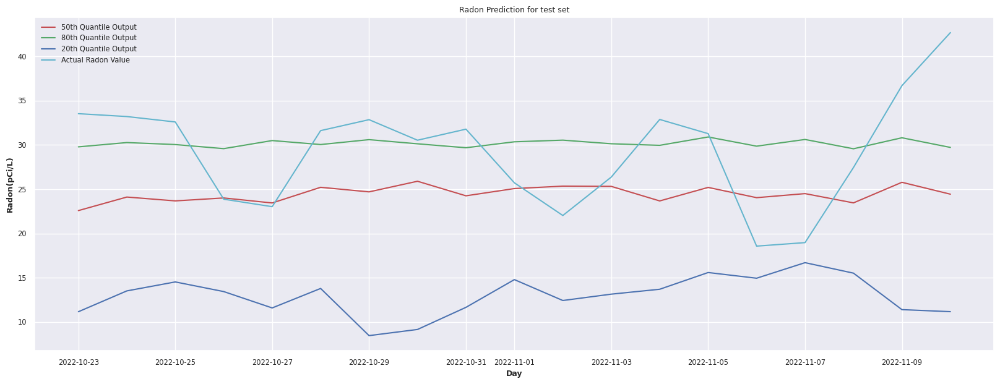

In [53]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()

# Radon 9

In [54]:
#using 21 as the example since it has the most data
df = df_radon['9']

In [55]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4322 entries, 0 to 4321
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     4322 non-null   object        
 1   DeviceName   4322 non-null   object        
 2   SyncDate     4322 non-null   datetime64[ns]
 3   Radon        4322 non-null   float64       
 4   eC02         4322 non-null   int64         
 5   VOC          4322 non-null   int64         
 6   Temperature  4322 non-null   int64         
 7   AirPressure  4322 non-null   float64       
 8   Humidity     4322 non-null   int64         
 9   LogIndex     4322 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 371.4+ KB


In [56]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [57]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:02:44,49,73,30.03,4.70
1,2023-02-11 17:02:44,50,69,30.07,5.50
2,2023-02-11 16:02:44,54,61,30.08,5.40
3,2023-02-11 15:02:44,55,59,30.08,6.00
4,2023-02-11 14:02:44,54,57,30.13,6.00
...,...,...,...,...,...
4317,2022-08-10 04:16:00,77,89,30.14,150.30
4318,2022-08-10 03:16:00,77,89,30.14,153.60
4319,2022-08-10 02:16:00,78,88,30.14,155.70
4320,2022-08-10 01:16:00,79,89,30.15,157.90


In [58]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [59]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-08-10,79.71,90.62,30.16,135.90
2022-08-11,78.83,90.75,30.10,137.16
2022-08-12,79.58,90.21,30.03,160.69
2022-08-13,77.96,89.79,30.07,120.67
2022-08-14,78.79,88.17,30.03,67.90
...,...,...,...,...
2023-02-07,53.57,59.91,30.27,1.45
2023-02-08,61.59,61.59,30.24,2.94
2023-02-09,62.78,69.74,30.12,2.90


In [60]:
df = df[df.index<= '2022-11-10']

In [61]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-08-10,79.71,90.62,30.16,135.90
2022-08-11,78.83,90.75,30.10,137.16
2022-08-12,79.58,90.21,30.03,160.69
2022-08-13,77.96,89.79,30.07,120.67
2022-08-14,78.79,88.17,30.03,67.90
...,...,...,...,...
2022-11-06,70.96,79.29,30.12,33.39
2022-11-07,71.00,79.50,30.25,39.27
2022-11-08,66.96,75.75,30.31,38.11


In [62]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [63]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [64]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [65]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [66]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [67]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-08-10,79.71,90.62,30.16,135.90,76.12,0.19,0.75,6.67,301.81,0.00,...,0.02,2.18,37.50,29.11,85.56,0.81,108.12,29.11,308.21,0.09
2022-08-11,78.83,90.75,30.10,137.16,75.58,0.16,0.43,3.53,304.70,0.00,...,0.05,2.21,37.53,29.05,85.81,0.77,101.78,29.05,307.19,0.06
2022-08-12,79.58,90.21,30.03,160.69,76.74,0.11,0.45,3.40,307.36,0.00,...,0.11,2.27,37.59,28.98,84.00,1.32,160.11,28.98,309.54,0.05
2022-08-13,77.96,89.79,30.07,120.67,75.14,0.26,1.09,4.25,291.06,0.00,...,0.13,2.29,37.61,29.03,79.21,1.18,145.65,29.03,306.76,0.20
2022-08-14,78.79,88.17,30.03,67.90,75.74,0.21,0.65,3.83,307.88,0.00,...,0.00,2.29,37.61,28.99,78.41,1.49,177.48,28.99,309.20,0.11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-06,70.96,79.29,30.12,33.39,70.78,0.21,0.75,10.24,294.75,0.00,...,0.00,0.05,44.85,29.07,86.35,0.58,77.47,29.07,305.12,0.12
2022-11-07,71.00,79.50,30.25,39.27,71.06,0.07,0.34,4.24,305.54,0.00,...,0.00,0.05,44.85,29.20,86.83,0.58,76.87,29.20,310.20,0.01
2022-11-08,66.96,75.75,30.31,38.11,68.04,0.26,0.96,4.63,296.07,0.00,...,0.00,0.05,44.85,29.26,69.77,0.82,102.09,29.26,308.71,0.15


In [68]:
df.dropna(inplace=True)

In [69]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-08-10,79.71,90.62,30.16,135.90,76.12,0.19,0.75,6.67,301.81,0.00,...,0.02,2.18,37.50,29.11,85.56,0.81,108.12,29.11,308.21,0.09
2022-08-11,78.83,90.75,30.10,137.16,75.58,0.16,0.43,3.53,304.70,0.00,...,0.05,2.21,37.53,29.05,85.81,0.77,101.78,29.05,307.19,0.06
2022-08-12,79.58,90.21,30.03,160.69,76.74,0.11,0.45,3.40,307.36,0.00,...,0.11,2.27,37.59,28.98,84.00,1.32,160.11,28.98,309.54,0.05
2022-08-13,77.96,89.79,30.07,120.67,75.14,0.26,1.09,4.25,291.06,0.00,...,0.13,2.29,37.61,29.03,79.21,1.18,145.65,29.03,306.76,0.20
2022-08-14,78.79,88.17,30.03,67.90,75.74,0.21,0.65,3.83,307.88,0.00,...,0.00,2.29,37.61,28.99,78.41,1.49,177.48,28.99,309.20,0.11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-06,70.96,79.29,30.12,33.39,70.78,0.21,0.75,10.24,294.75,0.00,...,0.00,0.05,44.85,29.07,86.35,0.58,77.47,29.07,305.12,0.12
2022-11-07,71.00,79.50,30.25,39.27,71.06,0.07,0.34,4.24,305.54,0.00,...,0.00,0.05,44.85,29.20,86.83,0.58,76.87,29.20,310.20,0.01
2022-11-08,66.96,75.75,30.31,38.11,68.04,0.26,0.96,4.63,296.07,0.00,...,0.00,0.05,44.85,29.26,69.77,0.82,102.09,29.26,308.71,0.15


In [70]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [71]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [72]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,69.76,78.61,30.06,63.38,67.45,0.13,0.54,3.36,296.43,0.00,0.10,0.03,0.30,1.65,42.03,29.02,77.72,29.02,304.88,0.07
std,7.62,14.56,0.10,49.22,8.11,0.12,0.49,2.50,12.64,0.01,0.28,0.10,0.52,1.24,2.25,0.10,9.98,0.10,9.92,0.08
min,51.00,53.75,29.84,0.24,45.54,0.00,0.00,0.00,258.31,0.00,0.00,0.00,0.00,0.00,37.50,28.80,54.15,28.80,267.15,0.00
25%,63.88,63.50,30.00,35.23,61.25,0.02,0.19,1.87,288.74,0.00,0.00,0.00,0.00,0.14,40.48,28.95,70.64,28.95,298.27,0.01
50%,70.29,81.97,30.06,46.72,68.04,0.11,0.46,3.40,299.35,0.00,0.00,0.00,0.00,1.99,42.52,29.01,78.96,29.01,306.57,0.05
75%,77.17,92.00,30.12,79.73,75.01,0.20,0.75,4.45,305.92,0.00,0.04,0.00,0.34,2.09,43.96,29.08,85.25,29.08,312.89,0.10
max,80.17,94.38,30.34,268.92,78.23,0.53,2.44,10.24,317.34,0.06,1.79,0.74,1.91,5.11,44.87,29.29,95.93,29.29,319.39,0.37


In [73]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [74]:
df.fillna(0, inplace=True)

In [75]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Temperature,0.60
Humidity,0.57
Outdoor h Temperature (°F),0.55
Avg Wind Direction (10 mins) (°),0.52
...,...
Avg Wind Direction (10 mins) (°)_lag_35,-0.75
Wind Direction (°)_lag_35,-0.75
Absolute Pressure (inHg)_lag_35,-0.76
Relative Pressure (inHg)_lag_35,-0.76


In [76]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Temperature 0.599964964306622
Humidity 0.5650333240875873
Outdoor h Temperature (°F) 0.5518530170013063
Avg Wind Direction (10 mins) (°) 0.5196196715827794
Wind Direction (°) 0.5126737477672937
Event Rain (in)_lag_2 0.43720879095629384
Monthly Rain (in) 0.435766208261099
Humidity (%) 0.41230019801625345
Event Rain (in)_lag_1 0.40257056755495013
Humidity_lag_1 0.3999878602268277
Monthly Rain (in)_lag_1 0.38658896315866004
Hourly Rain (in/hr)_lag_3 0.3740128145379949
Weekly Rain (in)_lag_2 0.3563324904607044
Weekly Rain (in)_lag_1 0.3470299284196123
Weekly Rain (in) 0.346561711697015
Hourly Rain (in/hr)_lag_2 0.3405631507642825
Temperature_lag_1 0.3202504323128958
Monthly Rain (in)_lag_2 0.31631899580028794
Outdoor h Temperature (°F)_lag_1 0.3070941957188777
Weekly Rain (in)_lag_3 0.2806201527402427
Humidity (%)_lag_1 0.2751923565020737
Event Rain (in)_lag_3 0.2728922345845889
Humidity_lag_2 0.25824044320995543
Hourly Rain (in/hr)_lag_8 0.24025260899211995
Hourly Rain (in/hr)_l

In [78]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[(df_corrP["Radon"]) >= 0.59]
df_corrH

,Radon
Radon,1.00
Temperature,0.60


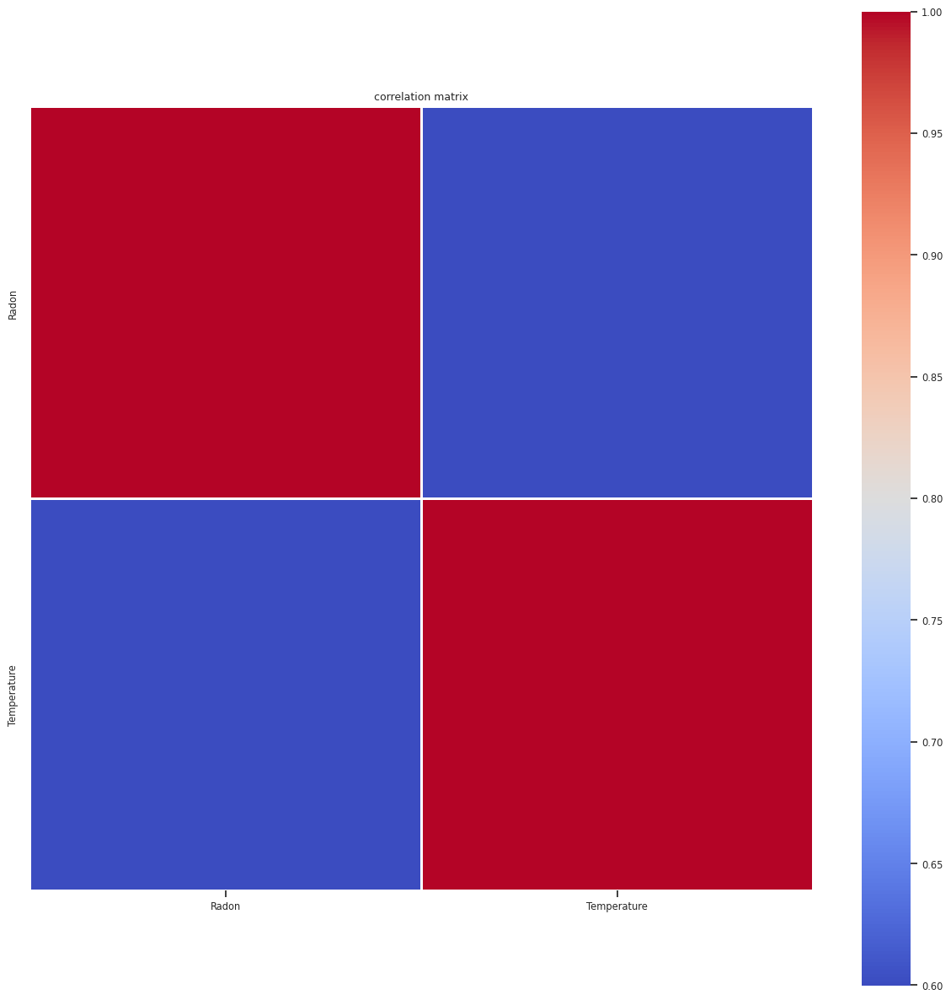

In [79]:
# correlation matrix, limited to highly correlated features
df3 = df[df_corrH.index]

idx = df3.corr().sort_values("Radon", ascending=False).index
df3_sorted = df3.loc[:, idx]  # sort dataframe columns by their correlation with Appliances

plt.figure(figsize = (15,15))
sns.set(font_scale=0.75)
ax = sns.heatmap(df3_sorted.corr().round(3), 
            annot=False, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
ax.xaxis.tick_bottom()
plt.title("correlation matrix")
plt.show()

In [80]:
df3 = df[df_corrH.index]
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-08-10 to 2022-11-10
Freq: D
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Radon        93 non-null     float32
 1   Temperature  93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [81]:
df3.fillna(0, inplace=True)

In [82]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-08-10 to 2022-11-10
Freq: D
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Radon        93 non-null     float32
 1   Temperature  93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [83]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df3["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [84]:
# create time series object for the feature columns
df_covF = df3.loc[:, df3.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['Temperature'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [85]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 1, 1)

In [86]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [87]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-08-10 00:00:00
training end: 2022-10-22 00:00:00
training duration: 73 days 00:00:00
test start: 2022-10-23 00:00:00
test end: 2022-11-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-08-10,0.50
2022-11-10,0.04


In [88]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,Temperature
SyncDate,
2022-08-10,0.98
2022-11-10,0.36


In [89]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-08-10,0.50
2022-10-22,0.16


In [90]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [91]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [92]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [93]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-23 06:14:36 (running for 00:00:00.26)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-----------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |        lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-----------+

(build_fit_tft_model pid=1525933) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525933)   rank_zero_deprecation(
(build_fit_tft_model pid=1525933) Auto select gpus: [0]
(build_fit_tft_model pid=1525933) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525933) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525933) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525933) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1525933) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1525933) 
(build_fit_tft_model pid=1525933)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1525933) ---------------

Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_0011132b,2023-02-23_07-23-14,True,,44959ad81c5e4ef0b57cd302cbd65de4,ip-172-31-10-87,10,0.287108,172.31.10.87,1602145,1.34781,4.93606,0.142651,4.93606,1677136994,0,,10,0011132b,0.00451708
build_fit_tft_model_0048a1bf,2023-02-23_07-42-13,True,,4cdfe1cc163045438b999946ec8057c1,ip-172-31-10-87,20,0.171986,172.31.10.87,1610423,0.946003,6.96844,0.174845,6.96844,1677138133,0,,20,0048a1bf,0.00425243
build_fit_tft_model_00733ffb,2023-02-23_07-44-40,True,,0fd8816c38ee49159946f9218cc5caf2,ip-172-31-10-87,10,0.224418,172.31.10.87,1611567,1.09607,4.91657,0.139625,4.91657,1677138280,0,,10,00733ffb,0.0045743
build_fit_tft_model_01a19435,2023-02-23_07-47-28,True,,0d0609efbff84d95ae9e69b8e1d1ba36,ip-172-31-10-87,40,0.160815,172.31.10.87,1612806,0.824368,8.62532,0.130505,8.62532,1677138448,0,,40,01a19435,0.00462008
build_fit_tft_model_01e09375,2023-02-23_06-19-50,True,,4e2c181daaad4eb487573843eb347c6d,ip-172-31-10-87,20,0.216277,172.31.10.87,1532223,1.00027,10.6951,0.308432,10.6951,1677133190,0,,20,01e09375,0.00635123
build_fit_tft_model_0266a08e,2023-02-23_07-11-00,True,,793b6e8b0004444c83659ae75d6dd7ff,ip-172-31-10-87,10,0.279639,172.31.10.87,1591985,1.28246,5.38944,0.171088,5.38944,1677136260,0,,10,0266a08e,0.0049448
build_fit_tft_model_030d8ea5,2023-02-23_07-54-53,True,,8f97f754c6454d2abc676660980536f7,ip-172-31-10-87,20,0.17953,172.31.10.87,1616242,0.916923,8.23901,0.234167,8.23901,1677138893,0,,20,030d8ea5,0.00435352
build_fit_tft_model_0391b663,2023-02-23_08-19-49,True,,a6ce5d8bdd5341509d4ecd8f6adf0a28,ip-172-31-10-87,20,0.157605,172.31.10.87,1627686,0.879369,5.96741,0.115156,5.96741,1677140389,0,,20,0391b663,0.00449634
build_fit_tft_model_0447e506,2023-02-23_08-14-24,True,,fedf47a291ed4ce5b7a9ff276c5d53a3,ip-172-31-10-87,10,0.230332,172.31.10.87,1625119,1.10976,4.7202,0.124263,4.7202,1677140064,0,,10,0447e506,0.00446367
build_fit_tft_model_0508702b,2023-02-23_07-41-43,True,,41c6430e1aae420193f2269c92922e10,ip-172-31-10-87,40,0.0751085,172.31.10.87,1610197,0.708986,9.75385,0.143178,9.75385,1677138103,0,,40,0508702b,0.00468969


== Status ==
Current time: 2023-02-23 06:14:49 (running for 00:00:14.07)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 68069e4d with sMAPE=1.8578099012374878 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 10, 'dropout': 0.34084386454772175, 'lr': 0.06300855252237098, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---------+---------+----------------------+
| Trial name                   | status 

(build_fit_tft_model pid=1526416) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526416)   rank_zero_deprecation(
(build_fit_tft_model pid=1526416) Auto select gpus: [0]
(build_fit_tft_model pid=1526416) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526416) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526416) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526416) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526416) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526416) 
(build_fit_tft_model pid=1526416)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526416) ---------------

== Status ==
Current time: 2023-02-23 06:15:12 (running for 00:00:36.48)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.609896183013916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 68069e4d with sMAPE=1.0253270864486694 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 10, 'dropout': 0.34084386454772175, 'lr': 0.06300855252237098, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+---------+------------------

(build_fit_tft_model pid=1526827) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526827)   rank_zero_deprecation(
(build_fit_tft_model pid=1526827) Auto select gpus: [0]
(build_fit_tft_model pid=1526827) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526827) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526827) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526827) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526827) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526827) 
(build_fit_tft_model pid=1526827)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526827) ---------------

== Status ==
Current time: 2023-02-23 06:15:32 (running for 00:00:56.46)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8091912865638733 | Iter 10.000: -1.1879337131977081
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------------

(build_fit_tft_model pid=1527232) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527232)   rank_zero_deprecation(
(build_fit_tft_model pid=1527232) Auto select gpus: [0]
(build_fit_tft_model pid=1527232) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527232) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527232) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527232) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1527232) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1527232) 
(build_fit_tft_model pid=1527232)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1527232) ---------------

== Status ==
Current time: 2023-02-23 06:15:49 (running for 00:01:13.82)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8091912865638733 | Iter 10.000: -1.2462680339813232
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------------

(build_fit_tft_model pid=1527608) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1527608)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1527608) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527608)   rank_zero_deprecation(
(build_fit_tft_model pid=1527608) Auto select gpus: [0]
(build_fit_tft_model pid=1527608) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527608) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527608) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527608) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:16:06 (running for 00:01:31.07)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8091912865638733 | Iter 10.000: -1.2935227155685425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------------

(build_fit_tft_model pid=1528053) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1528053)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1528053) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528053)   rank_zero_deprecation(
(build_fit_tft_model pid=1528053) Auto select gpus: [0]
(build_fit_tft_model pid=1528053) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528053) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528053) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528053) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:16:24 (running for 00:01:48.77)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8091912865638733 | Iter 10.000: -1.3407773971557617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------------

(build_fit_tft_model pid=1528504) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528504)   rank_zero_deprecation(
(build_fit_tft_model pid=1528504) Auto select gpus: [0]
(build_fit_tft_model pid=1528504) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528504) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528504) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528504) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1528504) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1528504) 
(build_fit_tft_model pid=1528504)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1528504) ---------------

== Status ==
Current time: 2023-02-23 06:16:47 (running for 00:02:11.43)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.3364286422729492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------------

(build_fit_tft_model pid=1528945) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528945)   rank_zero_deprecation(
(build_fit_tft_model pid=1528945) Auto select gpus: [0]
(build_fit_tft_model pid=1528945) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528945) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528945) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528945) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1528945) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1528945) 
(build_fit_tft_model pid=1528945)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1528945) ---------------

== Status ==
Current time: 2023-02-23 06:17:06 (running for 00:02:30.34)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.9602338075637817 | Iter 10.000: -1.3320798873901367
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------------

(build_fit_tft_model pid=1529343) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529343)   rank_zero_deprecation(
(build_fit_tft_model pid=1529343) Auto select gpus: [0]
(build_fit_tft_model pid=1529343) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529343) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529343) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529343) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529343) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529343) 
(build_fit_tft_model pid=1529343)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529343) ---------------

== Status ==
Current time: 2023-02-23 06:17:24 (running for 00:02:48.48)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -1.056016206741333 | Iter 10.000: -1.295744001865387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-----------------

(build_fit_tft_model pid=1529759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529759)   rank_zero_deprecation(
(build_fit_tft_model pid=1529759) Auto select gpus: [0]
(build_fit_tft_model pid=1529759) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529759) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529759) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529759) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529759) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529759) 
(build_fit_tft_model pid=1529759)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529759) ---------------

== Status ==
Current time: 2023-02-23 06:17:42 (running for 00:03:06.52)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -1.1169335842132568 | Iter 10.000: -1.2594081163406372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+---------------

== Status ==
Current time: 2023-02-23 06:17:57 (running for 00:03:21.89)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0872937440872192 | Iter 20.000: -1.056016206741333 | Iter 10.000: -1.2528380751609802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-

(build_fit_tft_model pid=1530446) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1530446)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1530446) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530446)   rank_zero_deprecation(
(build_fit_tft_model pid=1530446) Auto select gpus: [0]
(build_fit_tft_model pid=1530446) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530446) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530446) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530446) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:18:16 (running for 00:03:40.64)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0872937440872192 | Iter 20.000: -1.056016206741333 | Iter 10.000: -1.2528380751609802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1530856) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530856)   rank_zero_deprecation(
(build_fit_tft_model pid=1530856) Auto select gpus: [0]
(build_fit_tft_model pid=1530856) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530856) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530856) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530856) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1530856) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1530856) 
(build_fit_tft_model pid=1530856)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1530856) ---------------

== Status ==
Current time: 2023-02-23 06:18:34 (running for 00:03:59.18)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0872937440872192 | Iter 20.000: -1.056016206741333 | Iter 10.000: -1.2594081163406372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1531262) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531262)   rank_zero_deprecation(
(build_fit_tft_model pid=1531262) Auto select gpus: [0]
(build_fit_tft_model pid=1531262) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531262) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531262) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531262) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531262) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531262) 
(build_fit_tft_model pid=1531262)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531262) ---------------

== Status ==
Current time: 2023-02-23 06:18:50 (running for 00:04:14.71)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0872937440872192 | Iter 20.000: -1.056016206741333 | Iter 10.000: -1.295744001865387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-

== Status ==
Current time: 2023-02-23 06:19:00 (running for 00:04:25.01)
Memory usage on this node: 33.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0872937440872192 | Iter 20.000: -0.9602338075637817 | Iter 10.000: -1.2594081163406372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1531619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531619)   rank_zero_deprecation(
(build_fit_tft_model pid=1531619) Auto select gpus: [0]
(build_fit_tft_model pid=1531619) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531619) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531619) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531619) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531619) 
(build_fit_tft_model pid=1531619)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531619) ---------------

== Status ==
Current time: 2023-02-23 06:19:16 (running for 00:04:40.97)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.117077887058258 | Iter 20.000: -0.9602338075637817 | Iter 10.000: -1.2594081163406372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-23 06:19:27 (running for 00:04:51.29)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.117077887058258 | Iter 20.000: -0.9524939060211182 | Iter 10.000: -1.2528380751609802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1532223) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532223)   rank_zero_deprecation(
(build_fit_tft_model pid=1532223) Auto select gpus: [0]
(build_fit_tft_model pid=1532223) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532223) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532223) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532223) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1532223) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1532223) 
(build_fit_tft_model pid=1532223)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1532223) ---------------

== Status ==
Current time: 2023-02-23 06:19:44 (running for 00:05:08.68)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0872937440872192 | Iter 20.000: -0.9524939060211182 | Iter 10.000: -1.2528380751609802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 06:19:55 (running for 00:05:19.78)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0872937440872192 | Iter 20.000: -0.9763811230659485 | Iter 10.000: -1.2462680339813232
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1532705) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532705)   rank_zero_deprecation(
(build_fit_tft_model pid=1532705) Auto select gpus: [0]
(build_fit_tft_model pid=1532705) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532705) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532705) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532705) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1532705) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1532705) 
(build_fit_tft_model pid=1532705)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1532705) ---------------

== Status ==
Current time: 2023-02-23 06:20:05 (running for 00:05:29.34)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0872937440872192 | Iter 20.000: -0.9763811230659485 | Iter 10.000: -1.2462680339813232
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1533115) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533115)   rank_zero_deprecation(
(build_fit_tft_model pid=1533115) Auto select gpus: [0]
(build_fit_tft_model pid=1533115) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533115) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533115) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533115) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533115) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533115) 
(build_fit_tft_model pid=1533115)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533115) ---------------

== Status ==
Current time: 2023-02-23 06:20:20 (running for 00:05:45.19)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0872937440872192 | Iter 20.000: -0.9763811230659485 | Iter 10.000: -1.2528380751609802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b4c52cf2 with sMAPE=0.737765908241272 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.3694323662419783, 'lr': 0.006175330136838074, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 06:20:34 (running for 00:05:58.79)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9164208769798279 | Iter 20.000: -0.9524939060211182 | Iter 10.000: -1.2462680339813232
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1533556) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533556)   rank_zero_deprecation(
(build_fit_tft_model pid=1533556) Auto select gpus: [0]
(build_fit_tft_model pid=1533556) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533556) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533556) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533556) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533556) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533556) 
(build_fit_tft_model pid=1533556)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533556) ---------------

== Status ==
Current time: 2023-02-23 06:20:44 (running for 00:06:08.28)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9164208769798279 | Iter 20.000: -0.9524939060211182 | Iter 10.000: -1.2462680339813232
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1533987) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533987)   rank_zero_deprecation(
(build_fit_tft_model pid=1533987) Auto select gpus: [0]
(build_fit_tft_model pid=1533987) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533987) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533987) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533987) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533987) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533987) 
(build_fit_tft_model pid=1533987)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533987) ---------------

== Status ==
Current time: 2023-02-23 06:20:59 (running for 00:06:24.02)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9164208769798279 | Iter 20.000: -0.9524939060211182 | Iter 10.000: -1.2528380751609802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1534343) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534343)   rank_zero_deprecation(
(build_fit_tft_model pid=1534343) Auto select gpus: [0]
(build_fit_tft_model pid=1534343) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534343) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534343) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534343) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1534343) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1534343) 
(build_fit_tft_model pid=1534343)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1534343) ---------------

== Status ==
Current time: 2023-02-23 06:21:17 (running for 00:06:41.91)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9164208769798279 | Iter 20.000: -0.9524939060211182 | Iter 10.000: -1.2594081163406372
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:21:27 (running for 00:06:52.12)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7455480098724365 | Iter 20.000: -0.9084726572036743 | Iter 10.000: -1.2528380751609802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1534883) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534883)   rank_zero_deprecation(
(build_fit_tft_model pid=1534883) Auto select gpus: [0]
(build_fit_tft_model pid=1534883) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534883) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534883) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534883) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1534883) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1534883) 
(build_fit_tft_model pid=1534883)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1534883) ---------------

== Status ==
Current time: 2023-02-23 06:21:43 (running for 00:07:07.55)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7455480098724365 | Iter 20.000: -0.9084726572036743 | Iter 10.000: -1.2528380751609802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:21:57 (running for 00:07:21.83)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.729662150144577 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.2462680339813232
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1535377) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535377)   rank_zero_deprecation(
(build_fit_tft_model pid=1535377) Auto select gpus: [0]
(build_fit_tft_model pid=1535377) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535377) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535377) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535377) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1535377) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1535377) 
(build_fit_tft_model pid=1535377)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1535377) ---------------

== Status ==
Current time: 2023-02-23 06:22:07 (running for 00:07:31.49)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.729662150144577 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.2462680339813232
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1535816) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535816)   rank_zero_deprecation(
(build_fit_tft_model pid=1535816) Auto select gpus: [0]
(build_fit_tft_model pid=1535816) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535816) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535816) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535816) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1535816) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1535816) 
(build_fit_tft_model pid=1535816)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1535816) ---------------

== Status ==
Current time: 2023-02-23 06:22:26 (running for 00:07:50.33)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.729662150144577 | Iter 20.000: -0.9084726572036743 | Iter 10.000: -1.2278992533683777
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1536264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536264)   rank_zero_deprecation(
(build_fit_tft_model pid=1536264) Auto select gpus: [0]
(build_fit_tft_model pid=1536264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536264) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1536264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1536264) 
(build_fit_tft_model pid=1536264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1536264) ---------------

== Status ==
Current time: 2023-02-23 06:22:45 (running for 00:08:09.34)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.729662150144577 | Iter 20.000: -0.9524939060211182 | Iter 10.000: -1.2095304727554321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 06:22:55 (running for 00:08:19.56)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.9084726572036743 | Iter 10.000: -1.1533888578414917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1536758) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536758)   rank_zero_deprecation(
(build_fit_tft_model pid=1536758) Auto select gpus: [0]
(build_fit_tft_model pid=1536758) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536758) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536758) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536758) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1536758) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1536758) 
(build_fit_tft_model pid=1536758)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1536758) ---------------

== Status ==
Current time: 2023-02-23 06:23:10 (running for 00:08:34.25)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.9084726572036743 | Iter 10.000: -1.1533888578414917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 06:23:22 (running for 00:08:46.86)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1537216) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537216)   rank_zero_deprecation(
(build_fit_tft_model pid=1537216) Auto select gpus: [0]
(build_fit_tft_model pid=1537216) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537216) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537216) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537216) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1537216) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1537216) 
(build_fit_tft_model pid=1537216)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1537216) ---------------

== Status ==
Current time: 2023-02-23 06:23:32 (running for 00:08:56.21)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1537651) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537651)   rank_zero_deprecation(
(build_fit_tft_model pid=1537651) Auto select gpus: [0]
(build_fit_tft_model pid=1537651) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537651) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537651) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537651) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1537651) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1537651) 
(build_fit_tft_model pid=1537651)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1537651) ---------------

== Status ==
Current time: 2023-02-23 06:23:49 (running for 00:09:13.45)
Memory usage on this node: 29.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.1533888578414917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1538084) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538084)   rank_zero_deprecation(
(build_fit_tft_model pid=1538084) Auto select gpus: [0]
(build_fit_tft_model pid=1538084) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538084) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538084) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538084) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538084) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538084) 
(build_fit_tft_model pid=1538084)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538084) ---------------

== Status ==
Current time: 2023-02-23 06:24:06 (running for 00:09:30.73)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.2095304727554321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 06:24:21 (running for 00:09:45.89)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.882157951593399 | Iter 10.000: -1.1533888578414917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1538633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538633)   rank_zero_deprecation(
(build_fit_tft_model pid=1538633) Auto select gpus: [0]
(build_fit_tft_model pid=1538633) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538633) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538633) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538633) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538633) 
(build_fit_tft_model pid=1538633)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538633) ---------------

== Status ==
Current time: 2023-02-23 06:24:31 (running for 00:09:55.21)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.882157951593399 | Iter 10.000: -1.1533888578414917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e5382c88 with sMAPE=0.5846335887908936 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 5, 'dropout': 0.26885798350163564, 'lr': 0.01307917732574383, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

== Status ==
Current time: 2023-02-23 06:24:41 (running for 00:10:05.40)
Memory usage on this node: 32.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1539065) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539065)   rank_zero_deprecation(
(build_fit_tft_model pid=1539065) Auto select gpus: [0]
(build_fit_tft_model pid=1539065) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539065) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539065) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539065) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539065) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539065) 
(build_fit_tft_model pid=1539065)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539065) ---------------

== Status ==
Current time: 2023-02-23 06:24:55 (running for 00:10:20.05)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1539461) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539461)   rank_zero_deprecation(
(build_fit_tft_model pid=1539461) Auto select gpus: [0]
(build_fit_tft_model pid=1539461) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539461) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539461) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539461) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539461) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539461) 
(build_fit_tft_model pid=1539461)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539461) ---------------

== Status ==
Current time: 2023-02-23 06:25:14 (running for 00:10:38.92)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.882157951593399 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1539828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539828)   rank_zero_deprecation(
(build_fit_tft_model pid=1539828) Auto select gpus: [0]
(build_fit_tft_model pid=1539828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539828) 
(build_fit_tft_model pid=1539828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539828) ---------------

== Status ==
Current time: 2023-02-23 06:25:30 (running for 00:10:54.83)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.882157951593399 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1540201) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540201)   rank_zero_deprecation(
(build_fit_tft_model pid=1540201) Auto select gpus: [0]
(build_fit_tft_model pid=1540201) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540201) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540201) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540201) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1540201) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1540201) 
(build_fit_tft_model pid=1540201)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1540201) ---------------

== Status ==
Current time: 2023-02-23 06:25:46 (running for 00:11:10.73)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.882157951593399 | Iter 10.000: -1.1533888578414917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1540577) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540577)   rank_zero_deprecation(
(build_fit_tft_model pid=1540577) Auto select gpus: [0]
(build_fit_tft_model pid=1540577) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540577) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540577) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540577) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1540577) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1540577) 
(build_fit_tft_model pid=1540577)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1540577) ---------------

== Status ==
Current time: 2023-02-23 06:26:02 (running for 00:11:27.11)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.882157951593399 | Iter 10.000: -1.2095304727554321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1540936) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540936)   rank_zero_deprecation(
(build_fit_tft_model pid=1540936) Auto select gpus: [0]
(build_fit_tft_model pid=1540936) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540936) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540936) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540936) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1540936) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1540936) 
(build_fit_tft_model pid=1540936)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1540936) ---------------

== Status ==
Current time: 2023-02-23 06:26:20 (running for 00:11:44.61)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.1533888578414917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 06:26:33 (running for 00:11:57.91)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.882157951593399 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1541320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1541320)   rank_zero_deprecation(
(build_fit_tft_model pid=1541320) Auto select gpus: [0]
(build_fit_tft_model pid=1541320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1541320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1541320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1541320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1541320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1541320) 
(build_fit_tft_model pid=1541320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1541320) ---------------

== Status ==
Current time: 2023-02-23 06:26:42 (running for 00:12:06.67)
Memory usage on this node: 31.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.882157951593399 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 06:26:54 (running for 00:12:18.91)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1541747) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1541747)   rank_zero_deprecation(
(build_fit_tft_model pid=1541747) Auto select gpus: [0]
(build_fit_tft_model pid=1541747) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1541747) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1541747) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1541747) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1541747) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1541747) 
(build_fit_tft_model pid=1541747)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1541747) ---------------

== Status ==
Current time: 2023-02-23 06:27:03 (running for 00:12:27.61)
Memory usage on this node: 32.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 06:27:16 (running for 00:12:40.91)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0556199550628662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1542250) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1542250)   rank_zero_deprecation(
(build_fit_tft_model pid=1542250) Auto select gpus: [0]
(build_fit_tft_model pid=1542250) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1542250) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1542250) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1542250) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1542250) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1542250) 
(build_fit_tft_model pid=1542250)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1542250) ---------------

== Status ==
Current time: 2023-02-23 06:27:26 (running for 00:12:50.70)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0556199550628662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

== Status ==
Current time: 2023-02-23 06:27:38 (running for 00:13:02.94)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0539198517799377
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1542703) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1542703)   rank_zero_deprecation(
(build_fit_tft_model pid=1542703) Auto select gpus: [0]
(build_fit_tft_model pid=1542703) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1542703) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1542703) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1542703) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1542703) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1542703) 
(build_fit_tft_model pid=1542703)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1542703) ---------------

== Status ==
Current time: 2023-02-23 06:27:48 (running for 00:13:12.96)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0539198517799377
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1542979) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1542979)   rank_zero_deprecation(
(build_fit_tft_model pid=1542979) Auto select gpus: [0]
(build_fit_tft_model pid=1542979) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1542979) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1542979) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1542979) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1542979) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1542979) 
(build_fit_tft_model pid=1542979)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1542979) ---------------

== Status ==
Current time: 2023-02-23 06:28:07 (running for 00:13:31.20)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0556199550628662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1543401) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1543401)   rank_zero_deprecation(
(build_fit_tft_model pid=1543401) Auto select gpus: [0]
(build_fit_tft_model pid=1543401) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1543401) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1543401) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1543401) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1543401) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1543401) 
(build_fit_tft_model pid=1543401)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1543401) ---------------

== Status ==
Current time: 2023-02-23 06:28:24 (running for 00:13:48.22)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1543831) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1543831)   rank_zero_deprecation(
(build_fit_tft_model pid=1543831) Auto select gpus: [0]
(build_fit_tft_model pid=1543831) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1543831) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1543831) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1543831) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1543831) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1543831) 
(build_fit_tft_model pid=1543831)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1543831) ---------------

== Status ==
Current time: 2023-02-23 06:28:40 (running for 00:14:04.33)
Memory usage on this node: 33.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1544034) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544034)   rank_zero_deprecation(
(build_fit_tft_model pid=1544034) Auto select gpus: [0]
(build_fit_tft_model pid=1544034) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544034) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544034) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544034) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1544034) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544034) 
(build_fit_tft_model pid=1544034)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544034) ---------------

== Status ==
Current time: 2023-02-23 06:28:59 (running for 00:14:23.27)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1544425) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544425)   rank_zero_deprecation(
(build_fit_tft_model pid=1544425) Auto select gpus: [0]
(build_fit_tft_model pid=1544425) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544425) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544425) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544425) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1544425) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544425) 
(build_fit_tft_model pid=1544425)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544425) ---------------

== Status ==
Current time: 2023-02-23 06:29:15 (running for 00:14:39.92)
Memory usage on this node: 31.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1544855) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544855)   rank_zero_deprecation(
(build_fit_tft_model pid=1544855) Auto select gpus: [0]
(build_fit_tft_model pid=1544855) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544855) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544855) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544855) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1544855) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544855) 
(build_fit_tft_model pid=1544855)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544855) ---------------

== Status ==
Current time: 2023-02-23 06:29:35 (running for 00:15:00.11)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

== Status ==
Current time: 2023-02-23 06:29:46 (running for 00:15:10.91)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.716372549533844 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0556199550628662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1545308) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545308)   rank_zero_deprecation(
(build_fit_tft_model pid=1545308) Auto select gpus: [0]
(build_fit_tft_model pid=1545308) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545308) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545308) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545308) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1545308) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545308) 
(build_fit_tft_model pid=1545308)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545308) ---------------

== Status ==
Current time: 2023-02-23 06:30:07 (running for 00:15:31.92)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0556199550628662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1545733) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545733)   rank_zero_deprecation(
(build_fit_tft_model pid=1545733) Auto select gpus: [0]
(build_fit_tft_model pid=1545733) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545733) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545733) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545733) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1545733) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545733) 
(build_fit_tft_model pid=1545733)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545733) ---------------

== Status ==
Current time: 2023-02-23 06:30:25 (running for 00:15:49.65)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1546137) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546137)   rank_zero_deprecation(
(build_fit_tft_model pid=1546137) Auto select gpus: [0]
(build_fit_tft_model pid=1546137) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546137) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546137) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546137) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546137) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546137) 
(build_fit_tft_model pid=1546137)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546137) ---------------

== Status ==
Current time: 2023-02-23 06:30:41 (running for 00:16:05.96)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1546483) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546483)   rank_zero_deprecation(
(build_fit_tft_model pid=1546483) Auto select gpus: [0]
(build_fit_tft_model pid=1546483) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546483) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546483) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546483) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546483) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546483) 
(build_fit_tft_model pid=1546483)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546483) ---------------

== Status ==
Current time: 2023-02-23 06:30:58 (running for 00:16:22.71)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:31:09 (running for 00:16:33.99)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0556199550628662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1546968) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546968)   rank_zero_deprecation(
(build_fit_tft_model pid=1546968) Auto select gpus: [0]
(build_fit_tft_model pid=1546968) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546968) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546968) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546968) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546968) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546968) 
(build_fit_tft_model pid=1546968)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546968) ---------------

== Status ==
Current time: 2023-02-23 06:31:19 (running for 00:16:43.61)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0556199550628662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1547375) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1547375)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1547375) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547375)   rank_zero_deprecation(
(build_fit_tft_model pid=1547375) Auto select gpus: [0]
(build_fit_tft_model pid=1547375) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547375) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547375) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547375) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:31:38 (running for 00:17:02.39)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1547759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1547759)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1547759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547759)   rank_zero_deprecation(
(build_fit_tft_model pid=1547759) Auto select gpus: [0]
(build_fit_tft_model pid=1547759) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547759) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547759) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547759) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:31:56 (running for 00:17:20.79)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1548148) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548148)   rank_zero_deprecation(
(build_fit_tft_model pid=1548148) Auto select gpus: [0]
(build_fit_tft_model pid=1548148) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548148) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548148) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548148) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1548148) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1548148) 
(build_fit_tft_model pid=1548148)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1548148) ---------------

== Status ==
Current time: 2023-02-23 06:32:13 (running for 00:17:38.04)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.1277868151664734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:32:25 (running for 00:17:50.02)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1548585) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548585)   rank_zero_deprecation(
(build_fit_tft_model pid=1548585) Auto select gpus: [0]
(build_fit_tft_model pid=1548585) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548585) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548585) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548585) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1548585) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1548585) 
(build_fit_tft_model pid=1548585)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1548585) ---------------

== Status ==
Current time: 2023-02-23 06:32:35 (running for 00:17:59.40)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:32:48 (running for 00:18:13.04)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.731405109167099 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1549092) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549092)   rank_zero_deprecation(
(build_fit_tft_model pid=1549092) Auto select gpus: [0]
(build_fit_tft_model pid=1549092) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549092) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549092) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549092) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549092) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549092) 
(build_fit_tft_model pid=1549092)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549092) ---------------

== Status ==
Current time: 2023-02-23 06:32:58 (running for 00:18:22.93)
Memory usage on this node: 32.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.731405109167099 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1549413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549413)   rank_zero_deprecation(
(build_fit_tft_model pid=1549413) Auto select gpus: [0]
(build_fit_tft_model pid=1549413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549413) 
(build_fit_tft_model pid=1549413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549413) ---------------

== Status ==
Current time: 2023-02-23 06:33:18 (running for 00:18:42.80)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.731405109167099 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0556199550628662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1549834) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549834)   rank_zero_deprecation(
(build_fit_tft_model pid=1549834) Auto select gpus: [0]
(build_fit_tft_model pid=1549834) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549834) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549834) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549834) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549834) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549834) 
(build_fit_tft_model pid=1549834)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549834) ---------------

== Status ==
Current time: 2023-02-23 06:33:37 (running for 00:19:01.77)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.731405109167099 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.0539198517799377
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1550207) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550207)   rank_zero_deprecation(
(build_fit_tft_model pid=1550207) Auto select gpus: [0]
(build_fit_tft_model pid=1550207) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550207) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550207) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550207) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550207) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550207) 
(build_fit_tft_model pid=1550207)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550207) ---------------

== Status ==
Current time: 2023-02-23 06:33:55 (running for 00:19:20.03)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.731405109167099 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0522197484970093
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1550520) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550520)   rank_zero_deprecation(
(build_fit_tft_model pid=1550520) Auto select gpus: [0]
(build_fit_tft_model pid=1550520) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550520) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550520) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550520) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550520) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550520) 
(build_fit_tft_model pid=1550520)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550520) ---------------

== Status ==
Current time: 2023-02-23 06:34:11 (running for 00:19:36.17)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.731405109167099 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0539198517799377
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1550877) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550877)   rank_zero_deprecation(
(build_fit_tft_model pid=1550877) Auto select gpus: [0]
(build_fit_tft_model pid=1550877) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550877) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550877) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550877) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550877) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550877) 
(build_fit_tft_model pid=1550877)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550877) ---------------

== Status ==
Current time: 2023-02-23 06:34:28 (running for 00:19:52.38)
Memory usage on this node: 32.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.731405109167099 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0556199550628662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1551164) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551164)   rank_zero_deprecation(
(build_fit_tft_model pid=1551164) Auto select gpus: [0]
(build_fit_tft_model pid=1551164) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551164) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551164) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551164) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1551164) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1551164) 
(build_fit_tft_model pid=1551164)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1551164) ---------------

== Status ==
Current time: 2023-02-23 06:34:46 (running for 00:20:10.50)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.731405109167099 | Iter 20.000: -0.900822788476944 | Iter 10.000: -1.0539198517799377
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1551527) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551527)   rank_zero_deprecation(
(build_fit_tft_model pid=1551527) Auto select gpus: [0]
(build_fit_tft_model pid=1551527) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551527) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551527) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551527) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1551527) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1551527) 
(build_fit_tft_model pid=1551527)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1551527) ---------------

== Status ==
Current time: 2023-02-23 06:35:02 (running for 00:20:26.52)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.731405109167099 | Iter 20.000: -0.900822788476944 | Iter 10.000: -1.0556199550628662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1551902) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551902)   rank_zero_deprecation(
(build_fit_tft_model pid=1551902) Auto select gpus: [0]
(build_fit_tft_model pid=1551902) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551902) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551902) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551902) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1551902) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1551902) 
(build_fit_tft_model pid=1551902)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1551902) ---------------

== Status ==
Current time: 2023-02-23 06:35:19 (running for 00:20:43.89)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.731405109167099 | Iter 20.000: -0.900822788476944 | Iter 10.000: -1.0764335989952087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:35:29 (running for 00:20:54.13)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0572489500045776
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 88b79a84 with sMAPE=0.5737106204032898 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.1702150954796068, 'lr': 0.006689241812216261, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1552548) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552548)   rank_zero_deprecation(
(build_fit_tft_model pid=1552548) Auto select gpus: [0]
(build_fit_tft_model pid=1552548) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552548) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552548) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552548) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1552548) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1552548) 
(build_fit_tft_model pid=1552548)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1552548) ---------------

== Status ==
Current time: 2023-02-23 06:35:49 (running for 00:21:13.22)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0572489500045776
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1552930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552930)   rank_zero_deprecation(
(build_fit_tft_model pid=1552930) Auto select gpus: [0]
(build_fit_tft_model pid=1552930) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552930) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552930) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552930) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1552930) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1552930) 
(build_fit_tft_model pid=1552930)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1552930) ---------------

== Status ==
Current time: 2023-02-23 06:36:06 (running for 00:21:30.75)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0772480964660645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1553261) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1553261)   rank_zero_deprecation(
(build_fit_tft_model pid=1553261) Auto select gpus: [0]
(build_fit_tft_model pid=1553261) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1553261) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1553261) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1553261) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1553261) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1553261) 
(build_fit_tft_model pid=1553261)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1553261) ---------------

== Status ==
Current time: 2023-02-23 06:36:23 (running for 00:21:47.89)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1553606) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1553606)   rank_zero_deprecation(
(build_fit_tft_model pid=1553606) Auto select gpus: [0]
(build_fit_tft_model pid=1553606) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1553606) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1553606) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1553606) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1553606) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1553606) 
(build_fit_tft_model pid=1553606)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1553606) ---------------

== Status ==
Current time: 2023-02-23 06:36:41 (running for 00:22:05.23)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.1271748542785645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1554023) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554023)   rank_zero_deprecation(
(build_fit_tft_model pid=1554023) Auto select gpus: [0]
(build_fit_tft_model pid=1554023) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554023) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554023) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554023) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1554023) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1554023) 
(build_fit_tft_model pid=1554023)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1554023) ---------------

== Status ==
Current time: 2023-02-23 06:36:57 (running for 00:22:21.74)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.1571024656295776
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1554445) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554445)   rank_zero_deprecation(
(build_fit_tft_model pid=1554445) Auto select gpus: [0]
(build_fit_tft_model pid=1554445) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554445) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554445) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554445) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1554445) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1554445) 
(build_fit_tft_model pid=1554445)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1554445) ---------------

== Status ==
Current time: 2023-02-23 06:37:13 (running for 00:22:38.11)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.1577144265174866
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1554783) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554783)   rank_zero_deprecation(
(build_fit_tft_model pid=1554783) Auto select gpus: [0]
(build_fit_tft_model pid=1554783) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554783) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554783) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554783) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1554783) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1554783) 
(build_fit_tft_model pid=1554783)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1554783) ---------------

== Status ==
Current time: 2023-02-23 06:37:30 (running for 00:22:54.54)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.1583263874053955
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1555134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555134)   rank_zero_deprecation(
(build_fit_tft_model pid=1555134) Auto select gpus: [0]
(build_fit_tft_model pid=1555134) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555134) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555134) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555134) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1555134) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555134) 
(build_fit_tft_model pid=1555134)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555134) ---------------

== Status ==
Current time: 2023-02-23 06:37:46 (running for 00:23:10.92)
Memory usage on this node: 31.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.1600660681724548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1555431) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555431)   rank_zero_deprecation(
(build_fit_tft_model pid=1555431) Auto select gpus: [0]
(build_fit_tft_model pid=1555431) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555431) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555431) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555431) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 06:38:03 (running for 00:23:27.42)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.1618057489395142
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1555431) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555431) 
(build_fit_tft_model pid=1555431)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555431) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1555431) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1555431) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1555431) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1555431) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1555431) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1555431) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 06:38:12 (running for 00:23:37.15)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.1672623753547668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1555827) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555827)   rank_zero_deprecation(
(build_fit_tft_model pid=1555827) Auto select gpus: [0]
(build_fit_tft_model pid=1555827) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555827) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555827) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555827) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1555827) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555827) 
(build_fit_tft_model pid=1555827)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555827) ---------------

== Status ==
Current time: 2023-02-23 06:38:22 (running for 00:23:46.48)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8998644948005676 | Iter 10.000: -1.1672623753547668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:38:34 (running for 00:23:59.17)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7256170511245728 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.1618057489395142
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1556352) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556352)   rank_zero_deprecation(
(build_fit_tft_model pid=1556352) Auto select gpus: [0]
(build_fit_tft_model pid=1556352) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556352) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556352) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556352) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1556352) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556352) 
(build_fit_tft_model pid=1556352)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556352) ---------------

== Status ==
Current time: 2023-02-23 06:38:44 (running for 00:24:08.93)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7256170511245728 | Iter 20.000: -0.8838278353214264 | Iter 10.000: -1.1618057489395142
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:38:58 (running for 00:24:22.27)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7256170511245728 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.1600660681724548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1556766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556766)   rank_zero_deprecation(
(build_fit_tft_model pid=1556766) Auto select gpus: [0]
(build_fit_tft_model pid=1556766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1556766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556766) 
(build_fit_tft_model pid=1556766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556766) ---------------

== Status ==
Current time: 2023-02-23 06:39:08 (running for 00:24:33.09)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7256170511245728 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.1600660681724548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1557145) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1557145)   rank_zero_deprecation(
(build_fit_tft_model pid=1557145) Auto select gpus: [0]
(build_fit_tft_model pid=1557145) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1557145) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1557145) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1557145) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1557145) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1557145) 
(build_fit_tft_model pid=1557145)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1557145) ---------------

== Status ==
Current time: 2023-02-23 06:39:28 (running for 00:24:52.55)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7256170511245728 | Iter 20.000: -0.8802764713764191 | Iter 10.000: -1.1583263874053955
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:39:38 (running for 00:25:02.75)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.1577144265174866
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1557600) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1557600)   rank_zero_deprecation(
(build_fit_tft_model pid=1557600) Auto select gpus: [0]
(build_fit_tft_model pid=1557600) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1557600) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1557600) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1557600) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1557600) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1557600) 
(build_fit_tft_model pid=1557600)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1557600) ---------------

== Status ==
Current time: 2023-02-23 06:39:55 (running for 00:25:19.32)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.1577144265174866
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:40:05 (running for 00:25:29.47)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.1571024656295776
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1558135) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558135)   rank_zero_deprecation(
(build_fit_tft_model pid=1558135) Auto select gpus: [0]
(build_fit_tft_model pid=1558135) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558135) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558135) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558135) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558135) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558135) 
(build_fit_tft_model pid=1558135)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558135) ---------------

== Status ==
Current time: 2023-02-23 06:40:24 (running for 00:25:48.51)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.1571024656295776
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1558517) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558517)   rank_zero_deprecation(
(build_fit_tft_model pid=1558517) Auto select gpus: [0]
(build_fit_tft_model pid=1558517) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558517) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558517) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558517) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 06:40:44 (running for 00:26:08.20)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.1271748542785645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1558517) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558517) 
(build_fit_tft_model pid=1558517)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558517) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1558517) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1558517) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1558517) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1558517) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1558517) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1558517) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 06:40:49 (running for 00:26:13.43)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1558965) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558965)   rank_zero_deprecation(
(build_fit_tft_model pid=1558965) Auto select gpus: [0]
(build_fit_tft_model pid=1558965) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558965) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558965) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558965) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558965) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558965) 
(build_fit_tft_model pid=1558965)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558965) ---------------

== Status ==
Current time: 2023-02-23 06:41:05 (running for 00:26:29.26)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8746857345104218 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:41:15 (running for 00:26:40.19)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8815802931785583 | Iter 10.000: -1.0819761753082275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1559316) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559316)   rank_zero_deprecation(
(build_fit_tft_model pid=1559316) Auto select gpus: [0]
(build_fit_tft_model pid=1559316) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559316) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559316) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559316) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1559316) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1559316) 
(build_fit_tft_model pid=1559316)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1559316) ---------------

== Status ==
Current time: 2023-02-23 06:41:25 (running for 00:26:50.14)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8815802931785583 | Iter 10.000: -1.0819761753082275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:41:36 (running for 00:27:00.87)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8746857345104218 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1559791) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559791)   rank_zero_deprecation(
(build_fit_tft_model pid=1559791) Auto select gpus: [0]
(build_fit_tft_model pid=1559791) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559791) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559791) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559791) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1559791) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1559791) 
(build_fit_tft_model pid=1559791)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1559791) ---------------

== Status ==
Current time: 2023-02-23 06:41:53 (running for 00:27:17.65)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8746857345104218 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1560115) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560115)   rank_zero_deprecation(
(build_fit_tft_model pid=1560115) Auto select gpus: [0]
(build_fit_tft_model pid=1560115) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560115) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560115) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560115) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1560115) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1560115) 
(build_fit_tft_model pid=1560115)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1560115) ---------------

== Status ==
Current time: 2023-02-23 06:42:11 (running for 00:27:35.20)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7189688086509705 | Iter 20.000: -0.8746857345104218 | Iter 10.000: -1.0819761753082275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:42:21 (running for 00:27:45.30)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1560655) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560655)   rank_zero_deprecation(
(build_fit_tft_model pid=1560655) Auto select gpus: [0]
(build_fit_tft_model pid=1560655) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560655) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560655) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560655) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1560655) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1560655) 
(build_fit_tft_model pid=1560655)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1560655) ---------------

== Status ==
Current time: 2023-02-23 06:42:40 (running for 00:28:04.62)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1561093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561093)   rank_zero_deprecation(
(build_fit_tft_model pid=1561093) Auto select gpus: [0]
(build_fit_tft_model pid=1561093) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561093) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561093) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561093) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561093) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561093) 
(build_fit_tft_model pid=1561093)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561093) ---------------

== Status ==
Current time: 2023-02-23 06:42:57 (running for 00:28:21.62)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0819761753082275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1561410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561410)   rank_zero_deprecation(
(build_fit_tft_model pid=1561410) Auto select gpus: [0]
(build_fit_tft_model pid=1561410) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561410) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561410) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561410) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561410) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561410) 
(build_fit_tft_model pid=1561410)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561410) ---------------

== Status ==
Current time: 2023-02-23 06:43:14 (running for 00:28:38.62)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7185422778129578 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:43:29 (running for 00:28:53.26)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7181157469749451 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0819761753082275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1562017) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562017)   rank_zero_deprecation(
(build_fit_tft_model pid=1562017) Auto select gpus: [0]
(build_fit_tft_model pid=1562017) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562017) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562017) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562017) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562017) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562017) 
(build_fit_tft_model pid=1562017)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562017) ---------------

== Status ==
Current time: 2023-02-23 06:43:38 (running for 00:29:02.90)
Memory usage on this node: 31.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7181157469749451 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0819761753082275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1562307) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562307)   rank_zero_deprecation(
(build_fit_tft_model pid=1562307) Auto select gpus: [0]
(build_fit_tft_model pid=1562307) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562307) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562307) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562307) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562307) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562307) 
(build_fit_tft_model pid=1562307)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562307) ---------------

== Status ==
Current time: 2023-02-23 06:43:55 (running for 00:29:19.74)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7181157469749451 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1562710) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562710)   rank_zero_deprecation(
(build_fit_tft_model pid=1562710) Auto select gpus: [0]
(build_fit_tft_model pid=1562710) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562710) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562710) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562710) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562710) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562710) 
(build_fit_tft_model pid=1562710)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562710) ---------------

== Status ==
Current time: 2023-02-23 06:44:12 (running for 00:29:36.66)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7181157469749451 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.1147897839546204
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1563133) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1563133)   rank_zero_deprecation(
(build_fit_tft_model pid=1563133) Auto select gpus: [0]
(build_fit_tft_model pid=1563133) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1563133) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1563133) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1563133) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 06:44:29 (running for 00:29:54.14)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7181157469749451 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.1323323249816895
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1563133) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1563133) 
(build_fit_tft_model pid=1563133)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1563133) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1563133) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1563133) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1563133) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1563133) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1563133) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1563133) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 06:44:35 (running for 00:29:59.20)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7181157469749451 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.1147897839546204
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----------+---------

(build_fit_tft_model pid=1563566) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1563566)   rank_zero_deprecation(
(build_fit_tft_model pid=1563566) Auto select gpus: [0]
(build_fit_tft_model pid=1563566) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1563566) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1563566) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1563566) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1563566) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1563566) 
(build_fit_tft_model pid=1563566)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1563566) ---------------

== Status ==
Current time: 2023-02-23 06:44:49 (running for 00:30:13.59)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7181157469749451 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.1147897839546204
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1563891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1563891)   rank_zero_deprecation(
(build_fit_tft_model pid=1563891) Auto select gpus: [0]
(build_fit_tft_model pid=1563891) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1563891) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1563891) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1563891) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1563891) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1563891) 
(build_fit_tft_model pid=1563891)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1563891) ---------------

== Status ==
Current time: 2023-02-23 06:45:06 (running for 00:30:30.22)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7181157469749451 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.1274267435073853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:45:21 (running for 00:30:45.28)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7159460186958313 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.1123369932174683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1564397) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564397)   rank_zero_deprecation(
(build_fit_tft_model pid=1564397) Auto select gpus: [0]
(build_fit_tft_model pid=1564397) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564397) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564397) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564397) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564397) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564397) 
(build_fit_tft_model pid=1564397)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564397) ---------------

== Status ==
Current time: 2023-02-23 06:45:29 (running for 00:30:53.94)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7159460186958313 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.1123369932174683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1564769) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564769)   rank_zero_deprecation(
(build_fit_tft_model pid=1564769) Auto select gpus: [0]
(build_fit_tft_model pid=1564769) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564769) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564769) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564769) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564769) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564769) 
(build_fit_tft_model pid=1564769)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564769) ---------------

== Status ==
Current time: 2023-02-23 06:45:49 (running for 00:31:14.10)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7159460186958313 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:46:04 (running for 00:31:28.31)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.094155192375183
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----------

(build_fit_tft_model pid=1565246) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565246)   rank_zero_deprecation(
(build_fit_tft_model pid=1565246) Auto select gpus: [0]
(build_fit_tft_model pid=1565246) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565246) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565246) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565246) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1565246) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1565246) 
(build_fit_tft_model pid=1565246)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1565246) ---------------

== Status ==
Current time: 2023-02-23 06:46:13 (running for 00:31:37.38)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.094155192375183
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----------

(build_fit_tft_model pid=1565637) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565637)   rank_zero_deprecation(
(build_fit_tft_model pid=1565637) Auto select gpus: [0]
(build_fit_tft_model pid=1565637) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565637) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565637) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565637) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1565637) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1565637) 
(build_fit_tft_model pid=1565637)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1565637) ---------------

== Status ==
Current time: 2023-02-23 06:46:31 (running for 00:31:55.20)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

== Status ==
Current time: 2023-02-23 06:46:43 (running for 00:32:07.32)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.094155192375183
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----------

(build_fit_tft_model pid=1566124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566124)   rank_zero_deprecation(
(build_fit_tft_model pid=1566124) Auto select gpus: [0]
(build_fit_tft_model pid=1566124) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566124) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566124) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566124) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566124) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566124) 
(build_fit_tft_model pid=1566124)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566124) ---------------

== Status ==
Current time: 2023-02-23 06:46:51 (running for 00:32:16.09)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.094155192375183
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----------

(build_fit_tft_model pid=1566365) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566365)   rank_zero_deprecation(
(build_fit_tft_model pid=1566365) Auto select gpus: [0]
(build_fit_tft_model pid=1566365) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566365) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566365) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566365) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566365) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566365) 
(build_fit_tft_model pid=1566365)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566365) ---------------

== Status ==
Current time: 2023-02-23 06:47:07 (running for 00:32:31.76)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------

(build_fit_tft_model pid=1566645) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566645)   rank_zero_deprecation(
(build_fit_tft_model pid=1566645) Auto select gpus: [0]
(build_fit_tft_model pid=1566645) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566645) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566645) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566645) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566645) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566645) 
(build_fit_tft_model pid=1566645)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566645) ---------------

== Status ==
Current time: 2023-02-23 06:47:24 (running for 00:32:48.83)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.1123369932174683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1567074) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567074)   rank_zero_deprecation(
(build_fit_tft_model pid=1567074) Auto select gpus: [0]
(build_fit_tft_model pid=1567074) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567074) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567074) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567074) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1567074) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1567074) 
(build_fit_tft_model pid=1567074)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1567074) ---------------

== Status ==
Current time: 2023-02-23 06:47:42 (running for 00:33:06.60)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7137762904167175 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.1274267435073853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

== Status ==
Current time: 2023-02-23 06:47:53 (running for 00:33:17.27)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.8599234819412231 | Iter 10.000: -1.1123369932174683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----------+-------

(build_fit_tft_model pid=1567518) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567518)   rank_zero_deprecation(
(build_fit_tft_model pid=1567518) Auto select gpus: [0]
(build_fit_tft_model pid=1567518) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567518) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567518) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567518) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1567518) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1567518) 
(build_fit_tft_model pid=1567518)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1567518) ---------------

== Status ==
Current time: 2023-02-23 06:48:08 (running for 00:33:32.44)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.8599234819412231 | Iter 10.000: -1.1123369932174683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1567911) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567911)   rank_zero_deprecation(
(build_fit_tft_model pid=1567911) Auto select gpus: [0]
(build_fit_tft_model pid=1567911) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567911) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567911) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567911) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1567911) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1567911) 
(build_fit_tft_model pid=1567911)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1567911) ---------------

== Status ==
Current time: 2023-02-23 06:48:23 (running for 00:33:48.18)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.8599234819412231 | Iter 10.000: -1.1274267435073853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1568270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568270)   rank_zero_deprecation(
(build_fit_tft_model pid=1568270) Auto select gpus: [0]
(build_fit_tft_model pid=1568270) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568270) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568270) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568270) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568270) 
(build_fit_tft_model pid=1568270)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568270) ---------------

== Status ==
Current time: 2023-02-23 06:48:41 (running for 00:34:05.43)
Memory usage on this node: 31.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.8599234819412231 | Iter 10.000: -1.1298795342445374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1568536) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568536)   rank_zero_deprecation(
(build_fit_tft_model pid=1568536) Auto select gpus: [0]
(build_fit_tft_model pid=1568536) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568536) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568536) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568536) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568536) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568536) 
(build_fit_tft_model pid=1568536)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568536) ---------------

== Status ==
Current time: 2023-02-23 06:48:57 (running for 00:34:22.00)
Memory usage on this node: 30.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7136385142803192 | Iter 20.000: -0.8599234819412231 | Iter 10.000: -1.1323323249816895
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:49:12 (running for 00:34:36.33)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.1298795342445374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1568983) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568983)   rank_zero_deprecation(
(build_fit_tft_model pid=1568983) Auto select gpus: [0]
(build_fit_tft_model pid=1568983) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568983) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568983) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568983) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568983) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568983) 
(build_fit_tft_model pid=1568983)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568983) ---------------

== Status ==
Current time: 2023-02-23 06:49:21 (running for 00:34:45.62)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.1298795342445374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1569414) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1569414)   rank_zero_deprecation(
(build_fit_tft_model pid=1569414) Auto select gpus: [0]
(build_fit_tft_model pid=1569414) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1569414) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1569414) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1569414) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1569414) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1569414) 
(build_fit_tft_model pid=1569414)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1569414) ---------------

== Status ==
Current time: 2023-02-23 06:49:38 (running for 00:35:02.78)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.1323323249816895
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1569798) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1569798)   rank_zero_deprecation(
(build_fit_tft_model pid=1569798) Auto select gpus: [0]
(build_fit_tft_model pid=1569798) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1569798) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1569798) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1569798) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1569798) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1569798) 
(build_fit_tft_model pid=1569798)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1569798) ---------------

== Status ==
Current time: 2023-02-23 06:49:55 (running for 00:35:19.57)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.1335240006446838
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1570097) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570097)   rank_zero_deprecation(
(build_fit_tft_model pid=1570097) Auto select gpus: [0]
(build_fit_tft_model pid=1570097) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570097) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570097) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570097) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570097) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570097) 
(build_fit_tft_model pid=1570097)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570097) ---------------

== Status ==
Current time: 2023-02-23 06:50:13 (running for 00:35:37.54)
Memory usage on this node: 31.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8599234819412231 | Iter 10.000: -1.1323323249816895
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:50:27 (running for 00:35:51.35)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.1298795342445374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1570615) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570615)   rank_zero_deprecation(
(build_fit_tft_model pid=1570615) Auto select gpus: [0]
(build_fit_tft_model pid=1570615) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570615) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570615) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570615) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570615) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570615) 
(build_fit_tft_model pid=1570615)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570615) ---------------

== Status ==
Current time: 2023-02-23 06:50:37 (running for 00:36:01.26)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.1298795342445374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1571007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571007)   rank_zero_deprecation(
(build_fit_tft_model pid=1571007) Auto select gpus: [0]
(build_fit_tft_model pid=1571007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571007) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571007) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571007) 
(build_fit_tft_model pid=1571007)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571007) ---------------

== Status ==
Current time: 2023-02-23 06:50:54 (running for 00:36:18.73)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.1323323249816895
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1571334) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571334)   rank_zero_deprecation(
(build_fit_tft_model pid=1571334) Auto select gpus: [0]
(build_fit_tft_model pid=1571334) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571334) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571334) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571334) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571334) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571334) 
(build_fit_tft_model pid=1571334)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571334) ---------------

== Status ==
Current time: 2023-02-23 06:51:12 (running for 00:36:36.85)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8599234819412231 | Iter 10.000: -1.1298795342445374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1571731) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571731)   rank_zero_deprecation(
(build_fit_tft_model pid=1571731) Auto select gpus: [0]
(build_fit_tft_model pid=1571731) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571731) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571731) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571731) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571731) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571731) 
(build_fit_tft_model pid=1571731)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571731) ---------------

== Status ==
Current time: 2023-02-23 06:51:29 (running for 00:36:53.82)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8599234819412231 | Iter 10.000: -1.1323323249816895
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1572175) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1572175)   rank_zero_deprecation(
(build_fit_tft_model pid=1572175) Auto select gpus: [0]
(build_fit_tft_model pid=1572175) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1572175) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1572175) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1572175) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1572175) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1572175) 
(build_fit_tft_model pid=1572175)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1572175) ---------------

== Status ==
Current time: 2023-02-23 06:51:48 (running for 00:37:12.79)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.1298795342445374
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1572539) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1572539)   rank_zero_deprecation(
(build_fit_tft_model pid=1572539) Auto select gpus: [0]
(build_fit_tft_model pid=1572539) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1572539) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1572539) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1572539) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1572539) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1572539) 
(build_fit_tft_model pid=1572539)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1572539) ---------------

== Status ==
Current time: 2023-02-23 06:52:07 (running for 00:37:31.47)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.1274267435073853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1572854) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1572854)   rank_zero_deprecation(
(build_fit_tft_model pid=1572854) Auto select gpus: [0]
(build_fit_tft_model pid=1572854) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1572854) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1572854) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1572854) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1572854) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1572854) 
(build_fit_tft_model pid=1572854)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1572854) ---------------

== Status ==
Current time: 2023-02-23 06:52:24 (running for 00:37:48.47)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.1197287440299988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1573153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573153)   rank_zero_deprecation(
(build_fit_tft_model pid=1573153) Auto select gpus: [0]
(build_fit_tft_model pid=1573153) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573153) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573153) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573153) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573153) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573153) 
(build_fit_tft_model pid=1573153)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573153) ---------------

== Status ==
Current time: 2023-02-23 06:52:39 (running for 00:38:03.36)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.1274267435073853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:52:51 (running for 00:38:15.43)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.1197287440299988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1573482) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573482)   rank_zero_deprecation(
(build_fit_tft_model pid=1573482) Auto select gpus: [0]
(build_fit_tft_model pid=1573482) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573482) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573482) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573482) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573482) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573482) 
(build_fit_tft_model pid=1573482)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573482) ---------------

== Status ==
Current time: 2023-02-23 06:52:58 (running for 00:38:22.89)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.1197287440299988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:53:09 (running for 00:38:33.22)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.1120307445526123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1573857) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573857)   rank_zero_deprecation(
(build_fit_tft_model pid=1573857) Auto select gpus: [0]
(build_fit_tft_model pid=1573857) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573857) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573857) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573857) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573857) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573857) 
(build_fit_tft_model pid=1573857)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573857) ---------------

== Status ==
Current time: 2023-02-23 06:53:24 (running for 00:38:48.54)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.1120307445526123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1574121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574121)   rank_zero_deprecation(
(build_fit_tft_model pid=1574121) Auto select gpus: [0]
(build_fit_tft_model pid=1574121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1574121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1574121) 
(build_fit_tft_model pid=1574121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1574121) ---------------

== Status ==
Current time: 2023-02-23 06:53:40 (running for 00:39:04.47)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.1197287440299988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:53:52 (running for 00:39:16.45)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8609053194522858 | Iter 10.000: -1.1120307445526123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1574499) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574499)   rank_zero_deprecation(
(build_fit_tft_model pid=1574499) Auto select gpus: [0]
(build_fit_tft_model pid=1574499) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574499) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574499) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574499) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1574499) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1574499) 
(build_fit_tft_model pid=1574499)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1574499) ---------------

== Status ==
Current time: 2023-02-23 06:54:00 (running for 00:39:24.46)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8609053194522858 | Iter 10.000: -1.1120307445526123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1574860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1574860)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1574860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574860)   rank_zero_deprecation(
(build_fit_tft_model pid=1574860) Auto select gpus: [0]
(build_fit_tft_model pid=1574860) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574860) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574860) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574860) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:54:17 (running for 00:39:41.23)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8609053194522858 | Iter 10.000: -1.1197287440299988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:54:29 (running for 00:39:53.44)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.1120307445526123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1575229) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575229)   rank_zero_deprecation(
(build_fit_tft_model pid=1575229) Auto select gpus: [0]
(build_fit_tft_model pid=1575229) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575229) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575229) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575229) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1575229) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1575229) 
(build_fit_tft_model pid=1575229)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1575229) ---------------

== Status ==
Current time: 2023-02-23 06:54:37 (running for 00:40:01.81)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.1120307445526123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1575517) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575517)   rank_zero_deprecation(
(build_fit_tft_model pid=1575517) Auto select gpus: [0]
(build_fit_tft_model pid=1575517) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575517) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575517) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575517) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1575517) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1575517) 
(build_fit_tft_model pid=1575517)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1575517) ---------------

== Status ==
Current time: 2023-02-23 06:54:51 (running for 00:40:16.01)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7135007381439209 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.1197287440299988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:55:02 (running for 00:40:26.27)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8609053194522858 | Iter 10.000: -1.1120307445526123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1576002) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576002)   rank_zero_deprecation(
(build_fit_tft_model pid=1576002) Auto select gpus: [0]
(build_fit_tft_model pid=1576002) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576002) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576002) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576002) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1576002) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1576002) 
(build_fit_tft_model pid=1576002)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1576002) ---------------

== Status ==
Current time: 2023-02-23 06:55:17 (running for 00:40:41.36)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8609053194522858 | Iter 10.000: -1.1120307445526123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1576297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576297)   rank_zero_deprecation(
(build_fit_tft_model pid=1576297) Auto select gpus: [0]
(build_fit_tft_model pid=1576297) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576297) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576297) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576297) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1576297) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1576297) 
(build_fit_tft_model pid=1576297)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1576297) ---------------

== Status ==
Current time: 2023-02-23 06:55:34 (running for 00:40:58.25)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.1046389937400818
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1576574) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576574)   rank_zero_deprecation(
(build_fit_tft_model pid=1576574) Auto select gpus: [0]
(build_fit_tft_model pid=1576574) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576574) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576574) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576574) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1576574) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1576574) 
(build_fit_tft_model pid=1576574)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1576574) ---------------

== Status ==
Current time: 2023-02-23 06:55:50 (running for 00:41:15.04)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1576839) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576839)   rank_zero_deprecation(
(build_fit_tft_model pid=1576839) Auto select gpus: [0]
(build_fit_tft_model pid=1576839) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576839) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576839) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576839) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1576839) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1576839) 
(build_fit_tft_model pid=1576839)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1576839) ---------------

== Status ==
Current time: 2023-02-23 06:56:05 (running for 00:41:29.79)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.1046389937400818
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1577180) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577180)   rank_zero_deprecation(
(build_fit_tft_model pid=1577180) Auto select gpus: [0]
(build_fit_tft_model pid=1577180) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577180) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577180) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577180) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1577180) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1577180) 
(build_fit_tft_model pid=1577180)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1577180) ---------------

== Status ==
Current time: 2023-02-23 06:56:20 (running for 00:41:44.35)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.1120307445526123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1577519) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577519)   rank_zero_deprecation(
(build_fit_tft_model pid=1577519) Auto select gpus: [0]
(build_fit_tft_model pid=1577519) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577519) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577519) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577519) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1577519) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1577519) 
(build_fit_tft_model pid=1577519)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1577519) ---------------

== Status ==
Current time: 2023-02-23 06:56:37 (running for 00:42:01.40)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7030371427536011 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.1046389937400818
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 06:56:51 (running for 00:42:15.46)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1577976) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577976)   rank_zero_deprecation(
(build_fit_tft_model pid=1577976) Auto select gpus: [0]
(build_fit_tft_model pid=1577976) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577976) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577976) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577976) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1577976) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1577976) 
(build_fit_tft_model pid=1577976)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1577976) ---------------

== Status ==
Current time: 2023-02-23 06:56:58 (running for 00:42:23.01)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.0972472429275513
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1578219) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578219)   rank_zero_deprecation(
(build_fit_tft_model pid=1578219) Auto select gpus: [0]
(build_fit_tft_model pid=1578219) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578219) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578219) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578219) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1578219) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1578219) 
(build_fit_tft_model pid=1578219)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1578219) ---------------

== Status ==
Current time: 2023-02-23 06:57:15 (running for 00:42:39.27)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.094155192375183
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 06:57:25 (running for 00:42:49.42)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----------+--------

(build_fit_tft_model pid=1578617) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578617)   rank_zero_deprecation(
(build_fit_tft_model pid=1578617) Auto select gpus: [0]
(build_fit_tft_model pid=1578617) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578617) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578617) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578617) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1578617) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1578617) 
(build_fit_tft_model pid=1578617)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1578617) ---------------

== Status ==
Current time: 2023-02-23 06:57:37 (running for 00:43:01.91)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1578931) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578931)   rank_zero_deprecation(
(build_fit_tft_model pid=1578931) Auto select gpus: [0]
(build_fit_tft_model pid=1578931) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578931) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578931) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578931) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1578931) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1578931) 
(build_fit_tft_model pid=1578931)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1578931) ---------------

== Status ==
Current time: 2023-02-23 06:57:52 (running for 00:43:16.26)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.094155192375183
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1579306) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579306)   rank_zero_deprecation(
(build_fit_tft_model pid=1579306) Auto select gpus: [0]
(build_fit_tft_model pid=1579306) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579306) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579306) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579306) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1579306) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1579306) 
(build_fit_tft_model pid=1579306)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1579306) ---------------

== Status ==
Current time: 2023-02-23 06:58:08 (running for 00:43:33.05)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1579522) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579522)   rank_zero_deprecation(
(build_fit_tft_model pid=1579522) Auto select gpus: [0]
(build_fit_tft_model pid=1579522) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579522) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579522) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579522) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1579522) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1579522) 
(build_fit_tft_model pid=1579522)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1579522) ---------------

== Status ==
Current time: 2023-02-23 06:58:23 (running for 00:43:48.17)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.094155192375183
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1579868) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579868)   rank_zero_deprecation(
(build_fit_tft_model pid=1579868) Auto select gpus: [0]
(build_fit_tft_model pid=1579868) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579868) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579868) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579868) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1579868) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1579868) 
(build_fit_tft_model pid=1579868)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1579868) ---------------

== Status ==
Current time: 2023-02-23 06:58:40 (running for 00:44:04.54)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1580207) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580207)   rank_zero_deprecation(
(build_fit_tft_model pid=1580207) Auto select gpus: [0]
(build_fit_tft_model pid=1580207) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580207) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580207) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580207) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1580207) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1580207) 
(build_fit_tft_model pid=1580207)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1580207) ---------------

== Status ==
Current time: 2023-02-23 06:58:57 (running for 00:44:21.53)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1580486) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580486)   rank_zero_deprecation(
(build_fit_tft_model pid=1580486) Auto select gpus: [0]
(build_fit_tft_model pid=1580486) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580486) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580486) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580486) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1580486) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1580486) 
(build_fit_tft_model pid=1580486)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1580486) ---------------

== Status ==
Current time: 2023-02-23 06:59:12 (running for 00:44:36.72)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1580734) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580734)   rank_zero_deprecation(
(build_fit_tft_model pid=1580734) Auto select gpus: [0]
(build_fit_tft_model pid=1580734) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580734) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580734) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580734) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1580734) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1580734) 
(build_fit_tft_model pid=1580734)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1580734) ---------------

== Status ==
Current time: 2023-02-23 06:59:28 (running for 00:44:52.87)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.094155192375183
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

== Status ==
Current time: 2023-02-23 06:59:42 (running for 00:45:06.53)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1581219) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581219)   rank_zero_deprecation(
(build_fit_tft_model pid=1581219) Auto select gpus: [0]
(build_fit_tft_model pid=1581219) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581219) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581219) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581219) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1581219) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1581219) 
(build_fit_tft_model pid=1581219)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1581219) ---------------

== Status ==
Current time: 2023-02-23 06:59:50 (running for 00:45:14.30)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 07:00:02 (running for 00:45:26.49)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7003946304321289 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1581577) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581577)   rank_zero_deprecation(
(build_fit_tft_model pid=1581577) Auto select gpus: [0]
(build_fit_tft_model pid=1581577) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581577) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581577) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581577) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1581577) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1581577) 
(build_fit_tft_model pid=1581577)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1581577) ---------------

== Status ==
Current time: 2023-02-23 07:00:10 (running for 00:45:34.97)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7003946304321289 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1581923) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581923)   rank_zero_deprecation(
(build_fit_tft_model pid=1581923) Auto select gpus: [0]
(build_fit_tft_model pid=1581923) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581923) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581923) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581923) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1581923) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1581923) 
(build_fit_tft_model pid=1581923)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1581923) ---------------

== Status ==
Current time: 2023-02-23 07:00:25 (running for 00:45:49.44)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7003946304321289 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1582144) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582144)   rank_zero_deprecation(
(build_fit_tft_model pid=1582144) Auto select gpus: [0]
(build_fit_tft_model pid=1582144) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582144) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582144) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582144) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582144) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582144) 
(build_fit_tft_model pid=1582144)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582144) ---------------

== Status ==
Current time: 2023-02-23 07:00:40 (running for 00:46:04.87)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7003946304321289 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1582467) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582467)   rank_zero_deprecation(
(build_fit_tft_model pid=1582467) Auto select gpus: [0]
(build_fit_tft_model pid=1582467) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582467) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582467) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582467) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582467) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582467) 
(build_fit_tft_model pid=1582467)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582467) ---------------

== Status ==
Current time: 2023-02-23 07:00:56 (running for 00:46:21.07)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7003946304321289 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0850778818130493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1582736) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582736)   rank_zero_deprecation(
(build_fit_tft_model pid=1582736) Auto select gpus: [0]
(build_fit_tft_model pid=1582736) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582736) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582736) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582736) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582736) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582736) 
(build_fit_tft_model pid=1582736)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582736) ---------------

== Status ==
Current time: 2023-02-23 07:01:11 (running for 00:46:35.99)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7003946304321289 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1583029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583029)   rank_zero_deprecation(
(build_fit_tft_model pid=1583029) Auto select gpus: [0]
(build_fit_tft_model pid=1583029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583029) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583029) 
(build_fit_tft_model pid=1583029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583029) ---------------

== Status ==
Current time: 2023-02-23 07:01:27 (running for 00:46:52.02)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7003946304321289 | Iter 20.000: -0.8693549931049347 | Iter 10.000: -1.0850778818130493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1583301) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583301)   rank_zero_deprecation(
(build_fit_tft_model pid=1583301) Auto select gpus: [0]
(build_fit_tft_model pid=1583301) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583301) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583301) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583301) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583301) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583301) 
(build_fit_tft_model pid=1583301)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583301) ---------------

== Status ==
Current time: 2023-02-23 07:01:43 (running for 00:47:07.55)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7003946304321289 | Iter 20.000: -0.8693549931049347 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1583636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583636)   rank_zero_deprecation(
(build_fit_tft_model pid=1583636) Auto select gpus: [0]
(build_fit_tft_model pid=1583636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583636) 
(build_fit_tft_model pid=1583636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583636) ---------------

== Status ==
Current time: 2023-02-23 07:01:58 (running for 00:47:22.42)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7003946304321289 | Iter 20.000: -0.8693549931049347 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1583895) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583895)   rank_zero_deprecation(
(build_fit_tft_model pid=1583895) Auto select gpus: [0]
(build_fit_tft_model pid=1583895) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583895) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583895) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583895) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583895) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583895) 
(build_fit_tft_model pid=1583895)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583895) ---------------

== Status ==
Current time: 2023-02-23 07:02:12 (running for 00:47:36.50)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7003946304321289 | Iter 20.000: -0.8693549931049347 | Iter 10.000: -1.094155192375183
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 07:02:26 (running for 00:47:50.52)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1584156) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1584156)   rank_zero_deprecation(
(build_fit_tft_model pid=1584156) Auto select gpus: [0]
(build_fit_tft_model pid=1584156) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1584156) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1584156) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1584156) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1584156) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1584156) 
(build_fit_tft_model pid=1584156)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1584156) ---------------

== Status ==
Current time: 2023-02-23 07:02:33 (running for 00:47:57.52)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 07:02:47 (running for 00:48:11.54)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1584482) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1584482)   rank_zero_deprecation(
(build_fit_tft_model pid=1584482) Auto select gpus: [0]
(build_fit_tft_model pid=1584482) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1584482) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1584482) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1584482) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1584482) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1584482) 
(build_fit_tft_model pid=1584482)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1584482) ---------------

== Status ==
Current time: 2023-02-23 07:02:53 (running for 00:48:18.10)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1584673) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1584673)   rank_zero_deprecation(
(build_fit_tft_model pid=1584673) Auto select gpus: [0]
(build_fit_tft_model pid=1584673) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1584673) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1584673) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1584673) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1584673) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1584673) 
(build_fit_tft_model pid=1584673)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1584673) ---------------

== Status ==
Current time: 2023-02-23 07:03:07 (running for 00:48:31.76)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.091063141822815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1584909) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1584909)   rank_zero_deprecation(
(build_fit_tft_model pid=1584909) Auto select gpus: [0]
(build_fit_tft_model pid=1584909) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1584909) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1584909) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1584909) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1584909) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1584909) 
(build_fit_tft_model pid=1584909)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1584909) ---------------

== Status ==
Current time: 2023-02-23 07:03:22 (running for 00:48:46.76)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1585074) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585074)   rank_zero_deprecation(
(build_fit_tft_model pid=1585074) Auto select gpus: [0]
(build_fit_tft_model pid=1585074) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585074) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585074) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585074) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585074) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585074) 
(build_fit_tft_model pid=1585074)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585074) ---------------

== Status ==
Current time: 2023-02-23 07:03:38 (running for 00:49:02.66)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8693549931049347 | Iter 10.000: -1.0850778818130493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

== Status ==
Current time: 2023-02-23 07:03:51 (running for 00:49:15.52)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.083093523979187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1585406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585406)   rank_zero_deprecation(
(build_fit_tft_model pid=1585406) Auto select gpus: [0]
(build_fit_tft_model pid=1585406) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585406) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585406) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585406) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585406) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585406) 
(build_fit_tft_model pid=1585406)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585406) ---------------

== Status ==
Current time: 2023-02-23 07:03:57 (running for 00:49:21.87)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.083093523979187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1585608) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585608)   rank_zero_deprecation(
(build_fit_tft_model pid=1585608) Auto select gpus: [0]
(build_fit_tft_model pid=1585608) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585608) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585608) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585608) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585608) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585608) 
(build_fit_tft_model pid=1585608)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585608) ---------------

== Status ==
Current time: 2023-02-23 07:04:10 (running for 00:49:34.96)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0850778818130493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1585776) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585776)   rank_zero_deprecation(
(build_fit_tft_model pid=1585776) Auto select gpus: [0]
(build_fit_tft_model pid=1585776) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585776) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585776) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585776) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585776) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585776) 
(build_fit_tft_model pid=1585776)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585776) ---------------

== Status ==
Current time: 2023-02-23 07:04:23 (running for 00:49:47.84)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1586089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586089)   rank_zero_deprecation(
(build_fit_tft_model pid=1586089) Auto select gpus: [0]
(build_fit_tft_model pid=1586089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586089) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586089) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586089) 
(build_fit_tft_model pid=1586089)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586089) ---------------

== Status ==
Current time: 2023-02-23 07:04:39 (running for 00:50:03.91)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0850778818130493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1586251) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586251)   rank_zero_deprecation(
(build_fit_tft_model pid=1586251) Auto select gpus: [0]
(build_fit_tft_model pid=1586251) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586251) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586251) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586251) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586251) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586251) 
(build_fit_tft_model pid=1586251)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586251) ---------------

== Status ==
Current time: 2023-02-23 07:04:53 (running for 00:50:17.24)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

(build_fit_tft_model pid=1586519) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586519)   rank_zero_deprecation(
(build_fit_tft_model pid=1586519) Auto select gpus: [0]
(build_fit_tft_model pid=1586519) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586519) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586519) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586519) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586519) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586519) 
(build_fit_tft_model pid=1586519)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586519) ---------------

== Status ==
Current time: 2023-02-23 07:05:07 (running for 00:50:32.12)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0850778818130493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+------

== Status ==
Current time: 2023-02-23 07:05:18 (running for 00:50:42.33)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.083093523979187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1586850) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586850)   rank_zero_deprecation(
(build_fit_tft_model pid=1586850) Auto select gpus: [0]
(build_fit_tft_model pid=1586850) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586850) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586850) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586850) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586850) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586850) 
(build_fit_tft_model pid=1586850)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586850) ---------------

== Status ==
Current time: 2023-02-23 07:05:34 (running for 00:50:58.29)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.083093523979187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1587108) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587108)   rank_zero_deprecation(
(build_fit_tft_model pid=1587108) Auto select gpus: [0]
(build_fit_tft_model pid=1587108) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587108) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587108) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587108) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1587108) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1587108) 
(build_fit_tft_model pid=1587108)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1587108) ---------------

== Status ==
Current time: 2023-02-23 07:05:48 (running for 00:51:12.44)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0850778818130493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:05:59 (running for 00:51:23.61)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.083093523979187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1587380) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587380)   rank_zero_deprecation(
(build_fit_tft_model pid=1587380) Auto select gpus: [0]
(build_fit_tft_model pid=1587380) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587380) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587380) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587380) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1587380) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1587380) 
(build_fit_tft_model pid=1587380)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1587380) ---------------

== Status ==
Current time: 2023-02-23 07:06:05 (running for 00:51:29.95)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.083093523979187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:06:18 (running for 00:51:42.56)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.0811091661453247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1587686) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587686)   rank_zero_deprecation(
(build_fit_tft_model pid=1587686) Auto select gpus: [0]
(build_fit_tft_model pid=1587686) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587686) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587686) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587686) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1587686) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1587686) 
(build_fit_tft_model pid=1587686)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1587686) ---------------

== Status ==
Current time: 2023-02-23 07:06:24 (running for 00:51:49.15)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.0811091661453247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1587966) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587966)   rank_zero_deprecation(
(build_fit_tft_model pid=1587966) Auto select gpus: [0]
(build_fit_tft_model pid=1587966) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587966) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587966) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587966) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1587966) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1587966) 
(build_fit_tft_model pid=1587966)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1587966) ---------------

== Status ==
Current time: 2023-02-23 07:06:40 (running for 00:52:04.33)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0786292552947998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1588152) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588152)   rank_zero_deprecation(
(build_fit_tft_model pid=1588152) Auto select gpus: [0]
(build_fit_tft_model pid=1588152) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588152) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588152) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588152) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588152) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588152) 
(build_fit_tft_model pid=1588152)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588152) ---------------

== Status ==
Current time: 2023-02-23 07:06:54 (running for 00:52:18.22)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0811091661453247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1588412) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588412)   rank_zero_deprecation(
(build_fit_tft_model pid=1588412) Auto select gpus: [0]
(build_fit_tft_model pid=1588412) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588412) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588412) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588412) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588412) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588412) 
(build_fit_tft_model pid=1588412)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588412) ---------------

== Status ==
Current time: 2023-02-23 07:07:07 (running for 00:52:31.83)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.083093523979187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1588619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588619)   rank_zero_deprecation(
(build_fit_tft_model pid=1588619) Auto select gpus: [0]
(build_fit_tft_model pid=1588619) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588619) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588619) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588619) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588619) 
(build_fit_tft_model pid=1588619)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588619) ---------------

== Status ==
Current time: 2023-02-23 07:07:20 (running for 00:52:44.95)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0850778818130493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1588830) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588830)   rank_zero_deprecation(
(build_fit_tft_model pid=1588830) Auto select gpus: [0]
(build_fit_tft_model pid=1588830) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588830) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588830) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588830) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588830) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588830) 
(build_fit_tft_model pid=1588830)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588830) ---------------

== Status ==
Current time: 2023-02-23 07:07:34 (running for 00:52:58.44)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0880705118179321
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1589016) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589016)   rank_zero_deprecation(
(build_fit_tft_model pid=1589016) Auto select gpus: [0]
(build_fit_tft_model pid=1589016) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589016) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589016) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589016) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1589016) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1589016) 
(build_fit_tft_model pid=1589016)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1589016) ---------------

== Status ==
Current time: 2023-02-23 07:07:49 (running for 00:53:13.37)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0850778818130493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1589234) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589234)   rank_zero_deprecation(
(build_fit_tft_model pid=1589234) Auto select gpus: [0]
(build_fit_tft_model pid=1589234) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589234) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589234) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589234) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1589234) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1589234) 
(build_fit_tft_model pid=1589234)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1589234) ---------------

== Status ==
Current time: 2023-02-23 07:08:04 (running for 00:53:28.27)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.083093523979187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:08:15 (running for 00:53:39.62)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0811091661453247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1589554) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589554)   rank_zero_deprecation(
(build_fit_tft_model pid=1589554) Auto select gpus: [0]
(build_fit_tft_model pid=1589554) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589554) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589554) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589554) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1589554) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1589554) 
(build_fit_tft_model pid=1589554)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1589554) ---------------

== Status ==
Current time: 2023-02-23 07:08:21 (running for 00:53:46.05)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0811091661453247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1589766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589766)   rank_zero_deprecation(
(build_fit_tft_model pid=1589766) Auto select gpus: [0]
(build_fit_tft_model pid=1589766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1589766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1589766) 
(build_fit_tft_model pid=1589766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1589766) ---------------

== Status ==
Current time: 2023-02-23 07:08:35 (running for 00:53:59.97)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.083093523979187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1590021) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590021)   rank_zero_deprecation(
(build_fit_tft_model pid=1590021) Auto select gpus: [0]
(build_fit_tft_model pid=1590021) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590021) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590021) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590021) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590021) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590021) 
(build_fit_tft_model pid=1590021)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590021) ---------------

== Status ==
Current time: 2023-02-23 07:08:50 (running for 00:54:15.05)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8677911758422852 | Iter 10.000: -1.0811091661453247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:09:02 (running for 00:54:26.60)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0797048807144165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1590243) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590243)   rank_zero_deprecation(
(build_fit_tft_model pid=1590243) Auto select gpus: [0]
(build_fit_tft_model pid=1590243) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590243) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590243) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590243) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590243) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590243) 
(build_fit_tft_model pid=1590243)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590243) ---------------

== Status ==
Current time: 2023-02-23 07:09:09 (running for 00:54:33.20)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8661212921142578 | Iter 10.000: -1.0797048807144165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:09:20 (running for 00:54:44.62)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0783005952835083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1590538) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590538)   rank_zero_deprecation(
(build_fit_tft_model pid=1590538) Auto select gpus: [0]
(build_fit_tft_model pid=1590538) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590538) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590538) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590538) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590538) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590538) 
(build_fit_tft_model pid=1590538)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590538) ---------------

== Status ==
Current time: 2023-02-23 07:09:26 (running for 00:54:50.98)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0783005952835083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1590756) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590756)   rank_zero_deprecation(
(build_fit_tft_model pid=1590756) Auto select gpus: [0]
(build_fit_tft_model pid=1590756) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590756) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590756) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590756) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590756) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590756) 
(build_fit_tft_model pid=1590756)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590756) ---------------

== Status ==
Current time: 2023-02-23 07:09:39 (running for 00:55:03.90)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8644514083862305 | Iter 10.000: -1.0797048807144165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:09:50 (running for 00:55:14.54)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.0783005952835083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---

(build_fit_tft_model pid=1591155) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591155)   rank_zero_deprecation(
(build_fit_tft_model pid=1591155) Auto select gpus: [0]
(build_fit_tft_model pid=1591155) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591155) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591155) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591155) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591155) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591155) 
(build_fit_tft_model pid=1591155)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591155) ---------------

== Status ==
Current time: 2023-02-23 07:10:01 (running for 00:55:26.08)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8640709221363068 | Iter 10.000: -1.0783005952835083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:10:16 (running for 00:55:40.66)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1591434) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591434)   rank_zero_deprecation(
(build_fit_tft_model pid=1591434) Auto select gpus: [0]
(build_fit_tft_model pid=1591434) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591434) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591434) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591434) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591434) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591434) 
(build_fit_tft_model pid=1591434)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591434) ---------------

== Status ==
Current time: 2023-02-23 07:10:22 (running for 00:55:47.10)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1591655) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591655)   rank_zero_deprecation(
(build_fit_tft_model pid=1591655) Auto select gpus: [0]
(build_fit_tft_model pid=1591655) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591655) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591655) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591655) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591655) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591655) 
(build_fit_tft_model pid=1591655)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591655) ---------------

== Status ==
Current time: 2023-02-23 07:10:37 (running for 00:56:01.53)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6925735473632812 | Iter 20.000: -0.8636904358863831 | Iter 10.000: -1.0783005952835083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:10:52 (running for 00:56:16.65)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8609053194522858 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1591985) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591985)   rank_zero_deprecation(
(build_fit_tft_model pid=1591985) Auto select gpus: [0]
(build_fit_tft_model pid=1591985) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591985) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591985) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591985) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591985) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591985) 
(build_fit_tft_model pid=1591985)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591985) ---------------

== Status ==
Current time: 2023-02-23 07:10:59 (running for 00:56:23.26)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8609053194522858 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1592250) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1592250)   rank_zero_deprecation(
(build_fit_tft_model pid=1592250) Auto select gpus: [0]
(build_fit_tft_model pid=1592250) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1592250) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1592250) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1592250) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1592250) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1592250) 
(build_fit_tft_model pid=1592250)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1592250) ---------------

== Status ==
Current time: 2023-02-23 07:11:13 (running for 00:56:37.21)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8609053194522858 | Iter 10.000: -1.0783005952835083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:11:27 (running for 00:56:51.64)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8581202030181885 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1592556) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1592556)   rank_zero_deprecation(
(build_fit_tft_model pid=1592556) Auto select gpus: [0]
(build_fit_tft_model pid=1592556) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1592556) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1592556) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1592556) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1592556) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1592556) 
(build_fit_tft_model pid=1592556)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1592556) ---------------

== Status ==
Current time: 2023-02-23 07:11:33 (running for 00:56:57.90)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8581202030181885 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:11:45 (running for 00:57:09.64)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1592859) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1592859)   rank_zero_deprecation(
(build_fit_tft_model pid=1592859) Auto select gpus: [0]
(build_fit_tft_model pid=1592859) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1592859) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1592859) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1592859) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1592859) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1592859) 
(build_fit_tft_model pid=1592859)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1592859) ---------------

== Status ==
Current time: 2023-02-23 07:11:52 (running for 00:57:16.35)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1593134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593134)   rank_zero_deprecation(
(build_fit_tft_model pid=1593134) Auto select gpus: [0]
(build_fit_tft_model pid=1593134) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593134) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593134) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593134) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593134) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593134) 
(build_fit_tft_model pid=1593134)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593134) ---------------

== Status ==
Current time: 2023-02-23 07:12:05 (running for 00:57:30.14)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1593344) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593344)   rank_zero_deprecation(
(build_fit_tft_model pid=1593344) Auto select gpus: [0]
(build_fit_tft_model pid=1593344) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593344) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593344) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593344) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593344) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593344) 
(build_fit_tft_model pid=1593344)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593344) ---------------

== Status ==
Current time: 2023-02-23 07:12:19 (running for 00:57:43.32)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.0783005952835083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1593558) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593558)   rank_zero_deprecation(
(build_fit_tft_model pid=1593558) Auto select gpus: [0]
(build_fit_tft_model pid=1593558) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593558) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593558) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593558) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593558) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593558) 
(build_fit_tft_model pid=1593558)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593558) ---------------

== Status ==
Current time: 2023-02-23 07:12:33 (running for 00:57:57.27)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.0797048807144165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:12:47 (running for 00:58:11.67)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0783005952835083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1593832) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593832)   rank_zero_deprecation(
(build_fit_tft_model pid=1593832) Auto select gpus: [0]
(build_fit_tft_model pid=1593832) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593832) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593832) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593832) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593832) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593832) 
(build_fit_tft_model pid=1593832)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593832) ---------------

== Status ==
Current time: 2023-02-23 07:12:53 (running for 00:58:18.02)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0783005952835083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1594063) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594063)   rank_zero_deprecation(
(build_fit_tft_model pid=1594063) Auto select gpus: [0]
(build_fit_tft_model pid=1594063) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594063) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594063) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594063) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594063) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594063) 
(build_fit_tft_model pid=1594063)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594063) ---------------

== Status ==
Current time: 2023-02-23 07:13:06 (running for 00:58:31.18)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0797048807144165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1594328) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594328)   rank_zero_deprecation(
(build_fit_tft_model pid=1594328) Auto select gpus: [0]
(build_fit_tft_model pid=1594328) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594328) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594328) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594328) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594328) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594328) 
(build_fit_tft_model pid=1594328)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594328) ---------------

== Status ==
Current time: 2023-02-23 07:13:20 (running for 00:58:45.01)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0811091661453247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:13:31 (running for 00:58:55.29)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8565815985202789 | Iter 10.000: -1.0797048807144165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1594641) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594641)   rank_zero_deprecation(
(build_fit_tft_model pid=1594641) Auto select gpus: [0]
(build_fit_tft_model pid=1594641) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594641) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594641) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594641) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594641) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594641) 
(build_fit_tft_model pid=1594641)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594641) ---------------

== Status ==
Current time: 2023-02-23 07:13:45 (running for 00:59:09.25)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8565815985202789 | Iter 10.000: -1.0797048807144165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1594908) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594908)   rank_zero_deprecation(
(build_fit_tft_model pid=1594908) Auto select gpus: [0]
(build_fit_tft_model pid=1594908) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594908) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594908) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594908) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594908) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594908) 
(build_fit_tft_model pid=1594908)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594908) ---------------

== Status ==
Current time: 2023-02-23 07:13:59 (running for 00:59:23.26)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8565815985202789 | Iter 10.000: -1.0811091661453247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1595174) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595174)   rank_zero_deprecation(
(build_fit_tft_model pid=1595174) Auto select gpus: [0]
(build_fit_tft_model pid=1595174) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595174) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595174) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595174) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595174) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595174) 
(build_fit_tft_model pid=1595174)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595174) ---------------

== Status ==
Current time: 2023-02-23 07:14:14 (running for 00:59:38.24)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0797048807144165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1595430) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595430)   rank_zero_deprecation(
(build_fit_tft_model pid=1595430) Auto select gpus: [0]
(build_fit_tft_model pid=1595430) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595430) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595430) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595430) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595430) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595430) 
(build_fit_tft_model pid=1595430)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595430) ---------------

== Status ==
Current time: 2023-02-23 07:14:28 (running for 00:59:52.90)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.0783005952835083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:14:39 (running for 01:00:03.60)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--

(build_fit_tft_model pid=1595766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595766)   rank_zero_deprecation(
(build_fit_tft_model pid=1595766) Auto select gpus: [0]
(build_fit_tft_model pid=1595766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595766) 
(build_fit_tft_model pid=1595766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595766) ---------------

== Status ==
Current time: 2023-02-23 07:14:50 (running for 01:00:14.92)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1596030) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596030)   rank_zero_deprecation(
(build_fit_tft_model pid=1596030) Auto select gpus: [0]
(build_fit_tft_model pid=1596030) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596030) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596030) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596030) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596030) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596030) 
(build_fit_tft_model pid=1596030)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596030) ---------------

== Status ==
Current time: 2023-02-23 07:15:05 (running for 01:00:30.12)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1596238) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596238)   rank_zero_deprecation(
(build_fit_tft_model pid=1596238) Auto select gpus: [0]
(build_fit_tft_model pid=1596238) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596238) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596238) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596238) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596238) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596238) 
(build_fit_tft_model pid=1596238)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596238) ---------------

== Status ==
Current time: 2023-02-23 07:15:18 (running for 01:00:42.99)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1596486) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596486)   rank_zero_deprecation(
(build_fit_tft_model pid=1596486) Auto select gpus: [0]
(build_fit_tft_model pid=1596486) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596486) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596486) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596486) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596486) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596486) 
(build_fit_tft_model pid=1596486)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596486) ---------------

== Status ==
Current time: 2023-02-23 07:15:33 (running for 01:00:57.95)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8581202030181885 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:15:46 (running for 01:01:10.73)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1596766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596766)   rank_zero_deprecation(
(build_fit_tft_model pid=1596766) Auto select gpus: [0]
(build_fit_tft_model pid=1596766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596766) 
(build_fit_tft_model pid=1596766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596766) ---------------

== Status ==
Current time: 2023-02-23 07:15:53 (running for 01:01:17.33)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1597018) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597018)   rank_zero_deprecation(
(build_fit_tft_model pid=1597018) Auto select gpus: [0]
(build_fit_tft_model pid=1597018) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597018) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597018) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597018) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597018) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597018) 
(build_fit_tft_model pid=1597018)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597018) ---------------

== Status ==
Current time: 2023-02-23 07:16:06 (running for 01:01:31.15)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1597294) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597294)   rank_zero_deprecation(
(build_fit_tft_model pid=1597294) Auto select gpus: [0]
(build_fit_tft_model pid=1597294) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597294) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597294) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597294) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597294) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597294) 
(build_fit_tft_model pid=1597294)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597294) ---------------

== Status ==
Current time: 2023-02-23 07:16:22 (running for 01:01:46.42)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8581202030181885 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1597564) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597564)   rank_zero_deprecation(
(build_fit_tft_model pid=1597564) Auto select gpus: [0]
(build_fit_tft_model pid=1597564) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597564) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597564) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597564) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597564) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597564) 
(build_fit_tft_model pid=1597564)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597564) ---------------

== Status ==
Current time: 2023-02-23 07:16:36 (running for 01:02:00.51)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8581202030181885 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1597803) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597803)   rank_zero_deprecation(
(build_fit_tft_model pid=1597803) Auto select gpus: [0]
(build_fit_tft_model pid=1597803) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597803) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597803) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597803) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597803) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597803) 
(build_fit_tft_model pid=1597803)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597803) ---------------

== Status ==
Current time: 2023-02-23 07:16:49 (running for 01:02:14.00)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8581202030181885 | Iter 10.000: -1.0772249698638916
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:17:01 (running for 01:02:25.68)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1598046) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1598046)   rank_zero_deprecation(
(build_fit_tft_model pid=1598046) Auto select gpus: [0]
(build_fit_tft_model pid=1598046) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1598046) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1598046) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1598046) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1598046) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1598046) 
(build_fit_tft_model pid=1598046)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1598046) ---------------

== Status ==
Current time: 2023-02-23 07:17:07 (running for 01:02:31.61)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8576291799545288 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:17:18 (running for 01:02:42.70)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1598244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1598244)   rank_zero_deprecation(
(build_fit_tft_model pid=1598244) Auto select gpus: [0]
(build_fit_tft_model pid=1598244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1598244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1598244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1598244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1598244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1598244) 
(build_fit_tft_model pid=1598244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1598244) ---------------

== Status ==
Current time: 2023-02-23 07:17:24 (running for 01:02:48.29)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:17:35 (running for 01:02:59.69)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8565815985202789 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1598427) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1598427)   rank_zero_deprecation(
(build_fit_tft_model pid=1598427) Auto select gpus: [0]
(build_fit_tft_model pid=1598427) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1598427) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1598427) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1598427) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1598427) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1598427) 
(build_fit_tft_model pid=1598427)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1598427) ---------------

== Status ==
Current time: 2023-02-23 07:17:41 (running for 01:03:05.25)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8565815985202789 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1598585) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1598585)   rank_zero_deprecation(
(build_fit_tft_model pid=1598585) Auto select gpus: [0]
(build_fit_tft_model pid=1598585) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1598585) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1598585) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1598585) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1598585) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1598585) 
(build_fit_tft_model pid=1598585)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1598585) ---------------

== Status ==
Current time: 2023-02-23 07:17:54 (running for 01:03:18.36)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1598723) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1598723)   rank_zero_deprecation(
(build_fit_tft_model pid=1598723) Auto select gpus: [0]
(build_fit_tft_model pid=1598723) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1598723) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1598723) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1598723) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1598723) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1598723) 
(build_fit_tft_model pid=1598723)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1598723) ---------------

== Status ==
Current time: 2023-02-23 07:18:06 (running for 01:03:30.29)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8571381568908691 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1598902) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1598902)   rank_zero_deprecation(
(build_fit_tft_model pid=1598902) Auto select gpus: [0]
(build_fit_tft_model pid=1598902) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1598902) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1598902) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1598902) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1598902) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1598902) 
(build_fit_tft_model pid=1598902)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1598902) ---------------

== Status ==
Current time: 2023-02-23 07:18:22 (running for 01:03:46.30)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8565815985202789 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1599001) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599001)   rank_zero_deprecation(
(build_fit_tft_model pid=1599001) Auto select gpus: [0]
(build_fit_tft_model pid=1599001) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599001) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599001) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599001) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599001) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599001) 
(build_fit_tft_model pid=1599001)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599001) ---------------

== Status ==
Current time: 2023-02-23 07:18:34 (running for 01:03:58.61)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8565815985202789 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1599179) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599179)   rank_zero_deprecation(
(build_fit_tft_model pid=1599179) Auto select gpus: [0]
(build_fit_tft_model pid=1599179) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599179) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599179) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599179) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599179) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599179) 
(build_fit_tft_model pid=1599179)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599179) ---------------

== Status ==
Current time: 2023-02-23 07:18:47 (running for 01:04:11.27)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8565815985202789 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1599370) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599370)   rank_zero_deprecation(
(build_fit_tft_model pid=1599370) Auto select gpus: [0]
(build_fit_tft_model pid=1599370) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599370) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599370) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599370) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599370) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599370) 
(build_fit_tft_model pid=1599370)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599370) ---------------

== Status ==
Current time: 2023-02-23 07:19:03 (running for 01:04:27.58)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8560250401496887 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:19:14 (running for 01:04:38.73)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8557102978229523 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1599556) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599556)   rank_zero_deprecation(
(build_fit_tft_model pid=1599556) Auto select gpus: [0]
(build_fit_tft_model pid=1599556) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599556) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599556) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599556) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599556) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599556) 
(build_fit_tft_model pid=1599556)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599556) ---------------

== Status ==
Current time: 2023-02-23 07:19:20 (running for 01:04:44.44)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8557102978229523 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1599744) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599744)   rank_zero_deprecation(
(build_fit_tft_model pid=1599744) Auto select gpus: [0]
(build_fit_tft_model pid=1599744) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599744) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599744) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599744) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599744) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599744) 
(build_fit_tft_model pid=1599744)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599744) ---------------

== Status ==
Current time: 2023-02-23 07:19:33 (running for 01:04:57.67)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8557102978229523 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1599921) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1599921)   rank_zero_deprecation(
(build_fit_tft_model pid=1599921) Auto select gpus: [0]
(build_fit_tft_model pid=1599921) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1599921) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1599921) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1599921) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1599921) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1599921) 
(build_fit_tft_model pid=1599921)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1599921) ---------------

== Status ==
Current time: 2023-02-23 07:19:46 (running for 01:05:10.38)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8557102978229523 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1600075) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600075)   rank_zero_deprecation(
(build_fit_tft_model pid=1600075) Auto select gpus: [0]
(build_fit_tft_model pid=1600075) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600075) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600075) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600075) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600075) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600075) 
(build_fit_tft_model pid=1600075)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600075) ---------------

== Status ==
Current time: 2023-02-23 07:19:57 (running for 01:05:22.17)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8557102978229523 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1600211) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600211)   rank_zero_deprecation(
(build_fit_tft_model pid=1600211) Auto select gpus: [0]
(build_fit_tft_model pid=1600211) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600211) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600211) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600211) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600211) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600211) 
(build_fit_tft_model pid=1600211)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600211) ---------------

== Status ==
Current time: 2023-02-23 07:20:14 (running for 01:05:38.36)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1600389) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600389)   rank_zero_deprecation(
(build_fit_tft_model pid=1600389) Auto select gpus: [0]
(build_fit_tft_model pid=1600389) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600389) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600389) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600389) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600389) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600389) 
(build_fit_tft_model pid=1600389)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600389) ---------------

== Status ==
Current time: 2023-02-23 07:20:28 (running for 01:05:52.41)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8557102978229523 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1600546) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600546)   rank_zero_deprecation(
(build_fit_tft_model pid=1600546) Auto select gpus: [0]
(build_fit_tft_model pid=1600546) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600546) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600546) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600546) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600546) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600546) 
(build_fit_tft_model pid=1600546)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600546) ---------------

== Status ==
Current time: 2023-02-23 07:20:41 (running for 01:06:05.57)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8560250401496887 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1600685) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600685)   rank_zero_deprecation(
(build_fit_tft_model pid=1600685) Auto select gpus: [0]
(build_fit_tft_model pid=1600685) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600685) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600685) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600685) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600685) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600685) 
(build_fit_tft_model pid=1600685)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600685) ---------------

== Status ==
Current time: 2023-02-23 07:20:54 (running for 01:06:18.47)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8560250401496887 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1600867) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1600867)   rank_zero_deprecation(
(build_fit_tft_model pid=1600867) Auto select gpus: [0]
(build_fit_tft_model pid=1600867) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1600867) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1600867) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1600867) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1600867) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1600867) 
(build_fit_tft_model pid=1600867)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1600867) ---------------

== Status ==
Current time: 2023-02-23 07:21:10 (running for 01:06:34.32)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8557102978229523 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1601033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1601033)   rank_zero_deprecation(
(build_fit_tft_model pid=1601033) Auto select gpus: [0]
(build_fit_tft_model pid=1601033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1601033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1601033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1601033) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1601033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1601033) 
(build_fit_tft_model pid=1601033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1601033) ---------------

== Status ==
Current time: 2023-02-23 07:21:26 (running for 01:06:50.79)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.692390650510788 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.0706589221954346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:21:39 (running for 01:07:03.77)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8536500036716461 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1601256) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1601256)   rank_zero_deprecation(
(build_fit_tft_model pid=1601256) Auto select gpus: [0]
(build_fit_tft_model pid=1601256) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1601256) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1601256) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1601256) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1601256) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1601256) 
(build_fit_tft_model pid=1601256)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1601256) ---------------

== Status ==
Current time: 2023-02-23 07:21:45 (running for 01:07:09.42)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8536500036716461 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1601447) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1601447)   rank_zero_deprecation(
(build_fit_tft_model pid=1601447) Auto select gpus: [0]
(build_fit_tft_model pid=1601447) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1601447) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1601447) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1601447) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1601447) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1601447) 
(build_fit_tft_model pid=1601447)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1601447) ---------------

== Status ==
Current time: 2023-02-23 07:21:59 (running for 01:07:23.32)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1601603) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1601603)   rank_zero_deprecation(
(build_fit_tft_model pid=1601603) Auto select gpus: [0]
(build_fit_tft_model pid=1601603) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1601603) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1601603) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1601603) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1601603) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1601603) 
(build_fit_tft_model pid=1601603)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1601603) ---------------

== Status ==
Current time: 2023-02-23 07:22:11 (running for 01:07:35.37)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8553955554962158 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1601788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1601788)   rank_zero_deprecation(
(build_fit_tft_model pid=1601788) Auto select gpus: [0]
(build_fit_tft_model pid=1601788) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1601788) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1601788) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1601788) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1601788) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1601788) 
(build_fit_tft_model pid=1601788)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1601788) ---------------

== Status ==
Current time: 2023-02-23 07:22:27 (running for 01:07:51.40)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8536500036716461 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1601927) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1601927)   rank_zero_deprecation(
(build_fit_tft_model pid=1601927) Auto select gpus: [0]
(build_fit_tft_model pid=1601927) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1601927) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1601927) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1601927) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1601927) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1601927) 
(build_fit_tft_model pid=1601927)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1601927) ---------------

== Status ==
Current time: 2023-02-23 07:22:39 (running for 01:08:03.87)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8536500036716461 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1602028) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1602028)   rank_zero_deprecation(
(build_fit_tft_model pid=1602028) Auto select gpus: [0]
(build_fit_tft_model pid=1602028) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1602028) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1602028) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1602028) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1602028) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1602028) 
(build_fit_tft_model pid=1602028)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1602028) ---------------

== Status ==
Current time: 2023-02-23 07:22:51 (running for 01:08:16.10)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6922077536582947 | Iter 20.000: -0.8536500036716461 | Iter 10.000: -1.0706589221954346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:23:02 (running for 01:08:26.33)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8519044518470764 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1602145) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1602145)   rank_zero_deprecation(
(build_fit_tft_model pid=1602145) Auto select gpus: [0]
(build_fit_tft_model pid=1602145) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1602145) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1602145) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1602145) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1602145) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1602145) 
(build_fit_tft_model pid=1602145)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1602145) ---------------

== Status ==
Current time: 2023-02-23 07:23:13 (running for 01:08:37.89)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8519044518470764 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1602244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1602244)   rank_zero_deprecation(
(build_fit_tft_model pid=1602244) Auto select gpus: [0]
(build_fit_tft_model pid=1602244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1602244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1602244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1602244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1602244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1602244) 
(build_fit_tft_model pid=1602244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1602244) ---------------

== Status ==
Current time: 2023-02-23 07:23:25 (running for 01:08:50.00)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6909895539283752 | Iter 20.000: -0.8519044518470764 | Iter 10.000: -1.0706589221954346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:23:36 (running for 01:09:00.25)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8493488430976868 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1602358) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1602358)   rank_zero_deprecation(
(build_fit_tft_model pid=1602358) Auto select gpus: [0]
(build_fit_tft_model pid=1602358) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1602358) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1602358) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1602358) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1602358) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1602358) 
(build_fit_tft_model pid=1602358)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1602358) ---------------

== Status ==
Current time: 2023-02-23 07:23:46 (running for 01:09:10.92)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8493488430976868 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1602469) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1602469)   rank_zero_deprecation(
(build_fit_tft_model pid=1602469) Auto select gpus: [0]
(build_fit_tft_model pid=1602469) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1602469) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1602469) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1602469) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1602469) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1602469) 
(build_fit_tft_model pid=1602469)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1602469) ---------------

== Status ==
Current time: 2023-02-23 07:23:58 (running for 01:09:23.08)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8493488430976868 | Iter 10.000: -1.0706589221954346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1602567) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1602567)   rank_zero_deprecation(
(build_fit_tft_model pid=1602567) Auto select gpus: [0]
(build_fit_tft_model pid=1602567) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1602567) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1602567) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1602567) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1602567) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1602567) 
(build_fit_tft_model pid=1602567)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1602567) ---------------

== Status ==
Current time: 2023-02-23 07:24:10 (running for 01:09:34.92)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8493488430976868 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1602671) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1602671)   rank_zero_deprecation(
(build_fit_tft_model pid=1602671) Auto select gpus: [0]
(build_fit_tft_model pid=1602671) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1602671) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1602671) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1602671) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1602671) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1602671) 
(build_fit_tft_model pid=1602671)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1602671) ---------------

== Status ==
Current time: 2023-02-23 07:24:22 (running for 01:09:47.06)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8493488430976868 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1602772) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1602772)   rank_zero_deprecation(
(build_fit_tft_model pid=1602772) Auto select gpus: [0]
(build_fit_tft_model pid=1602772) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1602772) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1602772) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1602772) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1602772) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1602772) 
(build_fit_tft_model pid=1602772)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1602772) ---------------

== Status ==
Current time: 2023-02-23 07:24:34 (running for 01:09:59.02)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8493488430976868 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1602872) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1602872)   rank_zero_deprecation(
(build_fit_tft_model pid=1602872) Auto select gpus: [0]
(build_fit_tft_model pid=1602872) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1602872) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1602872) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1602872) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1602872) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1602872) 
(build_fit_tft_model pid=1602872)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1602872) ---------------

== Status ==
Current time: 2023-02-23 07:24:46 (running for 01:10:10.98)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6897713541984558 | Iter 20.000: -0.8493488430976868 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:24:57 (running for 01:10:21.74)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8467932343482971 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--

(build_fit_tft_model pid=1602990) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1602990)   rank_zero_deprecation(
(build_fit_tft_model pid=1602990) Auto select gpus: [0]
(build_fit_tft_model pid=1602990) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1602990) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1602990) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1602990) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1602990) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1602990) 
(build_fit_tft_model pid=1602990)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1602990) ---------------

== Status ==
Current time: 2023-02-23 07:25:07 (running for 01:10:31.99)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8467932343482971 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1603087) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1603087)   rank_zero_deprecation(
(build_fit_tft_model pid=1603087) Auto select gpus: [0]
(build_fit_tft_model pid=1603087) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1603087) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1603087) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1603087) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1603087) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1603087) 
(build_fit_tft_model pid=1603087)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1603087) ---------------

== Status ==
Current time: 2023-02-23 07:25:19 (running for 01:10:43.87)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8467932343482971 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1603185) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1603185)   rank_zero_deprecation(
(build_fit_tft_model pid=1603185) Auto select gpus: [0]
(build_fit_tft_model pid=1603185) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1603185) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1603185) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1603185) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1603185) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1603185) 
(build_fit_tft_model pid=1603185)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1603185) ---------------

== Status ==
Current time: 2023-02-23 07:25:31 (running for 01:10:55.99)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8467932343482971 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1603285) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1603285)   rank_zero_deprecation(
(build_fit_tft_model pid=1603285) Auto select gpus: [0]
(build_fit_tft_model pid=1603285) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1603285) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1603285) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1603285) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1603285) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1603285) 
(build_fit_tft_model pid=1603285)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1603285) ---------------

== Status ==
Current time: 2023-02-23 07:25:44 (running for 01:11:09.01)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6862335205078125 | Iter 20.000: -0.8493488430976868 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:25:55 (running for 01:11:19.28)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6826956868171692 | Iter 20.000: -0.8467932343482971 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1603407) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1603407)   rank_zero_deprecation(
(build_fit_tft_model pid=1603407) Auto select gpus: [0]
(build_fit_tft_model pid=1603407) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1603407) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1603407) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1603407) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1603407) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1603407) 
(build_fit_tft_model pid=1603407)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1603407) ---------------

== Status ==
Current time: 2023-02-23 07:26:08 (running for 01:11:32.94)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6826956868171692 | Iter 20.000: -0.8467932343482971 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:26:20 (running for 01:11:44.81)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8466617465019226 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1603529) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1603529)   rank_zero_deprecation(
(build_fit_tft_model pid=1603529) Auto select gpus: [0]
(build_fit_tft_model pid=1603529) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1603529) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1603529) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1603529) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1603529) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1603529) 
(build_fit_tft_model pid=1603529)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1603529) ---------------

== Status ==
Current time: 2023-02-23 07:26:25 (running for 01:11:49.97)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8466617465019226 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1603637) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1603637)   rank_zero_deprecation(
(build_fit_tft_model pid=1603637) Auto select gpus: [0]
(build_fit_tft_model pid=1603637) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1603637) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1603637) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1603637) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1603637) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1603637) 
(build_fit_tft_model pid=1603637)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1603637) ---------------

== Status ==
Current time: 2023-02-23 07:26:38 (running for 01:12:03.12)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8467932343482971 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1603733) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1603733)   rank_zero_deprecation(
(build_fit_tft_model pid=1603733) Auto select gpus: [0]
(build_fit_tft_model pid=1603733) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1603733) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1603733) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1603733) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1603733) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1603733) 
(build_fit_tft_model pid=1603733)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1603733) ---------------

== Status ==
Current time: 2023-02-23 07:26:50 (running for 01:12:15.00)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8467932343482971 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:27:01 (running for 01:12:25.29)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8466617465019226 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1603852) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1603852)   rank_zero_deprecation(
(build_fit_tft_model pid=1603852) Auto select gpus: [0]
(build_fit_tft_model pid=1603852) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1603852) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1603852) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1603852) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1603852) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1603852) 
(build_fit_tft_model pid=1603852)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1603852) ---------------

== Status ==
Current time: 2023-02-23 07:27:12 (running for 01:12:36.98)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8466617465019226 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1603951) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1603951)   rank_zero_deprecation(
(build_fit_tft_model pid=1603951) Auto select gpus: [0]
(build_fit_tft_model pid=1603951) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1603951) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1603951) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1603951) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1603951) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1603951) 
(build_fit_tft_model pid=1603951)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1603951) ---------------

== Status ==
Current time: 2023-02-23 07:27:24 (running for 01:12:48.91)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8466617465019226 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:27:36 (running for 01:13:00.79)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8465302586555481 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1604059) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1604059)   rank_zero_deprecation(
(build_fit_tft_model pid=1604059) Auto select gpus: [0]
(build_fit_tft_model pid=1604059) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1604059) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1604059) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1604059) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1604059) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1604059) 
(build_fit_tft_model pid=1604059)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1604059) ---------------

== Status ==
Current time: 2023-02-23 07:27:41 (running for 01:13:05.94)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8465302586555481 | Iter 10.000: -1.0713797807693481
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1604162) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1604162)   rank_zero_deprecation(
(build_fit_tft_model pid=1604162) Auto select gpus: [0]
(build_fit_tft_model pid=1604162) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1604162) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1604162) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1604162) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1604162) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1604162) 
(build_fit_tft_model pid=1604162)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1604162) ---------------

== Status ==
Current time: 2023-02-23 07:27:53 (running for 01:13:18.02)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8465302586555481 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1604259) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1604259)   rank_zero_deprecation(
(build_fit_tft_model pid=1604259) Auto select gpus: [0]
(build_fit_tft_model pid=1604259) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1604259) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1604259) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1604259) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1604259) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1604259) 
(build_fit_tft_model pid=1604259)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1604259) ---------------

== Status ==
Current time: 2023-02-23 07:28:05 (running for 01:13:29.99)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8465302586555481 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1604361) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1604361)   rank_zero_deprecation(
(build_fit_tft_model pid=1604361) Auto select gpus: [0]
(build_fit_tft_model pid=1604361) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1604361) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1604361) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1604361) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1604361) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1604361) 
(build_fit_tft_model pid=1604361)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1604361) ---------------

== Status ==
Current time: 2023-02-23 07:28:17 (running for 01:13:41.92)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8465302586555481 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1604460) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1604460)   rank_zero_deprecation(
(build_fit_tft_model pid=1604460) Auto select gpus: [0]
(build_fit_tft_model pid=1604460) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1604460) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1604460) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1604460) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1604460) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1604460) 
(build_fit_tft_model pid=1604460)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1604460) ---------------

== Status ==
Current time: 2023-02-23 07:28:29 (running for 01:13:54.05)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8465302586555481 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:28:39 (running for 01:14:04.16)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8445983827114105 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1604575) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1604575)   rank_zero_deprecation(
(build_fit_tft_model pid=1604575) Auto select gpus: [0]
(build_fit_tft_model pid=1604575) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1604575) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1604575) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1604575) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1604575) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1604575) 
(build_fit_tft_model pid=1604575)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1604575) ---------------

== Status ==
Current time: 2023-02-23 07:28:52 (running for 01:14:16.20)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8445983827114105 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1604679) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1604679)   rank_zero_deprecation(
(build_fit_tft_model pid=1604679) Auto select gpus: [0]
(build_fit_tft_model pid=1604679) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1604679) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1604679) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1604679) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1604679) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1604679) 
(build_fit_tft_model pid=1604679)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1604679) ---------------

== Status ==
Current time: 2023-02-23 07:29:03 (running for 01:14:27.96)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8445983827114105 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:29:16 (running for 01:14:40.84)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.842666506767273 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1604788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1604788)   rank_zero_deprecation(
(build_fit_tft_model pid=1604788) Auto select gpus: [0]
(build_fit_tft_model pid=1604788) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1604788) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1604788) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1604788) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1604788) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1604788) 
(build_fit_tft_model pid=1604788)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1604788) ---------------

== Status ==
Current time: 2023-02-23 07:29:21 (running for 01:14:46.03)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.842666506767273 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1604892) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1604892)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1604892) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1604892)   rank_zero_deprecation(
(build_fit_tft_model pid=1604892) Auto select gpus: [0]
(build_fit_tft_model pid=1604892) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1604892) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1604892) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1604892) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:29:34 (running for 01:14:59.06)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.842666506767273 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1604996) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1604996)   rank_zero_deprecation(
(build_fit_tft_model pid=1604996) Auto select gpus: [0]
(build_fit_tft_model pid=1604996) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1604996) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1604996) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1604996) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1604996) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1604996) 
(build_fit_tft_model pid=1604996)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1604996) ---------------

== Status ==
Current time: 2023-02-23 07:29:49 (running for 01:15:13.92)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8445983827114105 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:30:03 (running for 01:15:27.81)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.842666506767273 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1605108) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1605108)   rank_zero_deprecation(
(build_fit_tft_model pid=1605108) Auto select gpus: [0]
(build_fit_tft_model pid=1605108) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1605108) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1605108) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1605108) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1605108) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1605108) 
(build_fit_tft_model pid=1605108)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1605108) ---------------

== Status ==
Current time: 2023-02-23 07:30:08 (running for 01:15:33.08)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.842666506767273 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1605204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1605204)   rank_zero_deprecation(
(build_fit_tft_model pid=1605204) Auto select gpus: [0]
(build_fit_tft_model pid=1605204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1605204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1605204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1605204) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1605204) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1605204) 
(build_fit_tft_model pid=1605204)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1605204) ---------------

== Status ==
Current time: 2023-02-23 07:30:20 (running for 01:15:45.01)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.842666506767273 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 07:30:32 (running for 01:15:56.85)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8423442542552948 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1605319) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1605319)   rank_zero_deprecation(
(build_fit_tft_model pid=1605319) Auto select gpus: [0]
(build_fit_tft_model pid=1605319) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1605319) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1605319) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1605319) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1605319) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1605319) 
(build_fit_tft_model pid=1605319)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1605319) ---------------

== Status ==
Current time: 2023-02-23 07:30:37 (running for 01:16:01.98)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8423442542552948 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1605428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1605428)   rank_zero_deprecation(
(build_fit_tft_model pid=1605428) Auto select gpus: [0]
(build_fit_tft_model pid=1605428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1605428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1605428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1605428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1605428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1605428) 
(build_fit_tft_model pid=1605428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1605428) ---------------

== Status ==
Current time: 2023-02-23 07:30:49 (running for 01:16:13.91)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8423442542552948 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 07:31:04 (running for 01:16:28.82)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1605542) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1605542)   rank_zero_deprecation(
(build_fit_tft_model pid=1605542) Auto select gpus: [0]
(build_fit_tft_model pid=1605542) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1605542) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1605542) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1605542) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1605542) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1605542) 
(build_fit_tft_model pid=1605542)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1605542) ---------------

== Status ==
Current time: 2023-02-23 07:31:09 (running for 01:16:34.03)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:31:21 (running for 01:16:45.86)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1605656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1605656)   rank_zero_deprecation(
(build_fit_tft_model pid=1605656) Auto select gpus: [0]
(build_fit_tft_model pid=1605656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1605656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1605656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1605656) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1605656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1605656) 
(build_fit_tft_model pid=1605656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1605656) ---------------

== Status ==
Current time: 2023-02-23 07:31:26 (running for 01:16:51.14)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1605764) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1605764)   rank_zero_deprecation(
(build_fit_tft_model pid=1605764) Auto select gpus: [0]
(build_fit_tft_model pid=1605764) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1605764) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1605764) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1605764) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1605764) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1605764) 
(build_fit_tft_model pid=1605764)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1605764) ---------------

== Status ==
Current time: 2023-02-23 07:31:38 (running for 01:17:03.08)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:31:49 (running for 01:17:13.83)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1605877) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1605877)   rank_zero_deprecation(
(build_fit_tft_model pid=1605877) Auto select gpus: [0]
(build_fit_tft_model pid=1605877) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1605877) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1605877) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1605877) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1605877) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1605877) 
(build_fit_tft_model pid=1605877)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1605877) ---------------

== Status ==
Current time: 2023-02-23 07:31:54 (running for 01:17:19.11)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1605976) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1605976)   rank_zero_deprecation(
(build_fit_tft_model pid=1605976) Auto select gpus: [0]
(build_fit_tft_model pid=1605976) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1605976) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1605976) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1605976) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1605976) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1605976) 
(build_fit_tft_model pid=1605976)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1605976) ---------------

== Status ==
Current time: 2023-02-23 07:32:06 (running for 01:17:30.97)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:32:17 (running for 01:17:41.21)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba73ef8 with sMAPE=0.526143491268158 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 4, 'dropout': 0.3092905386191936, 'lr': 0.03876453361124561, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1606096) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1606096)   rank_zero_deprecation(
(build_fit_tft_model pid=1606096) Auto select gpus: [0]
(build_fit_tft_model pid=1606096) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1606096) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1606096) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1606096) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1606096) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1606096) 
(build_fit_tft_model pid=1606096)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1606096) ---------------

== Status ==
Current time: 2023-02-23 07:32:29 (running for 01:17:54.02)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:32:40 (running for 01:18:04.82)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1606216) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1606216)   rank_zero_deprecation(
(build_fit_tft_model pid=1606216) Auto select gpus: [0]
(build_fit_tft_model pid=1606216) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1606216) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1606216) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1606216) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1606216) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1606216) 
(build_fit_tft_model pid=1606216)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1606216) ---------------

== Status ==
Current time: 2023-02-23 07:32:50 (running for 01:18:15.09)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1606322) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1606322)   rank_zero_deprecation(
(build_fit_tft_model pid=1606322) Auto select gpus: [0]
(build_fit_tft_model pid=1606322) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1606322) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1606322) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1606322) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1606322) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1606322) 
(build_fit_tft_model pid=1606322)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1606322) ---------------

== Status ==
Current time: 2023-02-23 07:33:04 (running for 01:18:29.05)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1606421) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1606421)   rank_zero_deprecation(
(build_fit_tft_model pid=1606421) Auto select gpus: [0]
(build_fit_tft_model pid=1606421) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1606421) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1606421) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1606421) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1606421) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1606421) 
(build_fit_tft_model pid=1606421)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1606421) ---------------

== Status ==
Current time: 2023-02-23 07:33:16 (running for 01:18:41.06)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1606523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1606523)   rank_zero_deprecation(
(build_fit_tft_model pid=1606523) Auto select gpus: [0]
(build_fit_tft_model pid=1606523) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1606523) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1606523) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1606523) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1606523) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1606523) 
(build_fit_tft_model pid=1606523)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1606523) ---------------

== Status ==
Current time: 2023-02-23 07:33:28 (running for 01:18:53.09)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1606622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1606622)   rank_zero_deprecation(
(build_fit_tft_model pid=1606622) Auto select gpus: [0]
(build_fit_tft_model pid=1606622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1606622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1606622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1606622) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1606622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1606622) 
(build_fit_tft_model pid=1606622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1606622) ---------------

== Status ==
Current time: 2023-02-23 07:33:42 (running for 01:19:07.03)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1606724) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1606724)   rank_zero_deprecation(
(build_fit_tft_model pid=1606724) Auto select gpus: [0]
(build_fit_tft_model pid=1606724) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1606724) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1606724) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1606724) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1606724) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1606724) 
(build_fit_tft_model pid=1606724)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1606724) ---------------

== Status ==
Current time: 2023-02-23 07:33:54 (running for 01:19:19.05)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1606833) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1606833)   rank_zero_deprecation(
(build_fit_tft_model pid=1606833) Auto select gpus: [0]
(build_fit_tft_model pid=1606833) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1606833) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1606833) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1606833) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1606833) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1606833) 
(build_fit_tft_model pid=1606833)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1606833) ---------------

== Status ==
Current time: 2023-02-23 07:34:06 (running for 01:19:31.11)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:34:17 (running for 01:19:41.37)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5992993712425232 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1606959) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1606959)   rank_zero_deprecation(
(build_fit_tft_model pid=1606959) Auto select gpus: [0]
(build_fit_tft_model pid=1606959) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1606959) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1606959) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1606959) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1606959) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1606959) 
(build_fit_tft_model pid=1606959)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1606959) ---------------

== Status ==
Current time: 2023-02-23 07:34:29 (running for 01:19:54.09)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:34:40 (running for 01:20:04.33)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1607073) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1607073)   rank_zero_deprecation(
(build_fit_tft_model pid=1607073) Auto select gpus: [0]
(build_fit_tft_model pid=1607073) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1607073) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1607073) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1607073) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1607073) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1607073) 
(build_fit_tft_model pid=1607073)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1607073) ---------------

== Status ==
Current time: 2023-02-23 07:34:50 (running for 01:20:15.10)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1607172) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1607172)   rank_zero_deprecation(
(build_fit_tft_model pid=1607172) Auto select gpus: [0]
(build_fit_tft_model pid=1607172) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1607172) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1607172) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1607172) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1607172) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1607172) 
(build_fit_tft_model pid=1607172)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1607172) ---------------

== Status ==
Current time: 2023-02-23 07:35:02 (running for 01:20:27.06)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1607275) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1607275)   rank_zero_deprecation(
(build_fit_tft_model pid=1607275) Auto select gpus: [0]
(build_fit_tft_model pid=1607275) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1607275) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1607275) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1607275) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1607275) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1607275) 
(build_fit_tft_model pid=1607275)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1607275) ---------------

== Status ==
Current time: 2023-02-23 07:35:16 (running for 01:20:41.06)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1607381) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1607381)   rank_zero_deprecation(
(build_fit_tft_model pid=1607381) Auto select gpus: [0]
(build_fit_tft_model pid=1607381) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1607381) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1607381) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1607381) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1607381) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1607381) 
(build_fit_tft_model pid=1607381)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1607381) ---------------

== Status ==
Current time: 2023-02-23 07:35:30 (running for 01:20:55.18)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1607488) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1607488)   rank_zero_deprecation(
(build_fit_tft_model pid=1607488) Auto select gpus: [0]
(build_fit_tft_model pid=1607488) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1607488) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1607488) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1607488) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1607488) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1607488) 
(build_fit_tft_model pid=1607488)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1607488) ---------------

== Status ==
Current time: 2023-02-23 07:35:44 (running for 01:21:09.08)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1607584) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1607584)   rank_zero_deprecation(
(build_fit_tft_model pid=1607584) Auto select gpus: [0]
(build_fit_tft_model pid=1607584) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1607584) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1607584) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1607584) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1607584) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1607584) 
(build_fit_tft_model pid=1607584)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1607584) ---------------

== Status ==
Current time: 2023-02-23 07:35:56 (running for 01:21:21.04)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:36:08 (running for 01:21:32.91)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1607696) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1607696)   rank_zero_deprecation(
(build_fit_tft_model pid=1607696) Auto select gpus: [0]
(build_fit_tft_model pid=1607696) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1607696) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1607696) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1607696) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1607696) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1607696) 
(build_fit_tft_model pid=1607696)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1607696) ---------------

== Status ==
Current time: 2023-02-23 07:36:13 (running for 01:21:37.99)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1607806) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1607806)   rank_zero_deprecation(
(build_fit_tft_model pid=1607806) Auto select gpus: [0]
(build_fit_tft_model pid=1607806) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1607806) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1607806) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1607806) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1607806) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1607806) 
(build_fit_tft_model pid=1607806)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1607806) ---------------

== Status ==
Current time: 2023-02-23 07:36:25 (running for 01:21:50.11)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1607916) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1607916)   rank_zero_deprecation(
(build_fit_tft_model pid=1607916) Auto select gpus: [0]
(build_fit_tft_model pid=1607916) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1607916) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1607916) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1607916) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1607916) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1607916) 
(build_fit_tft_model pid=1607916)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1607916) ---------------

== Status ==
Current time: 2023-02-23 07:36:39 (running for 01:22:04.11)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1608020) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1608020)   rank_zero_deprecation(
(build_fit_tft_model pid=1608020) Auto select gpus: [0]
(build_fit_tft_model pid=1608020) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1608020) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1608020) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1608020) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1608020) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1608020) 
(build_fit_tft_model pid=1608020)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1608020) ---------------

== Status ==
Current time: 2023-02-23 07:36:53 (running for 01:22:18.02)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0706589221954346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1608117) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1608117)   rank_zero_deprecation(
(build_fit_tft_model pid=1608117) Auto select gpus: [0]
(build_fit_tft_model pid=1608117) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1608117) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1608117) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1608117) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1608117) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1608117) 
(build_fit_tft_model pid=1608117)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1608117) ---------------

== Status ==
Current time: 2023-02-23 07:37:05 (running for 01:22:30.08)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1608216) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1608216)   rank_zero_deprecation(
(build_fit_tft_model pid=1608216) Auto select gpus: [0]
(build_fit_tft_model pid=1608216) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1608216) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1608216) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1608216) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1608216) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1608216) 
(build_fit_tft_model pid=1608216)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1608216) ---------------

== Status ==
Current time: 2023-02-23 07:37:18 (running for 01:22:42.23)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1608320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1608320)   rank_zero_deprecation(
(build_fit_tft_model pid=1608320) Auto select gpus: [0]
(build_fit_tft_model pid=1608320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1608320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1608320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1608320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1608320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1608320) 
(build_fit_tft_model pid=1608320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1608320) ---------------

== Status ==
Current time: 2023-02-23 07:37:30 (running for 01:22:54.19)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1608417) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1608417)   rank_zero_deprecation(
(build_fit_tft_model pid=1608417) Auto select gpus: [0]
(build_fit_tft_model pid=1608417) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1608417) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1608417) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1608417) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1608417) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1608417) 
(build_fit_tft_model pid=1608417)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1608417) ---------------

== Status ==
Current time: 2023-02-23 07:37:41 (running for 01:23:06.05)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1608521) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1608521)   rank_zero_deprecation(
(build_fit_tft_model pid=1608521) Auto select gpus: [0]
(build_fit_tft_model pid=1608521) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1608521) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1608521) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1608521) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1608521) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1608521) 
(build_fit_tft_model pid=1608521)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1608521) ---------------

== Status ==
Current time: 2023-02-23 07:37:54 (running for 01:23:19.09)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8423442542552948 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1608617) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1608617)   rank_zero_deprecation(
(build_fit_tft_model pid=1608617) Auto select gpus: [0]
(build_fit_tft_model pid=1608617) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1608617) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1608617) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1608617) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1608617) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1608617) 
(build_fit_tft_model pid=1608617)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1608617) ---------------

== Status ==
Current time: 2023-02-23 07:38:06 (running for 01:23:30.98)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8423442542552948 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1608722) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1608722)   rank_zero_deprecation(
(build_fit_tft_model pid=1608722) Auto select gpus: [0]
(build_fit_tft_model pid=1608722) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1608722) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1608722) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1608722) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1608722) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1608722) 
(build_fit_tft_model pid=1608722)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1608722) ---------------

== Status ==
Current time: 2023-02-23 07:38:20 (running for 01:23:45.03)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.842666506767273 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1608824) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1608824)   rank_zero_deprecation(
(build_fit_tft_model pid=1608824) Auto select gpus: [0]
(build_fit_tft_model pid=1608824) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1608824) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1608824) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1608824) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1608824) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1608824) 
(build_fit_tft_model pid=1608824)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1608824) ---------------

== Status ==
Current time: 2023-02-23 07:38:32 (running for 01:23:56.98)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.842666506767273 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1608931) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1608931)   rank_zero_deprecation(
(build_fit_tft_model pid=1608931) Auto select gpus: [0]
(build_fit_tft_model pid=1608931) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1608931) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1608931) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1608931) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1608931) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1608931) 
(build_fit_tft_model pid=1608931)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1608931) ---------------

== Status ==
Current time: 2023-02-23 07:38:48 (running for 01:24:13.03)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8423442542552948 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:38:59 (running for 01:24:23.95)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6747379302978516 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1609039) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1609039)   rank_zero_deprecation(
(build_fit_tft_model pid=1609039) Auto select gpus: [0]
(build_fit_tft_model pid=1609039) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1609039) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1609039) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1609039) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1609039) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1609039) 
(build_fit_tft_model pid=1609039)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1609039) ---------------

== Status ==
Current time: 2023-02-23 07:39:04 (running for 01:24:29.11)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6747379302978516 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1609144) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1609144)   rank_zero_deprecation(
(build_fit_tft_model pid=1609144) Auto select gpus: [0]
(build_fit_tft_model pid=1609144) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1609144) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1609144) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1609144) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1609144) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1609144) 
(build_fit_tft_model pid=1609144)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1609144) ---------------

== Status ==
Current time: 2023-02-23 07:39:19 (running for 01:24:44.03)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1609245) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1609245)   rank_zero_deprecation(
(build_fit_tft_model pid=1609245) Auto select gpus: [0]
(build_fit_tft_model pid=1609245) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1609245) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1609245) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1609245) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1609245) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1609245) 
(build_fit_tft_model pid=1609245)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1609245) ---------------

== Status ==
Current time: 2023-02-23 07:39:31 (running for 01:24:56.02)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1609347) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1609347)   rank_zero_deprecation(
(build_fit_tft_model pid=1609347) Auto select gpus: [0]
(build_fit_tft_model pid=1609347) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1609347) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1609347) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1609347) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1609347) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1609347) 
(build_fit_tft_model pid=1609347)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1609347) ---------------

== Status ==
Current time: 2023-02-23 07:39:43 (running for 01:25:07.96)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1609446) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1609446)   rank_zero_deprecation(
(build_fit_tft_model pid=1609446) Auto select gpus: [0]
(build_fit_tft_model pid=1609446) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1609446) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1609446) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1609446) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1609446) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1609446) 
(build_fit_tft_model pid=1609446)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1609446) ---------------

== Status ==
Current time: 2023-02-23 07:39:55 (running for 01:25:20.00)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1609546) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1609546)   rank_zero_deprecation(
(build_fit_tft_model pid=1609546) Auto select gpus: [0]
(build_fit_tft_model pid=1609546) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1609546) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1609546) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1609546) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1609546) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1609546) 
(build_fit_tft_model pid=1609546)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1609546) ---------------

== Status ==
Current time: 2023-02-23 07:40:07 (running for 01:25:32.08)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1609647) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1609647)   rank_zero_deprecation(
(build_fit_tft_model pid=1609647) Auto select gpus: [0]
(build_fit_tft_model pid=1609647) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1609647) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1609647) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1609647) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1609647) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1609647) 
(build_fit_tft_model pid=1609647)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1609647) ---------------

== Status ==
Current time: 2023-02-23 07:40:19 (running for 01:25:44.00)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1609743) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1609743)   rank_zero_deprecation(
(build_fit_tft_model pid=1609743) Auto select gpus: [0]
(build_fit_tft_model pid=1609743) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1609743) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1609743) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1609743) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1609743) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1609743) 
(build_fit_tft_model pid=1609743)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1609743) ---------------

== Status ==
Current time: 2023-02-23 07:40:31 (running for 01:25:56.00)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1609860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1609860)   rank_zero_deprecation(
(build_fit_tft_model pid=1609860) Auto select gpus: [0]
(build_fit_tft_model pid=1609860) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1609860) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1609860) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1609860) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1609860) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1609860) 
(build_fit_tft_model pid=1609860)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1609860) ---------------

== Status ==
Current time: 2023-02-23 07:40:46 (running for 01:26:11.17)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1609963) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1609963)   rank_zero_deprecation(
(build_fit_tft_model pid=1609963) Auto select gpus: [0]
(build_fit_tft_model pid=1609963) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1609963) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1609963) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1609963) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1609963) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1609963) 
(build_fit_tft_model pid=1609963)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1609963) ---------------

== Status ==
Current time: 2023-02-23 07:40:59 (running for 01:26:24.08)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0741249918937683
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:41:13 (running for 01:26:37.95)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1610074) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1610074)   rank_zero_deprecation(
(build_fit_tft_model pid=1610074) Auto select gpus: [0]
(build_fit_tft_model pid=1610074) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1610074) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1610074) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1610074) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1610074) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1610074) 
(build_fit_tft_model pid=1610074)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1610074) ---------------

== Status ==
Current time: 2023-02-23 07:41:19 (running for 01:26:43.33)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:41:31 (running for 01:26:55.96)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1610197) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1610197)   rank_zero_deprecation(
(build_fit_tft_model pid=1610197) Auto select gpus: [0]
(build_fit_tft_model pid=1610197) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1610197) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1610197) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1610197) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1610197) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1610197) 
(build_fit_tft_model pid=1610197)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1610197) ---------------

== Status ==
Current time: 2023-02-23 07:41:36 (running for 01:27:01.19)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:41:48 (running for 01:27:12.93)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1610315) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1610315)   rank_zero_deprecation(
(build_fit_tft_model pid=1610315) Auto select gpus: [0]
(build_fit_tft_model pid=1610315) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1610315) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1610315) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1610315) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1610315) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1610315) 
(build_fit_tft_model pid=1610315)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1610315) ---------------

== Status ==
Current time: 2023-02-23 07:41:54 (running for 01:27:18.21)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1610423) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1610423)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1610423) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1610423)   rank_zero_deprecation(
(build_fit_tft_model pid=1610423) Auto select gpus: [0]
(build_fit_tft_model pid=1610423) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1610423) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1610423) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1610423) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:42:09 (running for 01:27:34.05)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1610523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1610523)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1610523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1610523)   rank_zero_deprecation(
(build_fit_tft_model pid=1610523) Auto select gpus: [0]
(build_fit_tft_model pid=1610523) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1610523) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1610523) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1610523) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:42:23 (running for 01:27:48.15)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0706589221954346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1610636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1610636)   rank_zero_deprecation(
(build_fit_tft_model pid=1610636) Auto select gpus: [0]
(build_fit_tft_model pid=1610636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1610636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1610636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1610636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1610636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1610636) 
(build_fit_tft_model pid=1610636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1610636) ---------------

== Status ==
Current time: 2023-02-23 07:42:38 (running for 01:28:02.34)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1610736) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1610736)   rank_zero_deprecation(
(build_fit_tft_model pid=1610736) Auto select gpus: [0]
(build_fit_tft_model pid=1610736) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1610736) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1610736) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1610736) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1610736) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1610736) 
(build_fit_tft_model pid=1610736)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1610736) ---------------

== Status ==
Current time: 2023-02-23 07:42:49 (running for 01:28:14.17)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0706589221954346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:43:01 (running for 01:28:25.98)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1610840) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1610840)   rank_zero_deprecation(
(build_fit_tft_model pid=1610840) Auto select gpus: [0]
(build_fit_tft_model pid=1610840) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1610840) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1610840) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1610840) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1610840) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1610840) 
(build_fit_tft_model pid=1610840)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1610840) ---------------

== Status ==
Current time: 2023-02-23 07:43:06 (running for 01:28:31.10)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1610941) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1610941)   rank_zero_deprecation(
(build_fit_tft_model pid=1610941) Auto select gpus: [0]
(build_fit_tft_model pid=1610941) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1610941) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1610941) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1610941) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1610941) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1610941) 
(build_fit_tft_model pid=1610941)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1610941) ---------------

== Status ==
Current time: 2023-02-23 07:43:18 (running for 01:28:43.08)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0706589221954346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1611042) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1611042)   rank_zero_deprecation(
(build_fit_tft_model pid=1611042) Auto select gpus: [0]
(build_fit_tft_model pid=1611042) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1611042) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1611042) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1611042) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1611042) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1611042) 
(build_fit_tft_model pid=1611042)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1611042) ---------------

== Status ==
Current time: 2023-02-23 07:43:30 (running for 01:28:55.03)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1611143) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1611143)   rank_zero_deprecation(
(build_fit_tft_model pid=1611143) Auto select gpus: [0]
(build_fit_tft_model pid=1611143) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1611143) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1611143) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1611143) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1611143) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1611143) 
(build_fit_tft_model pid=1611143)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1611143) ---------------

== Status ==
Current time: 2023-02-23 07:43:43 (running for 01:29:08.12)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0706589221954346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:43:54 (running for 01:29:18.95)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1611260) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1611260)   rank_zero_deprecation(
(build_fit_tft_model pid=1611260) Auto select gpus: [0]
(build_fit_tft_model pid=1611260) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1611260) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1611260) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1611260) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1611260) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1611260) 
(build_fit_tft_model pid=1611260)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1611260) ---------------

== Status ==
Current time: 2023-02-23 07:43:59 (running for 01:29:24.09)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1611359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1611359)   rank_zero_deprecation(
(build_fit_tft_model pid=1611359) Auto select gpus: [0]
(build_fit_tft_model pid=1611359) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1611359) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1611359) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1611359) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1611359) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1611359) 
(build_fit_tft_model pid=1611359)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1611359) ---------------

== Status ==
Current time: 2023-02-23 07:44:12 (running for 01:29:37.02)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1611462) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1611462)   rank_zero_deprecation(
(build_fit_tft_model pid=1611462) Auto select gpus: [0]
(build_fit_tft_model pid=1611462) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1611462) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1611462) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1611462) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1611462) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1611462) 
(build_fit_tft_model pid=1611462)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1611462) ---------------

== Status ==
Current time: 2023-02-23 07:44:24 (running for 01:29:49.14)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1611567) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1611567)   rank_zero_deprecation(
(build_fit_tft_model pid=1611567) Auto select gpus: [0]
(build_fit_tft_model pid=1611567) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1611567) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1611567) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1611567) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1611567) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1611567) 
(build_fit_tft_model pid=1611567)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1611567) ---------------

== Status ==
Current time: 2023-02-23 07:44:39 (running for 01:30:03.21)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1611669) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1611669)   rank_zero_deprecation(
(build_fit_tft_model pid=1611669) Auto select gpus: [0]
(build_fit_tft_model pid=1611669) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1611669) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1611669) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1611669) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1611669) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1611669) 
(build_fit_tft_model pid=1611669)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1611669) ---------------

== Status ==
Current time: 2023-02-23 07:44:50 (running for 01:30:15.14)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0686820149421692
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 33848f7a with sMAPE=0.5065726637840271 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.16421968406581983, 'lr': 0.01000050965562048, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:45:02 (running for 01:30:27.00)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1611775) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1611775)   rank_zero_deprecation(
(build_fit_tft_model pid=1611775) Auto select gpus: [0]
(build_fit_tft_model pid=1611775) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1611775) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1611775) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1611775) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1611775) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1611775) 
(build_fit_tft_model pid=1611775)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1611775) ---------------

== Status ==
Current time: 2023-02-23 07:45:07 (running for 01:30:32.12)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:45:20 (running for 01:30:44.96)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1611885) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1611885)   rank_zero_deprecation(
(build_fit_tft_model pid=1611885) Auto select gpus: [0]
(build_fit_tft_model pid=1611885) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1611885) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1611885) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1611885) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1611885) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1611885) 
(build_fit_tft_model pid=1611885)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1611885) ---------------

== Status ==
Current time: 2023-02-23 07:45:26 (running for 01:30:50.22)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1611982) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1611982)   rank_zero_deprecation(
(build_fit_tft_model pid=1611982) Auto select gpus: [0]
(build_fit_tft_model pid=1611982) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1611982) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1611982) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1611982) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1611982) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1611982) 
(build_fit_tft_model pid=1611982)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1611982) ---------------

== Status ==
Current time: 2023-02-23 07:45:37 (running for 01:31:02.10)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1612086) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1612086)   rank_zero_deprecation(
(build_fit_tft_model pid=1612086) Auto select gpus: [0]
(build_fit_tft_model pid=1612086) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1612086) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1612086) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1612086) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1612086) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1612086) 
(build_fit_tft_model pid=1612086)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1612086) ---------------

== Status ==
Current time: 2023-02-23 07:45:50 (running for 01:31:15.06)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1612185) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1612185)   rank_zero_deprecation(
(build_fit_tft_model pid=1612185) Auto select gpus: [0]
(build_fit_tft_model pid=1612185) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1612185) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1612185) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1612185) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1612185) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1612185) 
(build_fit_tft_model pid=1612185)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1612185) ---------------

== Status ==
Current time: 2023-02-23 07:46:03 (running for 01:31:28.11)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1612292) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1612292)   rank_zero_deprecation(
(build_fit_tft_model pid=1612292) Auto select gpus: [0]
(build_fit_tft_model pid=1612292) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1612292) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1612292) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1612292) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1612292) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1612292) 
(build_fit_tft_model pid=1612292)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1612292) ---------------

== Status ==
Current time: 2023-02-23 07:46:15 (running for 01:31:40.13)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1612397) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1612397)   rank_zero_deprecation(
(build_fit_tft_model pid=1612397) Auto select gpus: [0]
(build_fit_tft_model pid=1612397) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1612397) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1612397) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1612397) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1612397) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1612397) 
(build_fit_tft_model pid=1612397)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1612397) ---------------

== Status ==
Current time: 2023-02-23 07:46:29 (running for 01:31:53.23)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:46:39 (running for 01:32:04.02)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1612507) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1612507)   rank_zero_deprecation(
(build_fit_tft_model pid=1612507) Auto select gpus: [0]
(build_fit_tft_model pid=1612507) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1612507) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1612507) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1612507) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1612507) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1612507) 
(build_fit_tft_model pid=1612507)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1612507) ---------------

== Status ==
Current time: 2023-02-23 07:46:44 (running for 01:32:09.11)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1612606) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1612606)   rank_zero_deprecation(
(build_fit_tft_model pid=1612606) Auto select gpus: [0]
(build_fit_tft_model pid=1612606) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1612606) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1612606) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1612606) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1612606) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1612606) 
(build_fit_tft_model pid=1612606)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1612606) ---------------

== Status ==
Current time: 2023-02-23 07:46:58 (running for 01:32:23.15)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0649181604385376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1612707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1612707)   rank_zero_deprecation(
(build_fit_tft_model pid=1612707) Auto select gpus: [0]
(build_fit_tft_model pid=1612707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1612707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1612707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1612707) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1612707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1612707) 
(build_fit_tft_model pid=1612707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1612707) ---------------

== Status ==
Current time: 2023-02-23 07:47:11 (running for 01:32:36.04)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0633389949798584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1612806) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1612806)   rank_zero_deprecation(
(build_fit_tft_model pid=1612806) Auto select gpus: [0]
(build_fit_tft_model pid=1612806) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1612806) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1612806) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1612806) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1612806) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1612806) 
(build_fit_tft_model pid=1612806)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1612806) ---------------

== Status ==
Current time: 2023-02-23 07:47:23 (running for 01:32:48.13)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0649181604385376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:47:34 (running for 01:32:58.98)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0633389949798584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1612916) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1612916)   rank_zero_deprecation(
(build_fit_tft_model pid=1612916) Auto select gpus: [0]
(build_fit_tft_model pid=1612916) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1612916) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1612916) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1612916) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1612916) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1612916) 
(build_fit_tft_model pid=1612916)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1612916) ---------------

== Status ==
Current time: 2023-02-23 07:47:40 (running for 01:33:04.21)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0633389949798584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1613014) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1613014)   rank_zero_deprecation(
(build_fit_tft_model pid=1613014) Auto select gpus: [0]
(build_fit_tft_model pid=1613014) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1613014) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1613014) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1613014) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1613014) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1613014) 
(build_fit_tft_model pid=1613014)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1613014) ---------------

== Status ==
Current time: 2023-02-23 07:47:52 (running for 01:33:17.16)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0617598295211792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1613118) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1613118)   rank_zero_deprecation(
(build_fit_tft_model pid=1613118) Auto select gpus: [0]
(build_fit_tft_model pid=1613118) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1613118) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1613118) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1613118) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1613118) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1613118) 
(build_fit_tft_model pid=1613118)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1613118) ---------------

== Status ==
Current time: 2023-02-23 07:48:07 (running for 01:33:32.03)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0607357025146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:48:18 (running for 01:33:43.05)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0597115755081177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1613225) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1613225)   rank_zero_deprecation(
(build_fit_tft_model pid=1613225) Auto select gpus: [0]
(build_fit_tft_model pid=1613225) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1613225) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1613225) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1613225) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1613225) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1613225) 
(build_fit_tft_model pid=1613225)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1613225) ---------------

== Status ==
Current time: 2023-02-23 07:48:24 (running for 01:33:48.24)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0597115755081177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1613327) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1613327)   rank_zero_deprecation(
(build_fit_tft_model pid=1613327) Auto select gpus: [0]
(build_fit_tft_model pid=1613327) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1613327) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1613327) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1613327) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1613327) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1613327) 
(build_fit_tft_model pid=1613327)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1613327) ---------------

== Status ==
Current time: 2023-02-23 07:48:36 (running for 01:34:01.18)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0594303011894226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1613427) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1613427)   rank_zero_deprecation(
(build_fit_tft_model pid=1613427) Auto select gpus: [0]
(build_fit_tft_model pid=1613427) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1613427) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1613427) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1613427) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1613427) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1613427) 
(build_fit_tft_model pid=1613427)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1613427) ---------------

== Status ==
Current time: 2023-02-23 07:48:48 (running for 01:34:13.18)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0597115755081177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1613530) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1613530)   rank_zero_deprecation(
(build_fit_tft_model pid=1613530) Auto select gpus: [0]
(build_fit_tft_model pid=1613530) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1613530) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1613530) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1613530) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1613530) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1613530) 
(build_fit_tft_model pid=1613530)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1613530) ---------------

== Status ==
Current time: 2023-02-23 07:49:02 (running for 01:34:26.21)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0594303011894226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1613632) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1613632)   rank_zero_deprecation(
(build_fit_tft_model pid=1613632) Auto select gpus: [0]
(build_fit_tft_model pid=1613632) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1613632) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1613632) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1613632) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1613632) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1613632) 
(build_fit_tft_model pid=1613632)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1613632) ---------------

== Status ==
Current time: 2023-02-23 07:49:14 (running for 01:34:39.16)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0591490268707275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1613730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1613730)   rank_zero_deprecation(
(build_fit_tft_model pid=1613730) Auto select gpus: [0]
(build_fit_tft_model pid=1613730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1613730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1613730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1613730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1613730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1613730) 
(build_fit_tft_model pid=1613730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1613730) ---------------

== Status ==
Current time: 2023-02-23 07:49:27 (running for 01:34:51.19)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0594303011894226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1613838) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1613838)   rank_zero_deprecation(
(build_fit_tft_model pid=1613838) Auto select gpus: [0]
(build_fit_tft_model pid=1613838) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1613838) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1613838) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1613838) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1613838) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1613838) 
(build_fit_tft_model pid=1613838)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1613838) ---------------

== Status ==
Current time: 2023-02-23 07:49:42 (running for 01:35:07.18)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0591490268707275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1613941) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1613941)   rank_zero_deprecation(
(build_fit_tft_model pid=1613941) Auto select gpus: [0]
(build_fit_tft_model pid=1613941) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1613941) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1613941) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1613941) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1613941) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1613941) 
(build_fit_tft_model pid=1613941)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1613941) ---------------

== Status ==
Current time: 2023-02-23 07:49:55 (running for 01:35:19.24)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0594303011894226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1614039) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1614039)   rank_zero_deprecation(
(build_fit_tft_model pid=1614039) Auto select gpus: [0]
(build_fit_tft_model pid=1614039) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1614039) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1614039) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1614039) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1614039) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1614039) 
(build_fit_tft_model pid=1614039)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1614039) ---------------

== Status ==
Current time: 2023-02-23 07:50:06 (running for 01:35:31.15)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0597115755081177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1614138) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1614138)   rank_zero_deprecation(
(build_fit_tft_model pid=1614138) Auto select gpus: [0]
(build_fit_tft_model pid=1614138) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1614138) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1614138) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1614138) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1614138) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1614138) 
(build_fit_tft_model pid=1614138)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1614138) ---------------

== Status ==
Current time: 2023-02-23 07:50:19 (running for 01:35:43.41)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0607357025146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1614239) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1614239)   rank_zero_deprecation(
(build_fit_tft_model pid=1614239) Auto select gpus: [0]
(build_fit_tft_model pid=1614239) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1614239) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1614239) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1614239) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1614239) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1614239) 
(build_fit_tft_model pid=1614239)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1614239) ---------------

== Status ==
Current time: 2023-02-23 07:50:30 (running for 01:35:55.16)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0617598295211792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1614346) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1614346)   rank_zero_deprecation(
(build_fit_tft_model pid=1614346) Auto select gpus: [0]
(build_fit_tft_model pid=1614346) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1614346) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1614346) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1614346) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1614346) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1614346) 
(build_fit_tft_model pid=1614346)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1614346) ---------------

== Status ==
Current time: 2023-02-23 07:50:43 (running for 01:36:07.22)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0633389949798584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:50:55 (running for 01:36:20.07)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0617598295211792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1614459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1614459)   rank_zero_deprecation(
(build_fit_tft_model pid=1614459) Auto select gpus: [0]
(build_fit_tft_model pid=1614459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1614459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1614459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1614459) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1614459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1614459) 
(build_fit_tft_model pid=1614459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1614459) ---------------

== Status ==
Current time: 2023-02-23 07:51:01 (running for 01:36:25.21)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0617598295211792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1614557) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1614557)   rank_zero_deprecation(
(build_fit_tft_model pid=1614557) Auto select gpus: [0]
(build_fit_tft_model pid=1614557) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1614557) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1614557) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1614557) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1614557) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1614557) 
(build_fit_tft_model pid=1614557)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1614557) ---------------

== Status ==
Current time: 2023-02-23 07:51:14 (running for 01:36:38.19)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0607357025146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1614680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1614680)   rank_zero_deprecation(
(build_fit_tft_model pid=1614680) Auto select gpus: [0]
(build_fit_tft_model pid=1614680) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1614680) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1614680) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1614680) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1614680) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1614680) 
(build_fit_tft_model pid=1614680)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1614680) ---------------

== Status ==
Current time: 2023-02-23 07:51:30 (running for 01:36:54.37)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0597115755081177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1614779) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1614779)   rank_zero_deprecation(
(build_fit_tft_model pid=1614779) Auto select gpus: [0]
(build_fit_tft_model pid=1614779) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1614779) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1614779) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1614779) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1614779) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1614779) 
(build_fit_tft_model pid=1614779)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1614779) ---------------

== Status ==
Current time: 2023-02-23 07:51:43 (running for 01:37:07.20)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0594303011894226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1614895) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1614895)   rank_zero_deprecation(
(build_fit_tft_model pid=1614895) Auto select gpus: [0]
(build_fit_tft_model pid=1614895) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1614895) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1614895) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1614895) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1614895) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1614895) 
(build_fit_tft_model pid=1614895)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1614895) ---------------

== Status ==
Current time: 2023-02-23 07:51:57 (running for 01:37:21.29)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0591490268707275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1614998) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1614998)   rank_zero_deprecation(
(build_fit_tft_model pid=1614998) Auto select gpus: [0]
(build_fit_tft_model pid=1614998) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1614998) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1614998) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1614998) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1614998) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1614998) 
(build_fit_tft_model pid=1614998)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1614998) ---------------

== Status ==
Current time: 2023-02-23 07:52:08 (running for 01:37:33.11)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0594303011894226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1615099) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1615099)   rank_zero_deprecation(
(build_fit_tft_model pid=1615099) Auto select gpus: [0]
(build_fit_tft_model pid=1615099) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1615099) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1615099) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1615099) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1615099) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1615099) 
(build_fit_tft_model pid=1615099)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1615099) ---------------

== Status ==
Current time: 2023-02-23 07:52:21 (running for 01:37:45.19)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0597115755081177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:52:33 (running for 01:37:58.08)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0594303011894226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1615214) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1615214)   rank_zero_deprecation(
(build_fit_tft_model pid=1615214) Auto select gpus: [0]
(build_fit_tft_model pid=1615214) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1615214) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1615214) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1615214) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1615214) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1615214) 
(build_fit_tft_model pid=1615214)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1615214) ---------------

== Status ==
Current time: 2023-02-23 07:52:39 (running for 01:38:03.30)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0594303011894226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1615316) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1615316)   rank_zero_deprecation(
(build_fit_tft_model pid=1615316) Auto select gpus: [0]
(build_fit_tft_model pid=1615316) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1615316) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1615316) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1615316) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1615316) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1615316) 
(build_fit_tft_model pid=1615316)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1615316) ---------------

== Status ==
Current time: 2023-02-23 07:52:51 (running for 01:38:15.25)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0597115755081177
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1615412) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1615412)   rank_zero_deprecation(
(build_fit_tft_model pid=1615412) Auto select gpus: [0]
(build_fit_tft_model pid=1615412) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1615412) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1615412) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1615412) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1615412) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1615412) 
(build_fit_tft_model pid=1615412)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1615412) ---------------

== Status ==
Current time: 2023-02-23 07:53:02 (running for 01:38:27.13)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0607357025146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1615512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1615512)   rank_zero_deprecation(
(build_fit_tft_model pid=1615512) Auto select gpus: [0]
(build_fit_tft_model pid=1615512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1615512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1615512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1615512) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1615512) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1615512) 
(build_fit_tft_model pid=1615512)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1615512) ---------------

== Status ==
Current time: 2023-02-23 07:53:15 (running for 01:38:39.25)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0617598295211792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1615614) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1615614)   rank_zero_deprecation(
(build_fit_tft_model pid=1615614) Auto select gpus: [0]
(build_fit_tft_model pid=1615614) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1615614) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1615614) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1615614) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1615614) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1615614) 
(build_fit_tft_model pid=1615614)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1615614) ---------------

== Status ==
Current time: 2023-02-23 07:53:27 (running for 01:38:51.22)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0633389949798584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1615713) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1615713)   rank_zero_deprecation(
(build_fit_tft_model pid=1615713) Auto select gpus: [0]
(build_fit_tft_model pid=1615713) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1615713) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1615713) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1615713) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1615713) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1615713) 
(build_fit_tft_model pid=1615713)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1615713) ---------------

== Status ==
Current time: 2023-02-23 07:53:39 (running for 01:39:03.23)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0649181604385376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1615815) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1615815)   rank_zero_deprecation(
(build_fit_tft_model pid=1615815) Auto select gpus: [0]
(build_fit_tft_model pid=1615815) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1615815) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1615815) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1615815) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1615815) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1615815) 
(build_fit_tft_model pid=1615815)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1615815) ---------------

== Status ==
Current time: 2023-02-23 07:53:50 (running for 01:39:15.14)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1615919) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1615919)   rank_zero_deprecation(
(build_fit_tft_model pid=1615919) Auto select gpus: [0]
(build_fit_tft_model pid=1615919) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1615919) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1615919) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1615919) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1615919) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1615919) 
(build_fit_tft_model pid=1615919)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1615919) ---------------

== Status ==
Current time: 2023-02-23 07:54:02 (running for 01:39:27.18)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1616024) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1616024)   rank_zero_deprecation(
(build_fit_tft_model pid=1616024) Auto select gpus: [0]
(build_fit_tft_model pid=1616024) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1616024) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1616024) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1616024) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1616024) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1616024) 
(build_fit_tft_model pid=1616024)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1616024) ---------------

== Status ==
Current time: 2023-02-23 07:54:17 (running for 01:39:42.17)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1616129) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1616129)   rank_zero_deprecation(
(build_fit_tft_model pid=1616129) Auto select gpus: [0]
(build_fit_tft_model pid=1616129) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1616129) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1616129) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1616129) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1616129) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1616129) 
(build_fit_tft_model pid=1616129)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1616129) ---------------

== Status ==
Current time: 2023-02-23 07:54:30 (running for 01:39:54.33)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:54:43 (running for 01:40:08.06)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1616242) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1616242)   rank_zero_deprecation(
(build_fit_tft_model pid=1616242) Auto select gpus: [0]
(build_fit_tft_model pid=1616242) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1616242) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1616242) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1616242) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1616242) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1616242) 
(build_fit_tft_model pid=1616242)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1616242) ---------------

== Status ==
Current time: 2023-02-23 07:54:49 (running for 01:40:13.42)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1616346) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1616346)   rank_zero_deprecation(
(build_fit_tft_model pid=1616346) Auto select gpus: [0]
(build_fit_tft_model pid=1616346) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1616346) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1616346) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1616346) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1616346) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1616346) 
(build_fit_tft_model pid=1616346)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1616346) ---------------

== Status ==
Current time: 2023-02-23 07:55:04 (running for 01:40:28.22)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0649181604385376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1616448) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1616448)   rank_zero_deprecation(
(build_fit_tft_model pid=1616448) Auto select gpus: [0]
(build_fit_tft_model pid=1616448) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1616448) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1616448) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1616448) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1616448) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1616448) 
(build_fit_tft_model pid=1616448)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1616448) ---------------

== Status ==
Current time: 2023-02-23 07:55:17 (running for 01:40:41.31)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0633389949798584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:55:27 (running for 01:40:52.06)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0617598295211792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1616560) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1616560)   rank_zero_deprecation(
(build_fit_tft_model pid=1616560) Auto select gpus: [0]
(build_fit_tft_model pid=1616560) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1616560) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1616560) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1616560) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1616560) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1616560) 
(build_fit_tft_model pid=1616560)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1616560) ---------------

== Status ==
Current time: 2023-02-23 07:55:38 (running for 01:41:02.48)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0617598295211792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1616660) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1616660)   rank_zero_deprecation(
(build_fit_tft_model pid=1616660) Auto select gpus: [0]
(build_fit_tft_model pid=1616660) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1616660) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1616660) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1616660) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1616660) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1616660) 
(build_fit_tft_model pid=1616660)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1616660) ---------------

== Status ==
Current time: 2023-02-23 07:55:50 (running for 01:41:14.22)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0633389949798584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1616761) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1616761)   rank_zero_deprecation(
(build_fit_tft_model pid=1616761) Auto select gpus: [0]
(build_fit_tft_model pid=1616761) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1616761) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1616761) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1616761) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1616761) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1616761) 
(build_fit_tft_model pid=1616761)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1616761) ---------------

== Status ==
Current time: 2023-02-23 07:56:01 (running for 01:41:26.14)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0649181604385376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1616858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1616858)   rank_zero_deprecation(
(build_fit_tft_model pid=1616858) Auto select gpus: [0]
(build_fit_tft_model pid=1616858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1616858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1616858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1616858) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1616858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1616858) 
(build_fit_tft_model pid=1616858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1616858) ---------------

== Status ==
Current time: 2023-02-23 07:56:14 (running for 01:41:38.26)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1616969) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1616969)   rank_zero_deprecation(
(build_fit_tft_model pid=1616969) Auto select gpus: [0]
(build_fit_tft_model pid=1616969) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1616969) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1616969) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1616969) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1616969) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1616969) 
(build_fit_tft_model pid=1616969)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1616969) ---------------

== Status ==
Current time: 2023-02-23 07:56:28 (running for 01:41:52.35)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0649181604385376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:56:39 (running for 01:42:04.13)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0633389949798584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1617079) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1617079)   rank_zero_deprecation(
(build_fit_tft_model pid=1617079) Auto select gpus: [0]
(build_fit_tft_model pid=1617079) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1617079) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1617079) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1617079) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1617079) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1617079) 
(build_fit_tft_model pid=1617079)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1617079) ---------------

== Status ==
Current time: 2023-02-23 07:56:45 (running for 01:42:09.23)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0633389949798584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1617181) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1617181)   rank_zero_deprecation(
(build_fit_tft_model pid=1617181) Auto select gpus: [0]
(build_fit_tft_model pid=1617181) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1617181) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1617181) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1617181) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1617181) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1617181) 
(build_fit_tft_model pid=1617181)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1617181) ---------------

== Status ==
Current time: 2023-02-23 07:56:57 (running for 01:42:21.23)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0649181604385376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1617278) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1617278)   rank_zero_deprecation(
(build_fit_tft_model pid=1617278) Auto select gpus: [0]
(build_fit_tft_model pid=1617278) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1617278) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1617278) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1617278) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1617278) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1617278) 
(build_fit_tft_model pid=1617278)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1617278) ---------------

== Status ==
Current time: 2023-02-23 07:57:09 (running for 01:42:33.27)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1617382) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1617382)   rank_zero_deprecation(
(build_fit_tft_model pid=1617382) Auto select gpus: [0]
(build_fit_tft_model pid=1617382) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1617382) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1617382) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1617382) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1617382) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1617382) 
(build_fit_tft_model pid=1617382)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1617382) ---------------

== Status ==
Current time: 2023-02-23 07:57:21 (running for 01:42:45.21)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1617478) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1617478)   rank_zero_deprecation(
(build_fit_tft_model pid=1617478) Auto select gpus: [0]
(build_fit_tft_model pid=1617478) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1617478) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1617478) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1617478) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1617478) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1617478) 
(build_fit_tft_model pid=1617478)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1617478) ---------------

== Status ==
Current time: 2023-02-23 07:57:34 (running for 01:42:58.29)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1617585) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1617585)   rank_zero_deprecation(
(build_fit_tft_model pid=1617585) Auto select gpus: [0]
(build_fit_tft_model pid=1617585) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1617585) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1617585) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1617585) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1617585) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1617585) 
(build_fit_tft_model pid=1617585)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1617585) ---------------

== Status ==
Current time: 2023-02-23 07:57:46 (running for 01:43:10.25)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1617683) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1617683)   rank_zero_deprecation(
(build_fit_tft_model pid=1617683) Auto select gpus: [0]
(build_fit_tft_model pid=1617683) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1617683) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1617683) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1617683) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1617683) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1617683) 
(build_fit_tft_model pid=1617683)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1617683) ---------------

== Status ==
Current time: 2023-02-23 07:57:58 (running for 01:43:22.33)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1617782) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1617782)   rank_zero_deprecation(
(build_fit_tft_model pid=1617782) Auto select gpus: [0]
(build_fit_tft_model pid=1617782) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1617782) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1617782) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1617782) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1617782) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1617782) 
(build_fit_tft_model pid=1617782)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1617782) ---------------

== Status ==
Current time: 2023-02-23 07:58:09 (running for 01:43:34.16)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1617884) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1617884)   rank_zero_deprecation(
(build_fit_tft_model pid=1617884) Auto select gpus: [0]
(build_fit_tft_model pid=1617884) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1617884) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1617884) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1617884) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1617884) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1617884) 
(build_fit_tft_model pid=1617884)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1617884) ---------------

== Status ==
Current time: 2023-02-23 07:58:22 (running for 01:43:46.22)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1617983) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1617983)   rank_zero_deprecation(
(build_fit_tft_model pid=1617983) Auto select gpus: [0]
(build_fit_tft_model pid=1617983) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1617983) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1617983) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1617983) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1617983) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1617983) 
(build_fit_tft_model pid=1617983)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1617983) ---------------

== Status ==
Current time: 2023-02-23 07:58:35 (running for 01:43:59.39)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1618083) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1618083)   rank_zero_deprecation(
(build_fit_tft_model pid=1618083) Auto select gpus: [0]
(build_fit_tft_model pid=1618083) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1618083) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1618083) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1618083) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1618083) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1618083) 
(build_fit_tft_model pid=1618083)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1618083) ---------------

== Status ==
Current time: 2023-02-23 07:58:47 (running for 01:44:11.30)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1618181) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1618181)   rank_zero_deprecation(
(build_fit_tft_model pid=1618181) Auto select gpus: [0]
(build_fit_tft_model pid=1618181) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1618181) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1618181) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1618181) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1618181) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1618181) 
(build_fit_tft_model pid=1618181)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1618181) ---------------

== Status ==
Current time: 2023-02-23 07:58:59 (running for 01:44:23.42)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0679410696029663
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1618286) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1618286)   rank_zero_deprecation(
(build_fit_tft_model pid=1618286) Auto select gpus: [0]
(build_fit_tft_model pid=1618286) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1618286) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1618286) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1618286) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1618286) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1618286) 
(build_fit_tft_model pid=1618286)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1618286) ---------------

== Status ==
Current time: 2023-02-23 07:59:13 (running for 01:44:37.26)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1618394) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1618394)   rank_zero_deprecation(
(build_fit_tft_model pid=1618394) Auto select gpus: [0]
(build_fit_tft_model pid=1618394) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1618394) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1618394) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1618394) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1618394) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1618394) 
(build_fit_tft_model pid=1618394)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1618394) ---------------

== Status ==
Current time: 2023-02-23 07:59:29 (running for 01:44:53.41)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1618499) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1618499)   rank_zero_deprecation(
(build_fit_tft_model pid=1618499) Auto select gpus: [0]
(build_fit_tft_model pid=1618499) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1618499) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1618499) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1618499) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1618499) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1618499) 
(build_fit_tft_model pid=1618499)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1618499) ---------------

== Status ==
Current time: 2023-02-23 07:59:41 (running for 01:45:05.30)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6821348667144775 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:59:52 (running for 01:45:17.16)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1618604) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1618604)   rank_zero_deprecation(
(build_fit_tft_model pid=1618604) Auto select gpus: [0]
(build_fit_tft_model pid=1618604) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1618604) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1618604) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1618604) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1618604) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1618604) 
(build_fit_tft_model pid=1618604)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1618604) ---------------

== Status ==
Current time: 2023-02-23 07:59:58 (running for 01:45:22.22)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1618704) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1618704)   rank_zero_deprecation(
(build_fit_tft_model pid=1618704) Auto select gpus: [0]
(build_fit_tft_model pid=1618704) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1618704) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1618704) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1618704) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1618704) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1618704) 
(build_fit_tft_model pid=1618704)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1618704) ---------------

== Status ==
Current time: 2023-02-23 08:00:10 (running for 01:45:34.37)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1618805) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1618805)   rank_zero_deprecation(
(build_fit_tft_model pid=1618805) Auto select gpus: [0]
(build_fit_tft_model pid=1618805) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1618805) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1618805) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1618805) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1618805) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1618805) 
(build_fit_tft_model pid=1618805)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1618805) ---------------

== Status ==
Current time: 2023-02-23 08:00:24 (running for 01:45:48.43)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:00:35 (running for 01:46:00.12)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1618917) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1618917)   rank_zero_deprecation(
(build_fit_tft_model pid=1618917) Auto select gpus: [0]
(build_fit_tft_model pid=1618917) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1618917) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1618917) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1618917) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1618917) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1618917) 
(build_fit_tft_model pid=1618917)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1618917) ---------------

== Status ==
Current time: 2023-02-23 08:00:41 (running for 01:46:05.49)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1619027) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1619027)   rank_zero_deprecation(
(build_fit_tft_model pid=1619027) Auto select gpus: [0]
(build_fit_tft_model pid=1619027) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1619027) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1619027) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1619027) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1619027) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1619027) 
(build_fit_tft_model pid=1619027)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1619027) ---------------

== Status ==
Current time: 2023-02-23 08:00:54 (running for 01:46:18.20)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1619129) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1619129)   rank_zero_deprecation(
(build_fit_tft_model pid=1619129) Auto select gpus: [0]
(build_fit_tft_model pid=1619129) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1619129) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1619129) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1619129) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1619129) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1619129) 
(build_fit_tft_model pid=1619129)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1619129) ---------------

== Status ==
Current time: 2023-02-23 08:01:06 (running for 01:46:30.22)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1619230) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1619230)   rank_zero_deprecation(
(build_fit_tft_model pid=1619230) Auto select gpus: [0]
(build_fit_tft_model pid=1619230) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1619230) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1619230) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1619230) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1619230) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1619230) 
(build_fit_tft_model pid=1619230)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1619230) ---------------

== Status ==
Current time: 2023-02-23 08:01:19 (running for 01:46:43.33)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1619345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1619345)   rank_zero_deprecation(
(build_fit_tft_model pid=1619345) Auto select gpus: [0]
(build_fit_tft_model pid=1619345) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1619345) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1619345) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1619345) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1619345) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1619345) 
(build_fit_tft_model pid=1619345)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1619345) ---------------

== Status ==
Current time: 2023-02-23 08:01:31 (running for 01:46:55.54)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 08:01:41 (running for 01:47:05.82)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1619477) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1619477)   rank_zero_deprecation(
(build_fit_tft_model pid=1619477) Auto select gpus: [0]
(build_fit_tft_model pid=1619477) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1619477) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1619477) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1619477) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1619477) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1619477) 
(build_fit_tft_model pid=1619477)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1619477) ---------------

== Status ==
Current time: 2023-02-23 08:01:57 (running for 01:47:21.38)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1619578) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1619578)   rank_zero_deprecation(
(build_fit_tft_model pid=1619578) Auto select gpus: [0]
(build_fit_tft_model pid=1619578) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1619578) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1619578) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1619578) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1619578) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1619578) 
(build_fit_tft_model pid=1619578)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1619578) ---------------

== Status ==
Current time: 2023-02-23 08:02:11 (running for 01:47:35.26)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1619678) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1619678)   rank_zero_deprecation(
(build_fit_tft_model pid=1619678) Auto select gpus: [0]
(build_fit_tft_model pid=1619678) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1619678) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1619678) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1619678) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1619678) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1619678) 
(build_fit_tft_model pid=1619678)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1619678) ---------------

== Status ==
Current time: 2023-02-23 08:02:24 (running for 01:47:48.22)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420376777648926 | Iter 10.000: -1.0649181604385376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1619790) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1619790)   rank_zero_deprecation(
(build_fit_tft_model pid=1619790) Auto select gpus: [0]
(build_fit_tft_model pid=1619790) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1619790) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1619790) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1619790) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1619790) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1619790) 
(build_fit_tft_model pid=1619790)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1619790) ---------------

== Status ==
Current time: 2023-02-23 08:02:37 (running for 01:48:01.60)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420533537864685 | Iter 10.000: -1.0646988153457642
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1619885) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1619885)   rank_zero_deprecation(
(build_fit_tft_model pid=1619885) Auto select gpus: [0]
(build_fit_tft_model pid=1619885) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1619885) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1619885) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1619885) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1619885) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1619885) 
(build_fit_tft_model pid=1619885)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1619885) ---------------

== Status ==
Current time: 2023-02-23 08:02:49 (running for 01:48:13.34)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420533537864685 | Iter 10.000: -1.0649181604385376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1619989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1619989)   rank_zero_deprecation(
(build_fit_tft_model pid=1619989) Auto select gpus: [0]
(build_fit_tft_model pid=1619989) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1619989) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1619989) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1619989) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1619989) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1619989) 
(build_fit_tft_model pid=1619989)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1619989) ---------------

== Status ==
Current time: 2023-02-23 08:03:01 (running for 01:48:25.31)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420533537864685 | Iter 10.000: -1.0651388764381409
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1620088) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1620088)   rank_zero_deprecation(
(build_fit_tft_model pid=1620088) Auto select gpus: [0]
(build_fit_tft_model pid=1620088) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1620088) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1620088) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1620088) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1620088) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1620088) 
(build_fit_tft_model pid=1620088)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1620088) ---------------

== Status ==
Current time: 2023-02-23 08:03:13 (running for 01:48:37.44)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420533537864685 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1620186) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1620186)   rank_zero_deprecation(
(build_fit_tft_model pid=1620186) Auto select gpus: [0]
(build_fit_tft_model pid=1620186) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1620186) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1620186) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1620186) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1620186) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1620186) 
(build_fit_tft_model pid=1620186)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1620186) ---------------

== Status ==
Current time: 2023-02-23 08:03:25 (running for 01:48:49.34)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420533537864685 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1620288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1620288)   rank_zero_deprecation(
(build_fit_tft_model pid=1620288) Auto select gpus: [0]
(build_fit_tft_model pid=1620288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1620288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1620288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1620288) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1620288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1620288) 
(build_fit_tft_model pid=1620288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1620288) ---------------

== Status ==
Current time: 2023-02-23 08:03:37 (running for 01:49:01.49)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420533537864685 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1620385) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1620385)   rank_zero_deprecation(
(build_fit_tft_model pid=1620385) Auto select gpus: [0]
(build_fit_tft_model pid=1620385) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1620385) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1620385) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1620385) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1620385) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1620385) 
(build_fit_tft_model pid=1620385)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1620385) ---------------

== Status ==
Current time: 2023-02-23 08:03:49 (running for 01:49:13.45)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420533537864685 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1620493) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1620493)   rank_zero_deprecation(
(build_fit_tft_model pid=1620493) Auto select gpus: [0]
(build_fit_tft_model pid=1620493) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1620493) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1620493) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1620493) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1620493) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1620493) 
(build_fit_tft_model pid=1620493)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1620493) ---------------

== Status ==
Current time: 2023-02-23 08:04:01 (running for 01:49:25.30)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8420533537864685 | Iter 10.000: -1.0679410696029663
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:04:14 (running for 01:49:38.21)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8420376777648926 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1620602) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1620602)   rank_zero_deprecation(
(build_fit_tft_model pid=1620602) Auto select gpus: [0]
(build_fit_tft_model pid=1620602) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1620602) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1620602) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1620602) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1620602) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1620602) 
(build_fit_tft_model pid=1620602)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1620602) ---------------

== Status ==
Current time: 2023-02-23 08:04:19 (running for 01:49:43.35)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8420376777648926 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1620706) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1620706)   rank_zero_deprecation(
(build_fit_tft_model pid=1620706) Auto select gpus: [0]
(build_fit_tft_model pid=1620706) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1620706) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1620706) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1620706) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1620706) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1620706) 
(build_fit_tft_model pid=1620706)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1620706) ---------------

== Status ==
Current time: 2023-02-23 08:04:31 (running for 01:49:55.33)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8420376777648926 | Iter 10.000: -1.0679410696029663
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:04:41 (running for 01:50:05.64)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a8c5d7d7 with sMAPE=0.49256691336631775 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.28899182846987065, 'lr': 0.0028260927267344618, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1620823) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1620823)   rank_zero_deprecation(
(build_fit_tft_model pid=1620823) Auto select gpus: [0]
(build_fit_tft_model pid=1620823) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1620823) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1620823) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1620823) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1620823) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1620823) 
(build_fit_tft_model pid=1620823)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1620823) ---------------

== Status ==
Current time: 2023-02-23 08:04:52 (running for 01:50:16.34)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1620929) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1620929)   rank_zero_deprecation(
(build_fit_tft_model pid=1620929) Auto select gpus: [0]
(build_fit_tft_model pid=1620929) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1620929) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1620929) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1620929) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1620929) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1620929) 
(build_fit_tft_model pid=1620929)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1620929) ---------------

== Status ==
Current time: 2023-02-23 08:05:07 (running for 01:50:31.37)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1621027) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1621027)   rank_zero_deprecation(
(build_fit_tft_model pid=1621027) Auto select gpus: [0]
(build_fit_tft_model pid=1621027) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1621027) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1621027) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1621027) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1621027) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1621027) 
(build_fit_tft_model pid=1621027)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1621027) ---------------

== Status ==
Current time: 2023-02-23 08:05:20 (running for 01:50:44.41)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8420220017433167 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 08:05:30 (running for 01:50:55.18)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1621132) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1621132)   rank_zero_deprecation(
(build_fit_tft_model pid=1621132) Auto select gpus: [0]
(build_fit_tft_model pid=1621132) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1621132) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1621132) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1621132) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1621132) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1621132) 
(build_fit_tft_model pid=1621132)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1621132) ---------------

== Status ==
Current time: 2023-02-23 08:05:36 (running for 01:51:00.44)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1621233) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1621233)   rank_zero_deprecation(
(build_fit_tft_model pid=1621233) Auto select gpus: [0]
(build_fit_tft_model pid=1621233) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1621233) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1621233) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1621233) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1621233) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1621233) 
(build_fit_tft_model pid=1621233)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1621233) ---------------

== Status ==
Current time: 2023-02-23 08:05:48 (running for 01:51:12.39)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 08:05:59 (running for 01:51:23.23)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1621339) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1621339)   rank_zero_deprecation(
(build_fit_tft_model pid=1621339) Auto select gpus: [0]
(build_fit_tft_model pid=1621339) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1621339) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1621339) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1621339) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1621339) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1621339) 
(build_fit_tft_model pid=1621339)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1621339) ---------------

== Status ==
Current time: 2023-02-23 08:06:04 (running for 01:51:28.30)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0653595924377441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1621445) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1621445)   rank_zero_deprecation(
(build_fit_tft_model pid=1621445) Auto select gpus: [0]
(build_fit_tft_model pid=1621445) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1621445) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1621445) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1621445) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1621445) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1621445) 
(build_fit_tft_model pid=1621445)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1621445) ---------------

== Status ==
Current time: 2023-02-23 08:06:16 (running for 01:51:40.42)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.066032350063324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1621549) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1621549)   rank_zero_deprecation(
(build_fit_tft_model pid=1621549) Auto select gpus: [0]
(build_fit_tft_model pid=1621549) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1621549) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1621549) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1621549) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1621549) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1621549) 
(build_fit_tft_model pid=1621549)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1621549) ---------------

== Status ==
Current time: 2023-02-23 08:06:28 (running for 01:51:52.28)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1621651) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1621651)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1621651) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1621651)   rank_zero_deprecation(
(build_fit_tft_model pid=1621651) Auto select gpus: [0]
(build_fit_tft_model pid=1621651) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1621651) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1621651) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1621651) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 08:06:40 (running for 01:52:04.51)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1621758) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1621758)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1621758) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1621758)   rank_zero_deprecation(
(build_fit_tft_model pid=1621758) Auto select gpus: [0]
(build_fit_tft_model pid=1621758) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1621758) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1621758) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1621758) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 08:06:55 (running for 01:52:19.48)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0667051076889038
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1621863) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1621863)   rank_zero_deprecation(
(build_fit_tft_model pid=1621863) Auto select gpus: [0]
(build_fit_tft_model pid=1621863) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1621863) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1621863) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1621863) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1621863) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1621863) 
(build_fit_tft_model pid=1621863)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1621863) ---------------

== Status ==
Current time: 2023-02-23 08:07:08 (running for 01:52:32.38)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.067323088645935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1621959) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1621959)   rank_zero_deprecation(
(build_fit_tft_model pid=1621959) Auto select gpus: [0]
(build_fit_tft_model pid=1621959) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1621959) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1621959) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1621959) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1621959) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1621959) 
(build_fit_tft_model pid=1621959)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1621959) ---------------

== Status ==
Current time: 2023-02-23 08:07:20 (running for 01:52:44.34)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0679410696029663
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1622064) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1622064)   rank_zero_deprecation(
(build_fit_tft_model pid=1622064) Auto select gpus: [0]
(build_fit_tft_model pid=1622064) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1622064) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1622064) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1622064) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1622064) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1622064) 
(build_fit_tft_model pid=1622064)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1622064) ---------------

== Status ==
Current time: 2023-02-23 08:07:32 (running for 01:52:56.44)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8416434526443481 | Iter 10.000: -1.0684967041015625
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:07:43 (running for 01:53:08.19)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0679410696029663
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1622169) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1622169)   rank_zero_deprecation(
(build_fit_tft_model pid=1622169) Auto select gpus: [0]
(build_fit_tft_model pid=1622169) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1622169) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1622169) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1622169) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1622169) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1622169) 
(build_fit_tft_model pid=1622169)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1622169) ---------------

== Status ==
Current time: 2023-02-23 08:07:49 (running for 01:53:13.51)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0679410696029663
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1622269) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1622269)   rank_zero_deprecation(
(build_fit_tft_model pid=1622269) Auto select gpus: [0]
(build_fit_tft_model pid=1622269) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1622269) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1622269) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1622269) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1622269) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1622269) 
(build_fit_tft_model pid=1622269)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1622269) ---------------

== Status ==
Current time: 2023-02-23 08:08:01 (running for 01:53:25.28)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0684967041015625
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1622370) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1622370)   rank_zero_deprecation(
(build_fit_tft_model pid=1622370) Auto select gpus: [0]
(build_fit_tft_model pid=1622370) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1622370) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1622370) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1622370) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1622370) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1622370) 
(build_fit_tft_model pid=1622370)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1622370) ---------------

== Status ==
Current time: 2023-02-23 08:08:13 (running for 01:53:37.36)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0690523386001587
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1622466) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1622466)   rank_zero_deprecation(
(build_fit_tft_model pid=1622466) Auto select gpus: [0]
(build_fit_tft_model pid=1622466) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1622466) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1622466) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1622466) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1622466) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1622466) 
(build_fit_tft_model pid=1622466)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1622466) ---------------

== Status ==
Current time: 2023-02-23 08:08:25 (running for 01:53:49.35)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8412649035453796 | Iter 10.000: -1.0694785714149475
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:08:37 (running for 01:54:01.26)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0690523386001587
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1622580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1622580)   rank_zero_deprecation(
(build_fit_tft_model pid=1622580) Auto select gpus: [0]
(build_fit_tft_model pid=1622580) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1622580) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1622580) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1622580) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1622580) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1622580) 
(build_fit_tft_model pid=1622580)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1622580) ---------------

== Status ==
Current time: 2023-02-23 08:08:42 (running for 01:54:06.33)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0690523386001587
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1622677) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1622677)   rank_zero_deprecation(
(build_fit_tft_model pid=1622677) Auto select gpus: [0]
(build_fit_tft_model pid=1622677) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1622677) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1622677) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1622677) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1622677) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1622677) 
(build_fit_tft_model pid=1622677)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1622677) ---------------

== Status ==
Current time: 2023-02-23 08:08:54 (running for 01:54:18.44)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0694785714149475
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:09:04 (running for 01:54:28.77)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0690523386001587
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1622794) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1622794)   rank_zero_deprecation(
(build_fit_tft_model pid=1622794) Auto select gpus: [0]
(build_fit_tft_model pid=1622794) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1622794) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1622794) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1622794) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1622794) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1622794) 
(build_fit_tft_model pid=1622794)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1622794) ---------------

== Status ==
Current time: 2023-02-23 08:09:16 (running for 01:54:40.38)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0690523386001587
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1622900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1622900)   rank_zero_deprecation(
(build_fit_tft_model pid=1622900) Auto select gpus: [0]
(build_fit_tft_model pid=1622900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1622900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1622900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1622900) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1622900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1622900) 
(build_fit_tft_model pid=1622900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1622900) ---------------

== Status ==
Current time: 2023-02-23 08:09:28 (running for 01:54:52.46)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0694785714149475
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1622996) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1622996)   rank_zero_deprecation(
(build_fit_tft_model pid=1622996) Auto select gpus: [0]
(build_fit_tft_model pid=1622996) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1622996) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1622996) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1622996) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1622996) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1622996) 
(build_fit_tft_model pid=1622996)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1622996) ---------------

== Status ==
Current time: 2023-02-23 08:09:40 (running for 01:55:04.38)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0699048042297363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1623100) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1623100)   rank_zero_deprecation(
(build_fit_tft_model pid=1623100) Auto select gpus: [0]
(build_fit_tft_model pid=1623100) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1623100) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1623100) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1623100) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1623100) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1623100) 
(build_fit_tft_model pid=1623100)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1623100) ---------------

== Status ==
Current time: 2023-02-23 08:09:52 (running for 01:55:16.39)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0702818632125854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:10:04 (running for 01:55:28.22)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0699048042297363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1623204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1623204)   rank_zero_deprecation(
(build_fit_tft_model pid=1623204) Auto select gpus: [0]
(build_fit_tft_model pid=1623204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1623204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1623204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1623204) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1623204) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1623204) 
(build_fit_tft_model pid=1623204)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1623204) ---------------

== Status ==
Current time: 2023-02-23 08:10:09 (running for 01:55:33.48)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0699048042297363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:10:21 (running for 01:55:45.27)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0694785714149475
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1623310) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1623310)   rank_zero_deprecation(
(build_fit_tft_model pid=1623310) Auto select gpus: [0]
(build_fit_tft_model pid=1623310) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1623310) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1623310) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1623310) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1623310) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1623310) 
(build_fit_tft_model pid=1623310)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1623310) ---------------

== Status ==
Current time: 2023-02-23 08:10:26 (running for 01:55:50.39)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0694785714149475
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1623412) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1623412)   rank_zero_deprecation(
(build_fit_tft_model pid=1623412) Auto select gpus: [0]
(build_fit_tft_model pid=1623412) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1623412) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1623412) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1623412) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1623412) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1623412) 
(build_fit_tft_model pid=1623412)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1623412) ---------------

== Status ==
Current time: 2023-02-23 08:10:38 (running for 01:56:02.46)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0699048042297363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1623518) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1623518)   rank_zero_deprecation(
(build_fit_tft_model pid=1623518) Auto select gpus: [0]
(build_fit_tft_model pid=1623518) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1623518) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1623518) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1623518) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1623518) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1623518) 
(build_fit_tft_model pid=1623518)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1623518) ---------------

== Status ==
Current time: 2023-02-23 08:10:50 (running for 01:56:14.51)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0702818632125854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1623622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1623622)   rank_zero_deprecation(
(build_fit_tft_model pid=1623622) Auto select gpus: [0]
(build_fit_tft_model pid=1623622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1623622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1623622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1623622) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1623622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1623622) 
(build_fit_tft_model pid=1623622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1623622) ---------------

== Status ==
Current time: 2023-02-23 08:11:02 (running for 01:56:26.37)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0706589221954346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1623719) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1623719)   rank_zero_deprecation(
(build_fit_tft_model pid=1623719) Auto select gpus: [0]
(build_fit_tft_model pid=1623719) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1623719) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1623719) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1623719) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1623719) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1623719) 
(build_fit_tft_model pid=1623719)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1623719) ---------------

== Status ==
Current time: 2023-02-23 08:11:14 (running for 01:56:38.56)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1623830) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1623830)   rank_zero_deprecation(
(build_fit_tft_model pid=1623830) Auto select gpus: [0]
(build_fit_tft_model pid=1623830) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1623830) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1623830) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1623830) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1623830) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1623830) 
(build_fit_tft_model pid=1623830)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1623830) ---------------

== Status ==
Current time: 2023-02-23 08:11:26 (running for 01:56:50.63)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6815740466117859 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:11:36 (running for 01:57:01.16)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6380158364772797 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1623952) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1623952)   rank_zero_deprecation(
(build_fit_tft_model pid=1623952) Auto select gpus: [0]
(build_fit_tft_model pid=1623952) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1623952) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1623952) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1623952) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1623952) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1623952) 
(build_fit_tft_model pid=1623952)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1623952) ---------------

== Status ==
Current time: 2023-02-23 08:11:49 (running for 01:57:13.45)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1624061) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1624061)   rank_zero_deprecation(
(build_fit_tft_model pid=1624061) Auto select gpus: [0]
(build_fit_tft_model pid=1624061) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1624061) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1624061) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1624061) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1624061) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1624061) 
(build_fit_tft_model pid=1624061)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1624061) ---------------

== Status ==
Current time: 2023-02-23 08:12:01 (running for 01:57:25.37)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1624166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1624166)   rank_zero_deprecation(
(build_fit_tft_model pid=1624166) Auto select gpus: [0]
(build_fit_tft_model pid=1624166) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1624166) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1624166) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1624166) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1624166) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1624166) 
(build_fit_tft_model pid=1624166)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1624166) ---------------

== Status ==
Current time: 2023-02-23 08:12:15 (running for 01:57:39.46)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0710317492485046
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1624270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1624270)   rank_zero_deprecation(
(build_fit_tft_model pid=1624270) Auto select gpus: [0]
(build_fit_tft_model pid=1624270) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1624270) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1624270) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1624270) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1624270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1624270) 
(build_fit_tft_model pid=1624270)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1624270) ---------------

== Status ==
Current time: 2023-02-23 08:12:27 (running for 01:57:51.64)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1624377) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1624377)   rank_zero_deprecation(
(build_fit_tft_model pid=1624377) Auto select gpus: [0]
(build_fit_tft_model pid=1624377) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1624377) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1624377) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1624377) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1624377) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1624377) 
(build_fit_tft_model pid=1624377)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1624377) ---------------

== Status ==
Current time: 2023-02-23 08:12:39 (running for 01:58:04.03)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1624486) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1624486)   rank_zero_deprecation(
(build_fit_tft_model pid=1624486) Auto select gpus: [0]
(build_fit_tft_model pid=1624486) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1624486) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1624486) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1624486) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1624486) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1624486) 
(build_fit_tft_model pid=1624486)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1624486) ---------------

== Status ==
Current time: 2023-02-23 08:12:53 (running for 01:58:17.37)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0714045763015747
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1624582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1624582)   rank_zero_deprecation(
(build_fit_tft_model pid=1624582) Auto select gpus: [0]
(build_fit_tft_model pid=1624582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1624582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1624582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1624582) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1624582) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1624582) 
(build_fit_tft_model pid=1624582)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1624582) ---------------

== Status ==
Current time: 2023-02-23 08:13:05 (running for 01:58:29.39)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1624685) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1624685)   rank_zero_deprecation(
(build_fit_tft_model pid=1624685) Auto select gpus: [0]
(build_fit_tft_model pid=1624685) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1624685) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1624685) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1624685) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1624685) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1624685) 
(build_fit_tft_model pid=1624685)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1624685) ---------------

== Status ==
Current time: 2023-02-23 08:13:17 (running for 01:58:41.33)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1624783) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1624783)   rank_zero_deprecation(
(build_fit_tft_model pid=1624783) Auto select gpus: [0]
(build_fit_tft_model pid=1624783) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1624783) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1624783) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1624783) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1624783) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1624783) 
(build_fit_tft_model pid=1624783)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1624783) ---------------

== Status ==
Current time: 2023-02-23 08:13:29 (running for 01:58:53.56)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6805682182312012 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0725787281990051
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:13:39 (running for 01:59:04.04)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1624898) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1624898)   rank_zero_deprecation(
(build_fit_tft_model pid=1624898) Auto select gpus: [0]
(build_fit_tft_model pid=1624898) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1624898) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1624898) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1624898) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1624898) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1624898) 
(build_fit_tft_model pid=1624898)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1624898) ---------------

== Status ==
Current time: 2023-02-23 08:13:51 (running for 01:59:15.38)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:14:06 (running for 01:59:30.25)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1625019) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1625019)   rank_zero_deprecation(
(build_fit_tft_model pid=1625019) Auto select gpus: [0]
(build_fit_tft_model pid=1625019) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1625019) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1625019) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1625019) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1625019) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1625019) 
(build_fit_tft_model pid=1625019)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1625019) ---------------

== Status ==
Current time: 2023-02-23 08:14:11 (running for 01:59:35.44)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0717526078224182
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1625119) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1625119)   rank_zero_deprecation(
(build_fit_tft_model pid=1625119) Auto select gpus: [0]
(build_fit_tft_model pid=1625119) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1625119) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1625119) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1625119) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1625119) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1625119) 
(build_fit_tft_model pid=1625119)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1625119) ---------------

== Status ==
Current time: 2023-02-23 08:14:23 (running for 01:59:47.43)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0721006393432617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1625221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1625221)   rank_zero_deprecation(
(build_fit_tft_model pid=1625221) Auto select gpus: [0]
(build_fit_tft_model pid=1625221) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1625221) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1625221) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1625221) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1625221) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1625221) 
(build_fit_tft_model pid=1625221)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1625221) ---------------

== Status ==
Current time: 2023-02-23 08:14:35 (running for 01:59:59.54)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0725787281990051
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1625324) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1625324)   rank_zero_deprecation(
(build_fit_tft_model pid=1625324) Auto select gpus: [0]
(build_fit_tft_model pid=1625324) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1625324) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1625324) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1625324) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1625324) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1625324) 
(build_fit_tft_model pid=1625324)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1625324) ---------------

== Status ==
Current time: 2023-02-23 08:14:47 (running for 02:00:11.47)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0730568170547485
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1625423) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1625423)   rank_zero_deprecation(
(build_fit_tft_model pid=1625423) Auto select gpus: [0]
(build_fit_tft_model pid=1625423) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1625423) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1625423) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1625423) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1625423) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1625423) 
(build_fit_tft_model pid=1625423)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1625423) ---------------

== Status ==
Current time: 2023-02-23 08:14:59 (running for 02:00:23.53)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0735483169555664
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1625523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1625523)   rank_zero_deprecation(
(build_fit_tft_model pid=1625523) Auto select gpus: [0]
(build_fit_tft_model pid=1625523) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1625523) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1625523) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1625523) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1625523) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1625523) 
(build_fit_tft_model pid=1625523)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1625523) ---------------

== Status ==
Current time: 2023-02-23 08:15:11 (running for 02:00:35.50)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0740398168563843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1625626) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1625626)   rank_zero_deprecation(
(build_fit_tft_model pid=1625626) Auto select gpus: [0]
(build_fit_tft_model pid=1625626) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1625626) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1625626) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1625626) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1625626) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1625626) 
(build_fit_tft_model pid=1625626)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1625626) ---------------

== Status ==
Current time: 2023-02-23 08:15:23 (running for 02:00:47.51)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1625730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1625730)   rank_zero_deprecation(
(build_fit_tft_model pid=1625730) Auto select gpus: [0]
(build_fit_tft_model pid=1625730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1625730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1625730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1625730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1625730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1625730) 
(build_fit_tft_model pid=1625730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1625730) ---------------

== Status ==
Current time: 2023-02-23 08:15:38 (running for 02:01:02.49)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.0740398168563843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1625827) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1625827)   rank_zero_deprecation(
(build_fit_tft_model pid=1625827) Auto select gpus: [0]
(build_fit_tft_model pid=1625827) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1625827) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1625827) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1625827) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1625827) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1625827) 
(build_fit_tft_model pid=1625827)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1625827) ---------------

== Status ==
Current time: 2023-02-23 08:15:50 (running for 02:01:14.52)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1625927) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1625927)   rank_zero_deprecation(
(build_fit_tft_model pid=1625927) Auto select gpus: [0]
(build_fit_tft_model pid=1625927) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1625927) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1625927) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1625927) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1625927) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1625927) 
(build_fit_tft_model pid=1625927)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1625927) ---------------

== Status ==
Current time: 2023-02-23 08:16:02 (running for 02:01:26.38)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6795623898506165 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 08:16:16 (running for 02:01:40.36)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8347487151622772 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1626044) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1626044)   rank_zero_deprecation(
(build_fit_tft_model pid=1626044) Auto select gpus: [0]
(build_fit_tft_model pid=1626044) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1626044) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1626044) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1626044) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1626044) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1626044) 
(build_fit_tft_model pid=1626044)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1626044) ---------------

== Status ==
Current time: 2023-02-23 08:16:21 (running for 02:01:45.44)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8347487151622772 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1626157) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1626157)   rank_zero_deprecation(
(build_fit_tft_model pid=1626157) Auto select gpus: [0]
(build_fit_tft_model pid=1626157) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1626157) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1626157) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1626157) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1626157) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1626157) 
(build_fit_tft_model pid=1626157)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1626157) ---------------

== Status ==
Current time: 2023-02-23 08:16:33 (running for 02:01:57.54)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8347487151622772 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 08:16:44 (running for 02:02:08.28)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8340205550193787 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1626261) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1626261)   rank_zero_deprecation(
(build_fit_tft_model pid=1626261) Auto select gpus: [0]
(build_fit_tft_model pid=1626261) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1626261) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1626261) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1626261) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1626261) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1626261) 
(build_fit_tft_model pid=1626261)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1626261) ---------------

== Status ==
Current time: 2023-02-23 08:16:49 (running for 02:02:13.51)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8340205550193787 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1626360) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1626360)   rank_zero_deprecation(
(build_fit_tft_model pid=1626360) Auto select gpus: [0]
(build_fit_tft_model pid=1626360) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1626360) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1626360) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1626360) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1626360) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1626360) 
(build_fit_tft_model pid=1626360)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1626360) ---------------

== Status ==
Current time: 2023-02-23 08:17:02 (running for 02:02:26.53)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8347487151622772 | Iter 10.000: -1.0740398168563843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1626465) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1626465)   rank_zero_deprecation(
(build_fit_tft_model pid=1626465) Auto select gpus: [0]
(build_fit_tft_model pid=1626465) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1626465) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1626465) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1626465) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1626465) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1626465) 
(build_fit_tft_model pid=1626465)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1626465) ---------------

== Status ==
Current time: 2023-02-23 08:17:14 (running for 02:02:38.50)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8347487151622772 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1626565) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1626565)   rank_zero_deprecation(
(build_fit_tft_model pid=1626565) Auto select gpus: [0]
(build_fit_tft_model pid=1626565) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1626565) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1626565) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1626565) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1626565) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1626565) 
(build_fit_tft_model pid=1626565)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1626565) ---------------

== Status ==
Current time: 2023-02-23 08:17:27 (running for 02:02:51.54)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.0740398168563843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1626667) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1626667)   rank_zero_deprecation(
(build_fit_tft_model pid=1626667) Auto select gpus: [0]
(build_fit_tft_model pid=1626667) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1626667) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1626667) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1626667) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1626667) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1626667) 
(build_fit_tft_model pid=1626667)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1626667) ---------------

== Status ==
Current time: 2023-02-23 08:17:39 (running for 02:03:03.61)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1626765) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1626765)   rank_zero_deprecation(
(build_fit_tft_model pid=1626765) Auto select gpus: [0]
(build_fit_tft_model pid=1626765) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1626765) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1626765) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1626765) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1626765) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1626765) 
(build_fit_tft_model pid=1626765)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1626765) ---------------

== Status ==
Current time: 2023-02-23 08:17:51 (running for 02:03:15.50)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1626868) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1626868)   rank_zero_deprecation(
(build_fit_tft_model pid=1626868) Auto select gpus: [0]
(build_fit_tft_model pid=1626868) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1626868) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1626868) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1626868) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1626868) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1626868) 
(build_fit_tft_model pid=1626868)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1626868) ---------------

== Status ==
Current time: 2023-02-23 08:18:04 (running for 02:03:28.58)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1626965) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1626965)   rank_zero_deprecation(
(build_fit_tft_model pid=1626965) Auto select gpus: [0]
(build_fit_tft_model pid=1626965) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1626965) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1626965) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1626965) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1626965) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1626965) 
(build_fit_tft_model pid=1626965)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1626965) ---------------

== Status ==
Current time: 2023-02-23 08:18:16 (running for 02:03:40.59)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1627070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1627070)   rank_zero_deprecation(
(build_fit_tft_model pid=1627070) Auto select gpus: [0]
(build_fit_tft_model pid=1627070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1627070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1627070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1627070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1627070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1627070) 
(build_fit_tft_model pid=1627070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1627070) ---------------

== Status ==
Current time: 2023-02-23 08:18:28 (running for 02:03:52.49)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1627165) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1627165)   rank_zero_deprecation(
(build_fit_tft_model pid=1627165) Auto select gpus: [0]
(build_fit_tft_model pid=1627165) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1627165) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1627165) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1627165) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1627165) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1627165) 
(build_fit_tft_model pid=1627165)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1627165) ---------------

== Status ==
Current time: 2023-02-23 08:18:40 (running for 02:04:04.50)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0776102542877197
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1627264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1627264)   rank_zero_deprecation(
(build_fit_tft_model pid=1627264) Auto select gpus: [0]
(build_fit_tft_model pid=1627264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1627264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1627264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1627264) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1627264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1627264) 
(build_fit_tft_model pid=1627264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1627264) ---------------

== Status ==
Current time: 2023-02-23 08:18:52 (running for 02:04:16.57)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0778042078018188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1627367) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1627367)   rank_zero_deprecation(
(build_fit_tft_model pid=1627367) Auto select gpus: [0]
(build_fit_tft_model pid=1627367) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1627367) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1627367) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1627367) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1627367) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1627367) 
(build_fit_tft_model pid=1627367)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1627367) ---------------

== Status ==
Current time: 2023-02-23 08:19:04 (running for 02:04:28.65)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.077998161315918
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1627472) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1627472)   rank_zero_deprecation(
(build_fit_tft_model pid=1627472) Auto select gpus: [0]
(build_fit_tft_model pid=1627472) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1627472) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1627472) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1627472) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1627472) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1627472) 
(build_fit_tft_model pid=1627472)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1627472) ---------------

== Status ==
Current time: 2023-02-23 08:19:20 (running for 02:04:44.51)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.0778042078018188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1627580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1627580)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1627580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1627580)   rank_zero_deprecation(
(build_fit_tft_model pid=1627580) Auto select gpus: [0]
(build_fit_tft_model pid=1627580) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1627580) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1627580) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1627580) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 08:19:32 (running for 02:04:56.66)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.077998161315918
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1627686) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1627686)   rank_zero_deprecation(
(build_fit_tft_model pid=1627686) Auto select gpus: [0]
(build_fit_tft_model pid=1627686) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1627686) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1627686) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1627686) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1627686) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1627686) 
(build_fit_tft_model pid=1627686)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1627686) ---------------

== Status ==
Current time: 2023-02-23 08:19:47 (running for 02:05:11.57)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0778042078018188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1627787) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1627787)   rank_zero_deprecation(
(build_fit_tft_model pid=1627787) Auto select gpus: [0]
(build_fit_tft_model pid=1627787) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1627787) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1627787) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1627787) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1627787) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1627787) 
(build_fit_tft_model pid=1627787)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1627787) ---------------

== Status ==
Current time: 2023-02-23 08:20:00 (running for 02:05:24.52)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0776102542877197
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1627886) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1627886)   rank_zero_deprecation(
(build_fit_tft_model pid=1627886) Auto select gpus: [0]
(build_fit_tft_model pid=1627886) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1627886) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1627886) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1627886) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1627886) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1627886) 
(build_fit_tft_model pid=1627886)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1627886) ---------------

== Status ==
Current time: 2023-02-23 08:20:12 (running for 02:05:36.57)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0778042078018188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1627989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1627989)   rank_zero_deprecation(
(build_fit_tft_model pid=1627989) Auto select gpus: [0]
(build_fit_tft_model pid=1627989) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1627989) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1627989) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1627989) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1627989) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1627989) 
(build_fit_tft_model pid=1627989)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1627989) ---------------

== Status ==
Current time: 2023-02-23 08:20:24 (running for 02:05:48.49)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.077998161315918
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1628088) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1628088)   rank_zero_deprecation(
(build_fit_tft_model pid=1628088) Auto select gpus: [0]
(build_fit_tft_model pid=1628088) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1628088) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1628088) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1628088) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1628088) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1628088) 
(build_fit_tft_model pid=1628088)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1628088) ---------------

== Status ==
Current time: 2023-02-23 08:20:37 (running for 02:06:01.71)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6572988629341125 | Iter 40.000: -0.6792066097259521 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0778042078018188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:20:48 (running for 02:06:12.32)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0776102542877197
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-

(build_fit_tft_model pid=1628215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1628215)   rank_zero_deprecation(
(build_fit_tft_model pid=1628215) Auto select gpus: [0]
(build_fit_tft_model pid=1628215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1628215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1628215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1628215) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1628215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1628215) 
(build_fit_tft_model pid=1628215)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1628215) ---------------

== Status ==
Current time: 2023-02-23 08:20:58 (running for 02:06:22.59)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0776102542877197
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1628310) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1628310)   rank_zero_deprecation(
(build_fit_tft_model pid=1628310) Auto select gpus: [0]
(build_fit_tft_model pid=1628310) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1628310) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1628310) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1628310) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1628310) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1628310) 
(build_fit_tft_model pid=1628310)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1628310) ---------------

== Status ==
Current time: 2023-02-23 08:21:11 (running for 02:06:35.67)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1628418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1628418)   rank_zero_deprecation(
(build_fit_tft_model pid=1628418) Auto select gpus: [0]
(build_fit_tft_model pid=1628418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1628418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1628418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1628418) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1628418) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1628418) 
(build_fit_tft_model pid=1628418)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1628418) ---------------

== Status ==
Current time: 2023-02-23 08:21:25 (running for 02:06:49.77)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1628525) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1628525)   rank_zero_deprecation(
(build_fit_tft_model pid=1628525) Auto select gpus: [0]
(build_fit_tft_model pid=1628525) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1628525) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1628525) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1628525) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1628525) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1628525) 
(build_fit_tft_model pid=1628525)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1628525) ---------------

== Status ==
Current time: 2023-02-23 08:21:37 (running for 02:07:01.64)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1628626) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1628626)   rank_zero_deprecation(
(build_fit_tft_model pid=1628626) Auto select gpus: [0]
(build_fit_tft_model pid=1628626) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1628626) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1628626) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1628626) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1628626) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1628626) 
(build_fit_tft_model pid=1628626)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1628626) ---------------

== Status ==
Current time: 2023-02-23 08:21:49 (running for 02:07:13.62)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0776102542877197
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1628734) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1628734)   rank_zero_deprecation(
(build_fit_tft_model pid=1628734) Auto select gpus: [0]
(build_fit_tft_model pid=1628734) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1628734) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1628734) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1628734) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1628734) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1628734) 
(build_fit_tft_model pid=1628734)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1628734) ---------------

== Status ==
Current time: 2023-02-23 08:22:02 (running for 02:07:26.56)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6788508296012878 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:22:17 (running for 02:07:41.42)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1628848) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1628848)   rank_zero_deprecation(
(build_fit_tft_model pid=1628848) Auto select gpus: [0]
(build_fit_tft_model pid=1628848) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1628848) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1628848) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1628848) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1628848) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1628848) 
(build_fit_tft_model pid=1628848)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1628848) ---------------

== Status ==
Current time: 2023-02-23 08:22:22 (running for 02:07:46.57)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1628949) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1628949)   rank_zero_deprecation(
(build_fit_tft_model pid=1628949) Auto select gpus: [0]
(build_fit_tft_model pid=1628949) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1628949) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1628949) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1628949) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1628949) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1628949) 
(build_fit_tft_model pid=1628949)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1628949) ---------------

== Status ==
Current time: 2023-02-23 08:22:34 (running for 02:07:58.62)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=400
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1629053) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1629053)   rank_zero_deprecation(
(build_fit_tft_model pid=1629053) Auto select gpus: [0]
(build_fit_tft_model pid=1629053) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1629053) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1629053) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1629053) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1629053) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1629053) 
(build_fit_tft_model pid=1629053)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1629053) ---------------

== Status ==
Current time: 2023-02-23 08:22:46 (running for 02:08:10.53)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.0776102542877197
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1629158) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1629158)   rank_zero_deprecation(
(build_fit_tft_model pid=1629158) Auto select gpus: [0]
(build_fit_tft_model pid=1629158) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1629158) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1629158) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1629158) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1629158) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1629158) 
(build_fit_tft_model pid=1629158)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1629158) ---------------

== Status ==
Current time: 2023-02-23 08:22:59 (running for 02:08:23.54)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6707965731620789 | Iter 40.000: -0.6767943799495697 | Iter 20.000: -0.8409285247325897 | Iter 10.000: -1.0768797993659973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:23:10 (running for 02:08:34.28)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6747379302978516 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--

(build_fit_tft_model pid=1629272) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1629272)   rank_zero_deprecation(
(build_fit_tft_model pid=1629272) Auto select gpus: [0]
(build_fit_tft_model pid=1629272) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1629272) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1629272) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1629272) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1629272) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1629272) 
(build_fit_tft_model pid=1629272)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1629272) ---------------

== Status ==
Current time: 2023-02-23 08:23:20 (running for 02:08:44.55)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6747379302978516 | Iter 20.000: -0.8405921459197998 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 08:23:33 (running for 02:08:57.41)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6733217537403107 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1629382) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1629382)   rank_zero_deprecation(
(build_fit_tft_model pid=1629382) Auto select gpus: [0]
(build_fit_tft_model pid=1629382) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1629382) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1629382) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1629382) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1629382) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1629382) 
(build_fit_tft_model pid=1629382)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1629382) ---------------

== Status ==
Current time: 2023-02-23 08:23:38 (running for 02:09:02.59)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6733217537403107 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1629480) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1629480)   rank_zero_deprecation(
(build_fit_tft_model pid=1629480) Auto select gpus: [0]
(build_fit_tft_model pid=1629480) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1629480) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1629480) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1629480) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1629480) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1629480) 
(build_fit_tft_model pid=1629480)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1629480) ---------------

== Status ==
Current time: 2023-02-23 08:23:50 (running for 02:09:14.56)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6733217537403107 | Iter 20.000: -0.8381797075271606 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 08:24:04 (running for 02:09:28.35)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6719055771827698 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1629602) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1629602)   rank_zero_deprecation(
(build_fit_tft_model pid=1629602) Auto select gpus: [0]
(build_fit_tft_model pid=1629602) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1629602) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1629602) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1629602) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1629602) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1629602) 
(build_fit_tft_model pid=1629602)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1629602) ---------------

== Status ==
Current time: 2023-02-23 08:24:09 (running for 02:09:33.55)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6719055771827698 | Iter 20.000: -0.8357672691345215 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 08:24:22 (running for 02:09:46.42)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.670904666185379 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0740398168563843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1629711) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1629711)   rank_zero_deprecation(
(build_fit_tft_model pid=1629711) Auto select gpus: [0]
(build_fit_tft_model pid=1629711) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1629711) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1629711) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1629711) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1629711) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1629711) 
(build_fit_tft_model pid=1629711)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1629711) ---------------

== Status ==
Current time: 2023-02-23 08:24:27 (running for 02:09:51.58)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.670904666185379 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0740398168563843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1629813) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1629813)   rank_zero_deprecation(
(build_fit_tft_model pid=1629813) Auto select gpus: [0]
(build_fit_tft_model pid=1629813) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1629813) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1629813) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1629813) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1629813) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1629813) 
(build_fit_tft_model pid=1629813)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1629813) ---------------

== Status ==
Current time: 2023-02-23 08:24:39 (running for 02:10:03.51)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=405
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.670904666185379 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1629917) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1629917)   rank_zero_deprecation(
(build_fit_tft_model pid=1629917) Auto select gpus: [0]
(build_fit_tft_model pid=1629917) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1629917) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1629917) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1629917) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1629917) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1629917) 
(build_fit_tft_model pid=1629917)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1629917) ---------------

== Status ==
Current time: 2023-02-23 08:24:55 (running for 02:10:19.56)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=406
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6719055771827698 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.0740398168563843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1630018) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1630018)   rank_zero_deprecation(
(build_fit_tft_model pid=1630018) Auto select gpus: [0]
(build_fit_tft_model pid=1630018) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1630018) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1630018) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1630018) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1630018) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1630018) 
(build_fit_tft_model pid=1630018)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1630018) ---------------

== Status ==
Current time: 2023-02-23 08:25:08 (running for 02:10:32.59)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=407
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6719055771827698 | Iter 20.000: -0.8356220722198486 | Iter 10.000: -1.0735483169555664
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1630124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1630124)   rank_zero_deprecation(
(build_fit_tft_model pid=1630124) Auto select gpus: [0]
(build_fit_tft_model pid=1630124) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1630124) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1630124) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1630124) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1630124) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1630124) 
(build_fit_tft_model pid=1630124)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1630124) ---------------

== Status ==
Current time: 2023-02-23 08:25:23 (running for 02:10:47.67)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=407
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6719055771827698 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.0730568170547485
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1630223) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1630223)   rank_zero_deprecation(
(build_fit_tft_model pid=1630223) Auto select gpus: [0]
(build_fit_tft_model pid=1630223) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1630223) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1630223) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1630223) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1630223) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1630223) 
(build_fit_tft_model pid=1630223)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1630223) ---------------

== Status ==
Current time: 2023-02-23 08:25:35 (running for 02:10:59.68)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=408
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6719055771827698 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.0735483169555664
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1630323) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1630323)   rank_zero_deprecation(
(build_fit_tft_model pid=1630323) Auto select gpus: [0]
(build_fit_tft_model pid=1630323) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1630323) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1630323) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1630323) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1630323) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1630323) 
(build_fit_tft_model pid=1630323)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1630323) ---------------

== Status ==
Current time: 2023-02-23 08:25:47 (running for 02:11:11.64)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=409
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6719055771827698 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.0740398168563843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1630424) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1630424)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1630424) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1630424)   rank_zero_deprecation(
(build_fit_tft_model pid=1630424) Auto select gpus: [0]
(build_fit_tft_model pid=1630424) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1630424) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1630424) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1630424) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 08:25:59 (running for 02:11:23.64)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=410
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6719055771827698 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.0750945806503296
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1630523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1630523)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1630523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1630523)   rank_zero_deprecation(
(build_fit_tft_model pid=1630523) Auto select gpus: [0]
(build_fit_tft_model pid=1630523) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1630523) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1630523) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1630523) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 08:26:12 (running for 02:11:36.75)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=411
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6842942833900452 | Iter 40.000: -0.6719055771827698 | Iter 20.000: -0.8354768753051758 | Iter 10.000: -1.076149344444275
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/28.14 GiB heap, 0.0/14.07 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 541ef8bf with sMAPE=0.5037941336631775 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--

Best hyperparameters found were:  {'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.3110271881506435, 'lr': 0.03319743315342009, 'include_hour': False}


In [94]:
analysis.best_config

{'in_len': 32,
 'out_len': 3,
 'lstm_layers': 1,
 'num_attention_heads': 6,
 'dropout': 0.3110271881506435,
 'lr': 0.03319743315342009,
 'include_hour': False}

In [95]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


In [96]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=300,   
                            n_jobs=1, 
                            verbose=True)

Predicting: 0it [00:00, ?it/s]

In [97]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.9:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("90th RMSE:", f'{q90_RMSE:.2f}')
        print("90th MAPE:", f'{q90_MAPE:.2f}')
        print("90th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

50th RMSE: 15.81
50th MAPE: 27.74
50th SMAPE: 37.42
80th RMSE: 20.18
80th MAPE: 34.13
80th SMAPE: 46.63
90th RMSE: 29.84
90th MAPE: 42.82
90th SMAPE: 60.15


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2022-10-23,47.17,42.05,-36.76,2.03,16.32,47.87,54.22,121.02
2022-10-24,45.37,43.44,-35.89,0.94,18.55,47.93,58.53,114.52
2022-11-09,18.49,43.21,-29.74,2.27,16.84,47.22,53.97,118.14
2022-11-10,10.56,41.20,-35.72,2.19,14.93,46.93,52.81,116.18


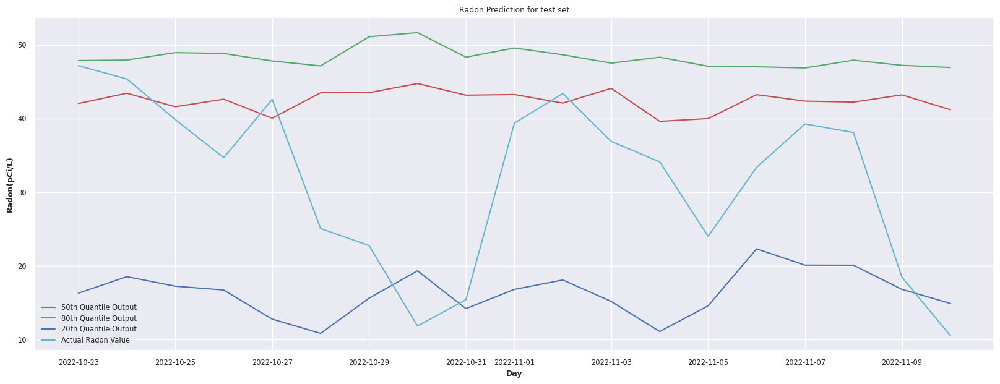

In [98]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()